<a href="https://colab.research.google.com/github/descartesmbogning/phage-therapy-patents-analysis/blob/main/2_Key_Players_patent_phage_therapy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# import data


In [ ]:
!pip install nltk matplotlib wordcloud scikit-learn


In [ ]:
import nltk
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from collections import Counter
nltk.download('punkt')
import textwrap

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
from wordcloud import WordCloud, STOPWORDS
import plotly.express as px
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

# Downloads
nltk.download('wordnet')
nltk.download('stopwords')

# Initialize your stopwords set with wordcloud's stopwords
s = set(STOPWORDS)

# Get stopwords for all languages in NLTK
languages = stopwords.fileids()
for language in languages:
    s.update(stopwords.words(language))

# Add any additional stopwords if needed
s.add('amp')

# If you really need the resulting stopwords as a list:
stopwords_list = list(s)


[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
import textwrap

def wrap_text(text, width=20):
    """Wrap text to the specified width."""
    lines = textwrap.wrap(text, width=width)
    return '\n'.join(lines)
wrap_text('1st phage genome seqenced')

'1st phage genome\nseqenced'

In [ ]:
# Load your dataset (Assuming it's a CSV with a column 'abstract' for patent abstracts)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
data_all = pd.read_csv ('/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/patent-phage-therapy-lens-23102023-tiab.csv')
#data = pd.read_pickle(f'/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/topic_probability_patent_therapy_23102023_10.pkl').reset_index()
pd.set_option('display.max_columns', None)
print(len(data_all))
data_all.head()

2365


,#,Jurisdiction,Kind,Display Key,Lens ID,Publication Date,Publication Year,Application Number,Application Date,Priority Numbers,Earliest Priority Date,Title,Abstract,Applicants,Inventors,Owners,URL,Document Type,Has Full Text,Cites Patent Count,Cited by Patent Count,Simple Family Size,Extended Family Size,Sequence Count,CPC Classifications,IPCR Classifications,US Classifications,NPL Citation Count,NPL Resolved Citation Count,NPL Resolved Lens ID(s),NPL Resolved External ID(s),NPL Citations,Legal Status
0,1,RU,C2,RU 2214829 C2,069-390-611-717-343,2003-10-27,2003,RU 2001129920 A,2001-11-05,RU 2001129920 A,2001-11-05,METHOD FOR TUBERCULOSIS PHAGOTHERAPY,"FIELD: medicine, phthisiology. SUBSTANCE: meth...",NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D,NaN,https://lens.org/069-390-611-717-343,Granted Patent,no,0,4,1,1,0,NaN,A61K35/76;;A61P31/06,NaN,0,0,NaN,NaN,NaN,EXPIRED
1,2,JP,A,JP 2016104011 A,114-759-028-882-736,2016-06-09,2016,JP 2015243657 A,2015-12-14,US 38401510 P,2010-09-17,"ANTIBACTERIAL PHAGES, PHAGE PEPTIDES AND USE M...",PROBLEM TO BE SOLVED: To provide novel bacteri...,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...,NaN,https://lens.org/114-759-028-882-736,Patent Application,no,1,1,48,48,1300,C12N2795/00032;;A61K31/505;;A61K31/7056;;A61K3...,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,NaN,0,0,NaN,NaN,NaN,ACTIVE
2,3,AU,A1,AU 2015/255318 A1,094-982-928-461-863,2015-12-03,2015,AU 2015/255318 A,2015-11-13,AU 2015/255318 A;;AU 2010/211456 A;;US 2183450...,2009-02-06,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",https://lens.org/094-982-928-461-863,Patent Application,no,0,0,3,45,0,NaN,A61K35/76;;C12N9/14;;G01N33/569,NaN,0,0,NaN,NaN,NaN,ACTIVE
3,4,US,A1,US 2016/0022747 A1,167-908-891-122-112,2016-01-28,2016,US 201514852112 A,2015-09-11,US 201514852112 A;;US 201113148009 A;;PT 20100...,2009-02-06,"Antibacterial Phage, Phage Peptides and Method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,https://lens.org/167-908-891-122-112,Patent Application,yes,0,1,42,45,816,A61K38/00;;A61K45/06;;C07K14/005;;C12N7/00;;C1...,A61K35/76;;A61K9/00;;C12N7/00,NaN,0,0,NaN,NaN,NaN,ACTIVE
4,5,AU,A1,AU 2017/204331 A1,112-018-476-081-94X,2017-07-13,2017,AU 2017/204331 A,2017-06-26,AU 2017/204331 A;;AU 2015/255313 A;;AU 2011/30...,2011-09-19,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,NaN,https://lens.org/112-018-476-081-94X,Patent Application,no,0,3,1,1,0,Y02A50/30,A61K35/76;;C12N7/00,NaN,0,0,NaN,NaN,NaN,DISCONTINUED


In [ ]:
#data_topic = pd.read_csv ('/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/patent-phage-therapy-lens-23102023-tiab.csv')
data_topic = pd.read_pickle(f'/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/topic_probability_patent_therapy_23102023_10.pkl').reset_index()[[
    'Lens ID','Topic N°'
]]
pd.set_option('display.max_columns', None)
print(len(data_topic))
data_topic.head()

2309


,Lens ID,Topic N°
0,069-390-611-717-343,2
1,114-759-028-882-736,3
2,094-982-928-461-863,3
3,112-018-476-081-94X,3
4,091-234-230-295-135,3


In [ ]:
import pandas as pd

# Assuming `data` is your DataFrame and has a column named 'Jurisdiction'

topics_rename = {
    0: 'Topic 0',
    1: 'Topic 1',
    2: 'Topic 2',
    3: 'Topic 3',
    4: 'Topic 4',
    5: 'Topic 5',
    6: 'Topic 6',
    7: 'Topic 7',
    8: 'Topic 8',
    9: 'Topic 9',
    10: 'Topic 10',
}

# Replace the codes with names in the 'Jurisdiction' column
data_topic['Topic N°'] = data_topic['Topic N°'].map(topics_rename)#.fillna(data_topic['Topic N°'])
data_topic.head()

,Lens ID,Topic N°
0,069-390-611-717-343,Topic 2
1,114-759-028-882-736,Topic 3
2,094-982-928-461-863,Topic 3
3,112-018-476-081-94X,Topic 3
4,091-234-230-295-135,Topic 3


In [ ]:
# Merge the DataFrames on 'common_column'
data = data_all.merge(data_topic, on='Lens ID', how='outer')
data

,#,Jurisdiction,Kind,Display Key,Lens ID,Publication Date,Publication Year,Application Number,Application Date,Priority Numbers,Earliest Priority Date,Title,Abstract,Applicants,Inventors,Owners,URL,Document Type,Has Full Text,Cites Patent Count,Cited by Patent Count,Simple Family Size,Extended Family Size,Sequence Count,CPC Classifications,IPCR Classifications,US Classifications,NPL Citation Count,NPL Resolved Citation Count,NPL Resolved Lens ID(s),NPL Resolved External ID(s),NPL Citations,Legal Status,Topic N°
0,1,RU,C2,RU 2214829 C2,069-390-611-717-343,2003-10-27,2003,RU 2001129920 A,2001-11-05,RU 2001129920 A,2001-11-05,METHOD FOR TUBERCULOSIS PHAGOTHERAPY,"FIELD: medicine, phthisiology. SUBSTANCE: meth...",NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D,NaN,https://lens.org/069-390-611-717-343,Granted Patent,no,0,4,1,1,0,NaN,A61K35/76;;A61P31/06,NaN,0,0,NaN,NaN,NaN,EXPIRED,Topic 2
1,2,JP,A,JP 2016104011 A,114-759-028-882-736,2016-06-09,2016,JP 2015243657 A,2015-12-14,US 38401510 P,2010-09-17,"ANTIBACTERIAL PHAGES, PHAGE PEPTIDES AND USE M...",PROBLEM TO BE SOLVED: To provide novel bacteri...,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...,NaN,https://lens.org/114-759-028-882-736,Patent Application,no,1,1,48,48,1300,C12N2795/00032;;A61K31/505;;A61K31/7056;;A61K3...,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3
2,3,AU,A1,AU 2015/255318 A1,094-982-928-461-863,2015-12-03,2015,AU 2015/255318 A,2015-11-13,AU 2015/255318 A;;AU 2010/211456 A;;US 2183450...,2009-02-06,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",https://lens.org/094-982-928-461-863,Patent Application,no,0,0,3,45,0,NaN,A61K35/76;;C12N9/14;;G01N33/569,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3
3,4,US,A1,US 2016/0022747 A1,167-908-891-122-112,2016-01-28,2016,US 201514852112 A,2015-09-11,US 201514852112 A;;US 201113148009 A;;PT 20100...,2009-02-06,"Antibacterial Phage, Phage Peptides and Method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,https://lens.org/167-908-891-122-112,Patent Application,yes,0,1,42,45,816,A61K38/00;;A61K45/06;;C07K14/005;;C12N7/00;;C1...,A61K35/76;;A61K9/00;;C12N7/00,NaN,0,0,NaN,NaN,NaN,ACTIVE,NaN
4,5,AU,A1,AU 2017/204331 A1,112-018-476-081-94X,2017-07-13,2017,AU 2017/204331 A,2017-06-26,AU 2017/204331 A;;AU 2015/255313 A;;AU 2011/30...,2011-09-19,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,NaN,https://lens.org/112-018-476-081-94X,Patent Application,no,0,3,1,1,0,Y02A50/30,A61K35/76;;C12N7/00,NaN,0,0,NaN,NaN,NaN,DISCONTINUED,Topic 3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2360,2361,GB,A,GB 1165745 A,150-422-589-010-681,1969-10-01,1969,GB 3886866 A,1966-08-31,US 48872465 A,1965-09-20,Novel Dinucleoside Phosphates,"1,165,745. Dinucleoside phosphates. UPJOHN CO....",UPJOHN CO,NaN,NaN,https://lens.org/150-422-589-010-681,Granted Patent,no,0,0,7,7,0,C07H19/14;;C07H19/14;;Y02P20/55;;Y02P20/55;;Y1...,C07H19/14,C2A A1B -;;C2A A1C2C -;;C2A ...,0,0,NaN,NaN,NaN,EXPIRED,Topic 0
2361,2362,GB,A,GB 1165354 A,058-819-734-343-222,1969-09-24,1969,GB 3887066 A,1966-08-31,US 48879965 A,1965-09-20,Novel Dinucleoside Phosphates,"1,165,354. Dinucleoside phosphates. UPJOHN CO....",UPJOHN CO,NaN,NaN,https://lens.org/058-819-734-343-222,Granted Patent,no,0,0,7,7,0,C07H19/04;;C07H19/044;;C07H19/207;;C08F2/00;;C...,C07H19/04;;C07H19/044;;C07H19/207;;C08F2/00;;C...,C2A

# data preprocessing

In [ ]:
data['Application Date'] = pd.to_datetime(data['Application Date'])
data['Earliest Priority Date'] = pd.to_datetime(data['Earliest Priority Date'])

In [ ]:
data['Application Year'] = data['Application Date'].dt.year
data['Earliest Priority Year'] = data['Earliest Priority Date'].dt.year

In [ ]:
# Convert 'Publication Year' to integers
data['Publication Year'] = data['Publication Year'].astype('Int64')
data['Application Year'] = data['Application Year'].astype('Int64')
data['Earliest Priority Year'] = data['Earliest Priority Year'].astype('Int64')

In [ ]:
def group_years_in_ranges(df, col_name):
    bins = list(range(1955, 2026, 5))
    labels = [f"{i}-{i+4}" for i in bins[:-1]]
    return pd.cut(data['Application Year'], bins=bins, labels=labels, right=False)


In [ ]:
data['Application_Year_Range'] = group_years_in_ranges(data, 'Application Year')


In [ ]:
data['IPCR Classifications']

0                                    A61K35/76;;A61P31/06
1               C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09
2                         A61K35/76;;C12N9/14;;G01N33/569
3                           A61K35/76;;A61K9/00;;C12N7/00
4                                     A61K35/76;;C12N7/00
                              ...                        
2360                                            C07H19/14
2361    C07H19/04;;C07H19/044;;C07H19/207;;C08F2/00;;C...
2362                                             C12Q1/68
2363     A21D2/00;;A23C9/12;;C12N1/00;;C12N1/12;;C12P1/00
2364    A61K39/00;;A61K39/29;;A61K39/295;;A61K39/385;;...
Name: IPCR Classifications, Length: 2365, dtype: object

In [ ]:
import pandas as pd

# Define the function to process IPCR codes
def process_ipcr_sections(ipcr_codes):
    # Check if ipcr_codes is a string (which means it's not NaN or None)
    if isinstance(ipcr_codes, str):
        # Extract the first letter of each code, remove duplicates by converting to a set
        unique_initials = sorted(set(code[0] for code in ipcr_codes.split(';;') if code))
        # Join the unique initials back together
        return ';;'.join(unique_initials)
    else:
        # If it's not a string, just return an empty string or NaN
        return ''

# Assuming 'data' is your DataFrame
# Apply the function to the 'IPCR Classifications' column
data['IPCR Sections'] = data['IPCR Classifications'].apply(process_ipcr_sections)

# Print the DataFrame to verify the results
data[['IPCR Classifications', 'IPCR Sections']]


,IPCR Classifications,IPCR Sections
0,A61K35/76;;A61P31/06,A
1,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,A;;C
2,A61K35/76;;C12N9/14;;G01N33/569,A;;C;;G
3,A61K35/76;;A61K9/00;;C12N7/00,A;;C
4,A61K35/76;;C12N7/00,A;;C
...,...,...
2360,C07H19/14,C
2361,C07H19/04;;C07H19/044;;C07H19/207;;C08F2/00;;C...,C
2362,C12Q1/68,C
2363,A21D2/00;;A23C9/12;;C12N1/00;;C12N1/12;;C12P1/00,A;;C


In [ ]:
import pandas as pd

# Define the function to process IPCR codes
def process_ipcr_class(ipcr_codes):
    # Check if ipcr_codes is a string (which means it's not NaN or None)
    if isinstance(ipcr_codes, str):
        # Extract the first letter of each code, remove duplicates by converting to a set
        unique_initials = sorted(set(code[:3] for code in ipcr_codes.split(';;') if code))
        # Join the unique initials back together
        return ';;'.join(unique_initials)
    else:
        # If it's not a string, just return an empty string or NaN
        return ''

# Assuming 'data' is your DataFrame
# Apply the function to the 'IPCR Classifications' column
data['IPCR Class'] = data['IPCR Classifications'].apply(process_ipcr_class)

# Print the DataFrame to verify the results
data[['IPCR Classifications', 'IPCR Class']]


,IPCR Classifications,IPCR Class
0,A61K35/76;;A61P31/06,A61
1,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,A61;;C12
2,A61K35/76;;C12N9/14;;G01N33/569,A61;;C12;;G01
3,A61K35/76;;A61K9/00;;C12N7/00,A61;;C12
4,A61K35/76;;C12N7/00,A61;;C12
...,...,...
2360,C07H19/14,C07
2361,C07H19/04;;C07H19/044;;C07H19/207;;C08F2/00;;C...,C07;;C08;;C12
2362,C12Q1/68,C12
2363,A21D2/00;;A23C9/12;;C12N1/00;;C12N1/12;;C12P1/00,A21;;A23;;C12


In [ ]:
import pandas as pd

# Define the function to process IPCR codes
def process_ipcr_subclass(ipcr_codes):
    # Check if ipcr_codes is a string (which means it's not NaN or None)
    if isinstance(ipcr_codes, str):
        # Extract the first letter of each code, remove duplicates by converting to a set
        unique_initials = sorted(set(code[:4] for code in ipcr_codes.split(';;') if code))
        # Join the unique initials back together
        return ';;'.join(unique_initials)
    else:
        # If it's not a string, just return an empty string or NaN
        return ''

# Assuming 'data' is your DataFrame
# Apply the function to the 'IPCR Classifications' column
data['IPCR Subclass'] = data['IPCR Classifications'].apply(process_ipcr_subclass)

# Print the DataFrame to verify the results
data[['IPCR Classifications', 'IPCR Subclass']]


,IPCR Classifications,IPCR Subclass
0,A61K35/76;;A61P31/06,A61K;;A61P
1,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,A61K;;A61P;;C12N
2,A61K35/76;;C12N9/14;;G01N33/569,A61K;;C12N;;G01N
3,A61K35/76;;A61K9/00;;C12N7/00,A61K;;C12N
4,A61K35/76;;C12N7/00,A61K;;C12N
...,...,...
2360,C07H19/14,C07H
2361,C07H19/04;;C07H19/044;;C07H19/207;;C08F2/00;;C...,C07H;;C08F;;C12P
2362,C12Q1/68,C12Q
2363,A21D2/00;;A23C9/12;;C12N1/00;;C12N1/12;;C12P1/00,A21D;;A23C;;C12N;;C12P


In [ ]:
data['Jurisdiction'].unique()

array(['RU', 'JP', 'AU', 'US', 'CN', 'CA', 'WO', 'EP', 'SG', 'KR', 'NZ',
       'GB', 'GE', 'DE', 'CZ', 'MX', 'TN', 'ES', 'IN', 'EA', 'TW', 'UA',
       'MY', 'SU', 'FR', 'CH', 'PH', 'SK', 'NL', 'LV', 'ZA', 'PL', 'BG'],
      dtype=object)

In [ ]:
import pandas as pd

# Assuming `data` is your DataFrame and has a column named 'Jurisdiction'

jurisdiction_codes = {
    'RU': 'Russia',
    'JP': 'Japan',
    'AU': 'Australia',
    'US': 'United States',
    'CN': 'China',
    'CA': 'Canada',
    'WO': 'World Intellectual Property Org.',
    'EP': 'European Patent Office',
    'SG': 'Singapore',
    'KR': 'South Korea',
    'NZ': 'New Zealand',
    'GB': 'United Kingdom',
    'GE': 'Georgia',  # or 'Germany' for historical East Germany
    'DE': 'Germany',
    'CZ': 'Czech Republic',
    'MX': 'Mexico',
    'TN': 'Tunisia',
    'ES': 'Spain',
    'IN': 'India',
    'EA': 'Eurasian Patent Org.',
    'TW': 'Taiwan',
    'UA': 'Ukraine',
    'MY': 'Malaysia',
    'SU': 'Russia',
    'FR': 'France',
    'CH': 'Switzerland',
    'PH': 'Philippines',
    'SK': 'Slovakia',
    'NL': 'Netherlands',
    'LV': 'Latvia',
    'ZA': 'South Africa',
    'PL': 'Poland',
    'BG': 'Bulgaria',
}

# Replace the codes with names in the 'Jurisdiction' column
data['Jurisdiction_name'] = data['Jurisdiction'].map(jurisdiction_codes).fillna(data['Jurisdiction'])

#data[['Jurisdiction', 'Jurisdiction_name']]

In [ ]:
import pandas as pd

# Your existing DataFrame is 'data', and it contains a column 'Jurisdiction'

# Map of jurisdiction codes to their respective continent or region names
jurisdiction_to_region = {
    # Western Europe
    'GB': 'Europe', 'DE': 'Europe', 'FR': 'Europe',
    'CH': 'Europe', 'NL': 'Europe', 'ES': 'Europe',

    # Eastern Europe
    'RU': 'Europe', 'CZ': 'Europe', 'UA': 'Europe',
    'SK': 'Europe', 'LV': 'Europe', 'PL': 'Europe',
    'GE': 'Europe', 'BG': 'Europe',

    # Rest of the regions
    'JP': 'Asia', 'AU': 'Oceania', 'US': 'North America', 'CN': 'Asia',
    'CA': 'North America', 'WO': 'International', 'EP': 'Europe', 'SG': 'Asia',
    'KR': 'Asia', 'NZ': 'Oceania', 'MX': 'North America', 'TN': 'Africa',
    'IN': 'Asia', 'EA': 'Eurasia', 'TW': 'Asia', 'MY': 'Asia',
    'SU': 'Eurasia', 'PH': 'Asia', 'ZA': 'Africa'
}

# Create a new column 'Region' by mapping the 'Jurisdiction' column using the dictionary
data['Jurisdiction_Region'] = data['Jurisdiction'].map(jurisdiction_to_region).fillna(data['Jurisdiction'])

data[['Jurisdiction', 'Jurisdiction_name', 'Jurisdiction_Region']]


,Jurisdiction,Jurisdiction_name,Jurisdiction_Region
0,RU,Russia,Europe
1,JP,Japan,Asia
2,AU,Australia,Oceania
3,US,United States,North America
4,AU,Australia,Oceania
...,...,...,...
2360,GB,United Kingdom,Europe
2361,GB,United Kingdom,Europe
2362,SG,Singapore,Asia
2363,SG,Singapore,Asia


In [ ]:
data['Jurisdiction_name'].unique()

array(['Russia', 'Japan', 'Australia', 'United States', 'China', 'Canada',
       'World Intellectual Property Org.', 'European Patent Office',
       'Singapore', 'South Korea', 'New Zealand', 'United Kingdom',
       'Georgia', 'Germany', 'Czech Republic', 'Mexico', 'Tunisia',
       'Spain', 'India', 'Eurasian Patent Org.', 'Taiwan', 'Ukraine',
       'Malaysia', 'France', 'Switzerland', 'Philippines', 'Slovakia',
       'Netherlands', 'Latvia', 'South Africa', 'Poland', 'Bulgaria'],
      dtype=object)

In [ ]:
data['Jurisdiction_Region'].unique()

array(['Europe', 'Asia', 'Oceania', 'North America', 'International',
       'Africa', 'Eurasia'], dtype=object)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2365 entries, 0 to 2364
Data columns (total 42 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   #                            2365 non-null   int64         
 1   Jurisdiction                 2365 non-null   object        
 2   Kind                         2365 non-null   object        
 3   Display Key                  2365 non-null   object        
 4   Lens ID                      2365 non-null   object        
 5   Publication Date             2365 non-null   object        
 6   Publication Year             2365 non-null   Int64         
 7   Application Number           2365 non-null   object        
 8   Application Date             2365 non-null   datetime64[ns]
 9   Priority Numbers             2363 non-null   object        
 10  Earliest Priority Date       2363 non-null   datetime64[ns]
 11  Title                        2365 non-null 

### clean applicants and inventors

In [ ]:
data[['Applicants','Inventors']]

,Applicants,Inventors
0,NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D
1,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...
2,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...
3,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...
4,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...
...,...,...
2360,UPJOHN CO,NaN
2361,UPJOHN CO,NaN
2362,TCM BIOTECH INT CORP,LIN YOU-YU;;WANG YA-CHUN;;TZENG SHENG-TAI
2363,FLAGSHIP PIONEERING INNOVATIONS V INC,MARTINEZ IGNACIO;;ARMEN ZACHARY;;CEZAR CHRISTI...


In [ ]:
#data_topic = pd.read_csv ('/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/patent-phage-therapy-lens-23102023-tiab.csv')
applicant_clean = pd.read_excel(f'/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/BACTERIOPHAGES/MANUSCRIPT/applicant-classification_clean.xlsx')
pd.set_option('display.max_columns', None)
print(len(applicant_clean))
applicant_clean.head()

1973


,Applicants,applicants_clean,applicants_clean_not_individual,Last Classification,Column,applicant_category,Column2,Year of Creation,CITY,COUNTRY,country_clean,region_clean,global_north_sud,country_clean2,capital,latitude,longitude
0,BIOCONTROL LTD,BIOCONTROL LTD,BIOCONTROL LTD,Terminator,ltd,Commercial,BIOCONTROL LTD,Not found,Australia,NaN,Australia,Oceania,NaN,NaN,NaN,-35.293056,149.126944
1,NEW HOPE 6 AND STOCK LTD COMPANY,NEW HOPE 6 AND STOCK LTD COMPANY,NEW HOPE 6 AND STOCK LTD COMPANY,Transient,ltd,Commercial,NEW HOPE 6 AND STOCK LTD COMPANY,NaN,NaN,NaN,Australia,Oceania,NaN,NaN,NaN,-35.293056,149.126944
2,PHAGE CONSULTING PTY LTD,PHAGE CONSULTING PTY LTD,PHAGE CONSULTING PTY LTD,Transient,ltd,Commercial,PHAGE CONSULTING PTY LTD,20211,New South Wales,NaN,Australia,Oceania,NaN,NaN,NaN,-35.293056,149.126944
3,INST MOLEKULARE BIOTECHNOLOGIE,INST MOLEKULARE BIOTECHNOLOGIE,INST MOLEKULARE BIOTECHNOLOGIE,Transient,Institut,Academic,INST MOLEKULARE BIOTECHNOLOGIE,19995,Vienna,NaN,Austria,Europe,NaN,NaN,NaN,NaN,NaN
4,BIO LIFE SCIENCE FORSCHUNGS & ENTWICKLUNGSGESE...,BIO LIFE SCIENCE FORSCHUNGS & ENTWICKLUNGSGESE...,BIO LIFE SCIENCE FORSCHUNGS & ENTWICKLUNGSGESE...,Transient,NaN,Commercial,NaN,2000,Wien,NaN,Austria,Europe,NaN,NaN,NaN,NaN,NaN


In [ ]:
#data_topic = pd.read_csv ('/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/patent-phage-therapy-lens-23102023-tiab.csv')
inventor_clean = pd.read_excel('/content/drive/Othercomputers/My laptop/D:/PROJECT/YORK UNIVERSITY/BACTERIOPHAGES/MANUSCRIPT/inventor_list_clean2.xlsx')
pd.set_option('display.max_columns', None)
print(len(inventor_clean))
inventor_clean.head()

5824


,index,Inventors,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count,inventors_clean
0,0,A MINA,1,4,0.042918,4.000000,A MINA
1,1,A P NETHRAVATHI,1,0,0.042918,0.000000,A P NETHRAVATHI
2,2,ABAEV IGOR V,3,1,0.128755,0.333333,ABAEV IGOR V
3,3,ABDULAMIR AHMED SAHIB,1,0,0.042918,0.000000,ABDULAMIR AHMED SAHIB
4,4,ABE TAKAYOSHI,1,1,0.042918,1.000000,OKABE TAKAYOSHI


In [ ]:
def clean_entities(df1, df2, col_old, col_clean, col_name):
    # Create a dictionary from df2 for mapping
    disease_dict = df2.set_index(col_old)[col_clean].to_dict()

    # Function to clean a single cell
    #def clean_cell(cell):
    def clean_cell(cell):
        if isinstance(cell, str):
            diseases = cell.split(';;')
            cleaned = list(set([disease_dict.get(disease, disease) for disease in diseases if isinstance(disease_dict.get(disease, disease), str)]))
            return ';;'.join(cleaned)
        else:
            return cell


    # Apply the function to each cell in the 'Diseases_lemat_stop2' column
    df1[col_name] = df1[col_old].apply(clean_cell)

    return df1

# Use the function
#df1_clean = clean_diseases(df1, df2)


#### clean inventors

In [ ]:
df1 = data
df2 =  inventor_clean
col_old =  'Inventors'
col_clean =  'inventors_clean'
col_name = 'Inventors_clean'


data = clean_entities(df1, df2, col_old, col_clean, col_name)#.reset_index()
data

,#,Jurisdiction,Kind,Display Key,Lens ID,Publication Date,Publication Year,Application Number,Application Date,Priority Numbers,Earliest Priority Date,Title,Abstract,Applicants,Inventors,Owners,URL,Document Type,Has Full Text,Cites Patent Count,Cited by Patent Count,Simple Family Size,Extended Family Size,Sequence Count,CPC Classifications,IPCR Classifications,US Classifications,NPL Citation Count,NPL Resolved Citation Count,NPL Resolved Lens ID(s),NPL Resolved External ID(s),NPL Citations,Legal Status,Topic N°,Application Year,Earliest Priority Year,Application_Year_Range,IPCR Sections,IPCR Class,IPCR Subclass,Jurisdiction_name,Jurisdiction_Region,Inventors_clean
0,1,RU,C2,RU 2214829 C2,069-390-611-717-343,2003-10-27,2003,RU 2001129920 A,2001-11-05,RU 2001129920 A,2001-11-05,METHOD FOR TUBERCULOSIS PHAGOTHERAPY,"FIELD: medicine, phthisiology. SUBSTANCE: meth...",NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D,NaN,https://lens.org/069-390-611-717-343,Granted Patent,no,0,4,1,1,0,NaN,A61K35/76;;A61P31/06,NaN,0,0,NaN,NaN,NaN,EXPIRED,Topic 2,2001,2001,2000-2004,A,A61,A61K;;A61P,Russia,Europe,KURUNOVA N N;;KURUNOV JU N;;SHATALOVA N D
1,2,JP,A,JP 2016104011 A,114-759-028-882-736,2016-06-09,2016,JP 2015243657 A,2015-12-14,US 38401510 P,2010-09-17,"ANTIBACTERIAL PHAGES, PHAGE PEPTIDES AND USE M...",PROBLEM TO BE SOLVED: To provide novel bacteri...,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...,NaN,https://lens.org/114-759-028-882-736,Patent Application,no,1,1,48,48,1300,C12N2795/00032;;A61K31/505;;A61K31/7056;;A61K3...,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2010,2015-2019,A;;C,A61;;C12,A61K;;A61P;;C12N,Japan,Asia,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...
2,3,AU,A1,AU 2015/255318 A1,094-982-928-461-863,2015-12-03,2015,AU 2015/255318 A,2015-11-13,AU 2015/255318 A;;AU 2010/211456 A;;US 2183450...,2009-02-06,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",https://lens.org/094-982-928-461-863,Patent Application,no,0,0,3,45,0,NaN,A61K35/76;;C12N9/14;;G01N33/569,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2009,2015-2019,A;;C;;G,A61;;C12;;G01,A61K;;C12N;;G01N,Australia,Oceania,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...
3,4,US,A1,US 2016/0022747 A1,167-908-891-122-112,2016-01-28,2016,US 201514852112 A,2015-09-11,US 201514852112 A;;US 201113148009 A;;PT 20100...,2009-02-06,"Antibacterial Phage, Phage Peptides and Method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,https://lens.org/167-908-891-122-112,Patent Application,yes,0,1,42,45,816,A61K38/00;;A61K45/06;;C07K14/005;;C12N7/00;;C1...,A61K35/76;;A61K9/00;;C12N7/00,NaN,0,0,NaN,NaN,NaN,ACTIVE,NaN,2015,2009,2015-2019,A;;C,A61;;C12,A61K;;C12N,United States,North America,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...
4,5,AU,A1,AU 2017/204331 A1,112-018-476-081-94X,2017-07-13,2017,AU 2017/204331 A,2017-06-26,AU 2017/204331 A;;AU 2015/255313 A;;AU 2011/30...,2011-09-19,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,NaN,https://lens.org/112-018-476-081-94X,Patent Application,no,0,3,1,1,0,Y02A50/30,A61K35/76;;C12N7/00,NaN,0,0,NaN,NaN,NaN,DISCONTINUED,Topic 3,2017,2011,2015-2019,A;;C,A61;;C12,A61K;;C12N,Australia,Oceania,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2360,2361,GB,A,GB 11657

#### clean applicants

In [ ]:
df1 = data
df2 =  applicant_clean
col_old =  'Applicants'
col_clean =  'applicants_clean'
col_name = 'Applicants_clean'


data = clean_entities(df1, df2, col_old, col_clean, col_name)#.reset_index()
data

,#,Jurisdiction,Kind,Display Key,Lens ID,Publication Date,Publication Year,Application Number,Application Date,Priority Numbers,Earliest Priority Date,Title,Abstract,Applicants,Inventors,Owners,URL,Document Type,Has Full Text,Cites Patent Count,Cited by Patent Count,Simple Family Size,Extended Family Size,Sequence Count,CPC Classifications,IPCR Classifications,US Classifications,NPL Citation Count,NPL Resolved Citation Count,NPL Resolved Lens ID(s),NPL Resolved External ID(s),NPL Citations,Legal Status,Topic N°,Application Year,Earliest Priority Year,Application_Year_Range,IPCR Sections,IPCR Class,IPCR Subclass,Jurisdiction_name,Jurisdiction_Region,Inventors_clean,Applicants_clean
0,1,RU,C2,RU 2214829 C2,069-390-611-717-343,2003-10-27,2003,RU 2001129920 A,2001-11-05,RU 2001129920 A,2001-11-05,METHOD FOR TUBERCULOSIS PHAGOTHERAPY,"FIELD: medicine, phthisiology. SUBSTANCE: meth...",NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D,NaN,https://lens.org/069-390-611-717-343,Granted Patent,no,0,4,1,1,0,NaN,A61K35/76;;A61P31/06,NaN,0,0,NaN,NaN,NaN,EXPIRED,Topic 2,2001,2001,2000-2004,A,A61,A61K;;A61P,Russia,Europe,KURUNOVA N N;;KURUNOV JU N;;SHATALOVA N D,NOVOSIB NII T;;UBERKULEZA
1,2,JP,A,JP 2016104011 A,114-759-028-882-736,2016-06-09,2016,JP 2015243657 A,2015-12-14,US 38401510 P,2010-09-17,"ANTIBACTERIAL PHAGES, PHAGE PEPTIDES AND USE M...",PROBLEM TO BE SOLVED: To provide novel bacteri...,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...,NaN,https://lens.org/114-759-028-882-736,Patent Application,no,1,1,48,48,1300,C12N2795/00032;;A61K31/505;;A61K31/7056;;A61K3...,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2010,2015-2019,A;;C,A61;;C12,A61K;;A61P;;C12N,Japan,Asia,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...
2,3,AU,A1,AU 2015/255318 A1,094-982-928-461-863,2015-12-03,2015,AU 2015/255318 A,2015-11-13,AU 2015/255318 A;;AU 2010/211456 A;;US 2183450...,2009-02-06,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",https://lens.org/094-982-928-461-863,Patent Application,no,0,0,3,45,0,NaN,A61K35/76;;C12N9/14;;G01N33/569,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2009,2015-2019,A;;C;;G,A61;;C12;;G01,A61K;;C12N;;G01N,Australia,Oceania,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...
3,4,US,A1,US 2016/0022747 A1,167-908-891-122-112,2016-01-28,2016,US 201514852112 A,2015-09-11,US 201514852112 A;;US 201113148009 A;;PT 20100...,2009-02-06,"Antibacterial Phage, Phage Peptides and Method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,https://lens.org/167-908-891-122-112,Patent Application,yes,0,1,42,45,816,A61K38/00;;A61K45/06;;C07K14/005;;C12N7/00;;C1...,A61K35/76;;A61K9/00;;C12N7/00,NaN,0,0,NaN,NaN,NaN,ACTIVE,NaN,2015,2009,2015-2019,A;;C,A61;;C12,A61K;;C12N,United States,North America,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...
4,5,AU,A1,AU 2017/204331 A1,112-018-476-081-94X,2017-07-13,2017,AU 2017/204331 A,2017-06-26,AU 2017/204331 A;;AU 2015/255313 A;;AU 2011/30...,2011-09-19,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,NaN,https://lens.org/112-018-476-081-94X,Patent Application,no,0,3,1,1,0,Y02A50/30,A61K35/76;;C12N7/00,NaN,0,0,NaN,NaN,NaN,DISCONTINUED,Topic 3,2017,2011,2015-2019,A;;C,A61;;C12,A61K;;C12N,Australia,Oceania,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...,Techno

#### clean applicants not individual

In [ ]:
df1 = data
df2 =  applicant_clean
col_old =  'Applicants'
col_clean =  'applicants_clean_not_individual'
col_name = 'applicants_clean_not_individual'


data = clean_entities(df1, df2, col_old, col_clean, col_name)#.reset_index()
data

,#,Jurisdiction,Kind,Display Key,Lens ID,Publication Date,Publication Year,Application Number,Application Date,Priority Numbers,Earliest Priority Date,Title,Abstract,Applicants,Inventors,Owners,URL,Document Type,Has Full Text,Cites Patent Count,Cited by Patent Count,Simple Family Size,Extended Family Size,Sequence Count,CPC Classifications,IPCR Classifications,US Classifications,NPL Citation Count,NPL Resolved Citation Count,NPL Resolved Lens ID(s),NPL Resolved External ID(s),NPL Citations,Legal Status,Topic N°,Application Year,Earliest Priority Year,Application_Year_Range,IPCR Sections,IPCR Class,IPCR Subclass,Jurisdiction_name,Jurisdiction_Region,Inventors_clean,Applicants_clean,applicants_clean_not_individual
0,1,RU,C2,RU 2214829 C2,069-390-611-717-343,2003-10-27,2003,RU 2001129920 A,2001-11-05,RU 2001129920 A,2001-11-05,METHOD FOR TUBERCULOSIS PHAGOTHERAPY,"FIELD: medicine, phthisiology. SUBSTANCE: meth...",NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D,NaN,https://lens.org/069-390-611-717-343,Granted Patent,no,0,4,1,1,0,NaN,A61K35/76;;A61P31/06,NaN,0,0,NaN,NaN,NaN,EXPIRED,Topic 2,2001,2001,2000-2004,A,A61,A61K;;A61P,Russia,Europe,KURUNOVA N N;;KURUNOV JU N;;SHATALOVA N D,NOVOSIB NII T;;UBERKULEZA,NOVOSIB NII T
1,2,JP,A,JP 2016104011 A,114-759-028-882-736,2016-06-09,2016,JP 2015243657 A,2015-12-14,US 38401510 P,2010-09-17,"ANTIBACTERIAL PHAGES, PHAGE PEPTIDES AND USE M...",PROBLEM TO BE SOLVED: To provide novel bacteri...,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...,NaN,https://lens.org/114-759-028-882-736,Patent Application,no,1,1,48,48,1300,C12N2795/00032;;A61K31/505;;A61K31/7056;;A61K3...,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2010,2015-2019,A;;C,A61;;C12,A61K;;A61P;;C12N,Japan,Asia,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...
2,3,AU,A1,AU 2015/255318 A1,094-982-928-461-863,2015-12-03,2015,AU 2015/255318 A,2015-11-13,AU 2015/255318 A;;AU 2010/211456 A;;US 2183450...,2009-02-06,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",https://lens.org/094-982-928-461-863,Patent Application,no,0,0,3,45,0,NaN,A61K35/76;;C12N9/14;;G01N33/569,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2009,2015-2019,A;;C;;G,A61;;C12;;G01,A61K;;C12N;;G01N,Australia,Oceania,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...
3,4,US,A1,US 2016/0022747 A1,167-908-891-122-112,2016-01-28,2016,US 201514852112 A,2015-09-11,US 201514852112 A;;US 201113148009 A;;PT 20100...,2009-02-06,"Antibacterial Phage, Phage Peptides and Method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,https://lens.org/167-908-891-122-112,Patent Application,yes,0,1,42,45,816,A61K38/00;;A61K45/06;;C07K14/005;;C12N7/00;;C1...,A61K35/76;;A61K9/00;;C12N7/00,NaN,0,0,NaN,NaN,NaN,ACTIVE,NaN,2015,2009,2015-2019,A;;C,A61;;C12,A61K;;C12N,United States,North America,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...
4,5,AU,A1,AU 2017/204331 A1,112-018-476-081-94X,2017-07-13,2017,AU 2017/204331 A,2017-06-26,AU 2017/204331 A;;AU 2015/255313 A;;AU 2011/30...,2011-09-19,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,NaN,https://lens.org/112-018-476-081-94X,Patent Application,no,0,3,

## add classifications to entitities

#### add applicants countries

In [ ]:
df1 = data
df2 =  applicant_clean
col_old =  'Applicants'
col_clean =  'country_clean'
col_name = 'Applicants_countries'

data = clean_entities(df1, df2, col_old, col_clean, col_name)#.reset_index()
data

,#,Jurisdiction,Kind,Display Key,Lens ID,Publication Date,Publication Year,Application Number,Application Date,Priority Numbers,Earliest Priority Date,Title,Abstract,Applicants,Inventors,Owners,URL,Document Type,Has Full Text,Cites Patent Count,Cited by Patent Count,Simple Family Size,Extended Family Size,Sequence Count,CPC Classifications,IPCR Classifications,US Classifications,NPL Citation Count,NPL Resolved Citation Count,NPL Resolved Lens ID(s),NPL Resolved External ID(s),NPL Citations,Legal Status,Topic N°,Application Year,Earliest Priority Year,Application_Year_Range,IPCR Sections,IPCR Class,IPCR Subclass,Jurisdiction_name,Jurisdiction_Region,Inventors_clean,Applicants_clean,applicants_clean_not_individual,Applicants_countries
0,1,RU,C2,RU 2214829 C2,069-390-611-717-343,2003-10-27,2003,RU 2001129920 A,2001-11-05,RU 2001129920 A,2001-11-05,METHOD FOR TUBERCULOSIS PHAGOTHERAPY,"FIELD: medicine, phthisiology. SUBSTANCE: meth...",NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D,NaN,https://lens.org/069-390-611-717-343,Granted Patent,no,0,4,1,1,0,NaN,A61K35/76;;A61P31/06,NaN,0,0,NaN,NaN,NaN,EXPIRED,Topic 2,2001,2001,2000-2004,A,A61,A61K;;A61P,Russia,Europe,KURUNOVA N N;;KURUNOV JU N;;SHATALOVA N D,NOVOSIB NII T;;UBERKULEZA,NOVOSIB NII T,Russia
1,2,JP,A,JP 2016104011 A,114-759-028-882-736,2016-06-09,2016,JP 2015243657 A,2015-12-14,US 38401510 P,2010-09-17,"ANTIBACTERIAL PHAGES, PHAGE PEPTIDES AND USE M...",PROBLEM TO BE SOLVED: To provide novel bacteri...,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...,NaN,https://lens.org/114-759-028-882-736,Patent Application,no,1,1,48,48,1300,C12N2795/00032;;A61K31/505;;A61K31/7056;;A61K3...,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2010,2015-2019,A;;C,A61;;C12,A61K;;A61P;;C12N,Japan,Asia,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal
2,3,AU,A1,AU 2015/255318 A1,094-982-928-461-863,2015-12-03,2015,AU 2015/255318 A,2015-11-13,AU 2015/255318 A;;AU 2010/211456 A;;US 2183450...,2009-02-06,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",https://lens.org/094-982-928-461-863,Patent Application,no,0,0,3,45,0,NaN,A61K35/76;;C12N9/14;;G01N33/569,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2009,2015-2019,A;;C;;G,A61;;C12;;G01,A61K;;C12N;;G01N,Australia,Oceania,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal
3,4,US,A1,US 2016/0022747 A1,167-908-891-122-112,2016-01-28,2016,US 201514852112 A,2015-09-11,US 201514852112 A;;US 201113148009 A;;PT 20100...,2009-02-06,"Antibacterial Phage, Phage Peptides and Method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,https://lens.org/167-908-891-122-112,Patent Application,yes,0,1,42,45,816,A61K38/00;;A61K45/06;;C07K14/005;;C12N7/00;;C1...,A61K35/76;;A61K9/00;;C12N7/00,NaN,0,0,NaN,NaN,NaN,ACTIVE,NaN,2015,2009,2015-2019,A;;C,A61;;C12,A61K;;C12N,United States,North America,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal
4,5,AU,A1,AU 2017/204331 A1,112-018-476-081-94X,2017-07-13,2017,AU 2017/204331 A,2017-06-26,AU 2017/204331 A;;AU 2015/255313 A;;AU 2011/30...,2011-09-19,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,NaN,https://

#### add applicants region

In [ ]:
df1 = data
df2 =  applicant_clean
col_old =  'Applicants'
col_clean =  'region_clean'
col_name = 'Applicants_regions'

data = clean_entities(df1, df2, col_old, col_clean, col_name)#.reset_index()
data

,#,Jurisdiction,Kind,Display Key,Lens ID,Publication Date,Publication Year,Application Number,Application Date,Priority Numbers,Earliest Priority Date,Title,Abstract,Applicants,Inventors,Owners,URL,Document Type,Has Full Text,Cites Patent Count,Cited by Patent Count,Simple Family Size,Extended Family Size,Sequence Count,CPC Classifications,IPCR Classifications,US Classifications,NPL Citation Count,NPL Resolved Citation Count,NPL Resolved Lens ID(s),NPL Resolved External ID(s),NPL Citations,Legal Status,Topic N°,Application Year,Earliest Priority Year,Application_Year_Range,IPCR Sections,IPCR Class,IPCR Subclass,Jurisdiction_name,Jurisdiction_Region,Inventors_clean,Applicants_clean,applicants_clean_not_individual,Applicants_countries,Applicants_regions
0,1,RU,C2,RU 2214829 C2,069-390-611-717-343,2003-10-27,2003,RU 2001129920 A,2001-11-05,RU 2001129920 A,2001-11-05,METHOD FOR TUBERCULOSIS PHAGOTHERAPY,"FIELD: medicine, phthisiology. SUBSTANCE: meth...",NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D,NaN,https://lens.org/069-390-611-717-343,Granted Patent,no,0,4,1,1,0,NaN,A61K35/76;;A61P31/06,NaN,0,0,NaN,NaN,NaN,EXPIRED,Topic 2,2001,2001,2000-2004,A,A61,A61K;;A61P,Russia,Europe,KURUNOVA N N;;KURUNOV JU N;;SHATALOVA N D,NOVOSIB NII T;;UBERKULEZA,NOVOSIB NII T,Russia,Europe
1,2,JP,A,JP 2016104011 A,114-759-028-882-736,2016-06-09,2016,JP 2015243657 A,2015-12-14,US 38401510 P,2010-09-17,"ANTIBACTERIAL PHAGES, PHAGE PEPTIDES AND USE M...",PROBLEM TO BE SOLVED: To provide novel bacteri...,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...,NaN,https://lens.org/114-759-028-882-736,Patent Application,no,1,1,48,48,1300,C12N2795/00032;;A61K31/505;;A61K31/7056;;A61K3...,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2010,2015-2019,A;;C,A61;;C12,A61K;;A61P;;C12N,Japan,Asia,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe
2,3,AU,A1,AU 2015/255318 A1,094-982-928-461-863,2015-12-03,2015,AU 2015/255318 A,2015-11-13,AU 2015/255318 A;;AU 2010/211456 A;;US 2183450...,2009-02-06,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",https://lens.org/094-982-928-461-863,Patent Application,no,0,0,3,45,0,NaN,A61K35/76;;C12N9/14;;G01N33/569,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2009,2015-2019,A;;C;;G,A61;;C12;;G01,A61K;;C12N;;G01N,Australia,Oceania,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe
3,4,US,A1,US 2016/0022747 A1,167-908-891-122-112,2016-01-28,2016,US 201514852112 A,2015-09-11,US 201514852112 A;;US 201113148009 A;;PT 20100...,2009-02-06,"Antibacterial Phage, Phage Peptides and Method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,https://lens.org/167-908-891-122-112,Patent Application,yes,0,1,42,45,816,A61K38/00;;A61K45/06;;C07K14/005;;C12N7/00;;C1...,A61K35/76;;A61K9/00;;C12N7/00,NaN,0,0,NaN,NaN,NaN,ACTIVE,NaN,2015,2009,2015-2019,A;;C,A61;;C12,A61K;;C12N,United States,North America,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe
4,5,AU,A1,AU 2017/204331 A1,112-018-476-081-94X,2017-07-13,2017,AU 2017/204331 A,2017-06-26,AU 2017/204331 A;;AU 2015/255313 A;;AU 2011/30...,2011-09-19,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA

#### add applicants categories : individual, commercial, academic, governemental

In [ ]:
df1 = data
df2 =  applicant_clean
col_old =  'Applicants'
col_clean =  'applicant_category'
col_name = 'Applicants_categories'

data = clean_entities(df1, df2, col_old, col_clean, col_name)#.reset_index()
data

,#,Jurisdiction,Kind,Display Key,Lens ID,Publication Date,Publication Year,Application Number,Application Date,Priority Numbers,Earliest Priority Date,Title,Abstract,Applicants,Inventors,Owners,URL,Document Type,Has Full Text,Cites Patent Count,Cited by Patent Count,Simple Family Size,Extended Family Size,Sequence Count,CPC Classifications,IPCR Classifications,US Classifications,NPL Citation Count,NPL Resolved Citation Count,NPL Resolved Lens ID(s),NPL Resolved External ID(s),NPL Citations,Legal Status,Topic N°,Application Year,Earliest Priority Year,Application_Year_Range,IPCR Sections,IPCR Class,IPCR Subclass,Jurisdiction_name,Jurisdiction_Region,Inventors_clean,Applicants_clean,applicants_clean_not_individual,Applicants_countries,Applicants_regions,Applicants_categories
0,1,RU,C2,RU 2214829 C2,069-390-611-717-343,2003-10-27,2003,RU 2001129920 A,2001-11-05,RU 2001129920 A,2001-11-05,METHOD FOR TUBERCULOSIS PHAGOTHERAPY,"FIELD: medicine, phthisiology. SUBSTANCE: meth...",NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D,NaN,https://lens.org/069-390-611-717-343,Granted Patent,no,0,4,1,1,0,NaN,A61K35/76;;A61P31/06,NaN,0,0,NaN,NaN,NaN,EXPIRED,Topic 2,2001,2001,2000-2004,A,A61,A61K;;A61P,Russia,Europe,KURUNOVA N N;;KURUNOV JU N;;SHATALOVA N D,NOVOSIB NII T;;UBERKULEZA,NOVOSIB NII T,Russia,Europe,Individual;;Commercial
1,2,JP,A,JP 2016104011 A,114-759-028-882-736,2016-06-09,2016,JP 2015243657 A,2015-12-14,US 38401510 P,2010-09-17,"ANTIBACTERIAL PHAGES, PHAGE PEPTIDES AND USE M...",PROBLEM TO BE SOLVED: To provide novel bacteri...,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...,NaN,https://lens.org/114-759-028-882-736,Patent Application,no,1,1,48,48,1300,C12N2795/00032;;A61K31/505;;A61K31/7056;;A61K3...,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2010,2015-2019,A;;C,A61;;C12,A61K;;A61P;;C12N,Japan,Asia,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe,Commercial
2,3,AU,A1,AU 2015/255318 A1,094-982-928-461-863,2015-12-03,2015,AU 2015/255318 A,2015-11-13,AU 2015/255318 A;;AU 2010/211456 A;;US 2183450...,2009-02-06,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",https://lens.org/094-982-928-461-863,Patent Application,no,0,0,3,45,0,NaN,A61K35/76;;C12N9/14;;G01N33/569,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2009,2015-2019,A;;C;;G,A61;;C12;;G01,A61K;;C12N;;G01N,Australia,Oceania,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe,Commercial
3,4,US,A1,US 2016/0022747 A1,167-908-891-122-112,2016-01-28,2016,US 201514852112 A,2015-09-11,US 201514852112 A;;US 201113148009 A;;PT 20100...,2009-02-06,"Antibacterial Phage, Phage Peptides and Method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,https://lens.org/167-908-891-122-112,Patent Application,yes,0,1,42,45,816,A61K38/00;;A61K45/06;;C07K14/005;;C12N7/00;;C1...,A61K35/76;;A61K9/00;;C12N7/00,NaN,0,0,NaN,NaN,NaN,ACTIVE,NaN,2015,2009,2015-2019,A;;C,A61;;C12,A61K;;C12N,United States,North America,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe,Commercial
4,5,AU,A1,AU 2017/204331 A1,112-018-476-081-94X,2017-07-13,2017,AU 2017/204331 A,2017-06-26,AU 2017/204331 A;;AU 2015/255313 A;;AU 2011/30...,2011-09-19,"Antibacterial phage, phage peptides and method...",The present invention is directed to 

In [ ]:
data[['Applicants_clean','Inventors_clean',"Owners",'Applicants_countries']]

,Applicants_clean,Inventors_clean,Owners,Applicants_countries
0,NOVOSIB NII T;;UBERKULEZA,KURUNOVA N N;;KURUNOV JU N;;SHATALOVA N D,NaN,Russia
1,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...,NaN,Portugal
2,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",Portugal
3,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,Portugal
4,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...,NaN,Portugal
...,...,...,...,...
2360,UPJOHN CO,NaN,NaN,United States
2361,UPJOHN CO,NaN,NaN,United States
2362,TCM BIOTECH INT CORP,WANG YA-CHUN;;TZENG SHENG-TAI;;LIN YOU-YU,NaN,Taiwan
2363,FLAGSHIP PIONEERING INNOVATIONS V INC,MARTINEZ IGNACIO;;ARMEN ZACHARY;;MARTIN BARRY;...,NaN,United States


In [ ]:
data['Applicants_countries'][1221]

''

In [ ]:
# prompt: replace 'PILET CHARLES' in Applicants_countries columns by ''

data['Applicants_countries'].replace('PILET CHARLES', '',inplace=True)
data['Applicants_categories'].replace('PILET CHARLES', 'Individual',inplace=True)

In [ ]:
data['Applicants_countries'][1221]

''

##### TREND

In [ ]:
data2 = data[['Applicants_clean','Applicants_regions',"Applicants_categories",'Applicants_countries','Lens ID']]
data2

,Applicants_clean,Applicants_regions,Applicants_categories,Applicants_countries,Lens ID
0,NOVOSIB NII T;;UBERKULEZA,Europe,Individual;;Commercial,Russia,069-390-611-717-343
1,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Europe,Commercial,Portugal,114-759-028-882-736
2,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Europe,Commercial,Portugal,094-982-928-461-863
3,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Europe,Commercial,Portugal,167-908-891-122-112
4,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Europe,Commercial,Portugal,112-018-476-081-94X
...,...,...,...,...,...
2360,UPJOHN CO,North America,Commercial,United States,150-422-589-010-681
2361,UPJOHN CO,North America,Commercial,United States,058-819-734-343-222
2362,TCM BIOTECH INT CORP,Asia,Commercial,Taiwan,104-088-331-962-598
2363,FLAGSHIP PIONEERING INNOVATIONS V INC,North America,Commercial,United States,147-487-067-847-82X


In [ ]:
# Set the index
categ_data = data.set_index(['Lens ID']) #'Application Year',
# Split and explode the 'categories' field
categ_data_list = categ_data["Applicants_categories"].astype(str).str.split(';;').explode().str.strip().to_frame().reset_index()
categ_data_list

,Lens ID,Applicants_categories
0,069-390-611-717-343,Individual
1,069-390-611-717-343,Commercial
2,114-759-028-882-736,Commercial
3,094-982-928-461-863,Commercial
4,167-908-891-122-112,Commercial
...,...,...
2632,150-422-589-010-681,Commercial
2633,058-819-734-343-222,Commercial
2634,104-088-331-962-598,Commercial
2635,147-487-067-847-82X,Commercial


In [ ]:
# Set the index
categ_data = data.set_index(['Application Year','Applicants_clean']) #
# Split and explode the 'categories' field
categ_data_list = categ_data["Applicants_categories"].astype(str).str.split(';;').explode().str.strip().to_frame().reset_index()
categ_data_list = categ_data_list[categ_data_list['Applicants_categories'] !='nan']#.replace('nan',np.nan).dropna(subset=['Applicants_categories'], axis = 1)
categ_data_list

,Application Year,Applicants_clean,Applicants_categories
0,2001,NOVOSIB NII T;;UBERKULEZA,Individual
1,2001,NOVOSIB NII T;;UBERKULEZA,Commercial
2,2015,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Commercial
3,2015,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Commercial
4,2015,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Commercial
...,...,...,...
2632,1966,UPJOHN CO,Commercial
2633,1966,UPJOHN CO,Commercial
2634,2018,TCM BIOTECH INT CORP,Commercial
2635,2018,FLAGSHIP PIONEERING INNOVATIONS V INC,Commercial


In [ ]:
categ_data["Applicants_categories"].value_counts()

Commercial                              932
Academic                                821
Individual                              253
Governmental                             79
Individual;;Academic                     77
Individual;;Commercial                   74
Commercial;;Academic                     62
Governmental;;Individual                  9
Individual;;Commercial;;Academic          8
Governmental;;Academic                    8
Governmental;;Commercial                  8
Governmental;;Individual;;Academic        3
Governmental;;Individual;;Commercial      2
Commercial;;NC                            2
NC                                        2
NC;;Commercial                            1
Individual;;NC;;Academic                  1
Individual;;NC;;Academic;;Commercial      1
Name: Applicants_categories, dtype: int64

In [ ]:
categ_data_list["Applicants_categories"].value_counts()

Commercial      1090
Academic         981
Individual       428
Governmental     109
NC                 7
Name: Applicants_categories, dtype: int64

In [ ]:
# Count the occurrences of each element by year
count_data = categ_data_list.groupby(['Application Year', 'Applicants_categories']).size().unstack(fill_value=0)
count_data = count_data[['Governmental', 'Individual', 'Academic', 'Commercial']]
count_data = count_data.replace(0,np.nan)
count_data

Applicants_categories,Governmental,Individual,Academic,Commercial
Application Year,,,,
1955,NaN,NaN,NaN,3.0
1958,NaN,NaN,NaN,1.0
1959,NaN,1.0,NaN,NaN
1963,1.0,NaN,NaN,NaN
1964,NaN,1.0,NaN,NaN
1966,NaN,NaN,NaN,5.0
1967,NaN,NaN,NaN,1.0
1968,NaN,NaN,NaN,1.0
1969,NaN,1.0,NaN,2.0


###### Graph

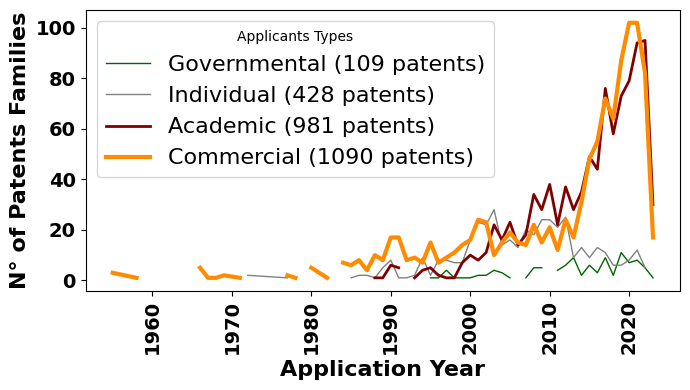

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = count_data.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'Governmental', 'Individual', 'Academic', 'Commercial']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['Governmental'], label='Governmental (109 patents)', color='darkgreen', linewidth=1.)
plt.plot(x, data_trend2['Individual'], label='Individual (428 patents)', color='gray', linewidth=1.)
plt.plot(x, data_trend2['Academic'], label='Academic (981 patents)', color='maroon', linewidth=2)
plt.plot(x, data_trend2['Commercial'], label='Commercial (1090 patents)', color='darkorange', linewidth=3)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants Types',loc='upper left', fontsize=16)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


In [ ]:
# Set the index
categ_data_list2 = categ_data_list.set_index(['Application Year','Applicants_categories']) #
# Split and explode the 'categories' field
categ_data_list2 = categ_data_list2["Applicants_clean"].astype(str).str.split(';;').explode().str.strip().to_frame().reset_index()
#categ_data_list2 = categ_data_list2[categ_data_list['Applicants_clean'] !='nan']#.replace('nan',np.nan).dropna(subset=['Applicants_categories'], axis = 1)
categ_data_list2

,Application Year,Applicants_categories,Applicants_clean
0,2001,Individual,NOVOSIB NII T
1,2001,Individual,UBERKULEZA
2,2001,Commercial,NOVOSIB NII T
3,2001,Commercial,UBERKULEZA
4,2015,Commercial,TechnoPhage
...,...,...,...
4323,1966,Commercial,UPJOHN CO
4324,1966,Commercial,UPJOHN CO
4325,2018,Commercial,TCM BIOTECH INT CORP
4326,2018,Commercial,FLAGSHIP PIONEERING INNOVATIONS V INC


In [ ]:
import pandas as pd

# Creating the pivot table
pivot_table = categ_data_list2.pivot_table(index=['Applicants_clean', 'Applicants_categories'],
                             columns='Application Year',
                             aggfunc='size',  # You can change this to another function, like sum or mean, depending on your data
                             fill_value=0)  # Replaces NaN with 0

pivot_table


Application Year                                                          1955  \
Applicants_clean                                   Applicants_categories         
4D PHARMA LEON S L U                               Commercial                0   
ABAEV IGOR V                                       Governmental              0   
                                                   Individual                0   
ABBOTT LAB                                         Commercial                0   
ABCELEX TECH INC                                   Commercial                0   
...                                                                        ...   
БЕРІНГЕР МАННХАЙМ ГМБХ                             Commercial                0   
“UKRAINIAN MEDICAL STOMATOLOGICAL ACADEMY” HIGH... Academic                  0   
경북대학교 산학협력단                                        Academic                  0   
주식회사 비엠씨                                           Commercial                0   
한국생명공학연구원                                          Academic                  0   

Application Year                                                          1958  \
Applicants_clean                                   Applicants_categories         
4D PHARMA LEON S L U                               Commercial                0   
ABAEV IGOR V                                       Governmental              0   
                                                   Individual                0   
ABBOTT LAB                                         Commercial                0   
ABCELEX TECH INC                                   Commercial                0   
...                                                                        ...   
БЕРІНГЕР МАННХАЙМ ГМБХ                             Commercial                0   
“UKRAINIAN MEDICAL STOMATOLOGICAL ACADEMY” HIGH... Academic                  0   
경북대학교 산학협력단                                        Academic                  0   
주식회사 비엠씨                                           Commercial                0   
한국생명공학연구원                                          Academic                  0   

Application Year                                                          1959  \
Applicants_clean                                   Applicants_categories         
4D PHARMA LEON S L U                               Commercial                0   
ABAEV IGOR V                                       Governmental              0   
                                                   Individual                0   
ABBOTT LAB                                         Commercial                0   
ABCELEX TECH INC                                   Commercial                0   
...                                                                        ...   
БЕРІНГЕР МАННХАЙМ ГМБХ                             Commercial                0   
“UKRAINIAN MEDICAL STOMATOLOGICAL ACADEMY” HIGH... Academic                  0   
경북대학교 산학협력단                                        Academic                  0   
주식회사 비엠씨                                           Commercial                0   
한국생명공학연구원                                          Academic                  0   

Application Year                                                          1963  \
Applicants_clean                                   Applicants_categories         
4D PHARMA LEON S L U                               Commercial                0   
ABAEV IGOR V                                       Governmental              0   
                                                   Individual                0   
ABBOTT LAB                                         Commercial                0   
ABCELEX TECH INC                                   Commercial                0   
...                                                                        ...   
БЕРІНГЕР МАННХАЙМ ГМБХ                             Commercial                0   
“UKRAINIAN MEDICAL STOMATOLOGICAL ACADEMY” HIGH... Academic  

In [ ]:
# Convert non-zero values to 1
pivot_table.iloc[:, 1:] = pivot_table.iloc[:, 1:].applymap(lambda x: 1 if x > 0 else 0)

# Group by 'Applicants_categories' and count non-zero occurrences for each year
grouped_data = pivot_table.groupby('Applicants_categories').sum().T
grouped_data = grouped_data[['Governmental', 'Individual', 'Academic', 'Commercial']]
grouped_data = grouped_data.replace(0,np.nan)
grouped_data

Applicants_categories,Governmental,Individual,Academic,Commercial
Application Year,,,,
1955,NaN,NaN,NaN,3.0
1958,NaN,NaN,NaN,1.0
1959,NaN,2.0,NaN,NaN
1963,1.0,NaN,NaN,NaN
1964,NaN,1.0,NaN,NaN
1966,NaN,NaN,NaN,1.0
1967,NaN,NaN,NaN,1.0
1968,NaN,NaN,NaN,1.0
1969,NaN,1.0,NaN,1.0


###### Graph

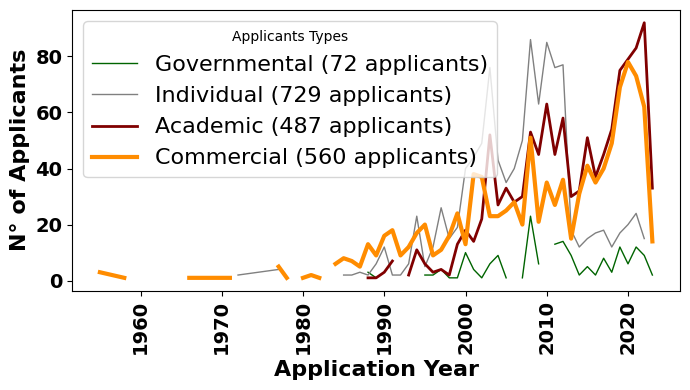

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = grouped_data.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'Governmental', 'Individual', 'Academic', 'Commercial']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['Governmental'], label='Governmental (72 applicants)', color='darkgreen', linewidth=1.)
plt.plot(x, data_trend2['Individual'], label='Individual (729 applicants)', color='gray', linewidth=1.)
plt.plot(x, data_trend2['Academic'], label='Academic (487 applicants)', color='maroon', linewidth=2)
plt.plot(x, data_trend2['Commercial'], label='Commercial (560 applicants)', color='darkorange', linewidth=3)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Applicants', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants Types',loc='upper left', fontsize=16)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


## classify_entities: Newcomer/ Continuant/ Transient/ Terminator

In [ ]:
import pandas as pd

def classify_entities(dataframe, entity_column, period_column):
    # Extract unique entities and periods
    unique_entities = set()
    for entities in dataframe[entity_column].dropna():
        unique_entities.update(str(entities).split(';;'))
    unique_periods = sorted(dataframe[period_column].dropna().astype(str).unique())

    # Initialize a DataFrame to hold the classification results
    classification_df = pd.DataFrame(index=list(unique_entities), columns=unique_periods + ['Last Classification'])

    # Track entity participation in each period
    entity_participation = {entity: [] for entity in unique_entities}
    for period in unique_periods:
        period_entities = set()
        for entities in dataframe[dataframe[period_column].astype(str) == period][entity_column].dropna():
            period_entities.update(str(entities).split(';;'))
        for entity in unique_entities:
            entity_participation[entity].append(entity in period_entities)

    # Classify entities for each period
    last_period = unique_periods[-1]
    for entity, participation in entity_participation.items():
        last_classification = None
        for i, active in enumerate(participation):
            # Determine the classification based on entire history
            ever_active_before = any(participation[:i])
            ever_active_after = any(participation[i+1:])

            if not active:
                classification = None  # Not active in the current period
            elif unique_periods[i] == last_period:
                classification = 'Continuant' if ever_active_before else 'Newcomer'
            elif ever_active_before and ever_active_after:
                classification = 'Continuant'
            elif ever_active_before:
                classification = 'Terminator'
            elif ever_active_after:
                classification = 'Newcomer'
            else:
                classification = 'Transient'  # Active only in the current period

            classification_df.at[entity, unique_periods[i]] = classification
            if classification is not None:
                last_classification = classification

        classification_df.at[entity, 'Last Classification'] = last_classification
        # Rename the index
        classification_df.index.name = entity_column
        #classification_df = classification_df.reset_index()

    return classification_df

### applicants

In [ ]:
classify_entities_applicants = classify_entities(data, 'Applicants_clean', 'Application Year')#.rename({'index':'Applicants'}, axis=1)
classify_entities_applicants = classify_entities_applicants.reset_index()
classify_entities_applicants

,Applicants_clean,1955,1958,1959,1963,1964,1966,1967,1968,1969,1971,1972,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,Last Classification
0,TIANJIN MEDICAL UNIV GENERAL HOSPITAL,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,Transient
1,DONOGHUE DANIEL J,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None,Transient
2,UNIV TIANJIN AGRICULTURAL,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,Transient
3,OTSUKA PHARMA CO LTD,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient
4,INST SOIL SCIENCE CAS,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Newcomer,Terminator,None,None,None,None,Terminator
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1849,JIANGSU YUANBEN BIOTECHNOLOGY CO LTD,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,Transient
1850,WANG SHUANGKUN,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,Transient
1851,XIANGYA HOSPITAL CENTRAL SOUTH UNIV,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,Transient
1852,ZRJACHKIN NIKOLAJ IVANOVICH,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient


In [ ]:
classify_entities_applicants['Last Classification'].value_counts()

Transient     1462
Terminator     347
Newcomer        25
Continuant      20
Name: Last Classification, dtype: int64

In [ ]:
classify_entities_applicants_df = classify_entities_applicants.drop('Applicants_clean', axis=1).drop('Last Classification', axis=1)
classify_entities_applicants_df

,1955,1958,1959,1963,1964,1966,1967,1968,1969,1971,1972,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None
1,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None
2,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None
3,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
4,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Newcomer,Terminator,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1849,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None
1850,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None
1851,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None
1852,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None


In [ ]:
import pandas as pd

# Convert to DataFrame
df = classify_entities_applicants_df

# Counting the occurrences of each category per year

count_df = df.apply(pd.Series.value_counts).fillna(0).astype(int)


count_df = count_df.T.reset_index()
count_df

,index,Continuant,Newcomer,Terminator,Transient
0,1955,0,0,0,3
1,1958,0,0,0,1
2,1959,0,0,0,2
3,1963,0,0,0,1
4,1964,0,0,0,1
5,1966,0,1,0,0
6,1967,0,0,1,0
7,1968,0,0,0,1
8,1969,0,0,0,2
9,1971,0,0,0,2


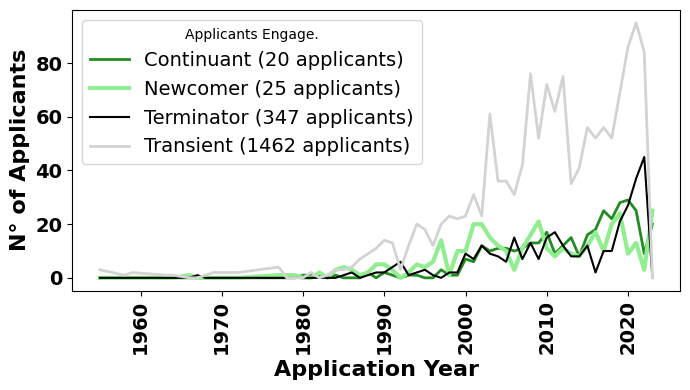

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = count_df.reset_index()

# Rename your columns for easier access
#data_trend.columns = ['Application Year', 'Continuant', 'Newcomer', 'Terminator', 'Transient']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('index')

# Define the x (Year) values
x = data_trend2['index'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['Continuant'], label='Continuant (20 applicants)', color='forestgreen', linewidth=2.)
plt.plot(x, data_trend2['Newcomer'], label='Newcomer (25 applicants)', color='lightgreen', linewidth=3.)
plt.plot(x, data_trend2['Terminator'], label='Terminator (347 applicants)', color='black', linewidth=1.5)
plt.plot(x, data_trend2['Transient'], label='Transient (1462 applicants)', color='lightgrey', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Applicants', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants Engage.', loc='upper left', fontsize=14)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


#### add columns to data

In [ ]:
df1 = data
df2 =  classify_entities_applicants
col_old =  'Applicants_clean'
col_clean =  'Last Classification'
col_name = 'Applicants_Last_Classification'

data = clean_entities(df1, df2, col_old, col_clean, col_name)#.reset_index()
data

,#,Jurisdiction,Kind,Display Key,Lens ID,Publication Date,Publication Year,Application Number,Application Date,Priority Numbers,Earliest Priority Date,Title,Abstract,Applicants,Inventors,Owners,URL,Document Type,Has Full Text,Cites Patent Count,Cited by Patent Count,Simple Family Size,Extended Family Size,Sequence Count,CPC Classifications,IPCR Classifications,US Classifications,NPL Citation Count,NPL Resolved Citation Count,NPL Resolved Lens ID(s),NPL Resolved External ID(s),NPL Citations,Legal Status,Topic N°,Application Year,Earliest Priority Year,Application_Year_Range,IPCR Sections,IPCR Class,IPCR Subclass,Jurisdiction_name,Jurisdiction_Region,Inventors_clean,Applicants_clean,applicants_clean_not_individual,Applicants_countries,Applicants_regions,Applicants_categories,Applicants_Last_Classification
0,1,RU,C2,RU 2214829 C2,069-390-611-717-343,2003-10-27,2003,RU 2001129920 A,2001-11-05,RU 2001129920 A,2001-11-05,METHOD FOR TUBERCULOSIS PHAGOTHERAPY,"FIELD: medicine, phthisiology. SUBSTANCE: meth...",NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D,NaN,https://lens.org/069-390-611-717-343,Granted Patent,no,0,4,1,1,0,NaN,A61K35/76;;A61P31/06,NaN,0,0,NaN,NaN,NaN,EXPIRED,Topic 2,2001,2001,2000-2004,A,A61,A61K;;A61P,Russia,Europe,KURUNOVA N N;;KURUNOV JU N;;SHATALOVA N D,NOVOSIB NII T;;UBERKULEZA,NOVOSIB NII T,Russia,Europe,Individual;;Commercial,Transient
1,2,JP,A,JP 2016104011 A,114-759-028-882-736,2016-06-09,2016,JP 2015243657 A,2015-12-14,US 38401510 P,2010-09-17,"ANTIBACTERIAL PHAGES, PHAGE PEPTIDES AND USE M...",PROBLEM TO BE SOLVED: To provide novel bacteri...,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...,NaN,https://lens.org/114-759-028-882-736,Patent Application,no,1,1,48,48,1300,C12N2795/00032;;A61K31/505;;A61K31/7056;;A61K3...,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2010,2015-2019,A;;C,A61;;C12,A61K;;A61P;;C12N,Japan,Asia,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe,Commercial,Terminator
2,3,AU,A1,AU 2015/255318 A1,094-982-928-461-863,2015-12-03,2015,AU 2015/255318 A,2015-11-13,AU 2015/255318 A;;AU 2010/211456 A;;US 2183450...,2009-02-06,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",https://lens.org/094-982-928-461-863,Patent Application,no,0,0,3,45,0,NaN,A61K35/76;;C12N9/14;;G01N33/569,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2009,2015-2019,A;;C;;G,A61;;C12;;G01,A61K;;C12N;;G01N,Australia,Oceania,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe,Commercial,Terminator
3,4,US,A1,US 2016/0022747 A1,167-908-891-122-112,2016-01-28,2016,US 201514852112 A,2015-09-11,US 201514852112 A;;US 201113148009 A;;PT 20100...,2009-02-06,"Antibacterial Phage, Phage Peptides and Method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,https://lens.org/167-908-891-122-112,Patent Application,yes,0,1,42,45,816,A61K38/00;;A61K45/06;;C07K14/005;;C12N7/00;;C1...,A61K35/76;;A61K9/00;;C12N7/00,NaN,0,0,NaN,NaN,NaN,ACTIVE,NaN,2015,2009,2015-2019,A;;C,A61;;C12,A61K;;C12N,United States,North America,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe,Commercial,Terminator
4,5,AU,A1,AU 2017/204331 A1,112-018-476-081-94X,2017-07-13,2017,AU 2017/204331 A,2017-06-26,AU 2017/204331 A;;AU 2015/255313 A;;AU 2011/30...,2011-09-19,"Antibacterial 

#### plot graph applicant count / year

In [ ]:
classification_df = classify_entities(data, 'Applicants_clean', 'Application Year').reset_index().set_index(['Applicants_clean','Last Classification'])#.rename({'index':'Applicants'}, axis=1)
classification_df

,,1955,1958,1959,1963,1964,1966,1967,1968,1969,1971,1972,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023
Applicants_clean,Last Classification,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
TIANJIN MEDICAL UNIV GENERAL HOSPITAL,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None
DONOGHUE DANIEL J,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None
UNIV TIANJIN AGRICULTURAL,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None
OTSUKA PHARMA CO LTD,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
INST SOIL SCIENCE CAS,Terminator,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Newcomer,Terminator,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
JIANGSU YUANBEN BIOTECHNOLOGY CO LTD,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None
WANG SHUANGKUN,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None
XIANGYA HOSPITAL CENTRAL SOUTH UNIV,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None


###### table

In [ ]:
import pandas as pd

# Assuming 'data' is your DataFrame
# Example: data = pd.read_csv('your_file.csv')  # Replace with your actual data loading method
data_clas = classification_df.reset_index()
# Melt the DataFrame to long format
long_format = data_clas.melt(id_vars=['Applicants_clean', 'Last Classification'], var_name='Year', value_name='Element')

# Filter out rows where 'Element' is 'None'
filtered_data = long_format[long_format['Element'] != 'None']

# Count the occurrences of each element by year
count_data = filtered_data.groupby(['Year', 'Element']).size().unstack(fill_value=0)

# The result 'count_data' is a DataFrame with years as rows and elements as columns, showing counts
count_data = count_data.replace(0,np.nan)
count_data

Element,Continuant,Newcomer,Terminator,Transient
Year,,,,
1955,NaN,NaN,NaN,3.0
1958,NaN,NaN,NaN,1.0
1959,NaN,NaN,NaN,2.0
1963,NaN,NaN,NaN,1.0
1964,NaN,NaN,NaN,1.0
1966,NaN,1.0,NaN,NaN
1967,NaN,NaN,1.0,NaN
1968,NaN,NaN,NaN,1.0
1969,NaN,NaN,NaN,2.0


###### Graph

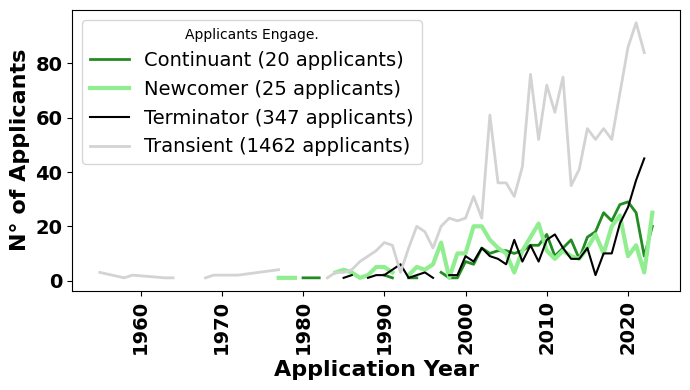

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = count_data.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'Continuant', 'Newcomer', 'Terminator', 'Transient']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['Continuant'], label='Continuant (20 applicants)', color='forestgreen', linewidth=2.)
plt.plot(x, data_trend2['Newcomer'], label='Newcomer (25 applicants)', color='lightgreen', linewidth=3.)
plt.plot(x, data_trend2['Terminator'], label='Terminator (347 applicants)', color='black', linewidth=1.5)
plt.plot(x, data_trend2['Transient'], label='Transient (1462 applicants)', color='lightgrey', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Applicants', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants Engage.', loc='upper left', fontsize=14)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


#### plot graph applicant engagement production / year

In [ ]:
# Set the index
categ_data = data.set_index(['Lens ID']) #'Application Year',
# Split and explode the 'categories' field
categ_data_list = categ_data["Applicants_Last_Classification"].astype(str).str.split(';;').explode().str.strip().to_frame().reset_index()
categ_data_list

,Lens ID,Applicants_Last_Classification
0,069-390-611-717-343,Transient
1,114-759-028-882-736,Terminator
2,094-982-928-461-863,Terminator
3,167-908-891-122-112,Terminator
4,112-018-476-081-94X,Terminator
...,...,...
2542,150-422-589-010-681,Terminator
2543,058-819-734-343-222,Terminator
2544,104-088-331-962-598,Transient
2545,147-487-067-847-82X,Transient


In [ ]:
# Set the index
categ_data = data.set_index(['Application Year','Applicants_regions','Applicants_countries','Lens ID']) #
# Split and explode the 'categories' field
categ_data_list = categ_data["Applicants_Last_Classification"].astype(str).str.split(';;').explode().str.strip().to_frame().reset_index()
categ_data_list = categ_data_list[categ_data_list['Applicants_Last_Classification'] !='nan']#.replace('nan',np.nan).dropna(subset=['Applicants_categories'], axis = 1)
categ_data_list

,Application Year,Applicants_regions,Applicants_countries,Lens ID,Applicants_Last_Classification
0,2001,Europe,Russia,069-390-611-717-343,Transient
1,2015,Europe,Portugal,114-759-028-882-736,Terminator
2,2015,Europe,Portugal,094-982-928-461-863,Terminator
3,2015,Europe,Portugal,167-908-891-122-112,Terminator
4,2017,Europe,Portugal,112-018-476-081-94X,Terminator
...,...,...,...,...,...
2542,1966,North America,United States,150-422-589-010-681,Terminator
2543,1966,North America,United States,058-819-734-343-222,Terminator
2544,2018,Asia,Taiwan,104-088-331-962-598,Transient
2545,2018,North America,United States,147-487-067-847-82X,Transient


In [ ]:
categ_data_list["Applicants_Last_Classification"].value_counts()

Terminator    1189
Transient     1133
Continuant     183
Newcomer        20
Name: Applicants_Last_Classification, dtype: int64

In [ ]:
# Count the occurrences of each element by year
count_data = categ_data_list.groupby(['Application Year', 'Applicants_Last_Classification']).size().unstack(fill_value=0)
#count_data = count_data[['Governmental', 'Individual', 'Academic', 'Commercial']]
count_data = count_data.replace(0,np.nan)
count_data

Applicants_Last_Classification,Continuant,Newcomer,Terminator,Transient
Application Year,,,,
1955,NaN,NaN,NaN,3.0
1958,NaN,NaN,NaN,1.0
1959,NaN,NaN,NaN,1.0
1963,NaN,NaN,NaN,1.0
1964,NaN,NaN,NaN,1.0
1966,NaN,NaN,5.0,NaN
1967,NaN,NaN,1.0,NaN
1968,NaN,NaN,NaN,1.0
1969,NaN,NaN,NaN,3.0


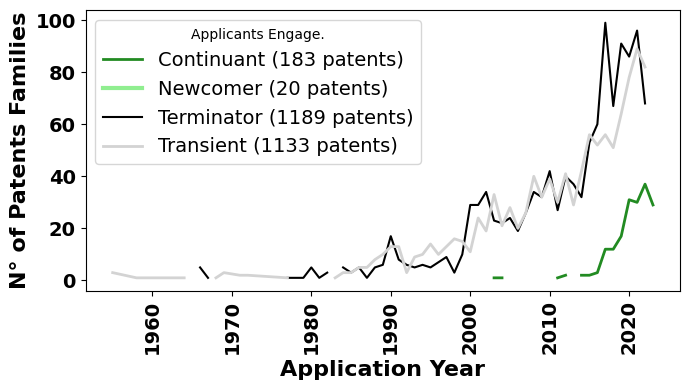

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = count_data.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'Continuant', 'Newcomer', 'Terminator', 'Transient']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['Continuant'], label='Continuant (183 patents)', color='forestgreen', linewidth=2.)
plt.plot(x, data_trend2['Newcomer'], label='Newcomer (20 patents)', color='lightgreen', linewidth=3.)
plt.plot(x, data_trend2['Terminator'], label='Terminator (1189 patents)', color='black', linewidth=1.5)
plt.plot(x, data_trend2['Transient'], label='Transient (1133 patents)', color='lightgrey', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants Engage.', loc='upper left', fontsize=14)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


#### supplementary table 2

In [ ]:
# Set the index
types_data = data.set_index(['Applicants_regions','Applicants_countries','Lens ID','Applicants_clean']) #
# Split and explode the 'categories' field
types_data_list = types_data["Applicants_categories"].astype(str).str.split(';;').explode().str.strip().to_frame().reset_index()
types_data_list = types_data_list[types_data_list['Applicants_categories'] !='nan']#.replace('nan',np.nan).dropna(subset=['Applicants_categories'], axis = 1)
types_data_list

,Applicants_regions,Applicants_countries,Lens ID,Applicants_clean,Applicants_categories
0,Europe,Russia,069-390-611-717-343,NOVOSIB NII T;;UBERKULEZA,Individual
1,Europe,Russia,069-390-611-717-343,NOVOSIB NII T;;UBERKULEZA,Commercial
2,Europe,Portugal,114-759-028-882-736,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Commercial
3,Europe,Portugal,094-982-928-461-863,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Commercial
4,Europe,Portugal,167-908-891-122-112,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Commercial
...,...,...,...,...,...
2632,North America,United States,150-422-589-010-681,UPJOHN CO,Commercial
2633,North America,United States,058-819-734-343-222,UPJOHN CO,Commercial
2634,Asia,Taiwan,104-088-331-962-598,TCM BIOTECH INT CORP,Commercial
2635,North America,United States,147-487-067-847-82X,FLAGSHIP PIONEERING INNOVATIONS V INC,Commercial


In [ ]:
# Set the index
types_data_list = types_data_list.set_index(['Applicants_regions','Applicants_categories','Lens ID','Applicants_clean']) #
# Split and explode the 'categories' field
types_data_list2 = types_data_list["Applicants_countries"].astype(str).str.split(';;').explode().str.strip().to_frame().reset_index()
types_data_list2 = types_data_list2[types_data_list2['Applicants_countries'] !='nan']#.replace('nan',np.nan).dropna(subset=['Applicants_categories'], axis = 1)
types_data_list2

,Applicants_regions,Applicants_categories,Lens ID,Applicants_clean,Applicants_countries
0,Europe,Individual,069-390-611-717-343,NOVOSIB NII T;;UBERKULEZA,Russia
1,Europe,Commercial,069-390-611-717-343,NOVOSIB NII T;;UBERKULEZA,Russia
2,Europe,Commercial,114-759-028-882-736,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal
3,Europe,Commercial,094-982-928-461-863,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal
4,Europe,Commercial,167-908-891-122-112,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal
...,...,...,...,...,...
2667,North America,Commercial,150-422-589-010-681,UPJOHN CO,United States
2668,North America,Commercial,058-819-734-343-222,UPJOHN CO,United States
2669,Asia,Commercial,104-088-331-962-598,TCM BIOTECH INT CORP,Taiwan
2670,North America,Commercial,147-487-067-847-82X,FLAGSHIP PIONEERING INNOVATIONS V INC,United States


In [ ]:
# Set the index
types_data_list2 = types_data_list2.set_index(['Applicants_countries','Applicants_categories','Lens ID','Applicants_clean']) #
# Split and explode the 'categories' field
types_data_list3 = types_data_list2["Applicants_regions"].astype(str).str.split(';;').explode().str.strip().to_frame().reset_index()
types_data_list3 = types_data_list3[types_data_list3['Applicants_regions'] !='nan']#.replace('nan',np.nan).dropna(subset=['Applicants_categories'], axis = 1)
types_data_list3

,Applicants_countries,Applicants_categories,Lens ID,Applicants_clean,Applicants_regions
0,Russia,Individual,069-390-611-717-343,NOVOSIB NII T;;UBERKULEZA,Europe
1,Russia,Commercial,069-390-611-717-343,NOVOSIB NII T;;UBERKULEZA,Europe
2,Portugal,Commercial,114-759-028-882-736,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Europe
3,Portugal,Commercial,094-982-928-461-863,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Europe
4,Portugal,Commercial,167-908-891-122-112,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Europe
...,...,...,...,...,...
2725,United States,Commercial,150-422-589-010-681,UPJOHN CO,North America
2726,United States,Commercial,058-819-734-343-222,UPJOHN CO,North America
2727,Taiwan,Commercial,104-088-331-962-598,TCM BIOTECH INT CORP,Asia
2728,United States,Commercial,147-487-067-847-82X,FLAGSHIP PIONEERING INNOVATIONS V INC,North America


In [ ]:
# Set the index
types_data_list3 = types_data_list3.set_index(['Applicants_countries','Applicants_categories','Lens ID','Applicants_regions']) #
# Split and explode the 'categories' field
types_data_list4 = types_data_list3["Applicants_clean"].astype(str).str.split(';;').explode().str.strip().str.title().to_frame().reset_index()
types_data_list4 = types_data_list4[types_data_list4['Applicants_clean'] !='nan']#.replace('nan',np.nan).dropna(subset=['Applicants_categories'], axis = 1)
types_data_list4 = types_data_list4.drop_duplicates()
types_data_list4

,Applicants_countries,Applicants_categories,Lens ID,Applicants_regions,Applicants_clean
0,Russia,Individual,069-390-611-717-343,Europe,Novosib Nii T
1,Russia,Individual,069-390-611-717-343,Europe,Uberkuleza
2,Russia,Commercial,069-390-611-717-343,Europe,Novosib Nii T
3,Russia,Commercial,069-390-611-717-343,Europe,Uberkuleza
4,Portugal,Commercial,114-759-028-882-736,Europe,Technophage
...,...,...,...,...,...
4717,United States,Commercial,150-422-589-010-681,North America,Upjohn Co
4718,United States,Commercial,058-819-734-343-222,North America,Upjohn Co
4719,Taiwan,Commercial,104-088-331-962-598,Asia,Tcm Biotech Int Corp
4720,United States,Commercial,147-487-067-847-82X,North America,Flagship Pioneering Innovations V Inc


### Inventors

In [ ]:
classify_entities_inventors = classify_entities(data, 'Inventors_clean', 'Application Year')##.rename({'index':'Applicants'}, axis=1)
classify_entities_inventors = classify_entities_inventors.reset_index()
classify_entities_inventors

,Inventors_clean,1955,1958,1959,1963,1964,1966,1967,1968,1969,1971,1972,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,Last Classification
0,SHUMEIKO IHOR ANATOLIIOVYCH,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,Transient
1,LIU CONG,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,Transient
2,BAEK MIN SUK,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,Transient
3,ZHAO QIAN,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,Transient
4,TIAN MIAOMIAO,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,Transient
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5362,WINTER GREG,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient
5363,WANG LILI,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Newcomer,None,None,None,Continuant,None,None,None,None,Continuant,Continuant
5364,JIMENEZ SANCHEZ ANA PAULA,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,Transient
5365,YUAN WEIJIE,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,Transient


In [ ]:
classify_entities_inventors['Last Classification'].value_counts()

Transient     4198
Terminator     955
Newcomer       123
Continuant      91
Name: Last Classification, dtype: int64

#### add columns to data

In [ ]:
df1 = data
df2 =  classify_entities_inventors
col_old =  'Inventors_clean'
col_clean =  'Last Classification'
col_name = 'Inventors_Last_Classification'

data = clean_entities(df1, df2, col_old, col_clean, col_name)#.reset_index()
data

,#,Jurisdiction,Kind,Display Key,Lens ID,Publication Date,Publication Year,Application Number,Application Date,Priority Numbers,Earliest Priority Date,Title,Abstract,Applicants,Inventors,Owners,URL,Document Type,Has Full Text,Cites Patent Count,Cited by Patent Count,Simple Family Size,Extended Family Size,Sequence Count,CPC Classifications,IPCR Classifications,US Classifications,NPL Citation Count,NPL Resolved Citation Count,NPL Resolved Lens ID(s),NPL Resolved External ID(s),NPL Citations,Legal Status,Topic N°,Application Year,Earliest Priority Year,Application_Year_Range,IPCR Sections,IPCR Class,IPCR Subclass,Jurisdiction_name,Jurisdiction_Region,Inventors_clean,Applicants_clean,applicants_clean_not_individual,Applicants_countries,Applicants_regions,Applicants_categories,Applicants_Last_Classification,Inventors_Last_Classification
0,1,RU,C2,RU 2214829 C2,069-390-611-717-343,2003-10-27,2003,RU 2001129920 A,2001-11-05,RU 2001129920 A,2001-11-05,METHOD FOR TUBERCULOSIS PHAGOTHERAPY,"FIELD: medicine, phthisiology. SUBSTANCE: meth...",NOVOSIB NII T;;UBERKULEZA,KURUNOV JU N;;KURUNOVA N N;;SHATALOVA N D,NaN,https://lens.org/069-390-611-717-343,Granted Patent,no,0,4,1,1,0,NaN,A61K35/76;;A61P31/06,NaN,0,0,NaN,NaN,NaN,EXPIRED,Topic 2,2001,2001,2000-2004,A,A61,A61K;;A61P,Russia,Europe,KURUNOVA N N;;KURUNOV JU N;;SHATALOVA N D,NOVOSIB NII T;;UBERKULEZA,NOVOSIB NII T,Russia,Europe,Individual;;Commercial,Transient,Transient
1,2,JP,A,JP 2016104011 A,114-759-028-882-736,2016-06-09,2016,JP 2015243657 A,2015-12-14,US 38401510 P,2010-09-17,"ANTIBACTERIAL PHAGES, PHAGE PEPTIDES AND USE M...",PROBLEM TO BE SOLVED: To provide novel bacteri...,TECNIFAR-INDUSTRIA TECNICA FARM S A;;TECHNOPHA...,MIGUEL ANGELO DA COSTA GARCIA;;CARLOS JORGE SO...,NaN,https://lens.org/114-759-028-882-736,Patent Application,no,1,1,48,48,1300,C12N2795/00032;;A61K31/505;;A61K31/7056;;A61K3...,C12N7/00;;A61K35/76;;A61P31/04;;C12N15/09,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2010,2015-2019,A;;C,A61;;C12,A61K;;A61P;;C12N,Japan,Asia,ANA RAQUEL MARTINS BARBOSA;;CARLOS JORGE SOUSA...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe,Commercial,Terminator,Terminator
2,3,AU,A1,AU 2015/255318 A1,094-982-928-461-863,2015-12-03,2015,AU 2015/255318 A,2015-11-13,AU 2015/255318 A;;AU 2010/211456 A;;US 2183450...,2009-02-06,"Antibacterial phage, phage peptides and method...",The present invention is directed to the field...,TECNIFAR INDÚSTRIA TÉCNICA FARMACÉUTICA S A;;T...,DA COSTA GARCIA MIGUEL ÂNGELO;;SOUSA DE SÃO JO...,"TECHNOPHAGE, INVESTIGACAO E DESENVOLVIMENTO EM...",https://lens.org/094-982-928-461-863,Patent Application,no,0,0,3,45,0,NaN,A61K35/76;;C12N9/14;;G01N33/569,NaN,0,0,NaN,NaN,NaN,ACTIVE,Topic 3,2015,2009,2015-2019,A;;C;;G,A61;;C12;;G01,A61K;;C12N;;G01N,Australia,Oceania,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe,Commercial,Terminator,Terminator;;Transient
3,4,US,A1,US 2016/0022747 A1,167-908-891-122-112,2016-01-28,2016,US 201514852112 A,2015-09-11,US 201514852112 A;;US 201113148009 A;;PT 20100...,2009-02-06,"Antibacterial Phage, Phage Peptides and Method...",The present invention is directed to the field...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,DA COSTA GARCIA MIGUEL ANGELO;;SOUSA DE SAO JO...,TECHNOPHAGE INVESTIGACAO E DESENVOLVIMENTO EM ...,https://lens.org/167-908-891-122-112,Patent Application,yes,0,1,42,45,816,A61K38/00;;A61K45/06;;C07K14/005;;C12N7/00;;C1...,A61K35/76;;A61K9/00;;C12N7/00,NaN,0,0,NaN,NaN,NaN,ACTIVE,NaN,2015,2009,2015-2019,A;;C,A61;;C12,A61K;;C12N,United States,North America,CARLOS JORGE SOUSA DE SAO JOSE;;CLARA ISABEL R...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,Portugal,Europe,Commercial,Terminator,Terminator;;Transient
4,5,AU,A1,AU 2017/204331 A1,112-018-476-081-94X,2017-07-13,2017,AU 2017/2

#### plot graph applicant count / year

In [ ]:
classification_df = classify_entities(data, 'Inventors_clean', 'Application Year')#.reset_index().rename({'index':'Applicants'}, axis=1)
classification_df


,1955,1958,1959,1963,1964,1966,1967,1968,1969,1971,1972,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,Last Classification
Inventors_clean,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SHUMEIKO IHOR ANATOLIIOVYCH,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,Transient
LIU CONG,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,Transient
BAEK MIN SUK,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,Transient
ZHAO QIAN,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,Transient
TIAN MIAOMIAO,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,Transient
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WINTER GREG,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient
WANG LILI,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Newcomer,None,None,None,Continuant,None,None,None,None,Continuant,Continuant
JIMENEZ SANCHEZ ANA PAULA,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,Transient


In [ ]:
classification_df.reset_index().set_index(['Inventors_clean','Last Classification'])

,,1955,1958,1959,1963,1964,1966,1967,1968,1969,1971,1972,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023
Inventors_clean,Last Classification,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
SHUMEIKO IHOR ANATOLIIOVYCH,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None
LIU CONG,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None
BAEK MIN SUK,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None
ZHAO QIAN,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None
TIAN MIAOMIAO,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WINTER GREG,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None
WANG LILI,Continuant,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Newcomer,None,None,None,Continuant,None,None,None,None,Continuant
JIMENEZ SANCHEZ ANA PAULA,Transient,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,None,Transient,None,None,None,None,None,None,None


###### table

In [ ]:
import pandas as pd

# Assuming 'data' is your DataFrame
# Example: data = pd.read_csv('your_file.csv')  # Replace with your actual data loading method
data_clas = classification_df.reset_index()
# Melt the DataFrame to long format
long_format = data_clas.melt(id_vars=['Inventors_clean', 'Last Classification'], var_name='Year', value_name='Element')

# Filter out rows where 'Element' is 'None'
filtered_data = long_format[long_format['Element'] != 'None']

# Count the occurrences of each element by year
count_data = filtered_data.groupby(['Year', 'Element']).size().unstack(fill_value=0)

# The result 'count_data' is a DataFrame with years as rows and elements as columns, showing counts
count_data = count_data.replace(0,np.nan)
count_data

Element,Continuant,Newcomer,Terminator,Transient
Year,,,,
1955,NaN,NaN,NaN,5.0
1963,NaN,NaN,NaN,1.0
1967,NaN,NaN,NaN,1.0
1969,NaN,NaN,NaN,1.0
1977,NaN,NaN,NaN,10.0
1978,NaN,NaN,NaN,2.0
1979,NaN,NaN,NaN,2.0
1980,NaN,2.0,NaN,2.0
1981,1.0,1.0,1.0,7.0


###### Graph

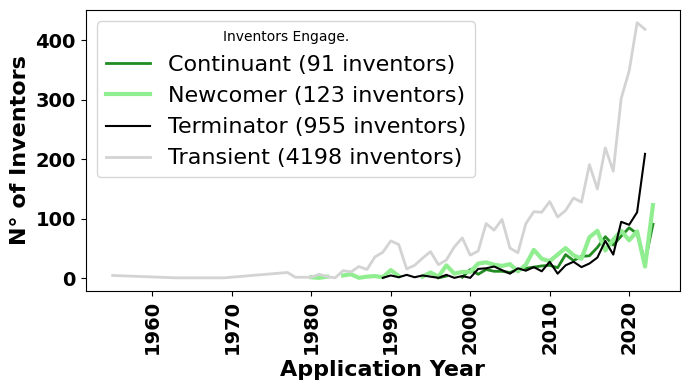

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = count_data.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'Continuant', 'Newcomer', 'Terminator', 'Transient']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['Continuant'], label='Continuant (91 inventors)', color='forestgreen', linewidth=2.)
plt.plot(x, data_trend2['Newcomer'], label='Newcomer (123 inventors)', color='lightgreen', linewidth=3.)
plt.plot(x, data_trend2['Terminator'], label='Terminator (955 inventors)', color='black', linewidth=1.5)
plt.plot(x, data_trend2['Transient'], label='Transient (4198 inventors)', color='lightgrey', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Inventors', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Inventors Engage.', fontsize=16,loc='upper left')
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


#### plot graph applicant engagement production / year

In [ ]:
# Set the index
categ_data = data.set_index(['Lens ID']) #'Application Year',
# Split and explode the 'categories' field
categ_data_list = categ_data["Inventors_Last_Classification"].astype(str).str.split(';;').explode().str.strip().to_frame().reset_index()
categ_data_list

,Lens ID,Inventors_Last_Classification
0,069-390-611-717-343,Transient
1,114-759-028-882-736,Terminator
2,094-982-928-461-863,Terminator
3,094-982-928-461-863,Transient
4,167-908-891-122-112,Terminator
...,...,...
3476,150-422-589-010-681,nan
3477,058-819-734-343-222,nan
3478,104-088-331-962-598,Transient
3479,147-487-067-847-82X,Transient


In [ ]:
# Set the index
categ_data = data.set_index(['Application Year','Applicants_regions','Applicants_countries','Lens ID']) #
# Split and explode the 'categories' field
categ_data_list = categ_data["Inventors_Last_Classification"].astype(str).str.split(';;').explode().str.strip().to_frame().reset_index()
categ_data_list = categ_data_list[categ_data_list['Inventors_Last_Classification'] !='nan']#.replace('nan',np.nan).dropna(subset=['Applicants_categories'], axis = 1)
categ_data_list

,Application Year,Applicants_regions,Applicants_countries,Lens ID,Inventors_Last_Classification
0,2001,Europe,Russia,069-390-611-717-343,Transient
1,2015,Europe,Portugal,114-759-028-882-736,Terminator
2,2015,Europe,Portugal,094-982-928-461-863,Terminator
3,2015,Europe,Portugal,094-982-928-461-863,Transient
4,2015,Europe,Portugal,167-908-891-122-112,Terminator
...,...,...,...,...,...
3472,2007,,,076-974-503-967-647,Transient
3475,1999,North America,United States,058-460-942-795-76X,Transient
3478,2018,Asia,Taiwan,104-088-331-962-598,Transient
3479,2018,North America,United States,147-487-067-847-82X,Transient


In [ ]:
categ_data_list["Inventors_Last_Classification"].value_counts()

Transient     1674
Terminator    1467
Continuant     266
Newcomer        39
Name: Inventors_Last_Classification, dtype: int64

In [ ]:
# Count the occurrences of each element by year
count_data = categ_data_list.groupby(['Application Year', 'Inventors_Last_Classification']).size().unstack(fill_value=0)
#count_data = count_data[['Governmental', 'Individual', 'Academic', 'Commercial']]
count_data = count_data.replace(0,np.nan)
count_data

Inventors_Last_Classification,Continuant,Newcomer,Terminator,Transient
Application Year,,,,
1955,NaN,NaN,NaN,3.0
1963,NaN,NaN,NaN,1.0
1967,NaN,NaN,NaN,1.0
1969,NaN,NaN,NaN,1.0
1977,NaN,NaN,NaN,2.0
1978,NaN,NaN,NaN,1.0
1979,NaN,NaN,NaN,1.0
1980,NaN,NaN,2.0,5.0
1981,NaN,NaN,1.0,3.0


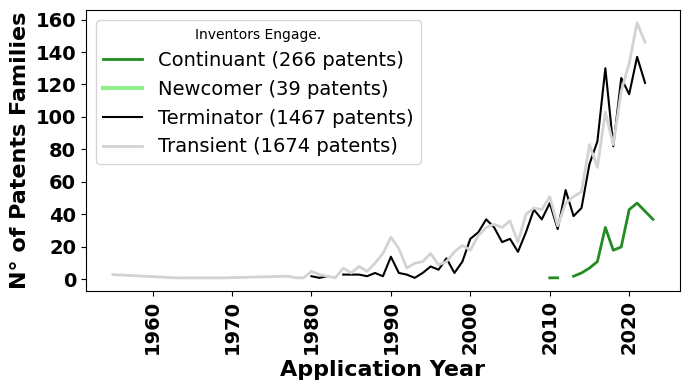

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = count_data.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'Continuant', 'Newcomer', 'Terminator', 'Transient']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['Continuant'], label='Continuant (266 patents)', color='forestgreen', linewidth=2.)
plt.plot(x, data_trend2['Newcomer'], label='Newcomer (39 patents)', color='lightgreen', linewidth=3.)
plt.plot(x, data_trend2['Terminator'], label='Terminator (1467 patents)', color='black', linewidth=1.5)
plt.plot(x, data_trend2['Transient'], label='Transient (1674 patents)', color='lightgrey', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Inventors Engage.', loc='upper left', fontsize=14)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


# correlation between the annual growth in the number of coutntries, applicants and inventors against patent filings, with Pearson Correlation Coefficients

## table

In [ ]:
# Set the index
applicants_data = data.set_index(['Application Year'])

# Split and explode the 'Applicants' field
applicants_countries_list = applicants_data['Applicants_countries'].str.split(';;').explode().str.strip().to_frame().reset_index().drop_duplicates()
applicants_list = applicants_data['Applicants_clean'].str.split(';;').explode().str.strip().to_frame().reset_index().drop_duplicates()
inventors_list = applicants_data['Inventors_clean'].str.split(';;').explode().str.strip().to_frame().reset_index().drop_duplicates()
applicants_list

,Application Year,Applicants_clean
0,2001,NOVOSIB NII T
1,2001,UBERKULEZA
2,2015,TechnoPhage
3,2015,TECNIFAR INDUSTRIA TECNICA FARMACEUTICA SA
8,2017,TechnoPhage
...,...,...
3328,2007,CHUNQING LUO
3331,1999,GAMBRO INC
3334,2018,TCM BIOTECH INT CORP
3335,2018,FLAGSHIP PIONEERING INNOVATIONS V INC


In [ ]:
applicants_countries_count_year = applicants_countries_list['Application Year'].value_counts().rename('Applicants countries counts')#.reset_index().sort_values('index', ascending=False)
applicants_count_year = applicants_list['Application Year'].value_counts().rename('Applicants counts')#.reset_index().sort_values('index', ascending=False)
inventors_count_year = inventors_list['Application Year'].value_counts().rename('Inventors counts')#.reset_index().sort_values('index', ascending=False)
#inventors_count_year

In [ ]:
#count_year_1

In [ ]:
count_year_total_patent = data['Application Year'].value_counts().rename('Application')
data_entities_trend_count = pd.concat([count_year_total_patent, applicants_countries_count_year], axis=1).fillna(0).astype(int)#.reset_index().rename(columns={'index': 'Year'}).sort_values('Year', ascending=False)
data_entities_trend_count = pd.concat([data_entities_trend_count, applicants_count_year], axis=1).fillna(0).astype(int)#.reset_index().rename(columns={'index': 'Year'}).sort_values('Year', ascending=False)
data_entities_trend_count = pd.concat([data_entities_trend_count, inventors_count_year], axis=1).fillna(0).astype(int).reset_index().rename(columns={'index': 'Year'}).sort_values('Year', ascending=False).reset_index().drop('index', axis=1)

data_entities_trend_count.head(60)

,Year,Application,Applicants countries counts,Applicants counts,Inventors counts
0,2023,46,6,45,214
1,2022,175,12,141,675
2,2021,206,19,170,694
3,2020,180,24,151,587
4,2019,165,18,142,548
5,2018,124,21,104,341
6,2017,164,16,101,399
7,2016,114,16,89,317
8,2015,106,17,96,323
9,2014,74,15,65,217



## Graph + stat
```
Relationship Between Number of Applicants and Number of Applications
```



In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import scipy.stats
def correlation_entities_applications(data_trend, col_name, xlabel, ylabel,title):
  # Sample DataFrame (replace this with your actual DataFrame)
  df = data_trend.sort_values(by='Year')
  # Delete rows where 'Year' is 2023
  df = df[df['Year'] != 2023]
  # Creating the scatter plot and line plot
  plt.figure(figsize=(12, 8))
  plt.scatter(df[col_name], df['Application'], c='blue', marker='o')
  plt.plot(df[col_name], df['Application'], c='green', marker='o')  # Line connecting the points

  # Adding year labels to each point
  for idx, row in df.iterrows():
      plt.text(row[col_name], row['Application'], str(row['Year']), fontsize=6, ha='right')

  # Adding labels and title
  plt.xlabel(xlabel)
  plt.ylabel(ylabel)
  plt.title(title)

  # Show the plot
  plt.show()

  # Pearson Correlation Coefficient
  correlation_coefficient, p_value = scipy.stats.pearsonr(df[col_name], df['Application'])
  print(f"Pearson Correlation Coefficient: {correlation_coefficient}")
  print(f"p value: {p_value}")

  # Interpreting the results
  if p_value < 0.05:
      print("The correlation is statistically significant.")
  else:
      print("The correlation is not statistically significant.")
  #return grouped


### countrries of applicants

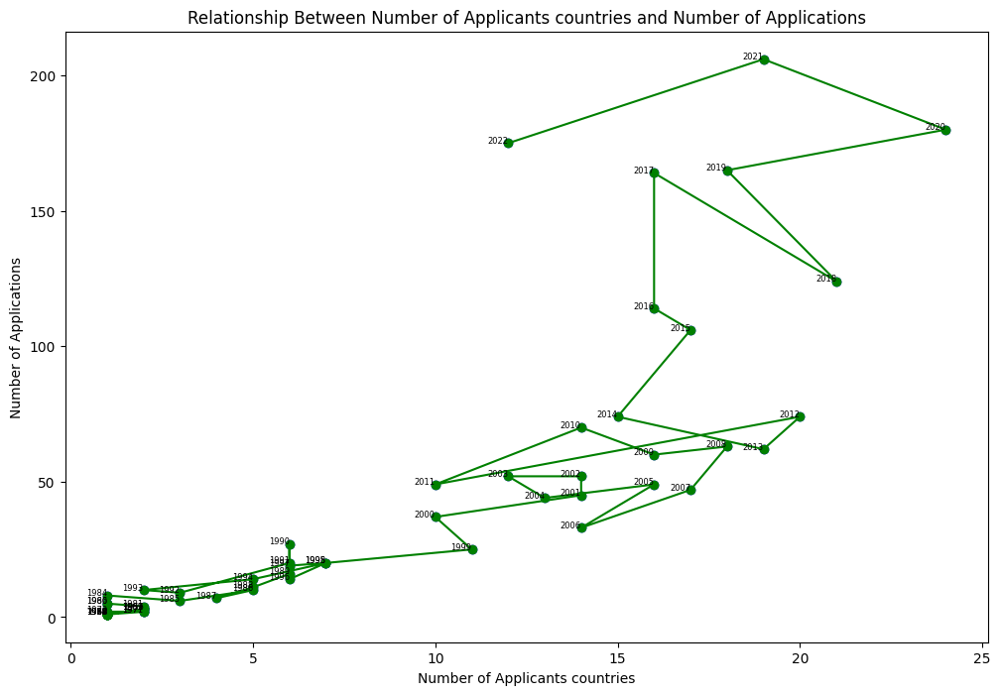

Pearson Correlation Coefficient: 0.8174390748800225
p value: 8.659316358745277e-15
The correlation is statistically significant.


In [ ]:
xlabel = 'Number of Applicants countries'
ylabel = 'Number of Applications'
title = 'Relationship Between Number of Applicants countries and Number of Applications'
col_name = 'Applicants countries counts'
data_trend = data_entities_trend_count

correlation_entities_applications(data_trend, col_name, xlabel, ylabel,title)

### applicants counts

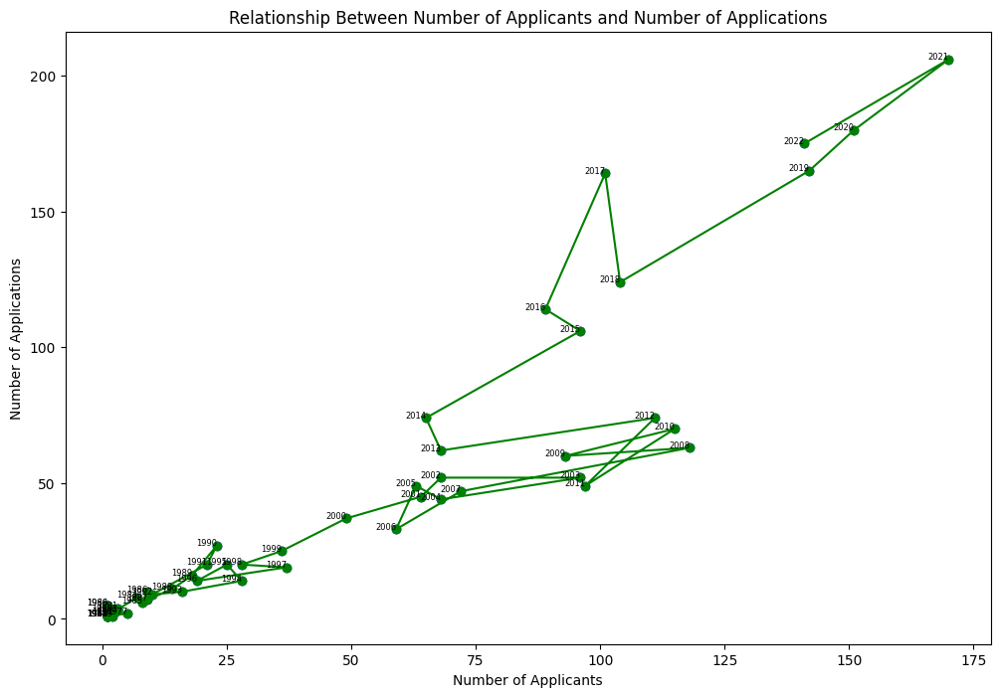

Pearson Correlation Coefficient: 0.9207830651434812
p value: 3.779374401310204e-24
The correlation is statistically significant.


In [ ]:
xlabel = 'Number of Applicants'
ylabel = 'Number of Applications'
title = 'Relationship Between Number of Applicants and Number of Applications'
col_name = 'Applicants counts'
data_trend = data_entities_trend_count

correlation_entities_applications(data_trend, col_name, xlabel, ylabel,title)

### inventors counts

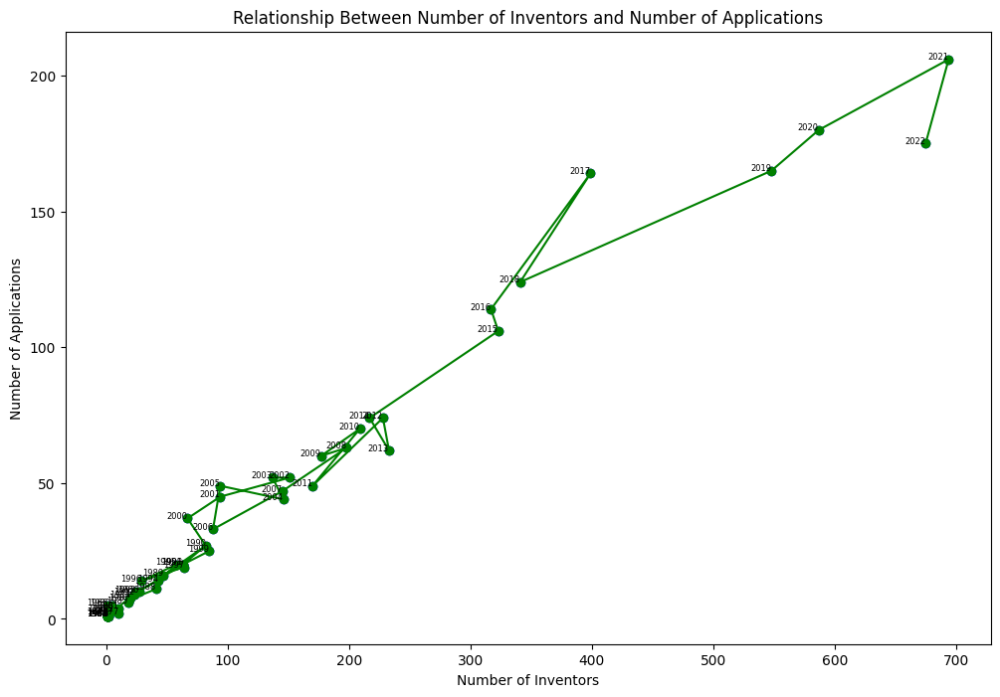

Pearson Correlation Coefficient: 0.9856192110400437
p value: 3.6899084342250084e-44
The correlation is statistically significant.


In [ ]:
xlabel = 'Number of Inventors'
ylabel = 'Number of Applications'
title = 'Relationship Between Number of Inventors and Number of Applications'
col_name = 'Inventors counts'
data_trend = data_entities_trend_count

correlation_entities_applications(data_trend, col_name, xlabel, ylabel,title)

# Key Players:
  •	Objective: Recognize leading institutions, companies, or researchers in phage therapy.
  
  o	Research Question: Who are the main assignees of phage therapy patents, and what are their primary focus areas?


In [ ]:
data[['Applicants_clean','Inventors_clean',"Owners"]].count()

Applicants_clean    2343
Inventors_clean     2330
Owners               296
dtype: int64

## Bibliometrics indicators

### function

```
process_applicants_clean_data : count patents and sum citations per applicant
```



In [ ]:
import pandas as pd

def process_entities_data(data, col_name, pickle_path=None, csv_path=None):
    """
    Process the given data to count patents and sum citations per entities.

    Parameters:
    - data (pd.DataFrame): The input data containing the relevant fields.
    - pickle_path (str, optional): The path to save the processed data as a pickle file.
    - csv_path (str, optional): The path to save the processed data as a CSV file.

    Returns:
    - grouped (pd.DataFrame): The processed data.
    """

    # Set the index
    entities_data = data.set_index(['Lens ID', 'Cited by Patent Count']) #'Application Year',

    #entities_data[col_name] = str(entities_data[col_name])

    # Split and explode the 'entities' field
    #entities_list = entities_data[col_name].str.split(';;').explode().str.strip()
    entities_list = entities_data[col_name].astype(str).str.split(';;').explode().str.strip()

    # Count the unique entities names
    unique_entities_count = entities_list.nunique()
    print('The number of unique entities is:', unique_entities_count)

    # Reset the index to re-organize data
    entities_list2 = entities_list.to_frame().reset_index()

    # Group by entities to count patents and sum citations
    grouped = entities_list2.groupby(col_name).agg({
        'Lens ID': 'count',
        'Cited by Patent Count': 'sum'
    }).reset_index()

    # Calculate additional metrics
    grouped['%'] = (grouped['Lens ID'] / entities_data[col_name].count()) * 100
    grouped['Average Citation Count'] = grouped['Cited by Patent Count'] / grouped['Lens ID']

    # Rename columns for clarity
    grouped.columns = [col_name, 'Patent Count', 'Total Citations', 'Percentage of Total Patents', 'Average Citation Count']

    # Save the data if paths are provided
    if pickle_path:
        grouped.to_pickle(pickle_path)
    if csv_path:
        grouped.to_csv(csv_path)

    return grouped

# Example usage:
#grouped_data = process_applicants_data(data, pickle_path='/path/to/your/directory/applicants_count_citation_therapy.pkl', csv_path='/path/to/your/directory/applicants_count_citation_therapy.csv')
#grouped_data#.head(50)


### applicants

In [ ]:
Applicants_biblio = process_entities_data(data, col_name='Applicants_clean')
Applicants_biblio

NameError: name 'process_entities_data' is not defined

In [ ]:
# count
Applicants_top20_count = Applicants_biblio[['Applicants_clean', 'Patent Count']].sort_values(by='Patent Count', ascending=False)
Applicants_top20_count['Applicants_clean'] = Applicants_top20_count['Applicants_clean'].str.title()
Applicants_top20_count.drop(Applicants_top20_count.loc[Applicants_top20_count['Applicants_clean'] == 'Nan'].index, inplace=True)
Applicants_top20_count = Applicants_top20_count.head(20).reset_index().drop('index',axis=1)
# citation
Applicants_top20_citation = Applicants_biblio[['Applicants_clean', 'Total Citations']].sort_values(by='Total Citations', ascending=False)
Applicants_top20_citation['Applicants_clean'] = Applicants_top20_citation['Applicants_clean'].str.title()
Applicants_top20_citation.drop(Applicants_top20_citation.loc[Applicants_top20_citation['Applicants_clean'] == 'Nan'].index, inplace=True)
Applicants_top20_citation = Applicants_top20_citation.head(20).reset_index().drop('index',axis=1)
Applicants_top20_citation

# merge
Applicants_top20_biblio = pd.concat([Applicants_top20_count, Applicants_top20_citation], axis=1)
Applicants_top20_biblio

,Applicants_clean,Patent Count,Applicants_clean,Total Citations
0,Intron Biotechnology Co Ltd,77,Fischetti Vincent,393
1,Optipharm Co Ltd,49,Loomis Lawrance,342
2,Qingdao No Antibiotics Biotechnology Co Ltd,34,New Horizons Diagnostics Corp,314
3,Fischetti Vincent,31,Finegold Sidney M,247
4,Cj Cheiljedang Corp,29,Affymax Tech Nv,212
5,Ruikemeng Qingdao Bio Eng Co Ltd,26,Intron Biotechnology Co Ltd,209
6,Loomis Lawrance,23,Harvard College,205
7,Univ Zhejiang,22,Broad Inst Inc,188
8,Shenzhen Inst Of Adv Tech Cas,21,Borody Thomas J,181
9,Univ Rockefeller,19,Us Dept Veterans Affairs,131


### inventors

In [ ]:
Inventors_biblio = process_entities_data(data, col_name='Inventors_clean')
Inventors_biblio

NameError: name 'process_entities_data' is not defined

In [ ]:
# count
Inventors_top20_count = Inventors_biblio[['Inventors_clean', 'Patent Count']].sort_values(by='Patent Count', ascending=False)
Inventors_top20_count['Inventors_clean'] = Inventors_top20_count['Inventors_clean'].str.title()
Inventors_top20_count.drop(Inventors_top20_count.loc[Inventors_top20_count['Inventors_clean'] == 'Nan'].index, inplace=True)
Inventors_top20_count = Inventors_top20_count.head(20).reset_index().drop('index',axis=1)
# citation
Inventors_top20_citation = Inventors_biblio[['Inventors_clean', 'Total Citations']].sort_values(by='Total Citations', ascending=False)
Inventors_top20_citation['Inventors_clean'] = Inventors_top20_citation['Inventors_clean'].str.title()
Inventors_top20_citation.drop(Inventors_top20_citation.loc[Inventors_top20_citation['Inventors_clean'] == 'Nan'].index, inplace=True)
Inventors_top20_citation = Inventors_top20_citation.head(20).reset_index().drop('index',axis=1)
Inventors_top20_citation

# merge
Inventors_top20_biblio = pd.concat([Inventors_top20_count, Inventors_top20_citation], axis=1)
Inventors_top20_biblio

,Inventors_clean,Patent Count,Inventors_clean,Total Citations
0,Kang Sang Hyeon,76,Fischetti Vincent,741
1,Jun Soo Youn,74,Loomis Lawrance,658
2,Seong Jun Yoon,65,Finegold Sydney M,247
3,Fischetti Vincent,51,Barrett Ronald W,212
4,Kim Young Ju,50,Dower William J,212
5,Kim Hyun Il,49,Cwirla Steven E,212
6,Park Charles,43,Kang Sang Hyeon,200
7,Yeon Young Eun,42,Liu David,188
8,Sun Huzhi,41,Jun Soo Youn,187
9,Du Xinyong,40,Doman Jordan,185


### applicants countries

In [ ]:
Applicants_countries_biblio = process_entities_data(data, col_name= 'Applicants_countries')
Applicants_countries_biblio

The number of unique entities is: 53


,Applicants_countries,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,,252,1518,10.755442,6.023810
1,Australia,8,4,0.341443,0.500000
2,Austria,9,17,0.384123,1.888889
3,Belgium,6,5,0.256082,0.833333
4,Brazil,5,2,0.213402,0.400000
5,Canada,35,266,1.493811,7.600000
6,Chile,6,18,0.256082,3.000000
7,China,809,1753,34.528382,2.166873
8,Colombia,1,0,0.042680,0.000000
9,Cuba,2,4,0.085361,2.000000


In [ ]:
Applicants_countries_biblio.drop(Applicants_countries_biblio.loc[Applicants_countries_biblio['Applicants_countries'] == 'nan'].index, inplace=True)
Applicants_countries_biblio

,Applicants_countries,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,,252,1518,10.755442,6.023810
1,Australia,8,4,0.341443,0.500000
2,Austria,9,17,0.384123,1.888889
3,Belgium,6,5,0.256082,0.833333
4,Brazil,5,2,0.213402,0.400000
5,Canada,35,266,1.493811,7.600000
6,Chile,6,18,0.256082,3.000000
7,China,809,1753,34.528382,2.166873
8,Colombia,1,0,0.042680,0.000000
9,Cuba,2,4,0.085361,2.000000


### applicants regions

In [ ]:
Applicants_regions_biblio = process_entities_data(data, col_name= 'Applicants_regions')
Applicants_regions_biblio

The number of unique entities is: 8


,Applicants_regions,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,,252,1518,10.755442,6.023810
1,Africa,7,6,0.298762,0.857143
2,Asia,1327,2911,56.636790,2.193670
3,Europe,332,560,14.169868,1.686747
4,North America,420,2561,17.925736,6.097619
5,Oceania,8,4,0.341443,0.500000
6,South America,14,20,0.597525,1.428571
7,nan,22,22,0.938967,1.000000


In [ ]:
Applicants_regions_biblio.drop(Applicants_regions_biblio.loc[Applicants_regions_biblio['Applicants_regions'] == ''].index, inplace=True)
Applicants_regions_biblio

,Applicants_regions,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
1,Africa,7,6,0.298762,0.857143
2,Asia,1327,2911,56.636790,2.193670
3,Europe,332,560,14.169868,1.686747
4,North America,420,2561,17.925736,6.097619
5,Oceania,8,4,0.341443,0.500000
6,South America,14,20,0.597525,1.428571
7,nan,22,22,0.938967,1.000000


### Jurisdiction names

In [ ]:
Jurisdiction_name_biblio = process_entities_data(data, col_name= 'Jurisdiction_name')
Jurisdiction_name_biblio

The number of unique entities is: 32


,Jurisdiction_name,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,Australia,40,9,1.691332,0.225000
1,Bulgaria,1,0,0.042283,0.000000
2,Canada,31,2,1.310782,0.064516
3,China,904,1975,38.224101,2.184735
4,Czech Republic,2,1,0.084567,0.500000
5,Eurasian Patent Org.,4,0,0.169133,0.000000
6,European Patent Office,25,43,1.057082,1.720000
7,France,4,8,0.169133,2.000000
8,Georgia,18,1,0.761099,0.055556
9,Germany,11,32,0.465116,2.909091


### Jurisdiction region

In [ ]:
Jurisdiction_Region_biblio = process_entities_data(data, col_name= 'Jurisdiction_Region')
Jurisdiction_Region_biblio

The number of unique entities is: 7


,Jurisdiction_Region,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,Africa,6,0,0.253700,0.000000
1,Asia,1321,2722,55.856237,2.060560
2,Eurasia,7,0,0.295983,0.000000
3,Europe,264,342,11.162791,1.295455
4,International,333,1721,14.080338,5.168168
5,North America,382,2786,16.152220,7.293194
6,Oceania,52,9,2.198732,0.173077


### Applicants categories

In [ ]:
Applicants_categories_biblio = process_entities_data(data, col_name= 'Applicants_categories')
Applicants_categories_biblio

The number of unique entities is: 6


,Applicants_categories,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,Academic,981,2424,41.869398,2.470948
1,Commercial,1090,3571,46.521554,3.276147
2,Governmental,109,403,4.652155,3.697248
3,Individual,428,2301,18.267179,5.376168
4,NC,7,12,0.298762,1.714286
5,nan,22,22,0.938967,1.000000


### Topics

In [ ]:
Topics_biblio = process_entities_data(data, col_name= 'Topic N°')
Topics_biblio

The number of unique entities is: 11


,Topic N°,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,Topic 0,12,82,0.519706,6.833333
1,Topic 1,155,399,6.712863,2.574194
2,Topic 2,354,699,15.331312,1.974576
3,Topic 3,498,2481,21.567778,4.981928
4,Topic 4,154,391,6.669554,2.538961
5,Topic 5,46,188,1.992204,4.086957
6,Topic 6,67,219,2.901689,3.268657
7,Topic 7,441,1284,19.099177,2.911565
8,Topic 8,406,789,17.583369,1.943350
9,Topic 9,176,893,7.622347,5.073864


### IPCR Sections

In [ ]:
IPCR_Sections_biblio = process_entities_data(data, col_name= 'IPCR Sections')
IPCR_Sections_biblio

The number of unique entities is: 9


,IPCR Sections,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,,11,6,0.465116,0.545455
1,A,1775,6046,75.052854,3.406197
2,B,59,122,2.494715,2.067797
3,C,1942,6345,82.114165,3.267250
4,D,7,2,0.295983,0.285714
5,E,2,4,0.084567,2.000000
6,F,7,7,0.295983,1.000000
7,G,316,1260,13.361522,3.987342
8,H,4,36,0.169133,9.000000


### IPCR Class

In [ ]:
IPCR_Class_biblio = process_entities_data(data, col_name= 'IPCR Class')
IPCR_Class_biblio

The number of unique entities is: 44


,IPCR Class,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,,11,6,0.465116,0.545455
1,A01,399,690,16.871036,1.729323
2,A21,1,0,0.042283,0.000000
3,A23,335,626,14.164905,1.868657
4,A41,2,6,0.084567,3.000000
5,A47,1,3,0.042283,3.000000
6,A61,1604,5696,67.822410,3.551122
7,A62,2,5,0.084567,2.500000
8,A63,1,2,0.042283,2.000000
9,B01,38,42,1.606765,1.105263


### IPCR Subclass

In [ ]:
IPCR_Subclass_biblio = process_entities_data(data, col_name= 'IPCR Subclass')
IPCR_Subclass_biblio

The number of unique entities is: 98


,IPCR Subclass,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,,11,6,0.465116,0.545455
1,A01G,7,10,0.295983,1.428571
2,A01H,6,1,0.253700,0.166667
3,A01K,19,64,0.803383,3.368421
4,A01N,371,627,15.687104,1.690027
...,...,...,...,...,...
93,G16H,3,0,0.126850,0.000000
94,H01F,1,1,0.042283,1.000000
95,H01T,1,1,0.042283,1.000000
96,H04R,1,34,0.042283,34.000000


In [ ]:
IPCR_Subclass_biblio.drop(IPCR_Subclass_biblio.loc[IPCR_Subclass_biblio['IPCR Subclass'] == 'nan'].index, inplace=True)
IPCR_Subclass_biblio

,IPCR Subclass,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,,11,6,0.465116,0.545455
1,A01G,7,10,0.295983,1.428571
2,A01H,6,1,0.253700,0.166667
3,A01K,19,64,0.803383,3.368421
4,A01N,371,627,15.687104,1.690027
...,...,...,...,...,...
93,G16H,3,0,0.126850,0.000000
94,H01F,1,1,0.042283,1.000000
95,H01T,1,1,0.042283,1.000000
96,H04R,1,34,0.042283,34.000000


In [ ]:
# count
IPCR_Subclass_top20_count = IPCR_Subclass_biblio[['IPCR Subclass', 'Patent Count']].sort_values(by='Patent Count', ascending=False)
IPCR_Subclass_top20_count['IPCR Subclass'] = IPCR_Subclass_top20_count['IPCR Subclass'].str.title()
IPCR_Subclass_top20_count.drop(IPCR_Subclass_top20_count.loc[IPCR_Subclass_top20_count['IPCR Subclass'] == ''].index, inplace=True)
IPCR_Subclass_top20_count = IPCR_Subclass_top20_count.head(20).reset_index().drop('index',axis=1)
# citation
IPCR_Subclass_top20_citation = IPCR_Subclass_biblio[['IPCR Subclass', 'Total Citations']].sort_values(by='Total Citations', ascending=False)
IPCR_Subclass_top20_citation['IPCR Subclass'] = IPCR_Subclass_top20_citation['IPCR Subclass'].str.title()
IPCR_Subclass_top20_citation.drop(IPCR_Subclass_top20_citation.loc[IPCR_Subclass_top20_citation['IPCR Subclass'] == ''].index, inplace=True)
IPCR_Subclass_top20_citation = IPCR_Subclass_top20_citation.head(20).reset_index().drop('index',axis=1)
IPCR_Subclass_top20_citation

# merge
IPCR_Subclass_top20_biblio = pd.concat([IPCR_Subclass_top20_count, IPCR_Subclass_top20_citation], axis=1)
IPCR_Subclass_top20_biblio

,IPCR Subclass,Patent Count,IPCR Subclass,Total Citations
0,A61K,1530,A61K,5547
1,C12N,1493,C12N,4621
2,A61P,1045,C07K,2918
3,C07K,740,A61P,2887
4,C12R,430,G01N,1249
5,A01N,371,C12R,1009
6,G01N,306,C12Q,828
7,A23K,263,A01N,627
8,C12Q,213,C40B,552
9,A01P,193,C12P,496


### IPCR Classifications

In [ ]:
IPCR_Classifications_biblio = process_entities_data(data, col_name= 'IPCR Classifications')
IPCR_Classifications_biblio

The number of unique entities is: 1416


,IPCR Classifications,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,A01G13/00,4,9,0.169924,2.250000
1,A01G17/00,1,0,0.042481,0.000000
2,A01G22/05,1,0,0.042481,0.000000
3,A01G33/02,1,1,0.042481,1.000000
4,A01G7/06,2,9,0.084962,4.500000
...,...,...,...,...,...
1411,H01F1/44,1,1,0.042481,1.000000
1412,H01T23/00,1,1,0.042481,1.000000
1413,H04R1/12,1,34,0.042481,34.000000
1414,H05K13/04,1,0,0.042481,0.000000


In [ ]:
IPCR_Classifications_biblio.drop(IPCR_Classifications_biblio.loc[IPCR_Classifications_biblio['IPCR Classifications'] == 'nan'].index, inplace=True)
IPCR_Classifications_biblio

,IPCR Classifications,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,A01G13/00,4,9,0.169924,2.25
1,A01G17/00,1,0,0.042481,0.00
2,A01G22/05,1,0,0.042481,0.00
3,A01G33/02,1,1,0.042481,1.00
4,A01G7/06,2,9,0.084962,4.50
...,...,...,...,...,...
1410,H01F1/00,1,1,0.042481,1.00
1411,H01F1/44,1,1,0.042481,1.00
1412,H01T23/00,1,1,0.042481,1.00
1413,H04R1/12,1,34,0.042481,34.00


In [ ]:
# count
IPCR_Classifications_top20_count = IPCR_Classifications_biblio[['IPCR Classifications', 'Patent Count']].sort_values(by='Patent Count', ascending=False)
IPCR_Classifications_top20_count['IPCR Classifications'] = IPCR_Classifications_top20_count['IPCR Classifications'].str.title()
IPCR_Classifications_top20_count.drop(IPCR_Classifications_top20_count.loc[IPCR_Classifications_top20_count['IPCR Classifications'] == ''].index, inplace=True)
IPCR_Classifications_top20_count = IPCR_Classifications_top20_count.head(20).reset_index().drop('index',axis=1)
# citation
IPCR_Classifications_top20_citation = IPCR_Classifications_biblio[['IPCR Classifications', 'Total Citations']].sort_values(by='Total Citations', ascending=False)
IPCR_Classifications_top20_citation['IPCR Classifications'] = IPCR_Classifications_top20_citation['IPCR Classifications'].str.title()
IPCR_Classifications_top20_citation.drop(IPCR_Classifications_top20_citation.loc[IPCR_Classifications_top20_citation['IPCR Classifications'] == ''].index, inplace=True)
IPCR_Classifications_top20_citation = IPCR_Classifications_top20_citation.head(20).reset_index().drop('index',axis=1)
IPCR_Classifications_top20_citation

# merge
IPCR_Classifications_top20_biblio = pd.concat([IPCR_Classifications_top20_count, IPCR_Classifications_top20_citation], axis=1)
IPCR_Classifications_top20_biblio

,IPCR Classifications,Patent Count,IPCR Classifications,Total Citations
0,C12N7/00,718,A61K35/76,1981
1,A61K35/76,693,C12N7/00,1773
2,A61P31/04,521,A61K38/00,1236
3,C12R1/92,236,A61P31/04,1200
4,A01N63/40,215,C12N15/09,828
5,A61P35/00,197,C12N1/21,799
6,C12N15/09,186,A61P35/00,646
7,A01P1/00,185,A61K38/46,641
8,A61K39/395,166,C12N15/10,636
9,C12N1/21,152,A61K39/395,585


### CPC Classifications

In [ ]:
CPC_Classifications_biblio = process_entities_data(data, col_name= 'CPC Classifications')
CPC_Classifications_biblio

The number of unique entities is: 2328


,CPC Classifications,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,A01C3/00,2,2,0.110193,1.000000
1,A01G13/00,1,0,0.055096,0.000000
2,A01G17/005,1,0,0.055096,0.000000
3,A01G7/06,2,0,0.110193,0.000000
4,A01K2207/00,1,22,0.055096,22.000000
...,...,...,...,...,...
2323,Y10T436/101666,2,4,0.110193,2.000000
2324,Y10T436/105831,2,4,0.110193,2.000000
2325,Y10T436/107497,2,4,0.110193,2.000000
2326,Y10T436/108331,2,4,0.110193,2.000000


In [ ]:
CPC_Classifications_biblio.drop(CPC_Classifications_biblio.loc[CPC_Classifications_biblio['CPC Classifications'] == 'nan'].index, inplace=True)
CPC_Classifications_biblio

,CPC Classifications,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,A01C3/00,2,2,0.110193,1.0
1,A01G13/00,1,0,0.055096,0.0
2,A01G17/005,1,0,0.055096,0.0
3,A01G7/06,2,0,0.110193,0.0
4,A01K2207/00,1,22,0.055096,22.0
...,...,...,...,...,...
2322,Y10T428/2984,2,4,0.110193,2.0
2323,Y10T436/101666,2,4,0.110193,2.0
2324,Y10T436/105831,2,4,0.110193,2.0
2325,Y10T436/107497,2,4,0.110193,2.0


In [ ]:
# count
CPC_Classifications_top20_count = CPC_Classifications_biblio[['CPC Classifications', 'Patent Count']].sort_values(by='Patent Count', ascending=False)
CPC_Classifications_top20_count['CPC Classifications'] = CPC_Classifications_top20_count['CPC Classifications'].str.title()
CPC_Classifications_top20_count.drop(CPC_Classifications_top20_count.loc[CPC_Classifications_top20_count['CPC Classifications'] == ''].index, inplace=True)
CPC_Classifications_top20_count = CPC_Classifications_top20_count.head(20).reset_index().drop('index',axis=1)
# citation
CPC_Classifications_top20_citation = CPC_Classifications_biblio[['CPC Classifications', 'Total Citations']].sort_values(by='Total Citations', ascending=False)
CPC_Classifications_top20_citation['CPC Classifications'] = CPC_Classifications_top20_citation['CPC Classifications'].str.title()
CPC_Classifications_top20_citation.drop(CPC_Classifications_top20_citation.loc[CPC_Classifications_top20_citation['CPC Classifications'] == ''].index, inplace=True)
CPC_Classifications_top20_citation = CPC_Classifications_top20_citation.head(20).reset_index().drop('index',axis=1)
CPC_Classifications_top20_citation

# merge
CPC_Classifications_top20_biblio = pd.concat([CPC_Classifications_top20_count, CPC_Classifications_top20_citation], axis=1)
CPC_Classifications_top20_biblio

,CPC Classifications,Patent Count,CPC Classifications,Total Citations
0,C12N7/00,1006,A61K35/76,3177
1,A61K35/76,895,C12N7/00,2484
2,A61P31/04,671,Y02A50/30,2377
3,Y02A50/30,471,A61K38/00,1827
4,A61K38/00,271,A61P31/04,1560
5,C12N2795/00032,253,A61K38/47,1489
6,A01N63/40,249,C12N9/503,1310
7,C07K14/005,221,C12Y302/01017,1016
8,C12N2795/10132,180,C07K2319/00,1015
9,C12N2795/00021,174,C12N15/1037,973


### Application Year

In [ ]:
Application_Year_biblio = process_entities_data(data, col_name= 'Application Year')
Application_Year_biblio

The number of unique entities is: 58


,Application Year,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,1955,3,6,0.126850,2.000000
1,1958,1,9,0.042283,9.000000
2,1959,1,0,0.042283,0.000000
3,1963,1,2,0.042283,2.000000
4,1964,1,9,0.042283,9.000000
5,1966,5,0,0.211416,0.000000
6,1967,1,0,0.042283,0.000000
7,1968,1,2,0.042283,2.000000
8,1969,3,72,0.126850,24.000000
9,1971,2,13,0.084567,6.500000


In [ ]:
#

### Applicants_Last_Classification

In [ ]:
Applicants_Last_Classification_biblio = process_entities_data(data, col_name= 'Applicants_Last_Classification')
Applicants_Last_Classification_biblio

The number of unique entities is: 5


,Applicants_Last_Classification,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,Continuant,183,229,7.810499,1.251366
1,Newcomer,20,1,0.853606,0.050000
2,Terminator,1189,4475,50.746906,3.763667
3,Transient,1133,3787,48.356808,3.342454
4,nan,22,22,0.938967,1.000000


### Inventors_Last_Classification

In [ ]:
Inventors_Last_Classification_biblio = process_entities_data(data, col_name= 'Inventors_Last_Classification')
Inventors_Last_Classification_biblio

The number of unique entities is: 5


,Inventors_Last_Classification,Patent Count,Total Citations,Percentage of Total Patents,Average Citation Count
0,Continuant,266,404,11.416309,1.518797
1,Newcomer,39,2,1.673820,0.051282
2,Terminator,1467,4543,62.961373,3.096796
3,Transient,1674,5161,71.845494,3.083035
4,nan,35,135,1.502146,3.857143


## Social Network Analysis


```
# Ce texte est au format code
```



#### calculate_centrality_measures function

```
The function calculate_centrality_measures has been successfully executed. It computes four key centrality measures for each entity in your dataset:

    Degree Centrality: Measures the number of connections an entity has to others.
    Betweenness Centrality: Indicates how often an entity appears on the shortest path between other entities.
    Closeness Centrality: Reflects how close an entity is to all other entities in the network.
    Eigenvector Centrality: Accounts for the influence of an entity's connections.

The output DataFrame, centrality_df, lists these measures for each entity.
```



In [ ]:
import pandas as pd
import networkx as nx
import itertools
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
import networkx as nx
import pandas as pd
from collections import Counter
from itertools import combinations
from matplotlib import cm
import community as community_louvain

def calculate_centrality_measures(dataframe, entity_column):
    # Create a graph from the dataframe
    G = nx.Graph()
    for _, row in dataframe.iterrows():
        entities = str(row[entity_column]).split(';;') if pd.notna(row[entity_column]) else []
        for pair in combinations(entities, 2):
            G.add_edge(*pair)

    # Calculate centrality measures
    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    closeness_centrality = nx.closeness_centrality(G)

    # Eigenvector Centrality with increased iterations and error handling
    try:
        eigenvector_centrality = nx.eigenvector_centrality(G, max_iter=500)
    except nx.PowerIterationFailedConvergence:
        eigenvector_centrality = {n: 0 for n in G.nodes()}  # Assign 0 if fails to converge

    # Create DataFrames for each centrality measure
    degree_df = pd.DataFrame(degree_centrality.items(), columns=[f'{entity_column}', 'Degree Centrality'])
    betweenness_df = pd.DataFrame(betweenness_centrality.items(), columns=[f'{entity_column}', 'Betweenness Centrality'])
    closeness_df = pd.DataFrame(closeness_centrality.items(), columns=[f'{entity_column}', 'Closeness Centrality'])
    eigenvector_df = pd.DataFrame(eigenvector_centrality.items(), columns=[f'{entity_column}', 'Eigenvector Centrality'])

    # Merge all centrality measures into one DataFrame
    centrality_df = degree_df.merge(betweenness_df, on=f'{entity_column}').merge(closeness_df, on=f'{entity_column}').merge(eigenvector_df, on=f'{entity_column}')

    return centrality_df


##### applicants_clean

In [ ]:
centrality_df = calculate_centrality_measures(data, 'Applicants_clean')
centrality_df

,Applicants_clean,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,NOVOSIB NII T,0.000996,0.000000,0.000996,0
1,UBERKULEZA,0.000996,0.000000,0.000996,0
2,TechnoPhage,0.004980,0.000008,0.004980,0
3,TECNIFAR INDUSTRIA TECNICA FARMACEUTICA SA,0.000996,0.000000,0.002767,0
4,EXPONENTIAL BIOTHERAPIES INC,0.003984,0.000276,0.008035,0
...,...,...,...,...,...
1000,DAHL JOHN,0.003984,0.000000,0.003984,0
1001,DAVIS WILLIAM C,0.003984,0.000000,0.003984,0
1002,NEW HOPE LIUHE CO LTD,0.001992,0.000000,0.002656,0
1003,SHANDONG NEWHOPE LIUHE GROUP,0.001992,0.000000,0.002656,0


In [ ]:
def top_20_sorted(df, column):
    sorted_df = df[['Applicants_clean', column]].sort_values(by=column, ascending=False)
    sorted_df['Applicants_clean'] = sorted_df['Applicants_clean'].str.title()
    sorted_df = sorted_df.head(20).reset_index().drop('index', axis=1)
    return sorted_df

In [ ]:
degree_centrality_top_20 = top_20_sorted(centrality_df, 'Degree Centrality')
betweenness_centrality_top_20 = top_20_sorted(centrality_df, 'Betweenness Centrality')
closeness_centrality_top_20 = top_20_sorted(centrality_df, 'Closeness Centrality')
eigenvector_centrality_top_20 = top_20_sorted(centrality_df, 'Eigenvector Centrality')


In [ ]:
def merge_on_index(dfs):
    # Start with the first DataFrame
    merged_df = dfs[0]
    # Merge all other DataFrames
    for df in dfs[1:]:
        merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)
    return merged_df

In [ ]:
dfs = [degree_centrality_top_20, betweenness_centrality_top_20, closeness_centrality_top_20, eigenvector_centrality_top_20]
merged_df = merge_on_index(dfs)

<ipython-input-480-baf5b76654bb>:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Applicants_clean_x'} in the result is deprecated and will raise a MergeError in a future version.
  merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)


In [ ]:
from IPython.display import display
display(merged_df)


,Applicants_clean_x,Degree Centrality,Applicants_clean_y,Betweenness Centrality,Applicants_clean_x,Closeness Centrality,Applicants_clean_y,Eigenvector Centrality
0,Gorski Abdrzej,0.022908,Gabisonia Taras,0.000379,Gabisonia Taras,0.023078,Novosib Nii T,0
1,Gabisonia Taras,0.020916,Alavidze Zemphira,0.000366,Gorski Abdrzej,0.022908,Chinnaiyan Arul,0
2,Centre Nat Rech Scient,0.019920,Centre Nat Rech Scient,0.000338,Alavidze Zemphira,0.022136,Swoboda Rolf K,0
3,Alavidze Zemphira,0.016932,Exponential Biotherapies Inc,0.000276,Chanishvili Teimuraz,0.020859,Pfister Thomas,0
4,Chanishvili Teimuraz,0.015936,Gorski Abdrzej,0.000242,Centre Nat Rech Scient,0.020265,Maurer Patrik,0
5,Fischetti Vincent,0.014940,Us Army,0.000238,Darsavelidze Marina,0.019721,Renner Wolfgang,0
6,Univ Rockefeller,0.013944,Us Navy,0.000220,Chkonia Irina,0.019369,Mueller Philipp,0
7,Us Agriculture,0.013944,Carlton Richard M,0.000209,Zhgenti Daredjan,0.019369,Cytos Biotechnology Ag,0
8,Cytos Biotechnology Ag,0.012948,Univ Maryland,0.000177,Goderdzishvili Marina,0.019369,Bachmann Martin,0
9,Univ Boston,0.012948,Chanishvili Teimuraz,0.000163,Dzidzishvili Luiza,0.019369,Nishihara Env San Res Co Ltd,0


##### applicants_clean_not_individual

In [ ]:
centrality_df = calculate_centrality_measures(data, 'applicants_clean_not_individual')
centrality_df

NameError: name 'calculate_centrality_measures' is not defined

In [ ]:
def top_20_sorted(df, column):
    sorted_df = df[['applicants_clean_not_individual', column]].sort_values(by=column, ascending=False)
    sorted_df['applicants_clean_not_individual'] = sorted_df['applicants_clean_not_individual'].str.title()
    sorted_df = sorted_df.head(20).reset_index().drop('index', axis=1)
    return sorted_df

In [ ]:
degree_centrality_top_20 = top_20_sorted(centrality_df, 'Degree Centrality')
betweenness_centrality_top_20 = top_20_sorted(centrality_df, 'Betweenness Centrality')
closeness_centrality_top_20 = top_20_sorted(centrality_df, 'Closeness Centrality')
eigenvector_centrality_top_20 = top_20_sorted(centrality_df, 'Eigenvector Centrality')


In [ ]:
def merge_on_index(dfs):
    # Start with the first DataFrame
    merged_df = dfs[0]
    # Merge all other DataFrames
    for df in dfs[1:]:
        merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)
    return merged_df

In [ ]:
dfs = [degree_centrality_top_20, betweenness_centrality_top_20, closeness_centrality_top_20, eigenvector_centrality_top_20]
merged_df = merge_on_index(dfs)

<ipython-input-486-baf5b76654bb>:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'applicants_clean_not_individual_x'} in the result is deprecated and will raise a MergeError in a future version.
  merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)


In [ ]:
from IPython.display import display
display(merged_df)


,applicants_clean_not_individual_x,Degree Centrality,applicants_clean_not_individual_y,Betweenness Centrality,applicants_clean_not_individual_x,Closeness Centrality,applicants_clean_not_individual_y,Eigenvector Centrality
0,Centre Nat Rech Scient,0.027491,Centre Nat Rech Scient,0.000758,Centre Nat Rech Scient,0.029701,Centre Nat Rech Scient,0.497563
1,Inst Nat Sante Rech Med,0.024055,Inst Nat Sante Rech Med,0.000592,Inst Nat Sante Rech Med,0.027721,Inst Nat Sante Rech Med,0.466803
2,Fundacion Para El Fomento De La Investig Sanit...,0.013746,Us Army,0.000213,Inst Curie,0.021885,Univ Paris Saclay,0.300811
3,Consorcio Centro De Investig Biomedica En Red ...,0.013746,Us Navy,0.000213,Univ Paris Saclay,0.021885,Inst Curie,0.300811
4,Fundacio Inst Dinvestigacio Biomedica De Giron...,0.013746,Exponential Biotherapies Inc,0.000190,Univ Aix Marseille Ii,0.020790,Univ Aix Marseille Ii,0.229289
5,Univ Valencia,0.013746,Us Health,0.000118,Univ Cambridge,0.018900,Univ Cambridge,0.225561
6,Wojskowy Inst Higieny I Epidemiologii,0.013746,Univ Zhejiang,0.000118,Istituto Di Biochimica Delle P,0.018900,Istituto Di Biochimica Delle P,0.225561
7,Narodowy Inst Lekow,0.013746,Harvard College,0.000095,Istituto Internaz Di Genetica,0.018900,Istituto Internaz Di Genetica,0.225561
8,Szkola Glowna Gospod Wiejsk Ak,0.013746,Qingdao Jiazhi Biotechnology Co Ltd,0.000095,Univ Montpellier,0.018079,Inst Regional Cancer Montpellier,0.211616
9,Inst Biochemii I Biofizyki Polskiej Akademii Nauk,0.013746,Massachusetts Inst Technology,0.000095,Inst Regional Cancer Montpellier,0.018079,Univ Montpellier,0.211616


##### Inventors_clean

In [ ]:
centrality_df = calculate_centrality_measures(data, 'Inventors_clean')
centrality_df

,Inventors_clean,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,KURUNOVA N N,0.000385,0.000000e+00,0.000385,3.867536e-239
1,KURUNOV JU N,0.000385,0.000000e+00,0.000385,3.867536e-239
2,SHATALOVA N D,0.000385,0.000000e+00,0.000385,3.867536e-239
3,ANA RAQUEL MARTINS BARBOSA,0.001733,9.639468e-07,0.002226,1.387662e-121
4,CARLOS JORGE SOUSA DE SAO JOSE,0.001348,3.460322e-07,0.002061,1.146072e-121
...,...,...,...,...,...
5190,MARTINEZ IGNACIO,0.000770,0.000000e+00,0.000770,3.042535e-177
5191,ARMEN ZACHARY,0.000770,0.000000e+00,0.000770,3.042535e-177
5192,MARTIN BARRY,0.000770,0.000000e+00,0.000770,3.042535e-177
5193,AVENDANO AMADO MAIER,0.000770,0.000000e+00,0.000770,3.042535e-177


In [ ]:
def top_20_sorted(df, column):
    sorted_df = df[['Inventors_clean', column]].sort_values(by=column, ascending=False)
    sorted_df['Inventors_clean'] = sorted_df['Inventors_clean'].str.title()
    sorted_df = sorted_df.head(20).reset_index().drop('index', axis=1)
    return sorted_df

In [ ]:
degree_centrality_top_20 = top_20_sorted(centrality_df, 'Degree Centrality')
betweenness_centrality_top_20 = top_20_sorted(centrality_df, 'Betweenness Centrality')
closeness_centrality_top_20 = top_20_sorted(centrality_df, 'Closeness Centrality')
eigenvector_centrality_top_20 = top_20_sorted(centrality_df, 'Eigenvector Centrality')


In [ ]:
def merge_on_index(dfs):
    # Start with the first DataFrame
    merged_df = dfs[0]
    # Merge all other DataFrames
    for df in dfs[1:]:
        merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)
    return merged_df

In [ ]:
dfs = [degree_centrality_top_20, betweenness_centrality_top_20, closeness_centrality_top_20, eigenvector_centrality_top_20]
merged_df = merge_on_index(dfs)

<ipython-input-492-baf5b76654bb>:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Inventors_clean_x'} in the result is deprecated and will raise a MergeError in a future version.
  merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)


In [ ]:
from IPython.display import display
display(merged_df)


,Inventors_clean_x,Degree Centrality,Inventors_clean_y,Betweenness Centrality,Inventors_clean_x,Closeness Centrality,Inventors_clean_y,Eigenvector Centrality
0,Liu Yang,0.012707,Liu Yang,0.023347,Liu Yang,0.064299,Liu Yang,0.304034
1,Liu Yuling,0.010397,Zhang Lei,0.018020,Zhang Wei,0.063587,Zhang Wei,0.166384
2,Kang Sang Hyeon,0.009819,Zhang Wei,0.012110,Zhang Lei,0.062813,Zhang Lei,0.153874
3,Jun Soo Youn,0.009434,Liu Yuling,0.012050,Chen Xing,0.062294,Chen Xing,0.152099
4,Ren Huiying,0.008856,Li Yan,0.010627,Liu Yuling,0.061635,Chen Tengxiang,0.150061
5,Sun Huzhi,0.008664,Wang Rui,0.009903,Chen Li,0.060572,Zhang Jinjuan,0.150061
6,Wang Xiaolan,0.008664,Ho Mitchell,0.009687,Sun Jing,0.060554,Liu Wei,0.149271
7,Seong Jun Yoon,0.008664,Gao Wei,0.008204,Hao Xiaojing,0.060429,Zhang Na,0.146516
8,Zhang Wei,0.008471,Wang Xiaolan,0.007921,Li Guohong,0.059913,Lei Shan,0.146101
9,Aleshkin Andrey Vladimirovich,0.008471,Bai Xianhong,0.007755,Wang Xiaolan,0.059694,Zhao Ruixin,0.144923


##### applicants_countries

In [ ]:
centrality_df = calculate_centrality_measures(data, 'Applicants_countries')
centrality_df

,Applicants_countries,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,United States,0.40,0.557895,0.558621,4.861855e-01
1,Canada,0.15,0.072807,0.415385,2.790491e-01
2,France,0.30,0.086842,0.368182,3.992969e-01
3,Netherlands,0.15,0.017544,0.415385,3.299636e-01
4,Denmark,0.10,0.000000,0.324000,1.779931e-01
5,United Kingdom,0.20,0.075439,0.426316,3.720313e-01
6,China,0.30,0.326316,0.437838,2.455983e-01
7,Taiwan,0.05,0.000000,0.300000,6.444449e-02
8,Russia,0.10,0.089474,0.368182,1.370057e-01
9,Italy,0.10,0.000000,0.324000,2.023910e-01


In [ ]:
def top_20_sorted(df, column):
    sorted_df = df[['Applicants_countries', column]].sort_values(by=column, ascending=False)
    sorted_df['Applicants_countries'] = sorted_df['Applicants_countries'].str.title()
    sorted_df = sorted_df.head(20).reset_index().drop('index', axis=1)
    return sorted_df

In [ ]:
degree_centrality_top_20 = top_20_sorted(centrality_df, 'Degree Centrality')
betweenness_centrality_top_20 = top_20_sorted(centrality_df, 'Betweenness Centrality')
closeness_centrality_top_20 = top_20_sorted(centrality_df, 'Closeness Centrality')
eigenvector_centrality_top_20 = top_20_sorted(centrality_df, 'Eigenvector Centrality')


In [ ]:
def merge_on_index(dfs):
    # Start with the first DataFrame
    merged_df = dfs[0]
    # Merge all other DataFrames
    for df in dfs[1:]:
        merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)
    return merged_df

In [ ]:
dfs = [degree_centrality_top_20, betweenness_centrality_top_20, closeness_centrality_top_20, eigenvector_centrality_top_20]
merged_df = merge_on_index(dfs)

<ipython-input-498-baf5b76654bb>:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Applicants_countries_x'} in the result is deprecated and will raise a MergeError in a future version.
  merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)


In [ ]:
from IPython.display import display
display(merged_df)


,Applicants_countries_x,Degree Centrality,Applicants_countries_y,Betweenness Centrality,Applicants_countries_x,Closeness Centrality,Applicants_countries_y,Eigenvector Centrality
0,United States,0.40,United States,0.557895,United States,0.558621,United States,4.861855e-01
1,France,0.30,China,0.326316,China,0.437838,France,3.992969e-01
2,China,0.30,Israel,0.105263,United Kingdom,0.426316,United Kingdom,3.720313e-01
3,United Kingdom,0.20,Japan,0.100000,Netherlands,0.415385,Netherlands,3.299636e-01
4,Netherlands,0.15,Russia,0.089474,Canada,0.415385,Canada,2.790491e-01
5,Japan,0.15,France,0.086842,Australia,0.395122,China,2.455983e-01
6,Canada,0.15,United Kingdom,0.075439,Israel,0.395122,Italy,2.023910e-01
7,Italy,0.10,Canada,0.072807,Russia,0.368182,Australia,1.920172e-01
8,Australia,0.10,Netherlands,0.017544,France,0.368182,Denmark,1.779931e-01
9,Israel,0.10,Belgium,0.000000,Switzerland,0.352174,Israel,1.696403e-01


##### Applicants_regions

In [ ]:
centrality_df = calculate_centrality_measures(data, 'Applicants_regions')
centrality_df

,Applicants_regions,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,Europe,0.666667,0.000000,0.75,0.435162
1,North America,1.000000,0.166667,1.00,0.557345
2,Oceania,0.666667,0.000000,0.75,0.435162
3,Asia,1.000000,0.166667,1.00,0.557345


In [ ]:
def top_20_sorted(df, column):
    sorted_df = df[['Applicants_regions', column]].sort_values(by=column, ascending=False)
    sorted_df['Applicants_regions'] = sorted_df['Applicants_regions'].str.title()
    sorted_df = sorted_df.head(20).reset_index().drop('index', axis=1)
    return sorted_df

In [ ]:
degree_centrality_top_20 = top_20_sorted(centrality_df, 'Degree Centrality')
betweenness_centrality_top_20 = top_20_sorted(centrality_df, 'Betweenness Centrality')
closeness_centrality_top_20 = top_20_sorted(centrality_df, 'Closeness Centrality')
eigenvector_centrality_top_20 = top_20_sorted(centrality_df, 'Eigenvector Centrality')


In [ ]:
def merge_on_index(dfs):
    # Start with the first DataFrame
    merged_df = dfs[0]
    # Merge all other DataFrames
    for df in dfs[1:]:
        merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)
    return merged_df

In [ ]:
dfs = [degree_centrality_top_20, betweenness_centrality_top_20, closeness_centrality_top_20, eigenvector_centrality_top_20]
merged_df = merge_on_index(dfs)

<ipython-input-504-baf5b76654bb>:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Applicants_regions_x'} in the result is deprecated and will raise a MergeError in a future version.
  merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)


In [ ]:
from IPython.display import display
display(merged_df)


,Applicants_regions_x,Degree Centrality,Applicants_regions_y,Betweenness Centrality,Applicants_regions_x,Closeness Centrality,Applicants_regions_y,Eigenvector Centrality
0,North America,1.000000,North America,0.166667,North America,1.00,North America,0.557345
1,Asia,1.000000,Asia,0.166667,Asia,1.00,Asia,0.557345
2,Europe,0.666667,Europe,0.000000,Europe,0.75,Europe,0.435162
3,Oceania,0.666667,Oceania,0.000000,Oceania,0.75,Oceania,0.435162


##### Applicants_categories

In [ ]:
centrality_df = calculate_centrality_measures(data, 'Applicants_categories')
centrality_df

,Applicants_categories,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,Individual,1.00,0.055556,1.0,0.479229
1,Commercial,1.00,0.055556,1.0,0.479229
2,Governmental,0.75,0.000000,0.8,0.394346
3,Academic,1.00,0.055556,1.0,0.479229
4,NC,0.75,0.000000,0.8,0.394346


In [ ]:
def top_20_sorted(df, column):
    sorted_df = df[['Applicants_categories', column]].sort_values(by=column, ascending=False)
    sorted_df['Applicants_categories'] = sorted_df['Applicants_categories'].str.title()
    sorted_df = sorted_df.head(20).reset_index().drop('index', axis=1)
    return sorted_df

In [ ]:
degree_centrality_top_20 = top_20_sorted(centrality_df, 'Degree Centrality')
betweenness_centrality_top_20 = top_20_sorted(centrality_df, 'Betweenness Centrality')
closeness_centrality_top_20 = top_20_sorted(centrality_df, 'Closeness Centrality')
eigenvector_centrality_top_20 = top_20_sorted(centrality_df, 'Eigenvector Centrality')


In [ ]:
def merge_on_index(dfs):
    # Start with the first DataFrame
    merged_df = dfs[0]
    # Merge all other DataFrames
    for df in dfs[1:]:
        merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)
    return merged_df

In [ ]:
dfs = [degree_centrality_top_20, betweenness_centrality_top_20, closeness_centrality_top_20, eigenvector_centrality_top_20]
merged_df = merge_on_index(dfs)

<ipython-input-510-baf5b76654bb>:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Applicants_categories_x'} in the result is deprecated and will raise a MergeError in a future version.
  merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)


In [ ]:
from IPython.display import display
display(merged_df)


,Applicants_categories_x,Degree Centrality,Applicants_categories_y,Betweenness Centrality,Applicants_categories_x,Closeness Centrality,Applicants_categories_y,Eigenvector Centrality
0,Individual,1.00,Individual,0.055556,Individual,1.0,Individual,0.479229
1,Commercial,1.00,Commercial,0.055556,Commercial,1.0,Commercial,0.479229
2,Academic,1.00,Academic,0.055556,Academic,1.0,Academic,0.479229
3,Governmental,0.75,Governmental,0.000000,Governmental,0.8,Governmental,0.394346
4,Nc,0.75,Nc,0.000000,Nc,0.8,Nc,0.394346


##### Applicants_Last_Classification

In [ ]:
centrality_df = calculate_centrality_measures(data, 'Applicants_Last_Classification')
centrality_df

,Applicants_Last_Classification,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,Transient,0.666667,0.000000,0.75,0.522720
1,Terminator,0.666667,0.000000,0.75,0.522720
2,Continuant,1.000000,0.666667,1.00,0.611629
3,Newcomer,0.333333,0.000000,0.60,0.281846


In [ ]:
def top_20_sorted(df, column):
    sorted_df = df[['Applicants_Last_Classification', column]].sort_values(by=column, ascending=False)
    sorted_df['Applicants_Last_Classification'] = sorted_df['Applicants_Last_Classification'].str.title()
    sorted_df = sorted_df.head(20).reset_index().drop('index', axis=1)
    return sorted_df

In [ ]:
degree_centrality_top_20 = top_20_sorted(centrality_df, 'Degree Centrality')
betweenness_centrality_top_20 = top_20_sorted(centrality_df, 'Betweenness Centrality')
closeness_centrality_top_20 = top_20_sorted(centrality_df, 'Closeness Centrality')
eigenvector_centrality_top_20 = top_20_sorted(centrality_df, 'Eigenvector Centrality')


In [ ]:
def merge_on_index(dfs):
    # Start with the first DataFrame
    merged_df = dfs[0]
    # Merge all other DataFrames
    for df in dfs[1:]:
        merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)
    return merged_df

In [ ]:
dfs = [degree_centrality_top_20, betweenness_centrality_top_20, closeness_centrality_top_20, eigenvector_centrality_top_20]
merged_df = merge_on_index(dfs)

<ipython-input-516-baf5b76654bb>:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Applicants_Last_Classification_x'} in the result is deprecated and will raise a MergeError in a future version.
  merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)


In [ ]:
from IPython.display import display
display(merged_df)


,Applicants_Last_Classification_x,Degree Centrality,Applicants_Last_Classification_y,Betweenness Centrality,Applicants_Last_Classification_x,Closeness Centrality,Applicants_Last_Classification_y,Eigenvector Centrality
0,Continuant,1.000000,Continuant,0.666667,Continuant,1.00,Continuant,0.611629
1,Transient,0.666667,Transient,0.000000,Transient,0.75,Transient,0.522720
2,Terminator,0.666667,Terminator,0.000000,Terminator,0.75,Terminator,0.522720
3,Newcomer,0.333333,Newcomer,0.000000,Newcomer,0.60,Newcomer,0.281846


##### Inventors_Last_Classification

In [ ]:
centrality_df = calculate_centrality_measures(data, 'Inventors_Last_Classification')
centrality_df

,Inventors_Last_Classification,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,Terminator,0.666667,0.000000,0.75,0.522720
1,Transient,0.666667,0.000000,0.75,0.522720
2,Continuant,1.000000,0.666667,1.00,0.611629
3,Newcomer,0.333333,0.000000,0.60,0.281846


In [ ]:
def top_20_sorted(df, column):
    sorted_df = df[['Inventors_Last_Classification', column]].sort_values(by=column, ascending=False)
    sorted_df['Inventors_Last_Classification'] = sorted_df['Inventors_Last_Classification'].str.title()
    sorted_df = sorted_df.head(20).reset_index().drop('index', axis=1)
    return sorted_df

In [ ]:
degree_centrality_top_20 = top_20_sorted(centrality_df, 'Degree Centrality')
betweenness_centrality_top_20 = top_20_sorted(centrality_df, 'Betweenness Centrality')
closeness_centrality_top_20 = top_20_sorted(centrality_df, 'Closeness Centrality')
eigenvector_centrality_top_20 = top_20_sorted(centrality_df, 'Eigenvector Centrality')


In [ ]:
def merge_on_index(dfs):
    # Start with the first DataFrame
    merged_df = dfs[0]
    # Merge all other DataFrames
    for df in dfs[1:]:
        merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)
    return merged_df

In [ ]:
dfs = [degree_centrality_top_20, betweenness_centrality_top_20, closeness_centrality_top_20, eigenvector_centrality_top_20]
merged_df = merge_on_index(dfs)

<ipython-input-522-baf5b76654bb>:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'Inventors_Last_Classification_x'} in the result is deprecated and will raise a MergeError in a future version.
  merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)


In [ ]:
from IPython.display import display
display(merged_df)


,Inventors_Last_Classification_x,Degree Centrality,Inventors_Last_Classification_y,Betweenness Centrality,Inventors_Last_Classification_x,Closeness Centrality,Inventors_Last_Classification_y,Eigenvector Centrality
0,Continuant,1.000000,Continuant,0.666667,Continuant,1.00,Continuant,0.611629
1,Terminator,0.666667,Terminator,0.000000,Terminator,0.75,Terminator,0.522720
2,Transient,0.666667,Transient,0.000000,Transient,0.75,Transient,0.522720
3,Newcomer,0.333333,Newcomer,0.000000,Newcomer,0.60,Newcomer,0.281846


##### IPCR Subclass

In [ ]:
centrality_df = calculate_centrality_measures(data, 'IPCR Subclass')
centrality_df

,IPCR Subclass,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,A61K,0.558140,0.157549,0.657026,0.277900
1,A61P,0.488372,0.092633,0.620524,0.262354
2,C12N,0.558140,0.139899,0.646166,0.276489
3,G01N,0.360465,0.055173,0.562490,0.217555
4,A01N,0.441860,0.069924,0.592319,0.245371
...,...,...,...,...,...
82,H01T,0.011628,0.000000,0.257191,0.000675
83,A61G,0.023256,0.000000,0.295042,0.003933
84,C07J,0.034884,0.000000,0.403021,0.033451
85,H05K,0.046512,0.000000,0.418107,0.045630


In [ ]:
def top_20_sorted(df, column):
    sorted_df = df[['IPCR Subclass', column]].sort_values(by=column, ascending=False)
    sorted_df['IPCR Subclass'] = sorted_df['IPCR Subclass'].str.title()
    sorted_df = sorted_df.head(20).reset_index().drop('index', axis=1)
    return sorted_df

In [ ]:
degree_centrality_top_20 = top_20_sorted(centrality_df, 'Degree Centrality')
betweenness_centrality_top_20 = top_20_sorted(centrality_df, 'Betweenness Centrality')
closeness_centrality_top_20 = top_20_sorted(centrality_df, 'Closeness Centrality')
eigenvector_centrality_top_20 = top_20_sorted(centrality_df, 'Eigenvector Centrality')


In [ ]:
def merge_on_index(dfs):
    # Start with the first DataFrame
    merged_df = dfs[0]
    # Merge all other DataFrames
    for df in dfs[1:]:
        merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)
    return merged_df

In [ ]:
dfs = [degree_centrality_top_20, betweenness_centrality_top_20, closeness_centrality_top_20, eigenvector_centrality_top_20]
merged_df = merge_on_index(dfs)

<ipython-input-528-baf5b76654bb>:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'IPCR Subclass_x'} in the result is deprecated and will raise a MergeError in a future version.
  merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)


In [ ]:
from IPython.display import display
display(merged_df)


,IPCR Subclass_x,Degree Centrality,IPCR Subclass_y,Betweenness Centrality,IPCR Subclass_x,Closeness Centrality,IPCR Subclass_y,Eigenvector Centrality
0,A61K,0.558140,A61K,0.157549,A61K,0.657026,A61K,0.277900
1,C12N,0.558140,C12N,0.139899,C12N,0.646166,C12N,0.276489
2,A61P,0.488372,C02F,0.103029,A61P,0.620524,A61P,0.262354
3,A01N,0.441860,C07H,0.096981,A01N,0.592319,A01N,0.245371
4,C12R,0.383721,A61P,0.092633,G01N,0.562490,C12R,0.235294
5,C07K,0.372093,A01N,0.069924,C07K,0.562490,C07K,0.232650
6,G01N,0.360465,A61L,0.068366,C12R,0.562490,G01N,0.217555
7,C12Q,0.325581,G01N,0.055173,C12Q,0.546756,C12Q,0.208345
8,C12P,0.313953,B01D,0.037454,A61L,0.528284,A23L,0.193925
9,A61L,0.302326,C12P,0.037288,A23L,0.517788,A23K,0.188574


##### IPCR Classifications

In [ ]:
centrality_df = calculate_centrality_measures(data, 'IPCR Classifications')
centrality_df

,IPCR Classifications,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,A61K35/76,0.361733,0.110823,0.541783,1.452975e-01
1,A61P31/06,0.020939,0.000150,0.373465,1.093084e-02
2,C12N7/00,0.332852,0.104648,0.532149,1.318913e-01
3,A61P31/04,0.333574,0.080066,0.527704,1.330224e-01
4,C12N15/09,0.269314,0.039507,0.495945,1.434325e-01
...,...,...,...,...,...
1381,C07H19/044,0.002888,0.000000,0.002888,1.175305e-17
1382,C07H19/207,0.002888,0.000000,0.002888,1.175305e-17
1383,C08F2/00,0.002888,0.000000,0.002888,1.175305e-17
1384,C12P19/28,0.002888,0.000000,0.002888,1.175305e-17


In [ ]:
def top_20_sorted(df, column):
    sorted_df = df[['IPCR Classifications', column]].sort_values(by=column, ascending=False)
    sorted_df['IPCR Classifications'] = sorted_df['IPCR Classifications'].str.title()
    sorted_df = sorted_df.head(20).reset_index().drop('index', axis=1)
    return sorted_df

In [ ]:
degree_centrality_top_20 = top_20_sorted(centrality_df, 'Degree Centrality')
betweenness_centrality_top_20 = top_20_sorted(centrality_df, 'Betweenness Centrality')
closeness_centrality_top_20 = top_20_sorted(centrality_df, 'Closeness Centrality')
eigenvector_centrality_top_20 = top_20_sorted(centrality_df, 'Eigenvector Centrality')


In [ ]:
def merge_on_index(dfs):
    # Start with the first DataFrame
    merged_df = dfs[0]
    # Merge all other DataFrames
    for df in dfs[1:]:
        merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)
    return merged_df

In [ ]:
dfs = [degree_centrality_top_20, betweenness_centrality_top_20, closeness_centrality_top_20, eigenvector_centrality_top_20]
merged_df = merge_on_index(dfs)

<ipython-input-534-baf5b76654bb>:6: FutureWarning: Passing 'suffixes' which cause duplicate columns {'IPCR Classifications_x'} in the result is deprecated and will raise a MergeError in a future version.
  merged_df = merged_df.merge(df, how='outer', left_index=True, right_index=True)


In [ ]:
from IPython.display import display
display(merged_df)


,IPCR Classifications_x,Degree Centrality,IPCR Classifications_y,Betweenness Centrality,IPCR Classifications_x,Closeness Centrality,IPCR Classifications_y,Eigenvector Centrality
0,A61K35/76,0.361733,A61K35/76,0.110823,A61K35/76,0.541783,A61K35/76,0.145298
1,A61P31/04,0.333574,C12N7/00,0.104648,C12N7/00,0.532149,C12N15/09,0.143433
2,C12N7/00,0.332852,A61P31/04,0.080066,A61P31/04,0.527704,A61K38/00,0.138420
3,C12N15/09,0.269314,C12N15/09,0.039507,C12N15/09,0.495945,C12N1/21,0.137266
4,C12N1/21,0.250542,C12M1/00,0.033332,C12N1/21,0.491444,A61P31/04,0.133022
5,A61K38/00,0.241877,A61P35/00,0.031480,A61K38/00,0.489962,C12N7/00,0.131891
6,A61P35/00,0.228881,A61K38/00,0.031098,A61K39/00,0.470696,A61P35/00,0.130293
7,A61K39/00,0.207942,A01N63/40,0.030905,A61P35/00,0.468370,A61K39/00,0.128920
8,C12R1/19,0.192058,C12N1/21,0.028033,C12R1/19,0.463975,C07K19/00,0.118162
9,A61K39/395,0.169675,A61K39/00,0.020171,C12N7/01,0.460779,A61K39/395,0.117652


In [ ]:
data.columns

Index(['#', 'Jurisdiction', 'Kind', 'Display Key', 'Lens ID',
       'Publication Date', 'Publication Year', 'Application Number',
       'Application Date', 'Priority Numbers', 'Earliest Priority Date',
       'Title', 'Abstract', 'Applicants', 'Inventors', 'Owners', 'URL',
       'Document Type', 'Has Full Text', 'Cites Patent Count',
       'Cited by Patent Count', 'Simple Family Size', 'Extended Family Size',
       'Sequence Count', 'CPC Classifications', 'IPCR Classifications',
       'US Classifications', 'NPL Citation Count',
       'NPL Resolved Citation Count', 'NPL Resolved Lens ID(s)',
       'NPL Resolved External ID(s)', 'NPL Citations', 'Legal Status',
       'Topic N°', 'Application Year', 'Earliest Priority Year',
       'Application_Year_Range', 'IPCR Sections', 'IPCR Class',
       'IPCR Subclass', 'Jurisdiction_name', 'Jurisdiction_Region',
       'Inventors_clean', 'Applicants_clean',
       'applicants_clean_not_individual', 'Applicants_countries',
       'Applica

# extract_first_last_years

In [ ]:
data[['Applicants_clean','Application Year']]

,Applicants_clean,Application Year
0,NOVOSIB NII T;;UBERKULEZA,2001
1,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,2015
2,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,2015
3,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,2015
4,TechnoPhage;;TECNIFAR INDUSTRIA TECNICA FARMAC...,2017
...,...,...
2360,UPJOHN CO,1966
2361,UPJOHN CO,1966
2362,TCM BIOTECH INT CORP,2018
2363,FLAGSHIP PIONEERING INNOVATIONS V INC,2018


In [ ]:
import pandas as pd

def extract_first_last_years(dataframe, entity_column, year_column):
    # Initialize a dictionary to hold the first and last year of activity for each entity
    entity_years = {}

    for _, row in dataframe.iterrows():
        entities = str(row[entity_column]).split(';;') if pd.notna(row[entity_column]) else []
        year = row[year_column]
        for entity in entities:
            if entity not in entity_years:
                entity_years[entity] = {'first_year': year, 'last_year': year}
            else:
                entity_years[entity]['first_year'] = min(entity_years[entity]['first_year'], year)
                entity_years[entity]['last_year'] = max(entity_years[entity]['last_year'], year)

    # Convert the dictionary to a DataFrame
    result_df = pd.DataFrame.from_dict(entity_years, orient='index').reset_index()
    result_df.columns = [f'{entity_column}', 'First Year', 'Last Year']

    # Calculate the duration in years
    result_df['Duration (Years)'] = result_df['Last Year'] - result_df['First Year'] + 1

    return result_df

# Example usage with actual data
# Replace 'data' with your actual DataFrame
# data = pd.read_csv('your_file.csv')  # Example loading of your DataFrame
# result = extract_first_last_years(data, 'YourEntityColumn', 'YourYearColumn')


#### Applicants

In [ ]:
first_last_years_df = extract_first_last_years(data, 'Applicants_clean', 'Application Year')
first_last_years_df['Applicants_clean'] = first_last_years_df['Applicants_clean'].str.title()
first_last_years_df

NameError: name 'extract_first_last_years' is not defined

In [ ]:
first_last_years_df['Duration (Years)'].mean()

2.110571736785329

In [ ]:
first_last_years_df['Duration (Years)'].std()

3.299768000639723

In [ ]:
first_last_years_df['Duration (Years)'].max()

31

In [ ]:
first_last_years_df['Duration (Years)'].min()

1

In [ ]:
sorted_df = first_last_years_df.sort_values(by='Duration (Years)', ascending=False)
sorted_df['Applicants_clean'] = sorted_df['Applicants_clean'].str.title()
sorted_df.head(20).reset_index().drop('index', axis=1)

,Applicants_clean,First Year,Last Year,Duration (Years)
0,Unilever Nv,1990,2020,31
1,Univ Texas,1994,2022,29
2,Consejo Superior Investigacion,1989,2017,29
3,Inst Nat Sante Rech Med,1995,2023,29
4,Harvard College,1994,2020,27
5,Us Army,1995,2021,27
6,Us Health,1997,2022,26
7,Univ Maryland,1995,2019,25
8,Biogen Inc,1999,2020,22
9,Yale University,1996,2017,22


#### Inventors

In [ ]:
first_last_years_df = extract_first_last_years(data, 'Inventors_clean', 'Application Year')
first_last_years_df['Inventors_clean'] = first_last_years_df['Inventors_clean'].str.title()
first_last_years_df

,Inventors_clean,First Year,Last Year,Duration (Years)
0,Kurunova N N,2001,2001,1
1,Kurunov Ju N,2001,2001,1
2,Shatalova N D,2001,2001,1
3,Ana Raquel Martins Barbosa,2015,2020,6
4,Carlos Jorge Sousa De Sao Jose,2009,2017,9
...,...,...,...,...
5362,Martinez Ignacio,2018,2018,1
5363,Armen Zachary,2018,2018,1
5364,Martin Barry,2018,2018,1
5365,Avendano Amado Maier,2018,2018,1


In [ ]:
first_last_years_df['Duration (Years)'].mean()

1.9195081050866405

In [ ]:
first_last_years_df['Duration (Years)'].std()

2.6640448951530917

In [ ]:
first_last_years_df['Duration (Years)'].max()

32

In [ ]:
first_last_years_df['Duration (Years)'].min()

1

In [ ]:
sorted_df = first_last_years_df.sort_values(by='Duration (Years)', ascending=False)
sorted_df['Inventors_clean'] = sorted_df['Inventors_clean'].str.title()
sorted_df.head(20).reset_index().drop('index', axis=1)

,Inventors_clean,First Year,Last Year,Duration (Years)
0,Hatfull Graham,1991,2022,32
1,Jacobs William R,1991,2021,31
2,Ghanbari Hossein A,1997,2021,25
3,Carl R Merril,1995,2018,24
4,Fischetti Vincent,1997,2019,23
5,Yamada Kyoko,1990,2012,23
6,Liang Mifang,2001,2022,22
7,Da Costa Garcia Miguel A,1999,2020,22
8,Miyabayashi Tomoyuki,1997,2017,21
9,Chen Hui,2002,2022,21


#### applicant countries

In [ ]:
first_last_years_df = extract_first_last_years(data, 'Applicants_countries', 'Application Year')
first_last_years_df['Applicants_countries'] = first_last_years_df['Applicants_countries'].str.title()
first_last_years_df = first_last_years_df[first_last_years_df['Applicants_countries'] != '']
first_last_years_df

,Applicants_countries,First Year,Last Year,Duration (Years)
0,Russia,1987,2020,34
1,Portugal,1999,2020,22
2,United States,1955,2023,69
3,Israel,1991,2022,32
4,France,1986,2023,38
5,China,1999,2023,25
6,Australia,2010,2021,12
7,Canada,1996,2022,27
8,Georgia,2008,2021,14
9,India,1963,2021,59


In [ ]:
sorted_df = first_last_years_df.sort_values(by='Duration (Years)', ascending=False)
sorted_df['Applicants_countries'] = sorted_df['Applicants_countries'].str.title()
sorted_df.head(20).reset_index().drop('index', axis=1)

,Applicants_countries,First Year,Last Year,Duration (Years)
0,United States,1955,2023,69
1,United Kingdom,1955,2022,68
2,Austria,1958,2021,64
3,India,1963,2021,59
4,Japan,1969,2022,54
5,Switzerland,1971,2018,48
6,France,1986,2023,38
7,Germany,1986,2023,38
8,Spain,1989,2023,35
9,South Korea,1989,2023,35


# Heatmap graph trend

## functions

In [ ]:
import pandas as pd

def group_and_pivot_applicants(col_name, applicants_list2: pd.DataFrame) -> pd.DataFrame:
    """
    Group patent data by 'Application Year' and 'Applicants' and then pivot the result.

    Parameters:
    - applicants_list2 (pd.DataFrame): DataFrame containing patent data.

    Returns:
    - pd.DataFrame: Pivoted DataFrame with metrics as multi-level columns and years as sub-columns.
    """
    # Set the index
    applicants_data = data.set_index(['Lens ID', 'Application Year', 'Cited by Patent Count'])

    # Split and explode the 'Applicants' field
    applicants_list = applicants_data[col_name].str.split(';;').explode().str.strip()

    # Count the unique applicants names
    unique_applicants_count = applicants_list.nunique()
    print('The number of unique applicants is:', unique_applicants_count)

    # Reset the index to re-organize data
    applicants_list2 = applicants_list.to_frame().reset_index()

    # Convert 'Application Year' to integer type if it's not
    applicants_list2['Application Year'] = applicants_list2['Application Year'].astype(int)

    # Group by 'Application Year' and 'Applicants', count number of patents
    # and sum citations within each group
    grouped = applicants_list2.groupby(['Application Year', col_name]).agg({
        'Lens ID': 'count',
        'Cited by Patent Count': 'sum'
    }).reset_index()

    # Calculate the average citation count
    grouped['Average Citation Count'] = grouped['Cited by Patent Count'] / grouped['Lens ID']

    # Rename columns for clarity
    grouped.columns = ['Application Year', col_name, 'Publication Count', 'Total Citations', 'Average Citation Count']

    # Pivot the DataFrame to have metrics as multi-level columns and years as sub-columns
    pivot_df = grouped.pivot_table(index=col_name, columns='Application Year', values=['Publication Count', 'Total Citations', 'Average Citation Count'], aggfunc='sum')
    if '' in pivot_df.index:
      pivot_df.drop('', inplace=True)

    pivot_df = pivot_df.replace(0.0, np.nan)

    return pivot_df

# Usage
#pivot_df = group_and_pivot_applicants('Applicants_countries',data)

# You might want to fill them with a value or drop them, depending on your needs
#pivot_df.fillna(0, inplace=True)  # Replace NaNs with 0, or use `df.dropna()` to remove

# Convert all columns to integers
#pivot_df = pivot_df.astype(int)

# Round the numbers and convert to integer
#pivot_df = pivot_df.round(0).astype(int)
#pivot_df


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(col_name, pivot_df, metric, xlabel, ylabel,n_largest,figsize):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each applicant over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Publication Count'.

    Returns:
    None
    """
    #pivot_df = group_and_pivot_applicants(data)
    # Determine the top 50 companies based on the given metric
    top_50_applicants = pivot_df[metric].sum(axis=1).nlargest(n_largest).index

    # Filter pivot_df to only include these top 50 companies
    top_50_data = pivot_df.loc[top_50_applicants]

    # Ensure the index is properly formatted
    top_50_data.index = top_50_data.index.to_series().str.title()

    # Round the values and convert to integer
    #top_50_data = np.round(top_50_data).astype(int)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in top_50_data :
      top_50_data[col] = top_50_data[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = top_50_data[metric].reset_index()

    # Wrapping title with year and applicant name
    data_to_plot[col_name] = data_to_plot.apply(lambda row: f"{row[col_name].title()}", axis=1)

    # Set the Applicants column as the index
    data_to_plot = data_to_plot.set_index(col_name)

    # Create the heatmap
    sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of {metric} by Application Year for Top 50 Applicants", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()

# Example Usage:
# Assuming 'pivot_df' is your DataFrame with the required metrics.
#plot_top_50_heatmap(pivot_df, "Publication Count")
#plot_top_50_heatmap(pivot_df, "Total Citations")
#plot_top_50_heatmap(pivot_df, "Average Citation Count")


In [ ]:
import textwrap

def wrap_text(text, width=5):
    """Wrap text to the specified width."""
    lines = textwrap.wrap(text, width=width)
    return '\n'.join(lines)
wrap_text('1st phage genome seqenced')

'1st\nphage\ngenom\ne seq\nenced'

In [ ]:
# Define the text you want to modify
text = 'This is a long text that needs to be modified.'

# Wrap the text using the wrap_text() function
wrapped_text = wrap_text(text, width=10)

# Print the modified text
print(wrapped_text)


This is a
long text
that needs
to be
modified.


In [ ]:
def plot_elt_counts_by_year(col_name, data, n_largest):
    pivot_df = group_and_pivot_applicants(col_name, data)
    top_50_applicants = pivot_df['Publication Count'].sum(axis=1).nlargest(n_largest).index
    top_50_data = pivot_df.loc[top_50_applicants]
    top_50_data.index = top_50_data.index.to_series().str.title()

    def convert_to_int(x):
        return int(x) if not pd.isna(x) else np.nan

    for col in top_50_data:
        top_50_data[col] = top_50_data[col].apply(convert_to_int)

    topic_counts_by_year = top_50_data['Publication Count'].T
    n_topics = len(topic_counts_by_year.columns)
    n_rows = (n_topics + 4) // 5
    fig, axes = plt.subplots(n_rows, 5, figsize=(20, n_rows * 3.5), sharex=True)
    axes_flat = axes.flatten()

    for i, topic in enumerate(topic_counts_by_year.columns):
        axes_flat[i].plot(
            topic_counts_by_year.index,
            topic_counts_by_year[topic]
        )
        axes_flat[i].set_title(f'{topic}', fontsize=18, fontweight='bold')
        axes_flat[i].grid(True, which='both', linestyle='--', linewidth=0.5)

        if i // 5 == n_rows - 1:
            axes_flat[i].set_xlabel('Year', fontsize=17, fontweight='bold')
        if i % 5 == 0:
            axes_flat[i].set_ylabel('Frequency', fontsize=17, fontweight='bold')

        for tick in axes_flat[i].xaxis.get_major_ticks():
            tick.label.set_fontsize(16)
            tick.label.set_fontweight('bold')
            tick.label.set_rotation(90)
        for tick in axes_flat[i].yaxis.get_major_ticks():
            tick.label.set_fontsize(16)
            tick.label.set_fontweight('bold')

    for i in range(n_topics, len(axes_flat)):
        fig.delaxes(axes_flat[i])

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()


## applicants countries

The number of unique applicants is: 52


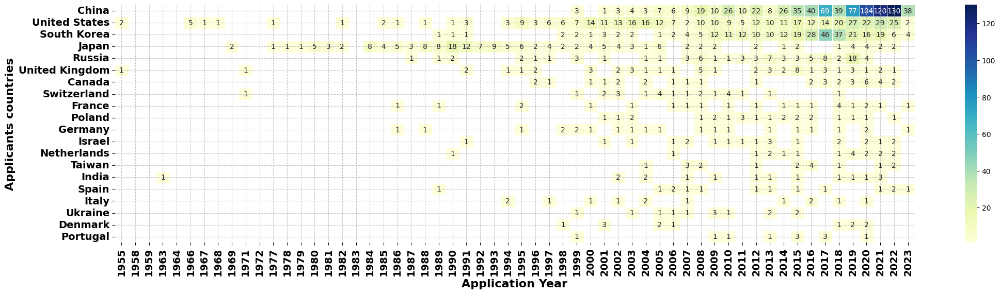

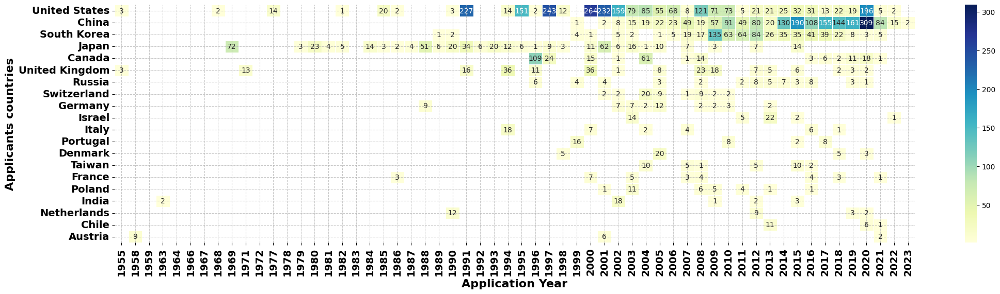

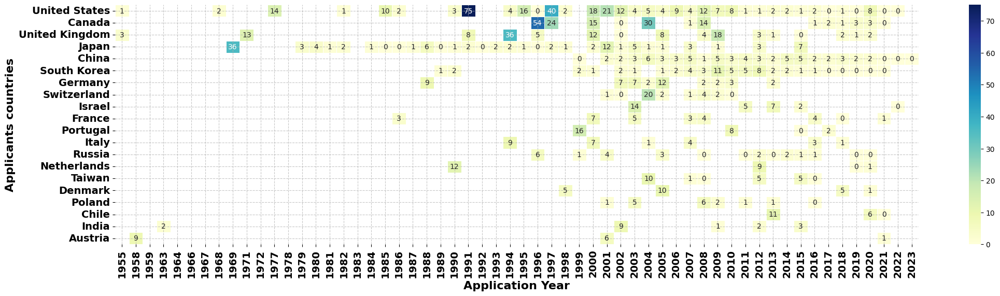

In [ ]:
col_name = 'Applicants_countries'
xlabel = "Application Year"
ylabel = 'Applicants countries'
pivot_df = group_and_pivot_applicants(col_name,data)
figsize=(25, 6)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df["Publication Count"].sum(axis=1).nlargest(200)

Applicants_countries
China                   809.0
United States           379.0
South Korea             290.0
Japan                   165.0
Russia                   81.0
United Kingdom           52.0
Canada                   35.0
Switzerland              24.0
France                   23.0
Poland                   23.0
Germany                  22.0
Israel                   21.0
Netherlands              18.0
Taiwan                   17.0
India                    16.0
Spain                    14.0
Italy                    13.0
Ukraine                  13.0
Denmark                  12.0
Portugal                 11.0
Austria                   9.0
Australia                 8.0
Chile                     6.0
Belgium                   6.0
Georgia                   5.0
Tunisia                   5.0
Mexico                    5.0
Brazil                    5.0
Thailand                  4.0
Turkey                    3.0
Malaysia                  3.0
Cuba                      2.0
Singapore          

In [ ]:
top10diseases = pivot_df["Publication Count"].sum(axis=1).nlargest(5).index
top10diseases

Index(['China', 'United States', 'South Korea', 'Japan', 'Russia'], dtype='object', name='Applicants_countries')

In [ ]:
diseases_data_to_plot = pivot_df["Publication Count"].T[top10diseases]
diseases_data_to_plot

Applicants_countries,China,United States,South Korea,Japan,Russia
Application Year,,,,,
1955,NaN,2.0,NaN,NaN,NaN
1958,NaN,NaN,NaN,NaN,NaN
1959,NaN,NaN,NaN,NaN,NaN
1963,NaN,NaN,NaN,NaN,NaN
1964,NaN,NaN,NaN,NaN,NaN
1966,NaN,5.0,NaN,NaN,NaN
1967,NaN,1.0,NaN,NaN,NaN
1968,NaN,1.0,NaN,NaN,NaN
1969,NaN,NaN,NaN,2.0,NaN


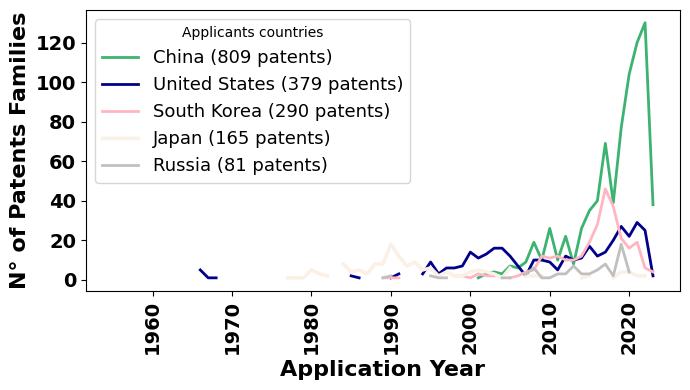

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = diseases_data_to_plot.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'China', 'United States', 'South Korea', 'Japan', 'Russia']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['China'], label='China (809 patents)', color='mediumseagreen', linewidth=2.)
plt.plot(x, data_trend2['United States'], label='United States (379 patents)', color='darkblue', linewidth=2.)
plt.plot(x, data_trend2['South Korea'], label='South Korea (290 patents)', color='lightpink', linewidth=2)
plt.plot(x, data_trend2['Japan'], label='Japan (165 patents)', color='linen', linewidth=2.5)
plt.plot(x, data_trend2['Russia'], label='Russia (81 patents)', color='silver', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants countries',loc='upper left', fontsize=13)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


The number of unique applicants is: 52


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

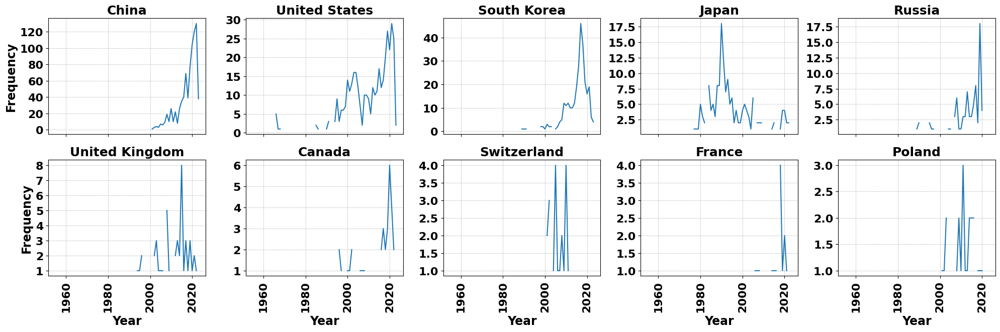

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 10
plot_elt_counts_by_year(col_name, data, n_largest)

## applicants regions

The number of unique applicants is: 7


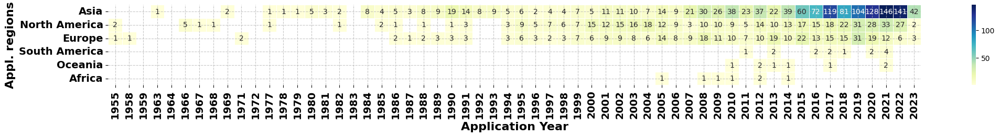

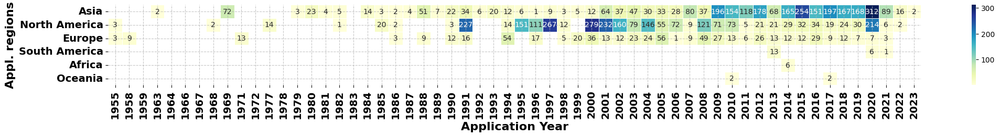

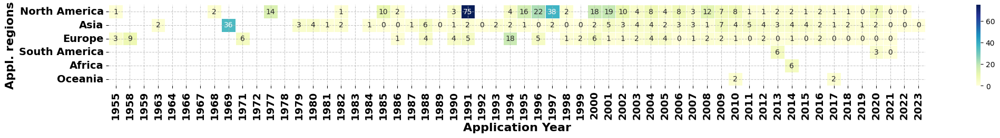

In [ ]:
col_name = 'Applicants_regions'
xlabel = "Application Year"
ylabel = 'Appl. regions'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 6
figsize=(25, 2)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df["Publication Count"].sum(axis=1).nlargest(200)

Applicants_regions
Asia             1327.0
North America     420.0
Europe            332.0
South America      14.0
Oceania             8.0
Africa              7.0
dtype: float64

In [ ]:
top10diseases = pivot_df["Publication Count"].sum(axis=1).nlargest(5).index
top10diseases

Index(['Asia', 'North America', 'Europe', 'South America', 'Oceania'], dtype='object', name='Applicants_regions')

In [ ]:
diseases_data_to_plot = pivot_df["Publication Count"].T[top10diseases]
diseases_data_to_plot

Applicants_regions,Asia,North America,Europe,South America,Oceania
Application Year,,,,,
1955,NaN,2.0,1.0,NaN,NaN
1958,NaN,NaN,1.0,NaN,NaN
1959,NaN,NaN,NaN,NaN,NaN
1963,1.0,NaN,NaN,NaN,NaN
1964,NaN,NaN,NaN,NaN,NaN
1966,NaN,5.0,NaN,NaN,NaN
1967,NaN,1.0,NaN,NaN,NaN
1968,NaN,1.0,NaN,NaN,NaN
1969,2.0,NaN,NaN,NaN,NaN


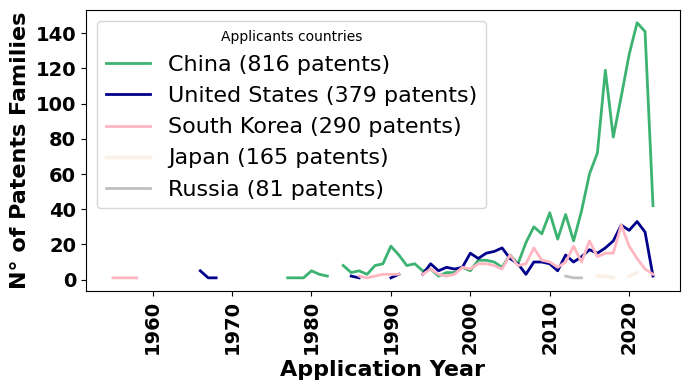

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = diseases_data_to_plot.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'China', 'United States', 'South Korea', 'Japan', 'Russia']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['China'], label='China (816 patents)', color='mediumseagreen', linewidth=2.)
plt.plot(x, data_trend2['United States'], label='United States (379 patents)', color='darkblue', linewidth=2.)
plt.plot(x, data_trend2['South Korea'], label='South Korea (290 patents)', color='lightpink', linewidth=2)
plt.plot(x, data_trend2['Japan'], label='Japan (165 patents)', color='linen', linewidth=2.5)
plt.plot(x, data_trend2['Russia'], label='Russia (81 patents)', color='silver', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants countries',loc='upper left', fontsize=16)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


The number of unique applicants is: 7


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

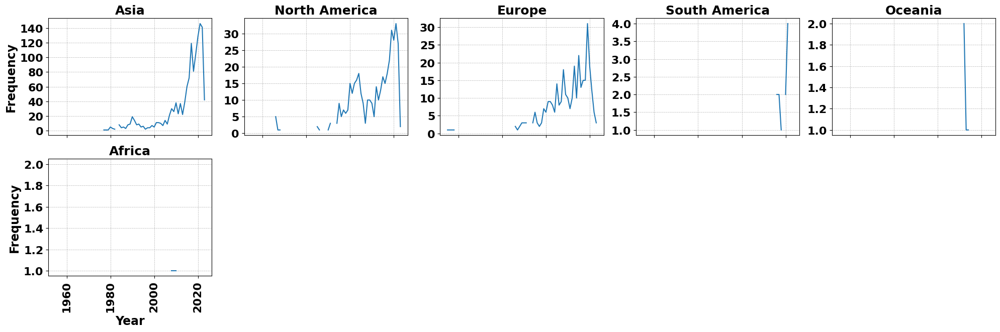

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 10
plot_elt_counts_by_year(col_name, data, n_largest)

## Applicants

The number of unique applicants is: 1854


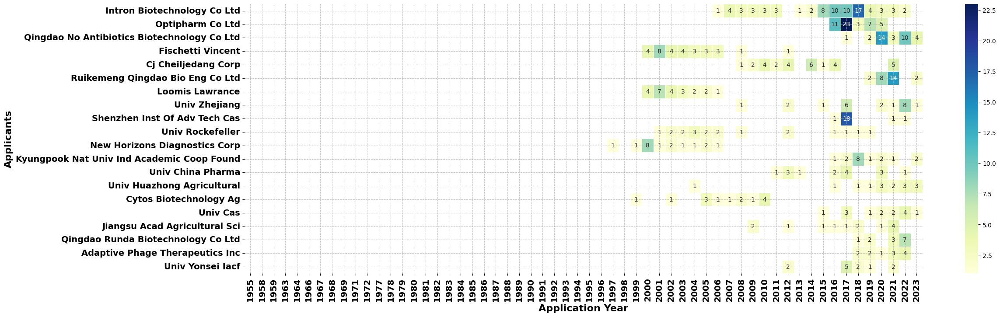

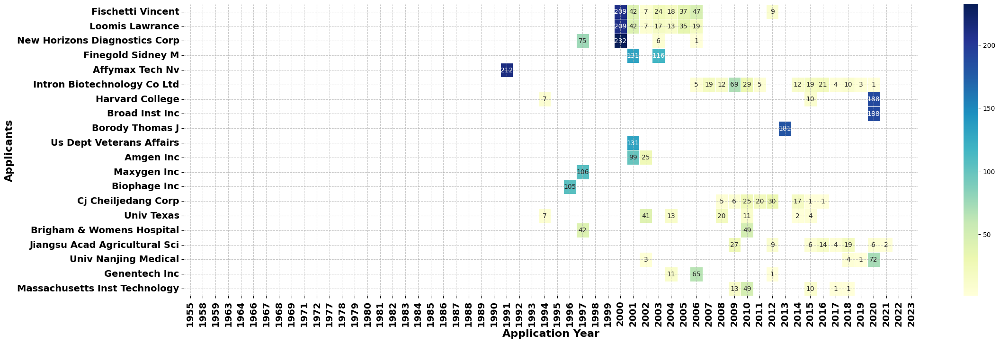

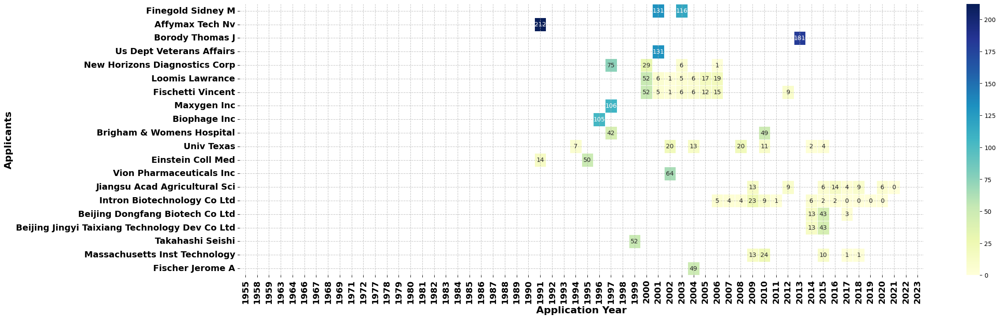

In [ ]:
col_name = 'Applicants_clean'
xlabel = "Application Year"
ylabel = 'Applicants'
pivot_df = group_and_pivot_applicants(col_name,data)
figsize=(25, 8)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

The number of unique applicants is: 1854


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

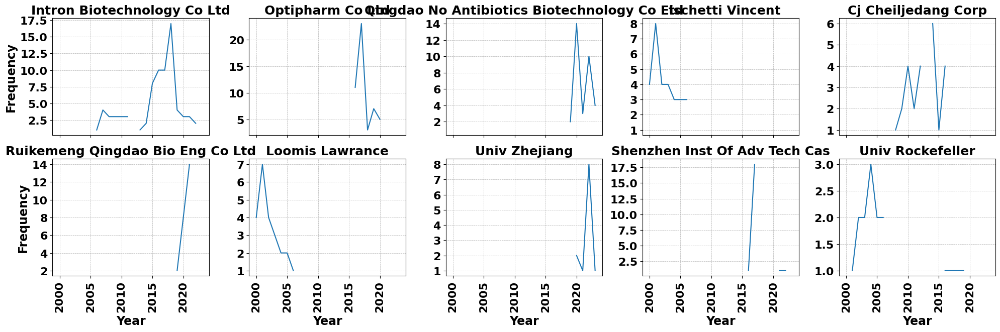

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 10
plot_elt_counts_by_year(col_name, data, n_largest)

## Inventors

The number of unique applicants is: 5367


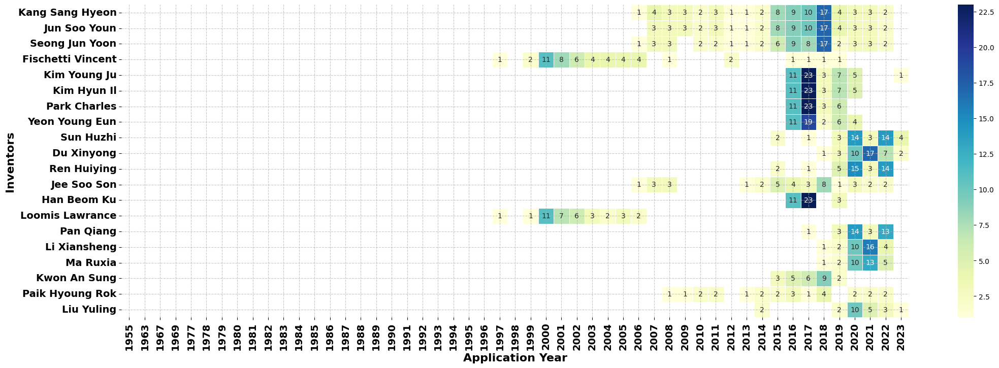

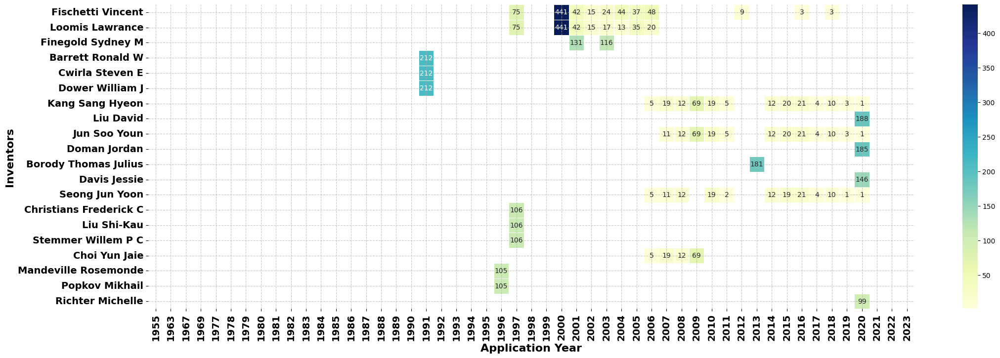

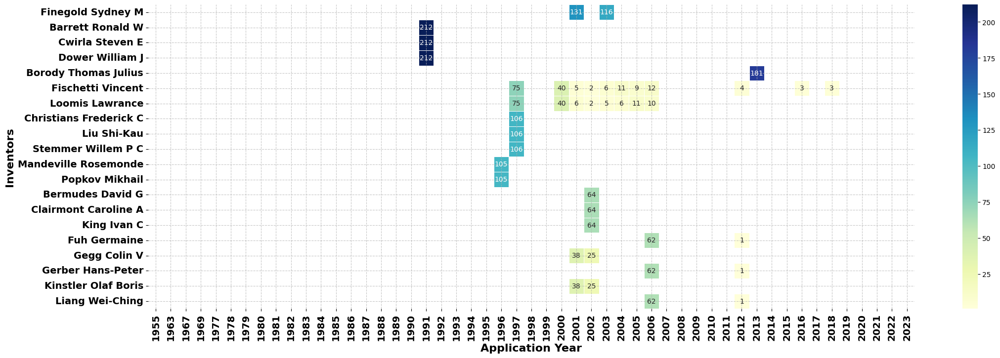

In [ ]:
col_name = 'Inventors_clean'
xlabel = "Application Year"
ylabel = 'Inventors'
pivot_df = group_and_pivot_applicants(col_name,data)
figsize=(25, 8)
n_largest = 20

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

The number of unique applicants is: 5367


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

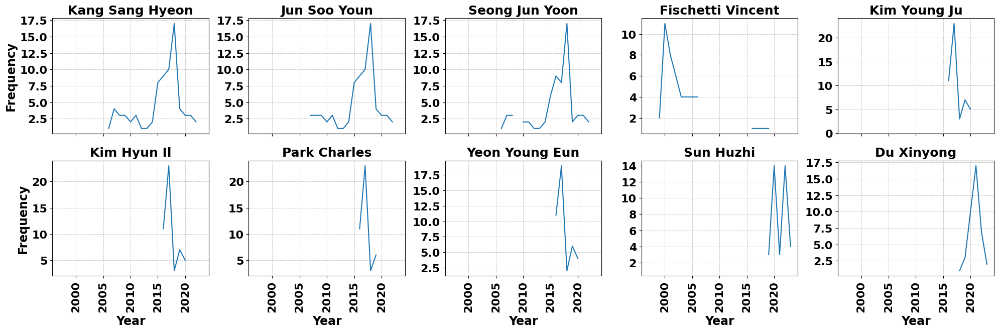

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 10
plot_elt_counts_by_year(col_name, data, n_largest)

## Jurisdictions regions

The number of unique applicants is: 7


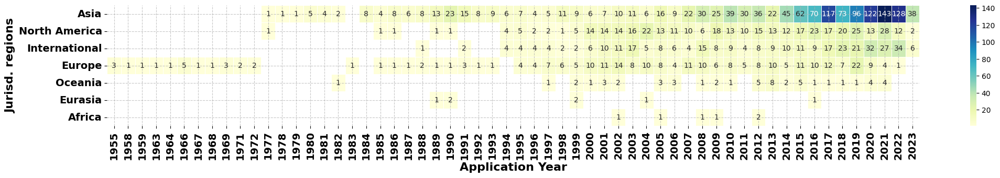

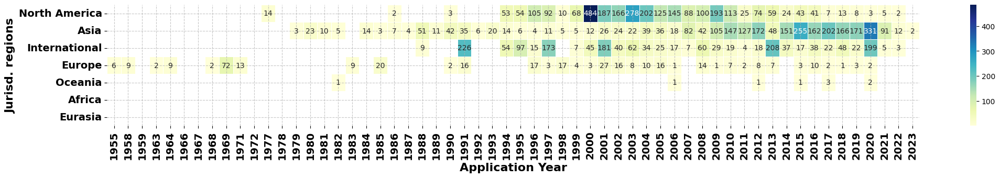

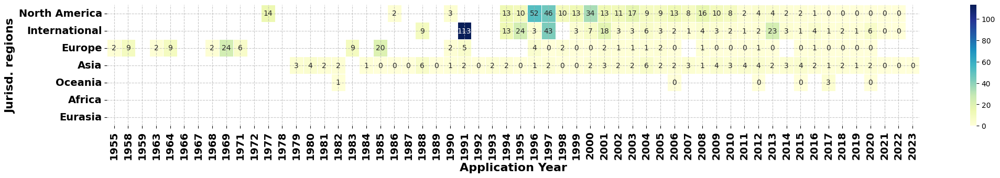

In [ ]:
col_name = 'Jurisdiction_Region'
xlabel = "Application Year"
ylabel = 'Jurisd. regions'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 7
figsize=(25, 3)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df["Publication Count"].sum(axis=1).nlargest(200)

Jurisdiction_Region
Asia             1321.0
North America     382.0
International     333.0
Europe            264.0
Oceania            52.0
Eurasia             7.0
Africa              6.0
dtype: float64

In [ ]:
top10diseases = pivot_df["Publication Count"].sum(axis=1).nlargest(5).index
top10diseases

Index(['Asia', 'North America', 'International', 'Europe', 'Oceania'], dtype='object', name='Jurisdiction_Region')

In [ ]:
diseases_data_to_plot = pivot_df["Publication Count"].T[top10diseases]
diseases_data_to_plot

Jurisdiction_Region,Asia,North America,International,Europe,Oceania
Application Year,,,,,
1955,NaN,NaN,NaN,3.0,NaN
1958,NaN,NaN,NaN,1.0,NaN
1959,NaN,NaN,NaN,1.0,NaN
1963,NaN,NaN,NaN,1.0,NaN
1964,NaN,NaN,NaN,1.0,NaN
1966,NaN,NaN,NaN,5.0,NaN
1967,NaN,NaN,NaN,1.0,NaN
1968,NaN,NaN,NaN,1.0,NaN
1969,NaN,NaN,NaN,3.0,NaN


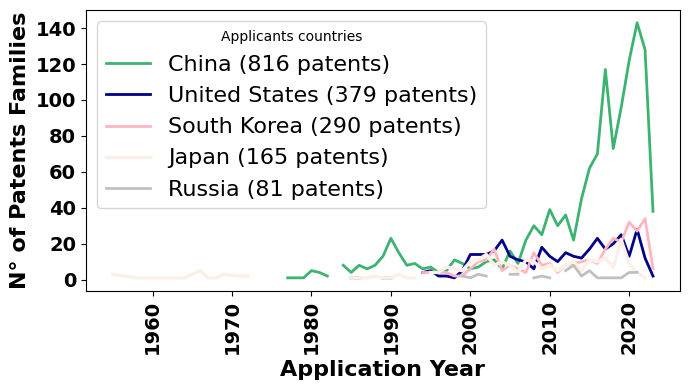

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = diseases_data_to_plot.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'China', 'United States', 'South Korea', 'Japan', 'Russia']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['China'], label='China (816 patents)', color='mediumseagreen', linewidth=2.)
plt.plot(x, data_trend2['United States'], label='United States (379 patents)', color='darkblue', linewidth=2.)
plt.plot(x, data_trend2['South Korea'], label='South Korea (290 patents)', color='lightpink', linewidth=2)
plt.plot(x, data_trend2['Japan'], label='Japan (165 patents)', color='linen', linewidth=2.5)
plt.plot(x, data_trend2['Russia'], label='Russia (81 patents)', color='silver', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants countries',loc='upper left', fontsize=16)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


The number of unique applicants is: 7


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

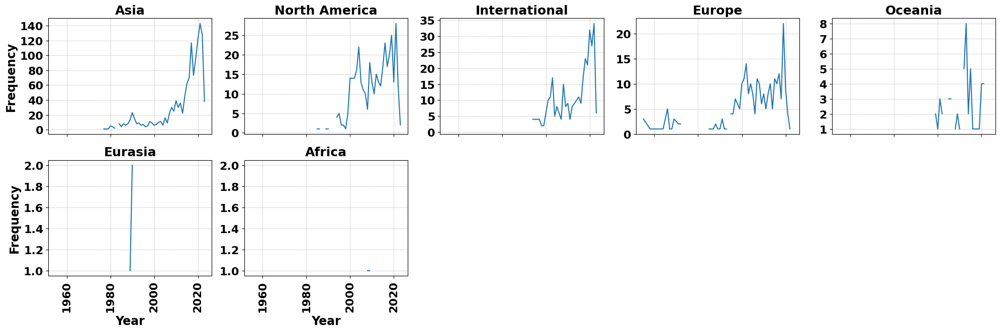

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 10
plot_elt_counts_by_year(col_name, data, n_largest)

## Jurisdictions country

The number of unique applicants is: 32


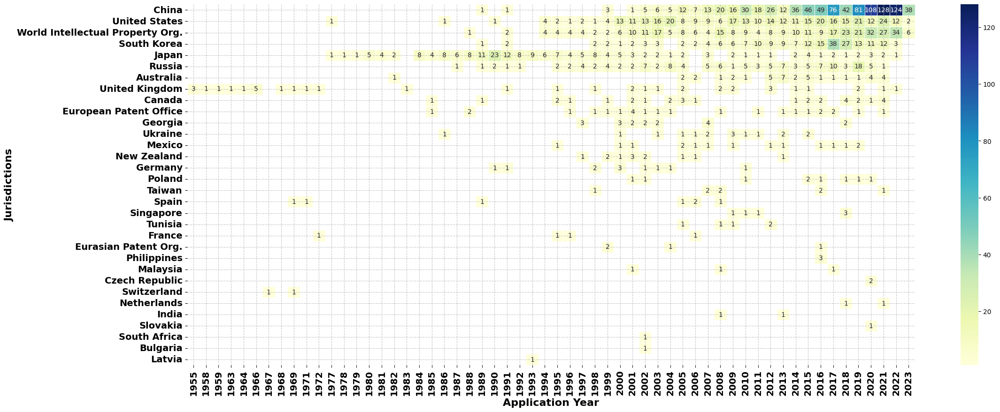

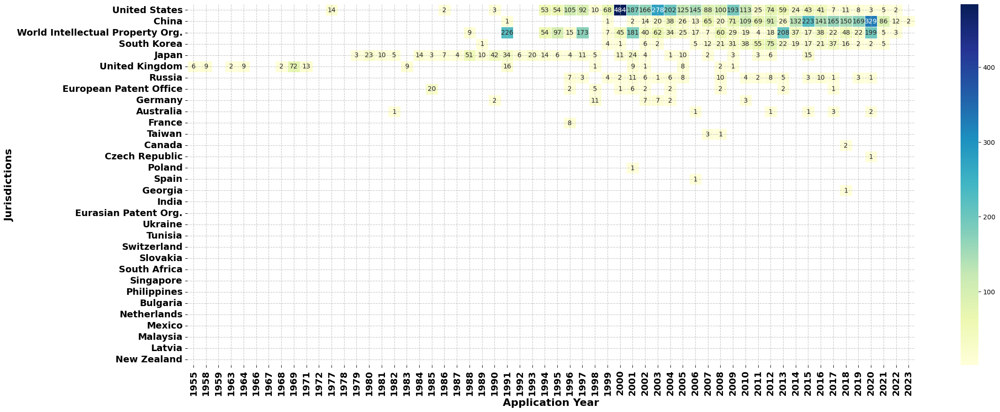

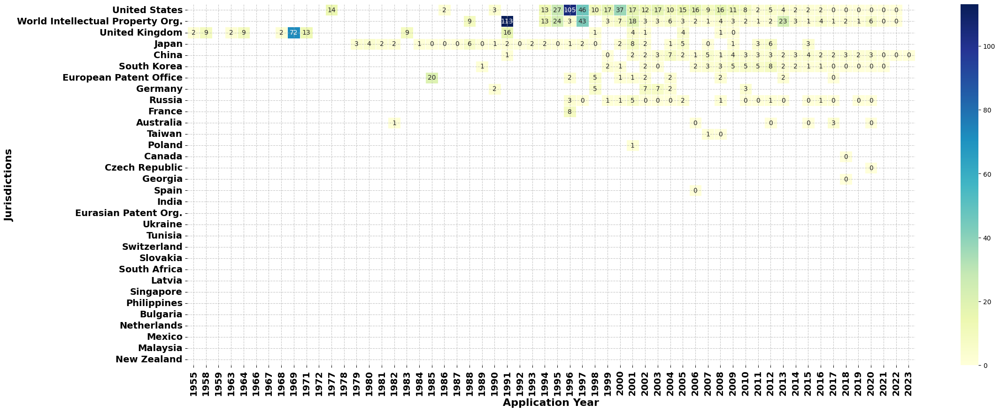

In [ ]:
col_name = 'Jurisdiction_name'
xlabel = "Application Year"
ylabel = 'Jurisdictions'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 32
figsize=(25, 10)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df["Publication Count"].sum(axis=1).nlargest(200)

Jurisdiction_name
China                               904.0
United States                       336.0
World Intellectual Property Org.    333.0
South Korea                         209.0
Japan                               186.0
Russia                              129.0
Australia                            40.0
United Kingdom                       39.0
Canada                               31.0
European Patent Office               25.0
Georgia                              18.0
Ukraine                              16.0
Mexico                               15.0
New Zealand                          12.0
Germany                              11.0
Poland                                9.0
Taiwan                                8.0
Spain                                 7.0
Singapore                             6.0
Tunisia                               5.0
France                                4.0
Eurasian Patent Org.                  4.0
Philippines                           3.0
Malaysia        

In [ ]:
top10diseases = pivot_df["Publication Count"].sum(axis=1).nlargest(5).index
top10diseases

Index(['China', 'United States', 'World Intellectual Property Org.',
       'South Korea', 'Japan'],
      dtype='object', name='Jurisdiction_name')

In [ ]:
diseases_data_to_plot = pivot_df["Publication Count"].T[top10diseases]
diseases_data_to_plot

Jurisdiction_name,China,United States,World Intellectual Property Org.,South Korea,Japan
Application Year,,,,,
1955,NaN,NaN,NaN,NaN,NaN
1958,NaN,NaN,NaN,NaN,NaN
1959,NaN,NaN,NaN,NaN,NaN
1963,NaN,NaN,NaN,NaN,NaN
1964,NaN,NaN,NaN,NaN,NaN
1966,NaN,NaN,NaN,NaN,NaN
1967,NaN,NaN,NaN,NaN,NaN
1968,NaN,NaN,NaN,NaN,NaN
1969,NaN,NaN,NaN,NaN,NaN


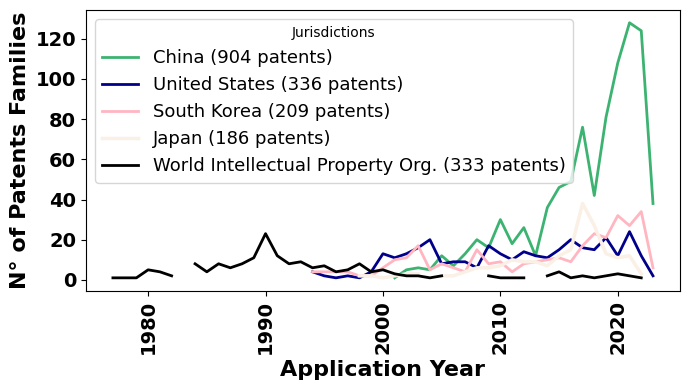

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = diseases_data_to_plot.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'China', 'United States', 'South Korea', 'Japan', 'World Intellectual Property Org.']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['China'], label='China (904 patents)', color='mediumseagreen', linewidth=2.)
plt.plot(x, data_trend2['United States'], label='United States (336 patents)', color='darkblue', linewidth=2.)
plt.plot(x, data_trend2['South Korea'], label='South Korea (209 patents)', color='lightpink', linewidth=2)
plt.plot(x, data_trend2['Japan'], label='Japan (186 patents)', color='linen', linewidth=2.5)
plt.plot(x, data_trend2['World Intellectual Property Org.'], label='World Intellectual Property Org. (333 patents)', color='BLACK', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Jurisdictions',loc='upper left', fontsize=13)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


The number of unique applicants is: 32


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

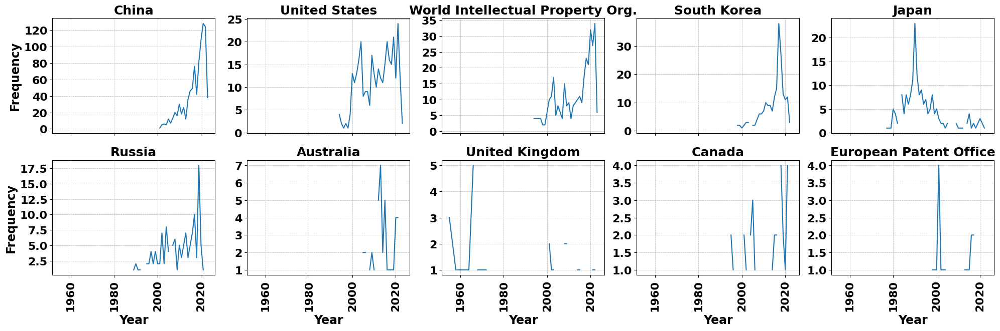

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 10
plot_elt_counts_by_year(col_name, data, n_largest)

## Applicants categories

The number of unique applicants is: 5


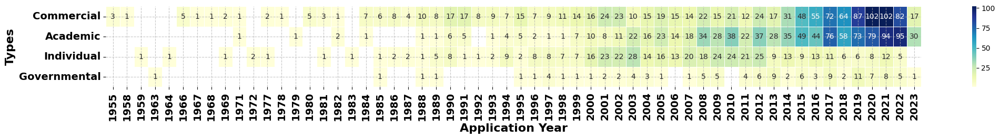

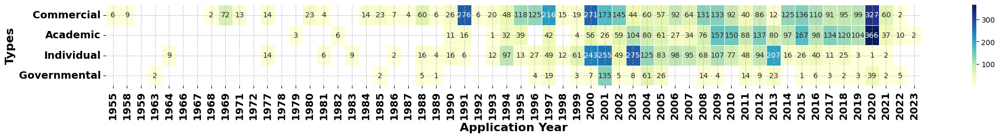

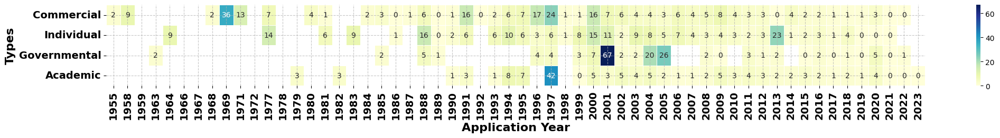

In [ ]:
col_name = 'Applicants_categories'
xlabel = "Application Year"
ylabel = 'Types'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 4
figsize=(25, 2)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df["Publication Count"].sum(axis=1).nlargest(200)

Applicants_categories
Commercial      1090.0
Academic         981.0
Individual       428.0
Governmental     109.0
NC                 7.0
dtype: float64

In [ ]:
top10diseases = pivot_df["Publication Count"].sum(axis=1).nlargest(5).index
top10diseases

Index(['Commercial', 'Academic', 'Individual', 'Governmental', 'NC'], dtype='object', name='Applicants_categories')

In [ ]:
diseases_data_to_plot = pivot_df["Publication Count"].T[top10diseases]
diseases_data_to_plot

Applicants_categories,Commercial,Academic,Individual,Governmental,NC
Application Year,,,,,
1955,3.0,NaN,NaN,NaN,NaN
1958,1.0,NaN,NaN,NaN,NaN
1959,NaN,NaN,1.0,NaN,NaN
1963,NaN,NaN,NaN,1.0,NaN
1964,NaN,NaN,1.0,NaN,NaN
1966,5.0,NaN,NaN,NaN,NaN
1967,1.0,NaN,NaN,NaN,NaN
1968,1.0,NaN,NaN,NaN,NaN
1969,2.0,NaN,1.0,NaN,NaN


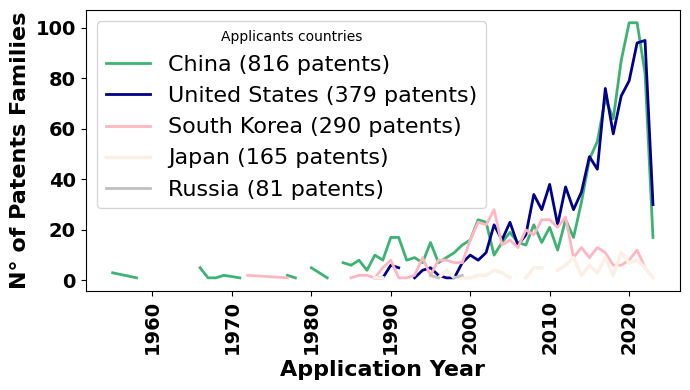

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = diseases_data_to_plot.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'China', 'United States', 'South Korea', 'Japan', 'Russia']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(7, 4))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['China'], label='China (816 patents)', color='mediumseagreen', linewidth=2.)
plt.plot(x, data_trend2['United States'], label='United States (379 patents)', color='darkblue', linewidth=2.)
plt.plot(x, data_trend2['South Korea'], label='South Korea (290 patents)', color='lightpink', linewidth=2)
plt.plot(x, data_trend2['Japan'], label='Japan (165 patents)', color='linen', linewidth=2.5)
plt.plot(x, data_trend2['Russia'], label='Russia (81 patents)', color='silver', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants countries',loc='upper left', fontsize=16)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


The number of unique applicants is: 5


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

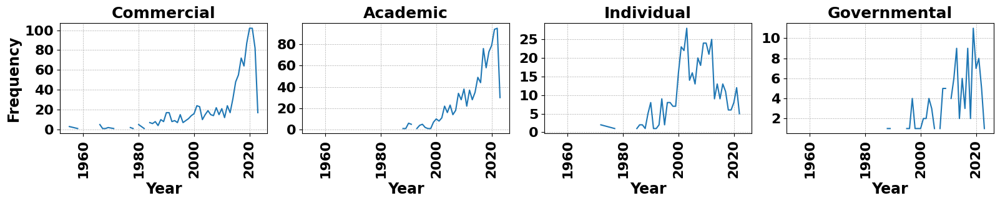

In [ ]:
col_name = 'Applicants_categories'
n_largest = 4
plot_elt_counts_by_year(col_name, data, n_largest)

## Topics

The number of unique applicants is: 10


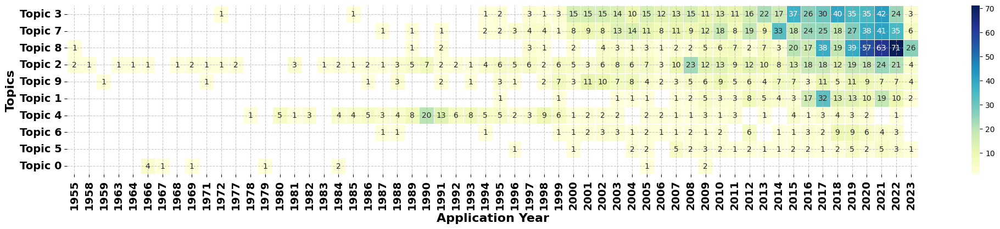

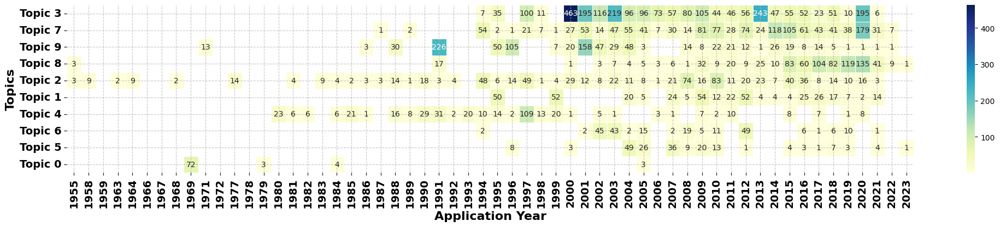

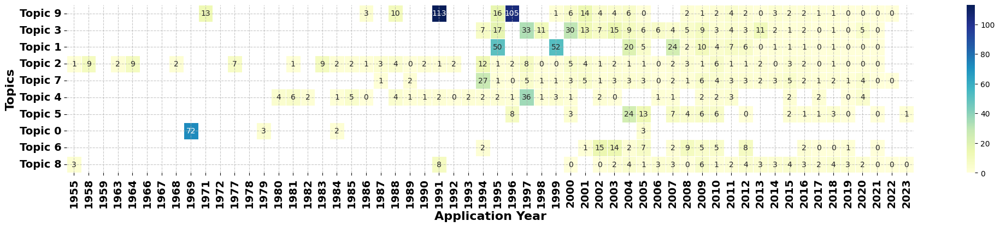

In [ ]:
col_name = 'Topic N°'
xlabel = "Application Year"
ylabel = 'Topics'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 10
figsize=(25, 4)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df["Publication Count"].sum(axis=1).nlargest(200)

Topic N°
Topic 3    498.0
Topic 7    441.0
Topic 8    406.0
Topic 2    354.0
Topic 9    176.0
Topic 1    155.0
Topic 4    154.0
Topic 6     67.0
Topic 5     46.0
Topic 0     12.0
dtype: float64

In [ ]:
top10diseases = pivot_df["Publication Count"].sum(axis=1).index
top10diseases

Index(['Topic 0', 'Topic 1', 'Topic 2', 'Topic 3', 'Topic 4', 'Topic 5',
       'Topic 6', 'Topic 7', 'Topic 8', 'Topic 9'],
      dtype='object', name='Topic N°')

In [ ]:
diseases_data_to_plot = pivot_df["Publication Count"].T[top10diseases]
diseases_data_to_plot

Topic N°,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9
Application Year,,,,,,,,,,
1955,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN
1958,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1959,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0
1963,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1964,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1966,4.0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1967,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1968,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1969,1.0,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


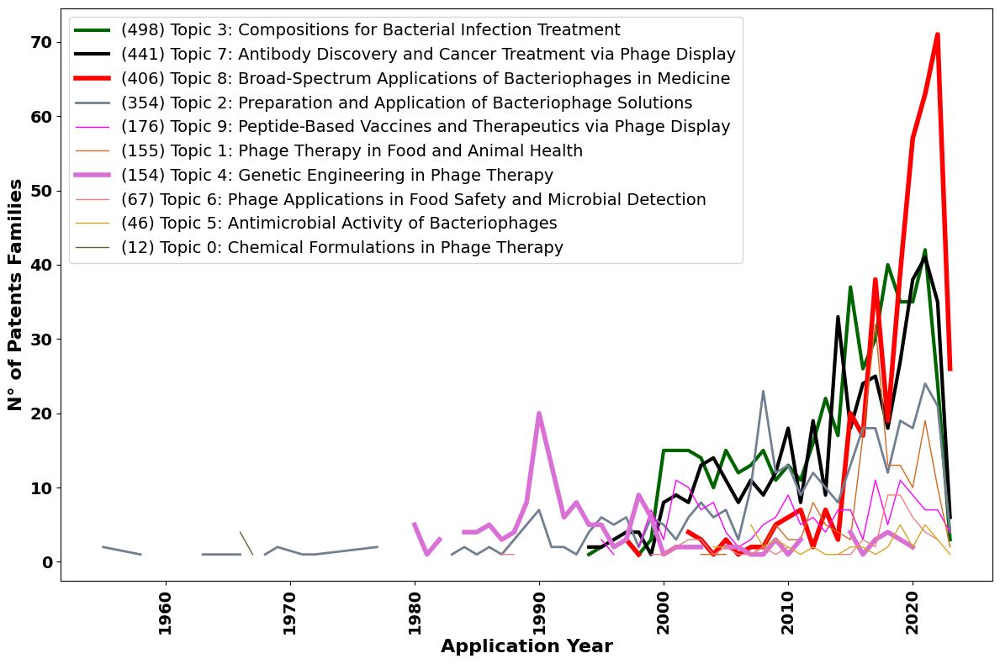

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = diseases_data_to_plot.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'Topic 0', 'Topic 1', 'Topic 2', 'Topic 3', 'Topic 4', 'Topic 5',
       'Topic 6', 'Topic 7', 'Topic 8', 'Topic 9']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(12, 8))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['Topic 3'], label=wrap_text('(498) Topic 3: Compositions for Bacterial Infection Treatment', width=75), color='darkgreen', linewidth=3)
plt.plot(x, data_trend2['Topic 7'], label=wrap_text('(441) Topic 7: Antibody Discovery and Cancer Treatment via Phage Display', width=75), color='black', linewidth=3)
plt.plot(x, data_trend2['Topic 8'], label=wrap_text('(406) Topic 8: Broad-Spectrum Applications of Bacteriophages in Medicine', width=75), color='red', linewidth=4)
plt.plot(x, data_trend2['Topic 2'], label=wrap_text('(354) Topic 2: Preparation and Application of Bacteriophage Solutions', width=75), color='slategray', linewidth=2)
plt.plot(x, data_trend2['Topic 9'], label=wrap_text('(176) Topic 9: Peptide-Based Vaccines and Therapeutics via Phage Display', width=75), color='magenta', linewidth=1)
plt.plot(x, data_trend2['Topic 1'], label=wrap_text('(155) Topic 1: Phage Therapy in Food and Animal Health', width=75), color='chocolate', linewidth=1.)
plt.plot(x, data_trend2['Topic 4'], label=wrap_text('(154) Topic 4: Genetic Engineering in Phage Therapy', width=75), color='orchid', linewidth=4)
plt.plot(x, data_trend2['Topic 6'], label=wrap_text('(67) Topic 6: Phage Applications in Food Safety and Microbial Detection', width=75), color='lightcoral', linewidth=1.)
plt.plot(x, data_trend2['Topic 5'], label=wrap_text('(46) Topic 5: Antimicrobial Activity of Bacteriophages', width=75), color='goldenrod', linewidth=1.)
plt.plot(x, data_trend2['Topic 0'], label=wrap_text('(12) Topic 0: Chemical Formulations in Phage Therapy', width=75), color='darkolivegreen', linewidth=1.)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(loc='upper left', fontsize=14)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


The number of unique applicants is: 10


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

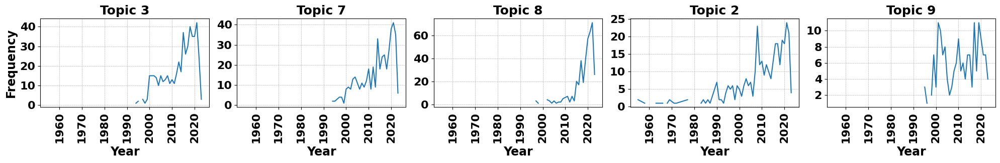

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 5
plot_elt_counts_by_year(col_name, data, n_largest)

## IPCR Sections

The number of unique applicants is: 9


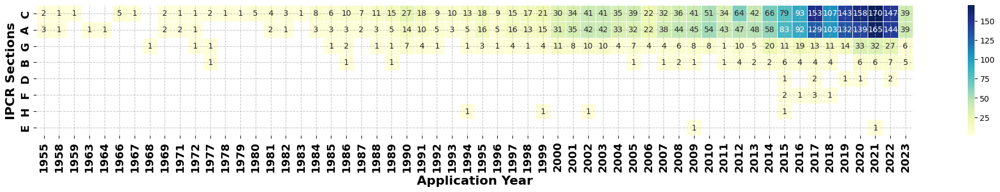

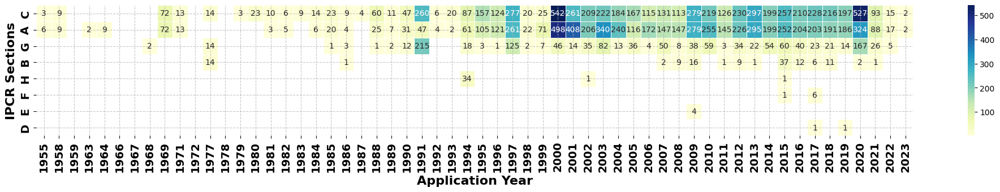

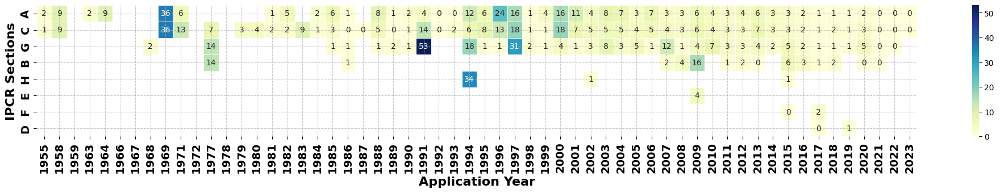

In [ ]:
col_name = 'IPCR Sections'
xlabel = "Application Year"
ylabel = 'IPCR Sections'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 9
figsize=(25, 3)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

The number of unique applicants is: 9


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

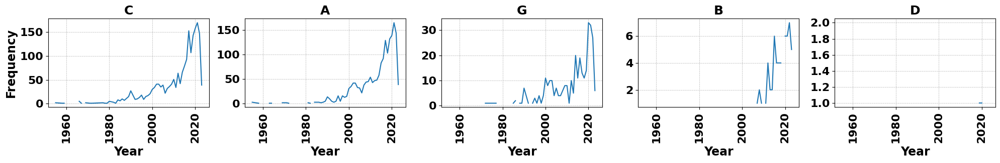

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 5
plot_elt_counts_by_year(col_name, data, n_largest)

## IPCR Class

The number of unique applicants is: 44


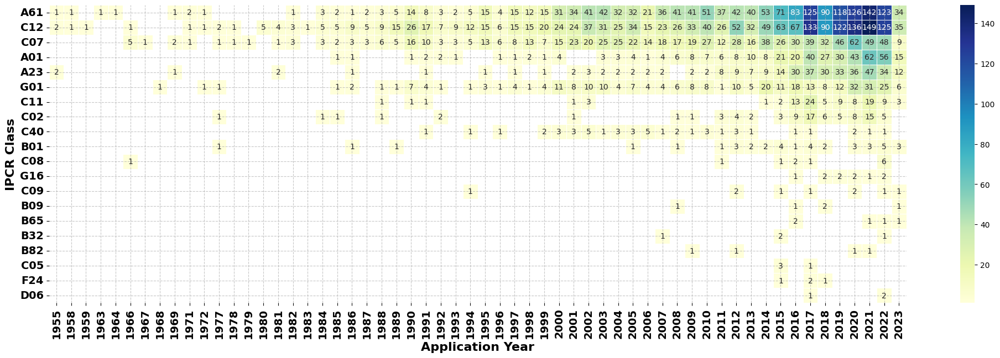

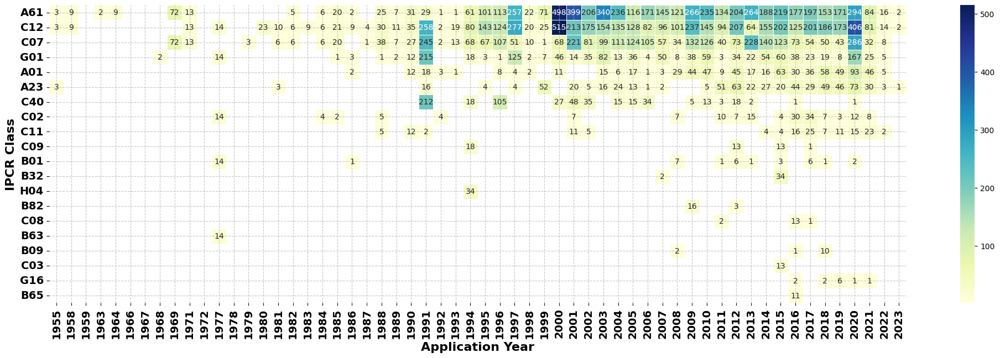

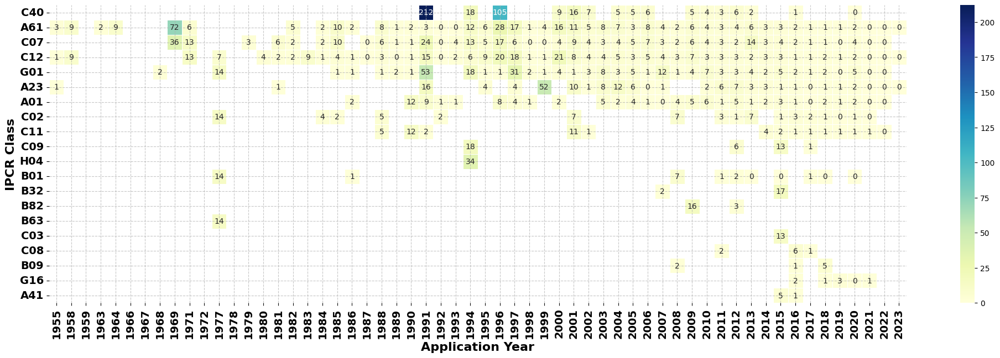

In [ ]:
col_name = 'IPCR Class'
xlabel = "Application Year"
ylabel = 'IPCR Class'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 20
figsize=(25, 7)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

The number of unique applicants is: 44


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

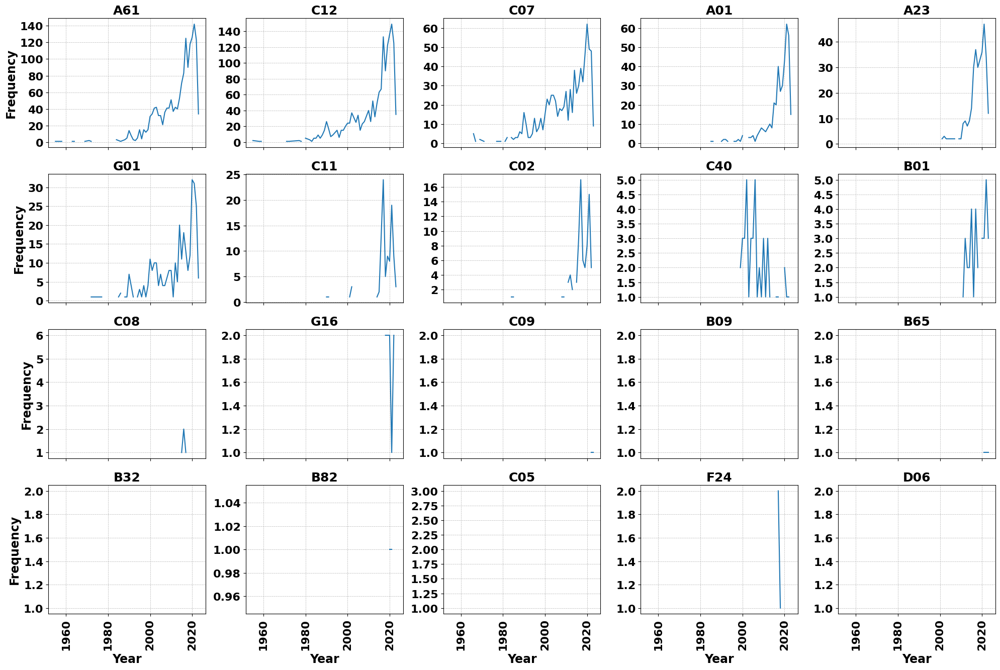

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 20
plot_elt_counts_by_year(col_name, data, n_largest)

## IPCR Sublass

The number of unique applicants is: 98


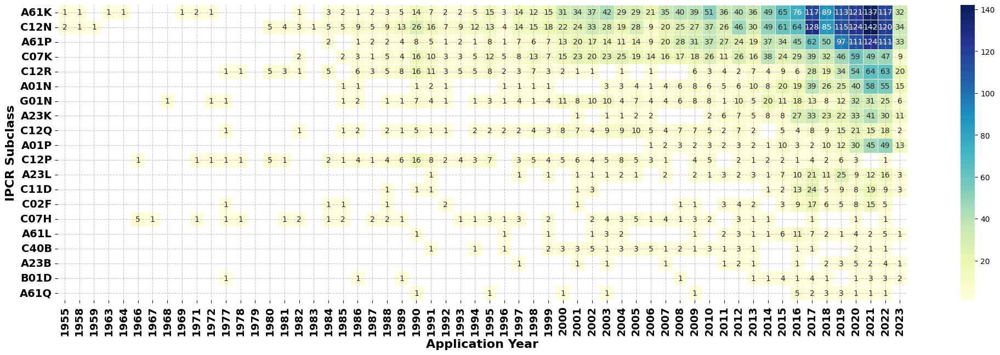

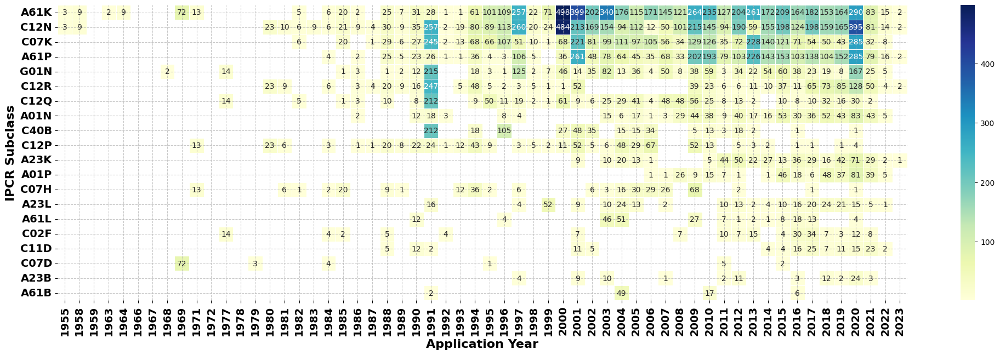

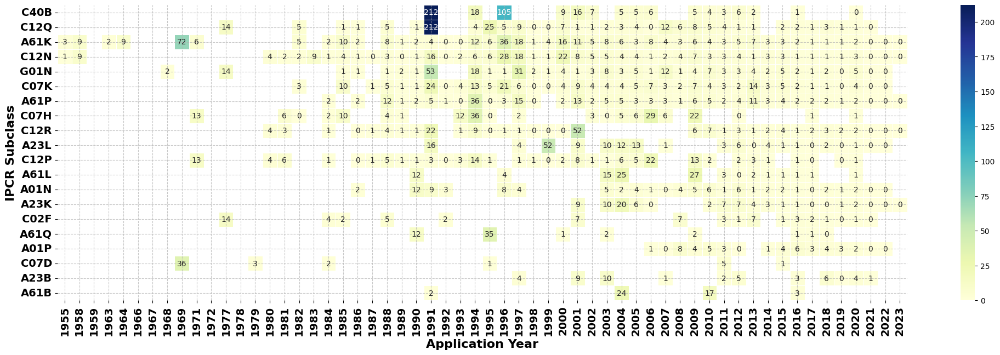

In [ ]:
col_name = 'IPCR Subclass'
xlabel = "Application Year"
ylabel = 'IPCR Subclass'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 20
figsize=(25, 7)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df["Publication Count"].sum(axis=1).nlargest(50)

IPCR Subclass
A61K    1530.0
C12N    1493.0
A61P    1045.0
C07K     740.0
C12R     430.0
A01N     371.0
G01N     306.0
A23K     263.0
C12Q     213.0
A01P     193.0
C12P     151.0
A23L     137.0
C11D     100.0
C02F      86.0
C07H      64.0
A61L      56.0
C40B      46.0
A23B      26.0
B01D      25.0
A61Q      21.0
A01K      19.0
A23C      17.0
C12M      17.0
A61B      13.0
A61M      13.0
B01J      10.0
C07D       9.0
A01G       7.0
A61F       7.0
G16B       7.0
A01H       6.0
A23G       6.0
A61D       5.0
A61N       5.0
C07C       5.0
C09K       5.0
B09C       4.0
B32B       4.0
B82Y       4.0
C08G       4.0
C08J       4.0
C08K       4.0
C08L       4.0
C09D       4.0
F24F       4.0
B01L       3.0
C05G       3.0
G16H       3.0
A41D       2.0
A61C       2.0
dtype: float64

In [ ]:
top10diseases = pivot_df["Publication Count"].sum(axis=1).nlargest(10).index
top10diseases

Index(['A61K', 'C12N', 'A61P', 'C07K', 'C12R', 'A01N', 'G01N', 'A23K', 'C12Q',
       'A01P'],
      dtype='object', name='IPCR Subclass')

In [ ]:
diseases_data_to_plot = pivot_df["Publication Count"].T[top10diseases]
diseases_data_to_plot

IPCR Subclass,A61K,C12N,A61P,C07K,C12R,A01N,G01N,A23K,C12Q,A01P
Application Year,,,,,,,,,,
1955,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1958,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1959,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1963,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1964,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1966,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1967,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1968,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN
1969,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


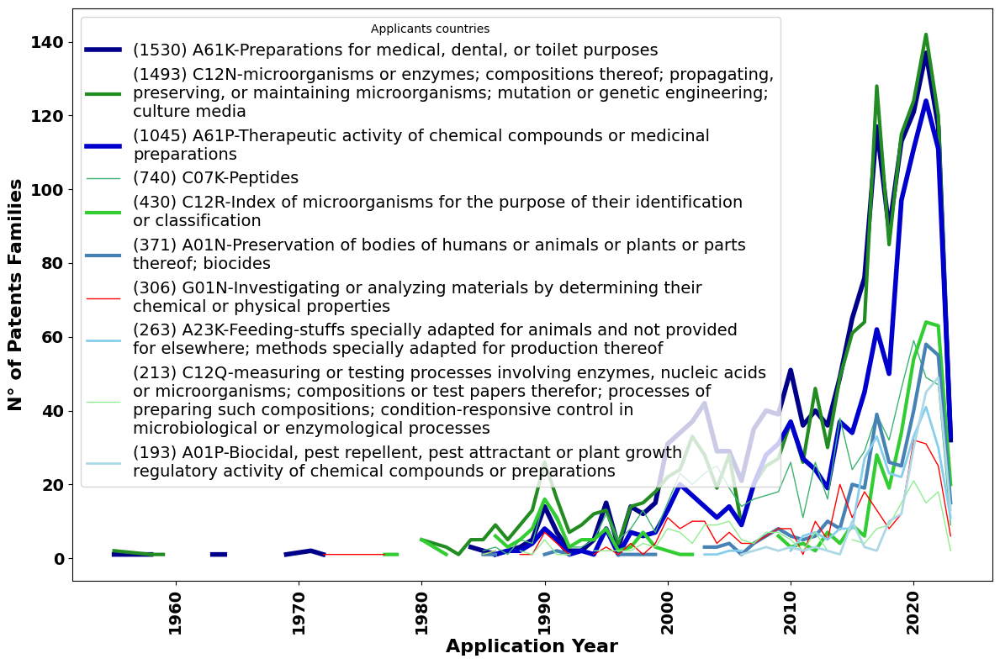

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = diseases_data_to_plot.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'A61K', 'C12N', 'A61P', 'C07K', 'C12R', 'A01N', 'G01N', 'A23K', 'C12Q',
       'A01P']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(12, 8))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['A61K'], label=wrap_text('(1530) A61K-Preparations for medical, dental, or toilet purposes', width=75), color='darkblue', linewidth=4.)
plt.plot(x, data_trend2['C12N'], label=wrap_text('(1493) C12N-microorganisms or enzymes; compositions thereof; propagating, preserving, or maintaining microorganisms; mutation or genetic engineering; culture media', width=75), color='forestgreen', linewidth=3.)
plt.plot(x, data_trend2['A61P'], label=wrap_text('(1045) A61P-Therapeutic activity of chemical compounds or medicinal preparations', width=75), color='mediumblue', linewidth=4)
plt.plot(x, data_trend2['C07K'], label=wrap_text('(740) C07K-Peptides', width=75), color='mediumseagreen', linewidth=1)
plt.plot(x, data_trend2['C12R'], label=wrap_text('(430) C12R-Index of microorganisms for the purpose of their identification or classification', width=75), color='limegreen', linewidth=3)

plt.plot(x, data_trend2['A01N'], label=wrap_text('(371) A01N-Preservation of bodies of humans or animals or plants or parts thereof; biocides', width=75), color='steelblue', linewidth=3.)
plt.plot(x, data_trend2['G01N'], label=wrap_text('(306) G01N-Investigating or analyzing materials by determining their chemical or physical properties', width=75), color='red', linewidth=1.)
plt.plot(x, data_trend2['A23K'], label=wrap_text('(263) A23K-Feeding-stuffs specially adapted for animals and not provided for elsewhere; methods specially adapted for production thereof', width=75), color='skyblue', linewidth=2)
plt.plot(x, data_trend2['C12Q'], label=wrap_text('(213) C12Q-measuring or testing processes involving enzymes, nucleic acids or microorganisms; compositions or test papers therefor; processes of preparing such compositions; condition-responsive control in microbiological or enzymological processes', width=75), color='lightgreen', linewidth=1)
plt.plot(x, data_trend2['A01P'], label=wrap_text('(193) A01P-Biocidal, pest repellent, pest attractant or plant growth regulatory activity of chemical compounds or preparations', width=75), color='lightblue', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants countries',loc='upper left', fontsize=14)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


The number of unique applicants is: 98


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

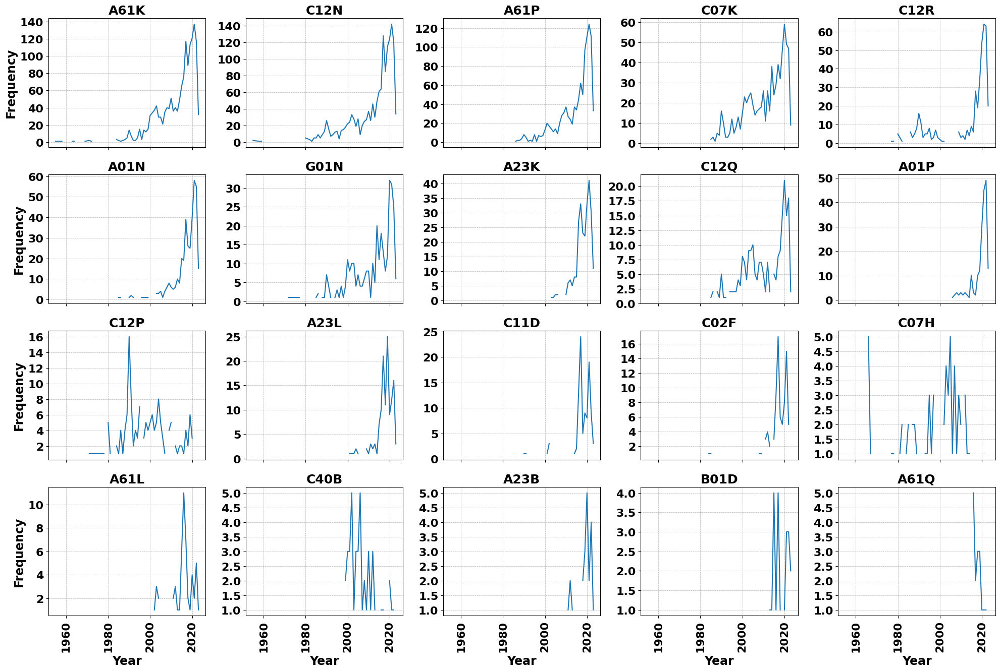

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 20
plot_elt_counts_by_year(col_name, data, n_largest)

## IPCR Classifications

The number of unique applicants is: 1415


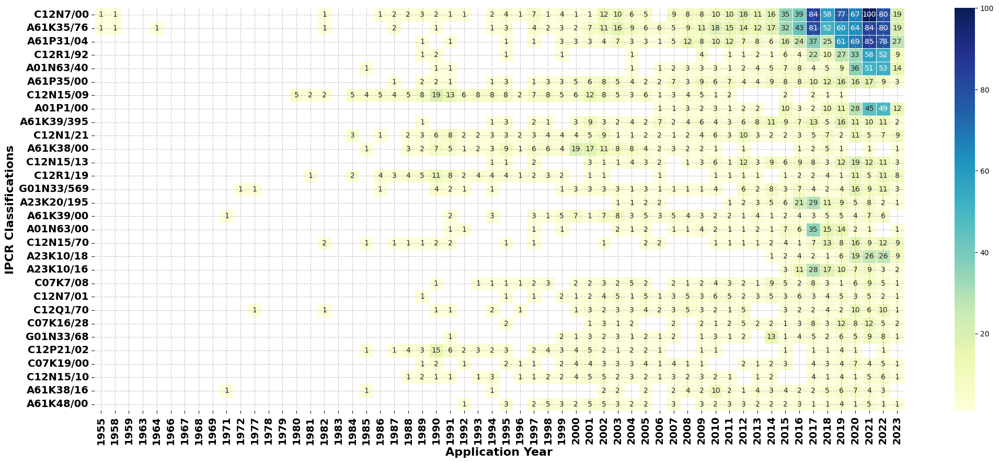

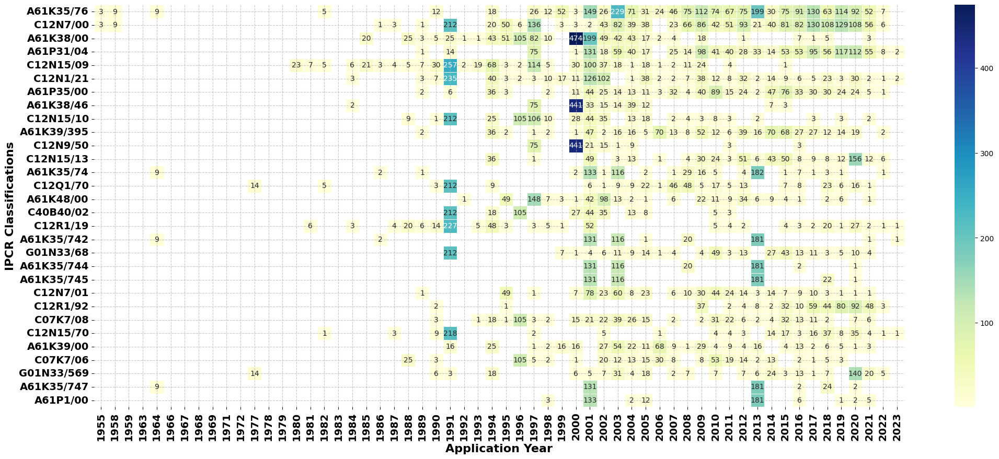

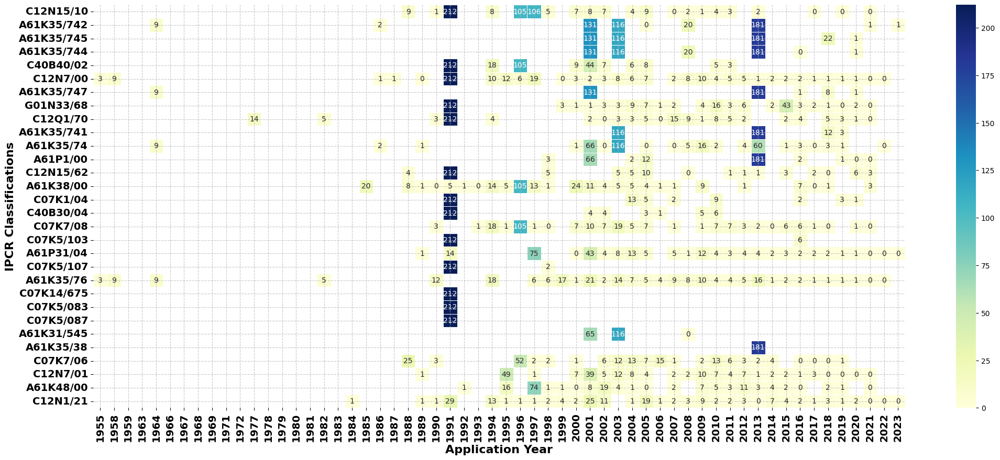

In [ ]:
col_name = 'IPCR Classifications'
xlabel = "Application Year"
ylabel = 'IPCR Classifications'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 30
figsize=(25, 10)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

In [ ]:
pivot_df["Publication Count"].sum(axis=1).nlargest(40)

IPCR Classifications
C12N7/00      718.0
A61K35/76     693.0
A61P31/04     521.0
C12R1/92      236.0
A01N63/40     215.0
A61P35/00     197.0
C12N15/09     186.0
A01P1/00      185.0
A61K39/395    166.0
C12N1/21      152.0
A61K38/00     139.0
C12N15/13     136.0
C12R1/19      112.0
G01N33/569    111.0
A23K20/195    109.0
A61K39/00     107.0
A01N63/00     103.0
C12N15/70     102.0
A23K10/18      96.0
A23K10/16      90.0
C07K7/08       90.0
C12N7/01       88.0
C12Q1/70       84.0
C07K16/28      79.0
G01N33/68      79.0
C12P21/02      77.0
C07K19/00      74.0
C12N15/10      73.0
A61K38/16      70.0
A61K48/00      70.0
C12N1/20       70.0
G01N33/574     70.0
C07K7/06       67.0
C12N15/63      66.0
A23L3/3571     65.0
C07K16/10      65.0
C12N5/10       62.0
C12N7/02       62.0
C11D3/48       61.0
C11D3/38       58.0
dtype: float64

In [ ]:
top10diseases = pivot_df["Publication Count"].sum(axis=1).nlargest(10).index
top10diseases

Index(['C12N7/00', 'A61K35/76', 'A61P31/04', 'C12R1/92', 'A01N63/40',
       'A61P35/00', 'C12N15/09', 'A01P1/00', 'A61K39/395', 'C12N1/21'],
      dtype='object', name='IPCR Classifications')

In [ ]:
diseases_data_to_plot = pivot_df["Publication Count"].T[top10diseases]
diseases_data_to_plot

IPCR Classifications,C12N7/00,A61K35/76,A61P31/04,C12R1/92,A01N63/40,A61P35/00,C12N15/09,A01P1/00,A61K39/395,C12N1/21
Application Year,,,,,,,,,,
1955,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1958,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1959,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1964,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1966,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1967,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1968,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1969,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


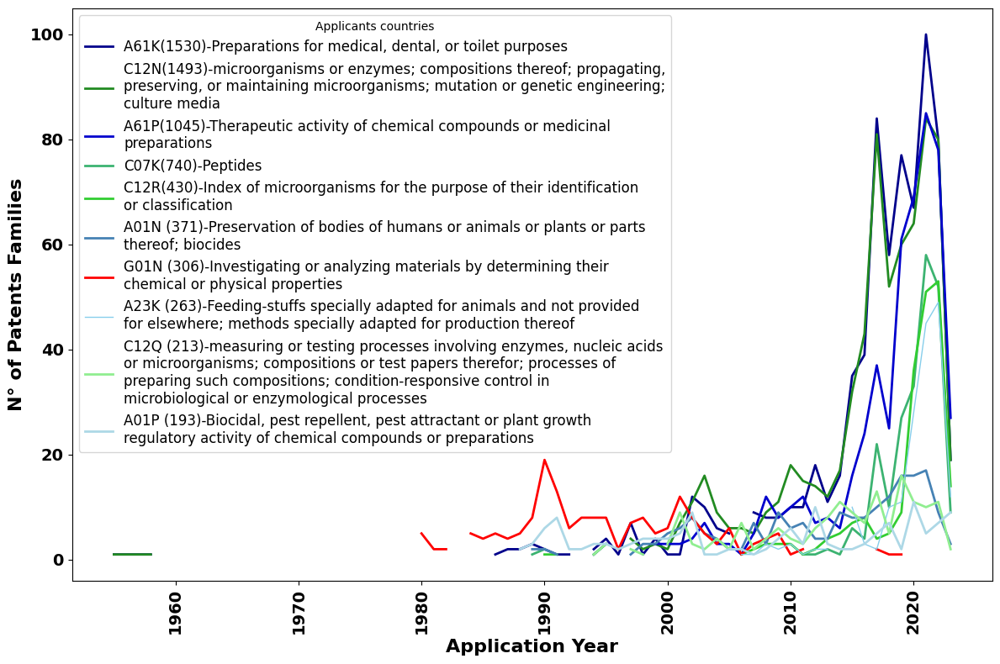

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Assuming your data is in a CSV file called 'patent_data.csv'
data_trend = diseases_data_to_plot.reset_index()

# Rename your columns for easier access
data_trend.columns = ['Application Year', 'A61K', 'C12N', 'A61P', 'C07K', 'C12R', 'A01N', 'G01N', 'A23K', 'C12Q',
       'A01P']

# Sort data by Year for proper plotting
data_trend2 = data_trend.sort_values('Application Year')

# Define the x (Year) values
x = data_trend2['Application Year'].astype(float).values

# Plotting each category individually
plt.figure(figsize=(12, 8))  # Increased figure size

# Choosing distinct and appropriate colors for each category
# Increasing the linewidth for all plots to make them bold
plt.plot(x, data_trend2['A61K'], label=wrap_text('A61K(1530)-Preparations for medical, dental, or toilet purposes', width=75), color='darkblue', linewidth=2.)
plt.plot(x, data_trend2['C12N'], label=wrap_text('C12N(1493)-microorganisms or enzymes; compositions thereof; propagating, preserving, or maintaining microorganisms; mutation or genetic engineering; culture media', width=75), color='forestgreen', linewidth=2.)
plt.plot(x, data_trend2['A61P'], label=wrap_text('A61P(1045)-Therapeutic activity of chemical compounds or medicinal preparations', width=75), color='mediumblue', linewidth=2)
plt.plot(x, data_trend2['C07K'], label=wrap_text('C07K(740)-Peptides', width=75), color='mediumseagreen', linewidth=2)
plt.plot(x, data_trend2['C12R'], label=wrap_text('C12R(430)-Index of microorganisms for the purpose of their identification or classification', width=75), color='limegreen', linewidth=2)

plt.plot(x, data_trend2['A01N'], label=wrap_text('A01N (371)-Preservation of bodies of humans or animals or plants or parts thereof; biocides', width=75), color='steelblue', linewidth=2.)
plt.plot(x, data_trend2['G01N'], label=wrap_text('G01N (306)-Investigating or analyzing materials by determining their chemical or physical properties', width=75), color='red', linewidth=2.)
plt.plot(x, data_trend2['A23K'], label=wrap_text('A23K (263)-Feeding-stuffs specially adapted for animals and not provided for elsewhere; methods specially adapted for production thereof', width=75), color='skyblue', linewidth=1)
plt.plot(x, data_trend2['C12Q'], label=wrap_text('C12Q (213)-measuring or testing processes involving enzymes, nucleic acids or microorganisms; compositions or test papers therefor; processes of preparing such compositions; condition-responsive control in microbiological or enzymological processes', width=75), color='lightgreen', linewidth=2)
plt.plot(x, data_trend2['A01P'], label=wrap_text('A01P (193)-Biocidal, pest repellent, pest attractant or plant growth regulatory activity of chemical compounds or preparations', width=75), color='lightblue', linewidth=2)

# Add title and labels with increased font sizes
#plt.title('Patent Activity by Category in Phage Therapy (1955-2023)', fontsize=18)
plt.xlabel('Application Year', fontsize=16, fontweight='bold')
plt.ylabel('N° of Patents Families', fontsize=16, fontweight='bold')

# Increase legend and tick font size
plt.legend(title='Applicants countries',loc='upper left', fontsize=12)
plt.xticks(fontsize=14, fontweight='bold')
plt.yticks(fontsize=14, fontweight='bold')

# Display the plot
plt.xticks(rotation=90)
plt.tight_layout()  # Adjust the layout to prevent clipping
plt.show()


The number of unique applicants is: 1415


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

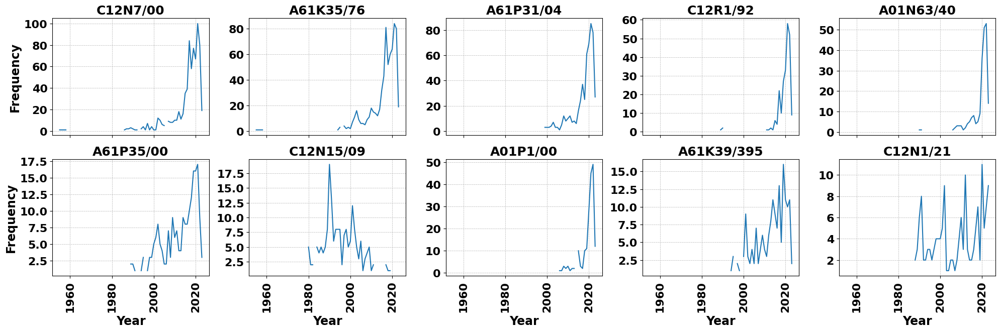

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 10
plot_elt_counts_by_year(col_name, data, n_largest)

## CPC Classifications

The number of unique applicants is: 2327


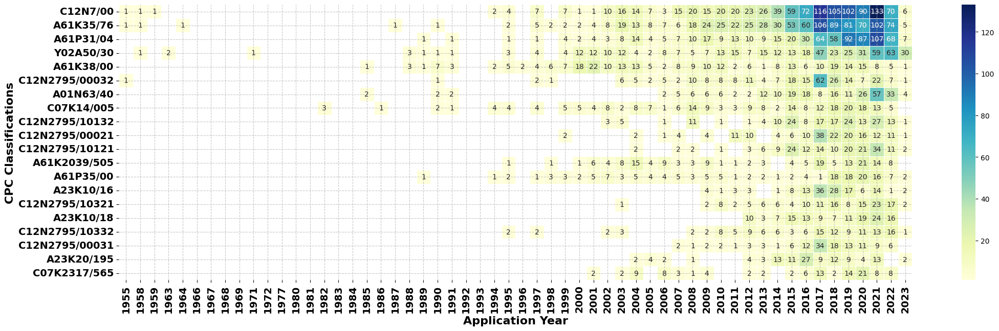

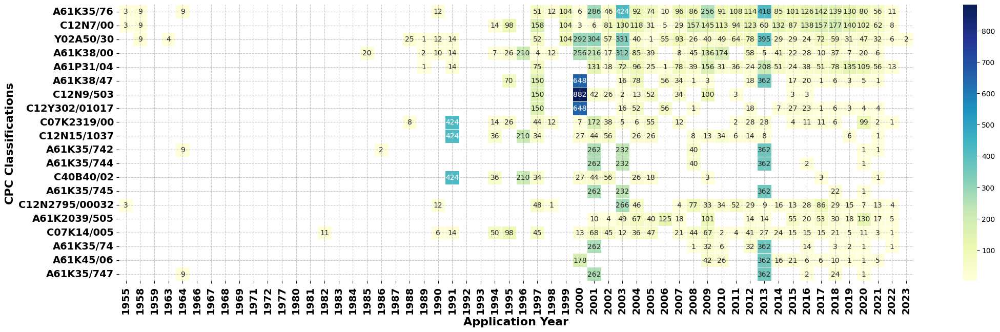

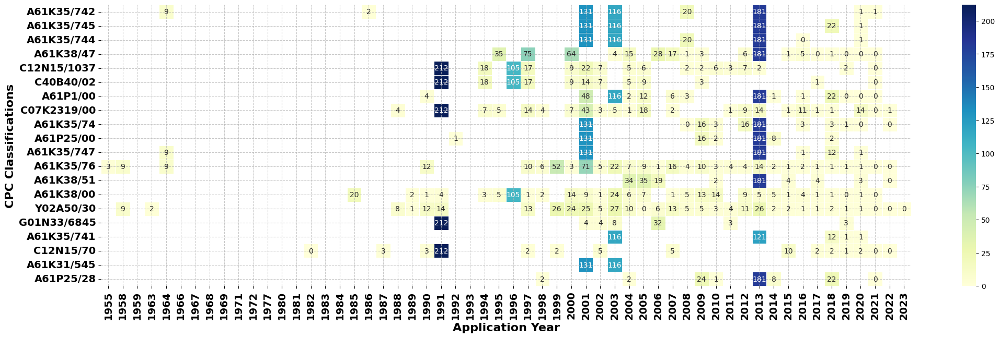

In [ ]:
col_name = 'CPC Classifications'
xlabel = "Application Year"
ylabel = 'CPC Classifications'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 20
figsize=(25, 7)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

The number of unique applicants is: 2327


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

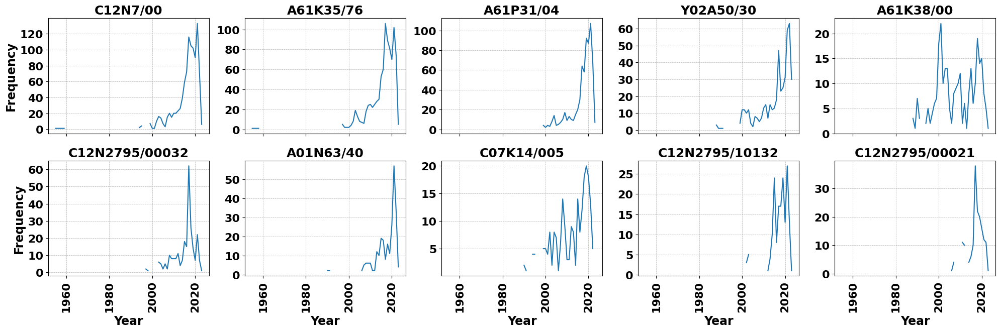

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 10
plot_elt_counts_by_year(col_name, data, n_largest)

## Applicants_Last_Classification

The number of unique applicants is: 4


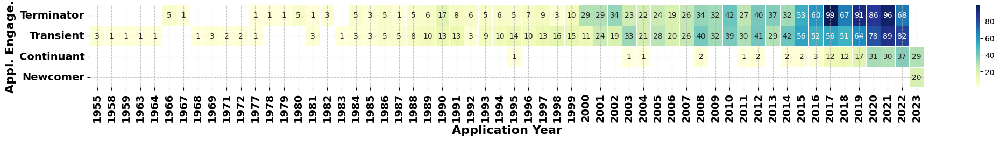

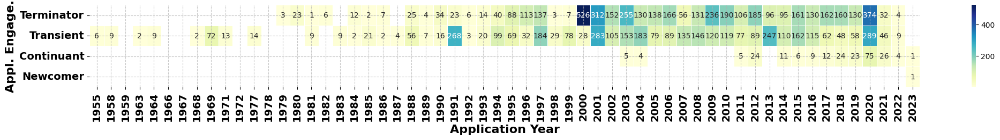

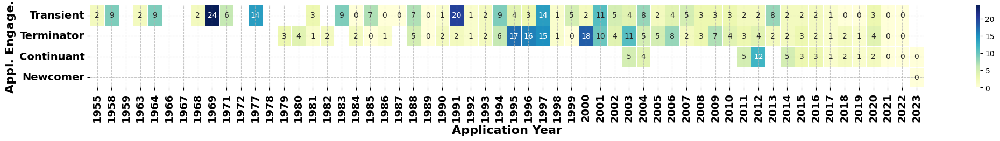

In [ ]:
col_name = 'Applicants_Last_Classification'
xlabel = "Application Year"
ylabel = 'Appl. Engage.'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 4
figsize=(25, 2)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

The number of unique applicants is: 4


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

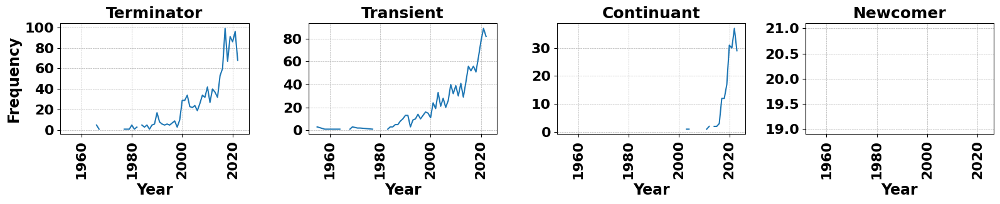

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 10
plot_elt_counts_by_year(col_name, data, n_largest)

## Inventors_Last_Classification

The number of unique applicants is: 4


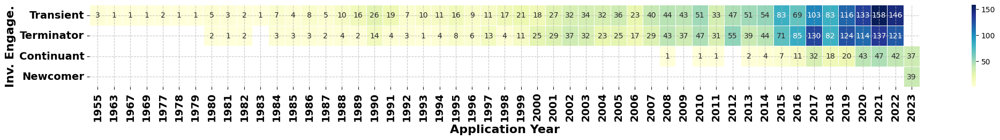

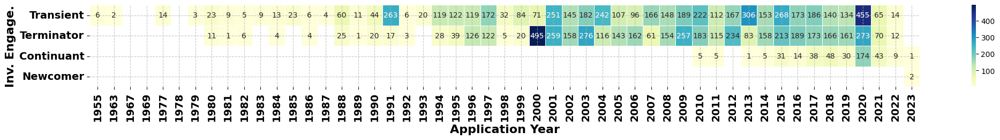

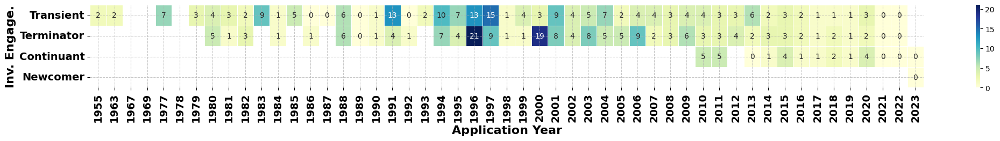

In [ ]:
col_name = 'Inventors_Last_Classification'
xlabel = "Application Year"
ylabel = 'Inv. Engage.'
pivot_df = group_and_pivot_applicants(col_name,data)
n_largest = 4
figsize=(25, 2)

plot_top_50_heatmap(col_name, pivot_df, "Publication Count", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Total Citations", xlabel, ylabel,n_largest,figsize)
plot_top_50_heatmap(col_name, pivot_df, "Average Citation Count", xlabel, ylabel,n_largest,figsize)

The number of unique applicants is: 4


<ipython-input-558-8bb840cdc2d3>:33: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:34: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontweight('bold')
<ipython-input-558-8bb840cdc2d3>:35: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_rotation(90)
<ipython-input-558-8bb840cdc2d3>:37: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.set_fontsize(16)
<ipython-input-558-8bb840cdc2d3>:38: MatplotlibDeprecationWarning: The label function was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use Tick.label1 instead.
  tick.label.s

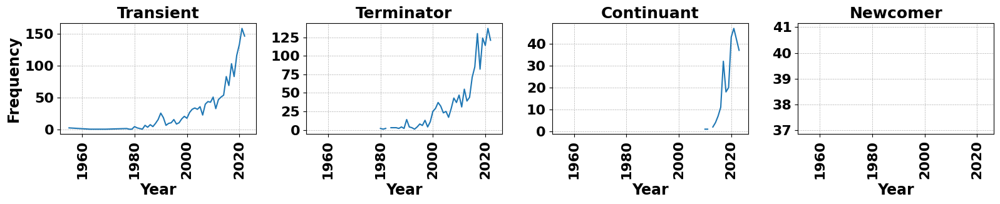

In [ ]:
#col_name = 'IPCR Subclass'
n_largest = 10
plot_elt_counts_by_year(col_name, data, n_largest)

# Heatmap graph applicants

In [ ]:
from operator import index
def process_data(data, index_cols, split_col, top_n_index, top_n_col):
  # Set the index
  applicants_data = data.set_index(['Lens ID', index_cols])

  # top_n_index_split_col
  top_n_index_split_col = data[split_col].str.split(';;').explode().str.strip().str.title().to_frame()
  top_n_index_split_col = top_n_index_split_col.reset_index()
  top_n_index_split_col = top_n_index_split_col[top_n_index_split_col[split_col] != '']
  top_n_index_split_col = top_n_index_split_col[split_col].value_counts().head(top_n_index).index.to_list()

  # top_n_index_split_col
  top_n_col_index_cols = data[index_cols].str.split(';;').explode().str.strip().str.title().to_frame()
  top_n_col_index_cols = top_n_col_index_cols.reset_index()
  top_n_col_index_cols = top_n_col_index_cols[top_n_col_index_cols[index_cols] != '']
  top_n_col_index_cols = top_n_col_index_cols[index_cols].value_counts().head(top_n_col).index.to_list()

  # Split and explode the 'Applicants' field
  applicants_list = applicants_data[split_col].str.split(';;').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  applicants_list2 = applicants_list.reset_index()
  applicants_list2[split_col] = applicants_list2[split_col].str.title()
  #applicants_list2 = applicants_list2[applicants_list2[index_cols] != '']
  #applicants_list2 = applicants_list2[applicants_list2[split_col] != '']

  # Set the index
  applicants_list3 = applicants_list2.set_index(['Lens ID', split_col])

  # Split and explode the 'Applicants' field
  applicants_list4 = applicants_list3[index_cols].str.split(';;').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  applicants_list4 = applicants_list4.reset_index()
  applicants_list4[index_cols] = applicants_list4[index_cols].str.title()
  #applicants_list4 = applicants_list4[applicants_list4[index_cols] != '']
  #applicants_list4 = applicants_list4[applicants_list4[split_col] != '']

  grouped = applicants_list4.groupby([index_cols, split_col]).agg({
      'Lens ID': 'count'
  }).reset_index()

  pivot_df = grouped.pivot_table(index=split_col, columns=index_cols, values=['Lens ID'], aggfunc='sum')['Lens ID']
  #pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2 = pd.DataFrame()
  missing_values = [value for value in top_n_col_index_cols if value not in pivot_df.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2

  #pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3 = pd.DataFrame()
  missing_values = [value for value in top_n_index_split_col if value not in pivot_df2.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3
  return pivot_df3


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each applicant over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Publication Count'.

    Returns:
    None
    """

    # Ensure the index is properly formatted
    pivot_df.index = pivot_df.index.to_series().str.title()

    # Round the values and convert to integer
    pivot_df = pivot_df.fillna(0)
    pivot_df = np.round(pivot_df).astype('int64')
    pivot_df = pivot_df.replace(0, np.nan)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in pivot_df :
      pivot_df[col] = pivot_df[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = pivot_df.reset_index()

    # Wrapping title with year and applicant name
    #data_to_plot['Applicants_categories'] = data_to_plot.apply(lambda row: f"{row['Applicants_categories'].title()}", axis=1)
    data_to_plot[split_col] = data_to_plot.apply(lambda row: f"{row[split_col].title()}", axis=1)

    # Set the Applicants column as the index
    data_to_plot = data_to_plot.set_index(split_col)

    # Create the heatmap
    if data_to_plot.empty:
        print("The DataFrame is empty.")
    else:
        sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of Top 50 Applicants and the Top 25 IPCR Subclass", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()


##  Applicants categories

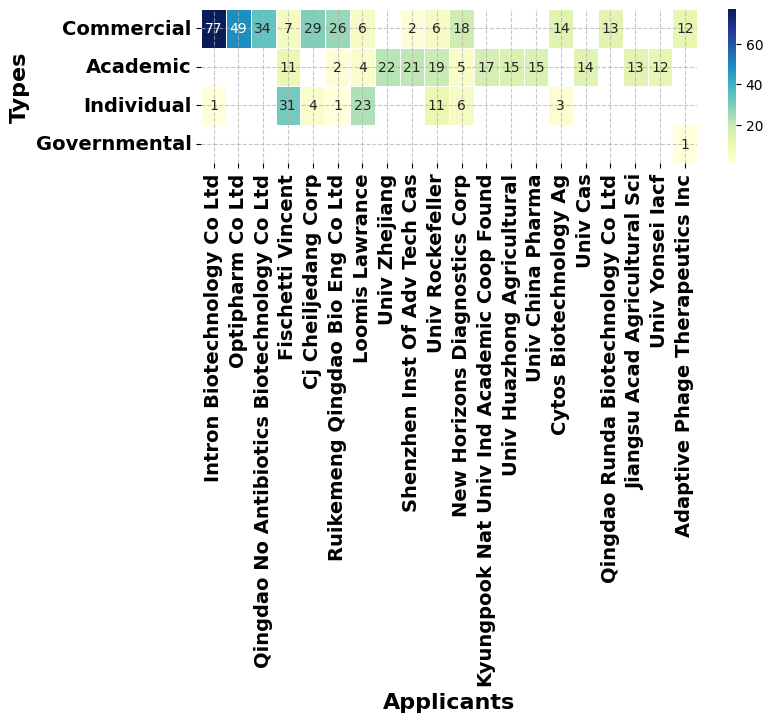

(4, 20)

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'Applicants_categories'
top_n_col = 20
top_n_index = 4
figsize=(8, 2)
xlabel = "Applicants"
ylabel = "Types"

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index,  figsize, xlabel, ylabel)
pivot_df.shape

##  Applicants region

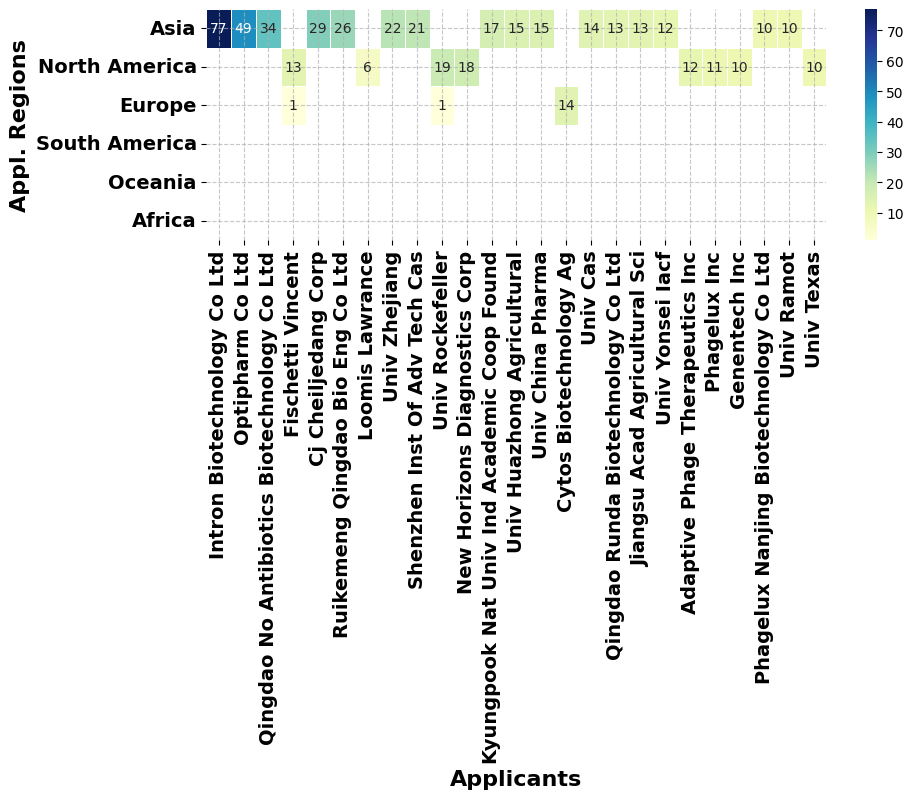

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'Applicants_regions'
top_n_col = 25
top_n_index = 10
figsize=(10, 3)
xlabel = "Applicants"
ylabel = "Appl. Regions"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Inventors

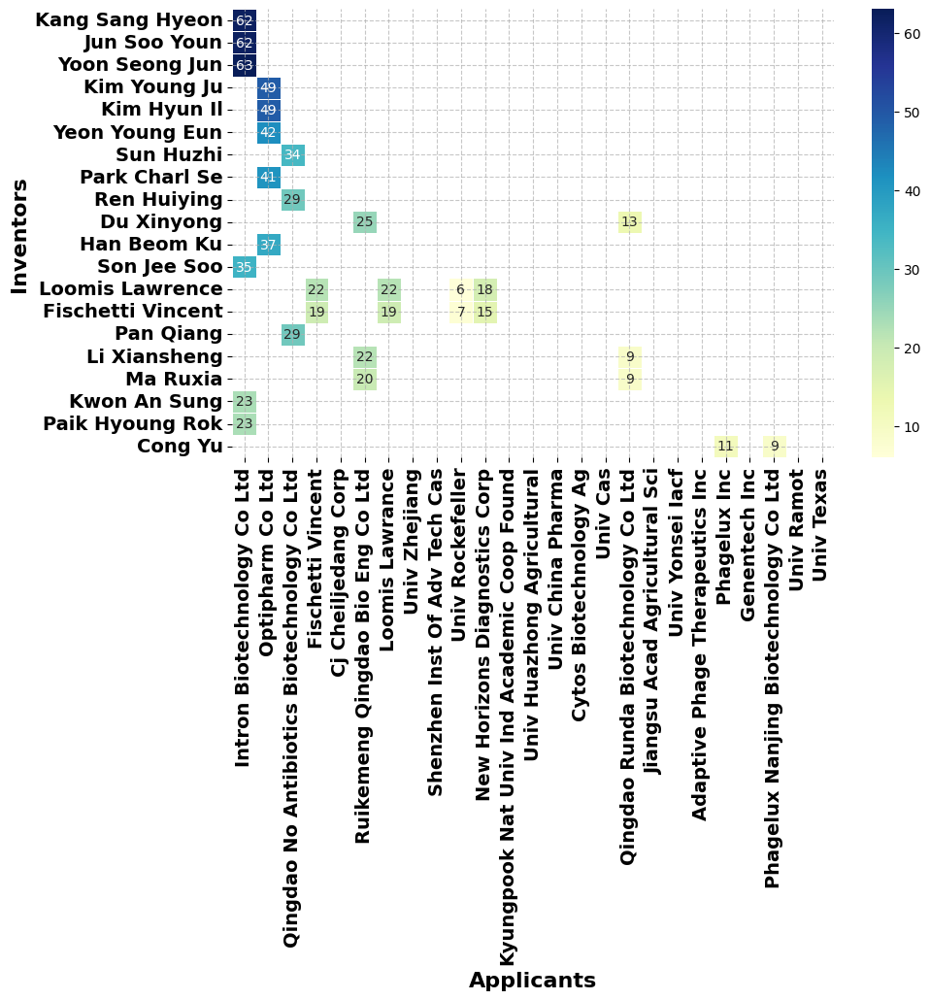

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'Inventors'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicants"
ylabel = "Inventors"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

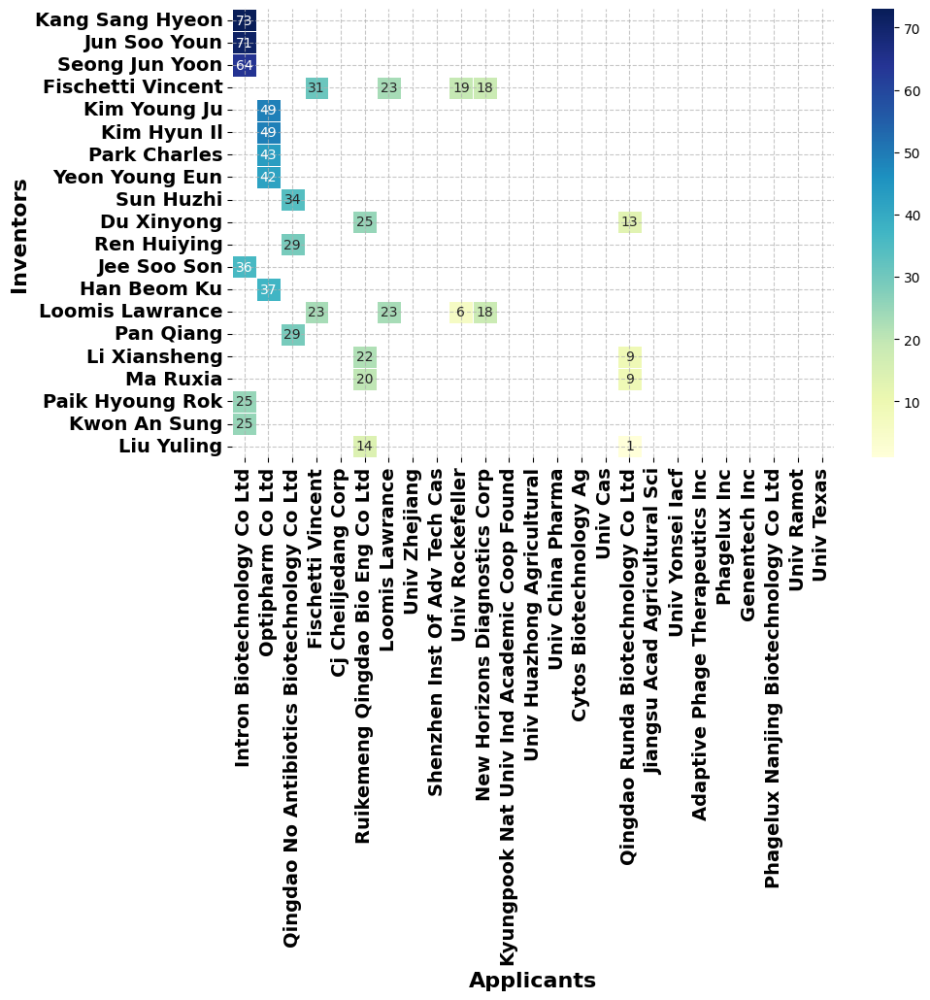

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'Inventors_clean'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicants"
ylabel = "Inventors"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

## topics

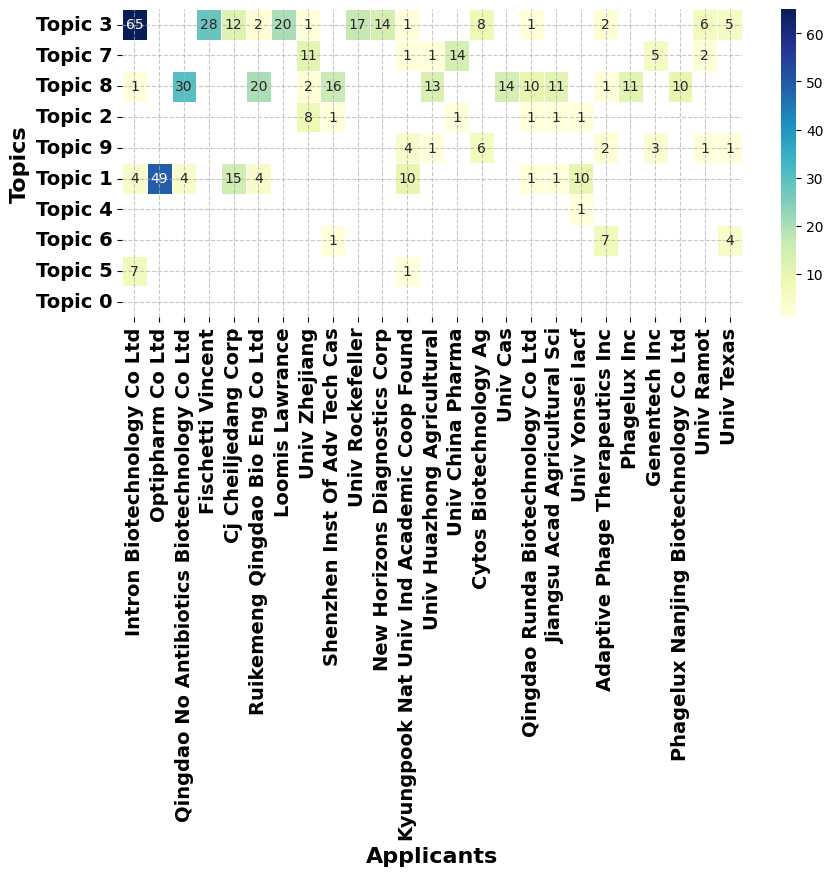

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'Topic N°'
top_n_col = 25
top_n_index = 20
figsize=(10, 4)
xlabel = "Applicants"
ylabel = "Topics"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

In [ ]:
df

Applicants_clean,Intron Biotechnology Co Ltd,Optipharm Co Ltd,Qingdao No Antibiotics Biotechnology Co Ltd,Fischetti Vincent,Cj Cheiljedang Corp,Ruikemeng Qingdao Bio Eng Co Ltd,Loomis Lawrance,Univ Zhejiang,Shenzhen Inst Of Adv Tech Cas,Univ Rockefeller,New Horizons Diagnostics Corp,Kyungpook Nat Univ Ind Academic Coop Found,Univ Huazhong Agricultural,Univ China Pharma,Cytos Biotechnology Ag,Univ Cas,Qingdao Runda Biotechnology Co Ltd,Jiangsu Acad Agricultural Sci,Univ Yonsei Iacf,Adaptive Phage Therapeutics Inc,Phagelux Inc,Genentech Inc,Phagelux Nanjing Biotechnology Co Ltd,Univ Ramot,Univ Texas
Topic N°,,,,,,,,,,,,,,,,,,,,,,,,,
Topic 3,65.0,NaN,NaN,28.0,12.0,2.0,20.0,1.0,NaN,17.0,14.0,1.0,NaN,NaN,8.0,NaN,1.0,NaN,NaN,2.0,NaN,NaN,NaN,6.0,5.0
Topic 7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.0,NaN,NaN,NaN,1.0,1.0,14.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,NaN,2.0,NaN
Topic 8,1.0,NaN,30.0,NaN,NaN,20.0,NaN,2.0,16.0,NaN,NaN,NaN,13.0,NaN,NaN,14.0,10.0,11.0,NaN,1.0,11.0,NaN,10.0,NaN,NaN
Topic 2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.0,1.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,1.0,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN
Topic 9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,1.0,NaN,6.0,NaN,NaN,NaN,NaN,2.0,NaN,3.0,NaN,1.0,1.0
Topic 1,4.0,49.0,4.0,NaN,15.0,4.0,NaN,NaN,NaN,NaN,NaN,10.0,NaN,NaN,NaN,NaN,1.0,1.0,10.0,NaN,NaN,NaN,NaN,NaN,NaN
Topic 4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN
Topic 6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.0,NaN,NaN,NaN,NaN,4.0
Topic 5,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##  IPCR Sections

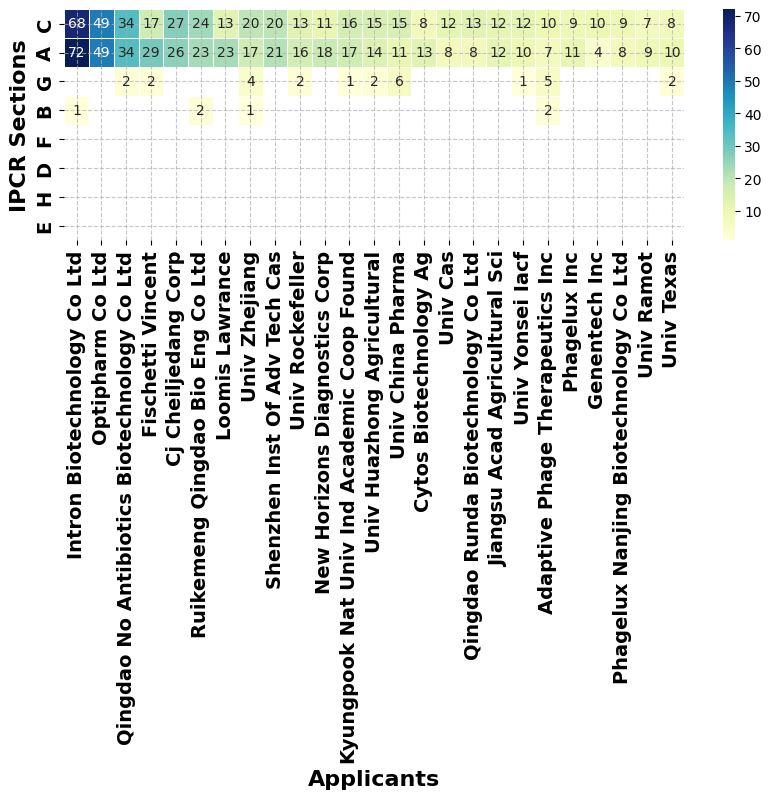

(8, 25)

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'IPCR Sections'
top_n_col = 25
top_n_index = 20
figsize=(10, 3)
xlabel = "Applicants"
ylabel = "IPCR Sections"

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index,  figsize, xlabel, ylabel)
pivot_df.shape

##  IPCR Subclass

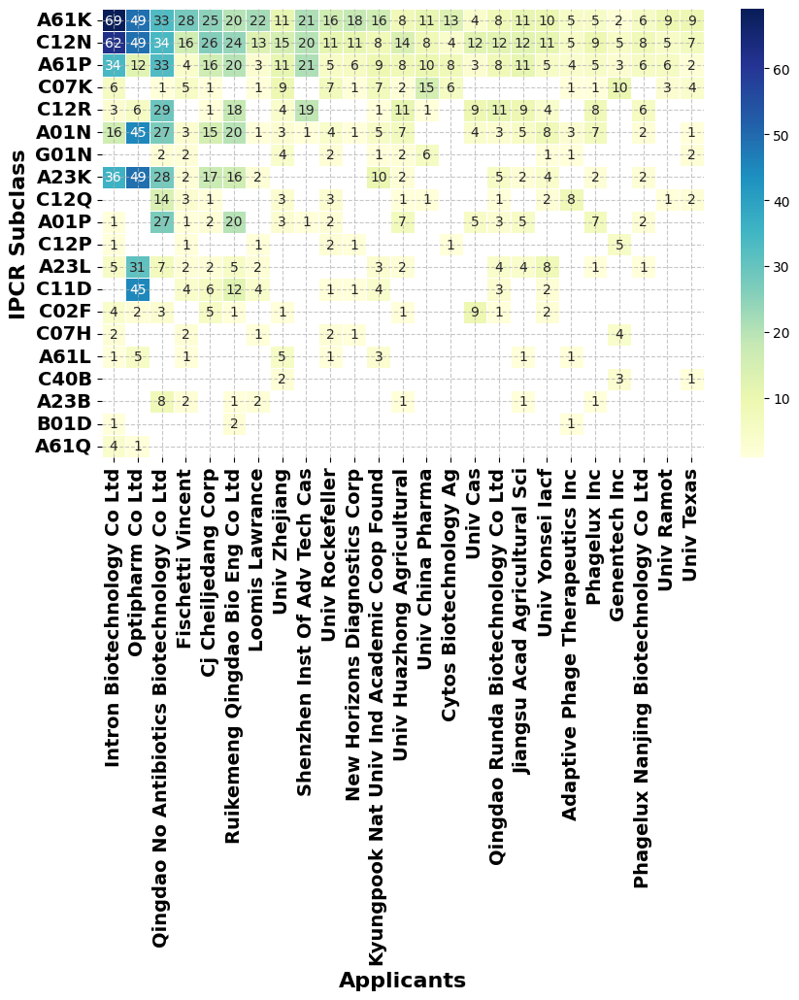

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'IPCR Subclass'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicants"
ylabel = "IPCR Subclass"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

In [ ]:
df

Applicants_clean,Intron Biotechnology Co Ltd,Optipharm Co Ltd,Qingdao No Antibiotics Biotechnology Co Ltd,Fischetti Vincent,Cj Cheiljedang Corp,Ruikemeng Qingdao Bio Eng Co Ltd,Loomis Lawrance,Univ Zhejiang,Shenzhen Inst Of Adv Tech Cas,Univ Rockefeller,New Horizons Diagnostics Corp,Kyungpook Nat Univ Ind Academic Coop Found,Univ Huazhong Agricultural,Univ China Pharma,Cytos Biotechnology Ag,Univ Cas,Qingdao Runda Biotechnology Co Ltd,Jiangsu Acad Agricultural Sci,Univ Yonsei Iacf,Adaptive Phage Therapeutics Inc,Phagelux Inc,Genentech Inc,Phagelux Nanjing Biotechnology Co Ltd,Univ Ramot,Univ Texas
IPCR Subclass,,,,,,,,,,,,,,,,,,,,,,,,,
A61K,69.0,49.0,33.0,28.0,25.0,20.0,22.0,11.0,21.0,16.0,18.0,16.0,8.0,11.0,13.0,4.0,8.0,11.0,10.0,5.0,5.0,2.0,6.0,9.0,9.0
C12N,62.0,49.0,34.0,16.0,26.0,24.0,13.0,15.0,20.0,11.0,11.0,8.0,14.0,8.0,4.0,12.0,12.0,12.0,11.0,5.0,9.0,5.0,8.0,5.0,7.0
A61P,34.0,12.0,33.0,4.0,16.0,20.0,3.0,11.0,21.0,5.0,6.0,9.0,8.0,10.0,8.0,3.0,8.0,11.0,5.0,4.0,5.0,3.0,6.0,6.0,2.0
C07K,6.0,NaN,1.0,5.0,1.0,NaN,1.0,9.0,NaN,7.0,1.0,7.0,2.0,15.0,6.0,NaN,NaN,NaN,NaN,1.0,1.0,10.0,NaN,3.0,4.0
C12R,3.0,6.0,29.0,NaN,1.0,18.0,NaN,4.0,19.0,NaN,NaN,1.0,11.0,1.0,NaN,9.0,11.0,9.0,4.0,NaN,8.0,NaN,6.0,NaN,NaN
A01N,16.0,45.0,27.0,3.0,15.0,20.0,1.0,3.0,1.0,4.0,1.0,5.0,7.0,NaN,NaN,4.0,3.0,5.0,8.0,3.0,7.0,NaN,2.0,NaN,1.0
G01N,NaN,NaN,2.0,2.0,NaN,NaN,NaN,4.0,NaN,2.0,NaN,1.0,2.0,6.0,NaN,NaN,NaN,NaN,1.0,1.0,NaN,NaN,NaN,NaN,2.0
A23K,36.0,49.0,28.0,2.0,17.0,16.0,2.0,NaN,NaN,NaN,NaN,10.0,2.0,NaN,NaN,NaN,5.0,2.0,4.0,NaN,2.0,NaN,2.0,NaN,NaN
C12Q,NaN,NaN,14.0,3.0,1.0,NaN,NaN,3.0,NaN,3.0,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,2.0,8.0,NaN,NaN,NaN,1.0,2.0


##  IPCR Class

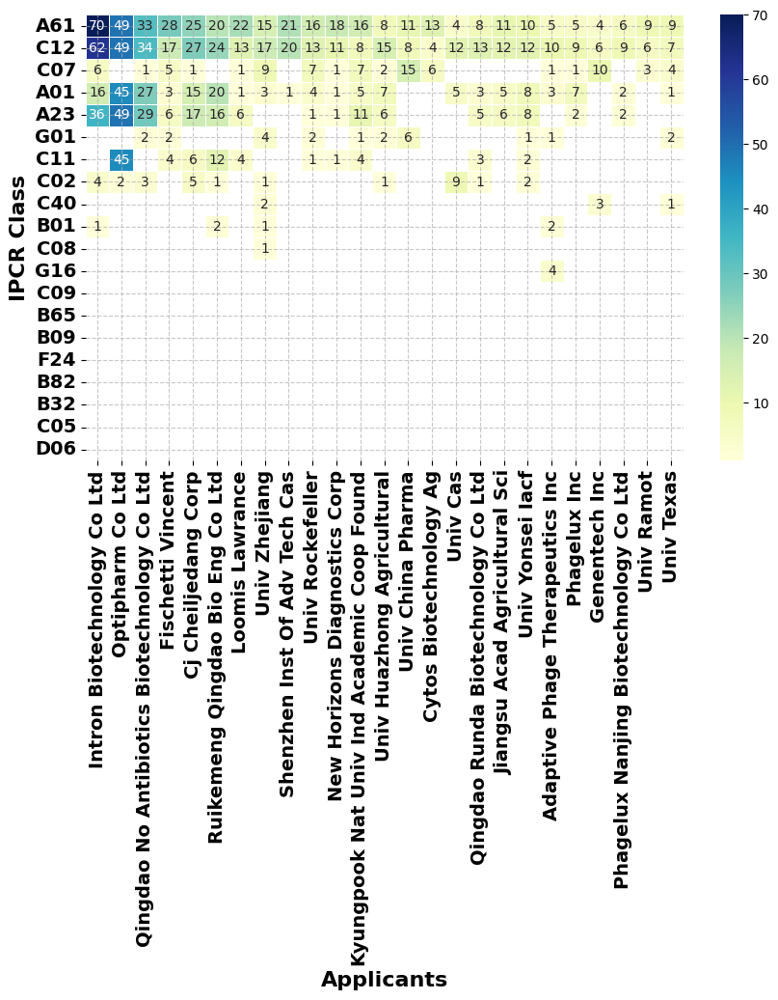

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'IPCR Class'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicants"
ylabel = "IPCR Class"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  IPCR Classifications

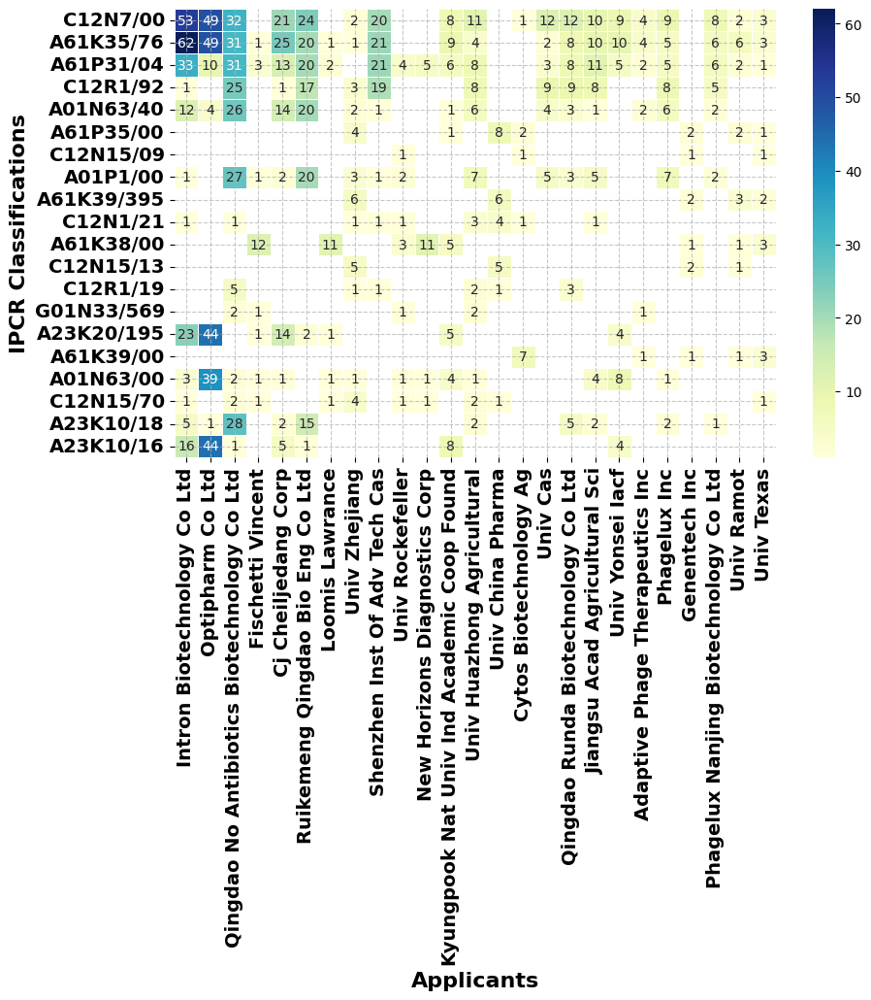

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'IPCR Classifications'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicants"
ylabel = "IPCR Classifications"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  CPC Classifications

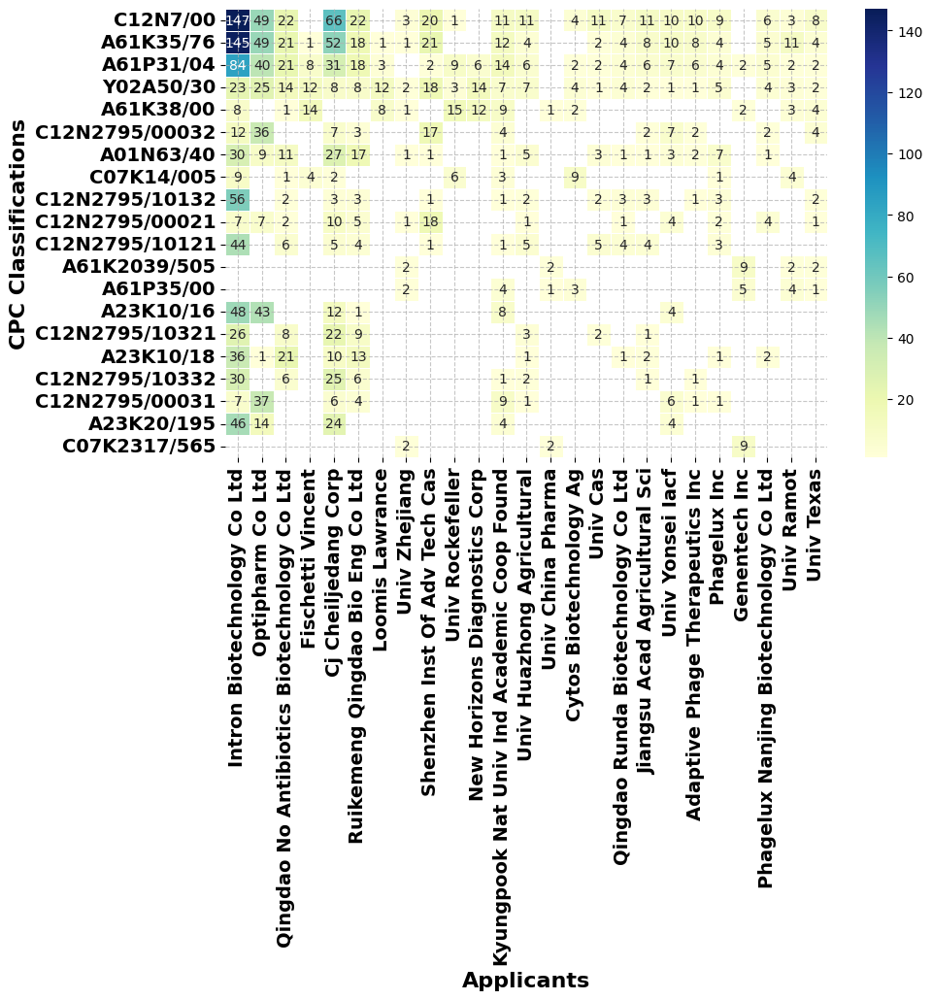

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'CPC Classifications'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicants"
ylabel = "CPC Classifications"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

## Applicants_Last_Classification

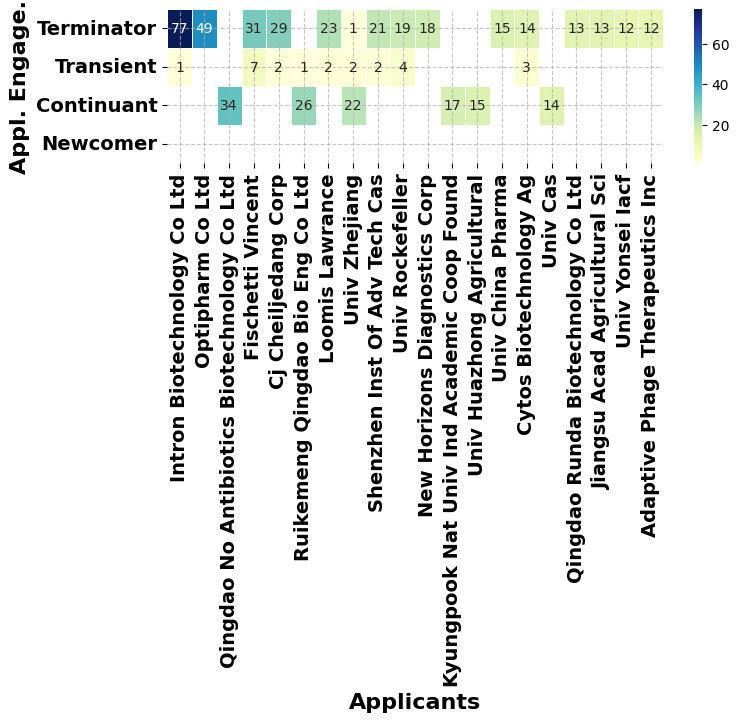

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'Applicants_Last_Classification'
top_n_col = 20
top_n_index = 20
figsize=(8, 2)
xlabel = "Applicants"
ylabel = "Appl. Engage."

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Inventors_Last_Classification

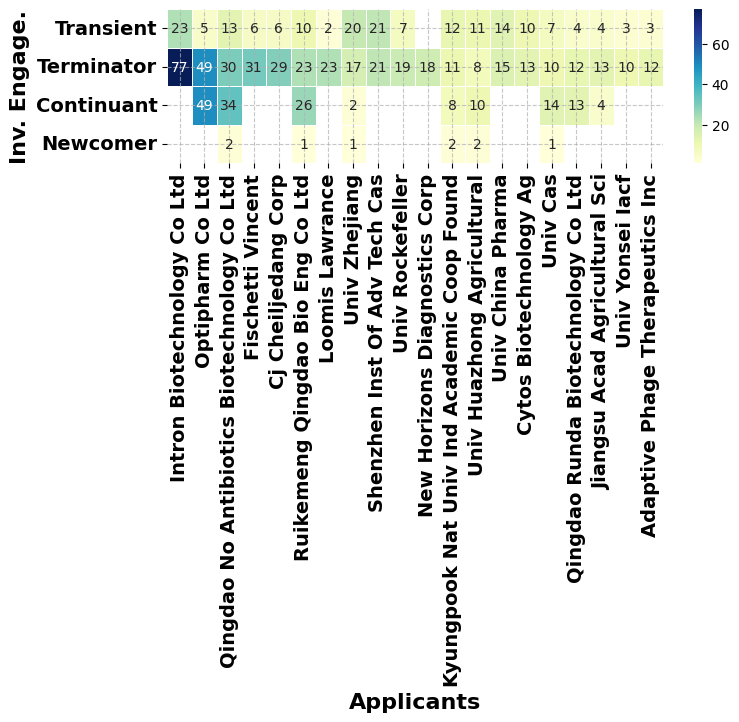

(4, 20)

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'Inventors_Last_Classification'
top_n_col = 20
top_n_index = 20
figsize=(8, 2)
xlabel = "Applicants"
ylabel = "Inv. Engage."

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index,  figsize, xlabel, ylabel)
pivot_df.shape

##  Jurisdiction Country

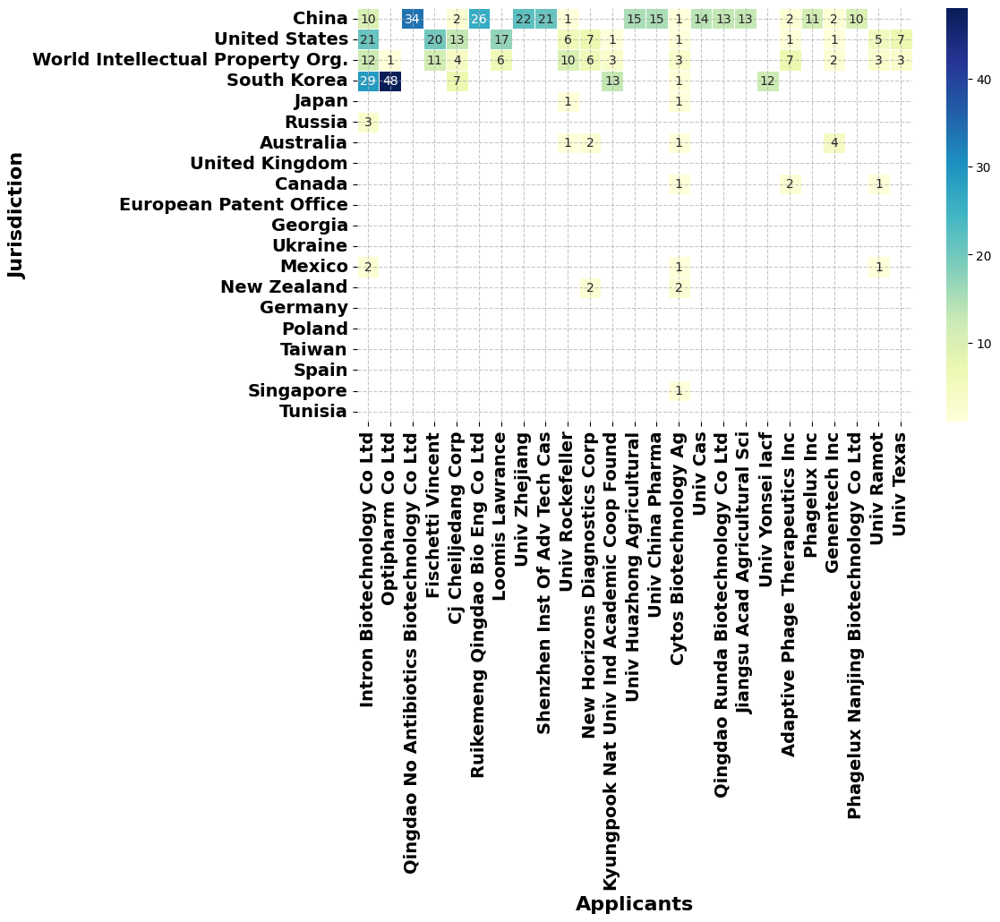

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'Jurisdiction_name'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicants"
ylabel = "Jurisdiction"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Jurisdiction Region

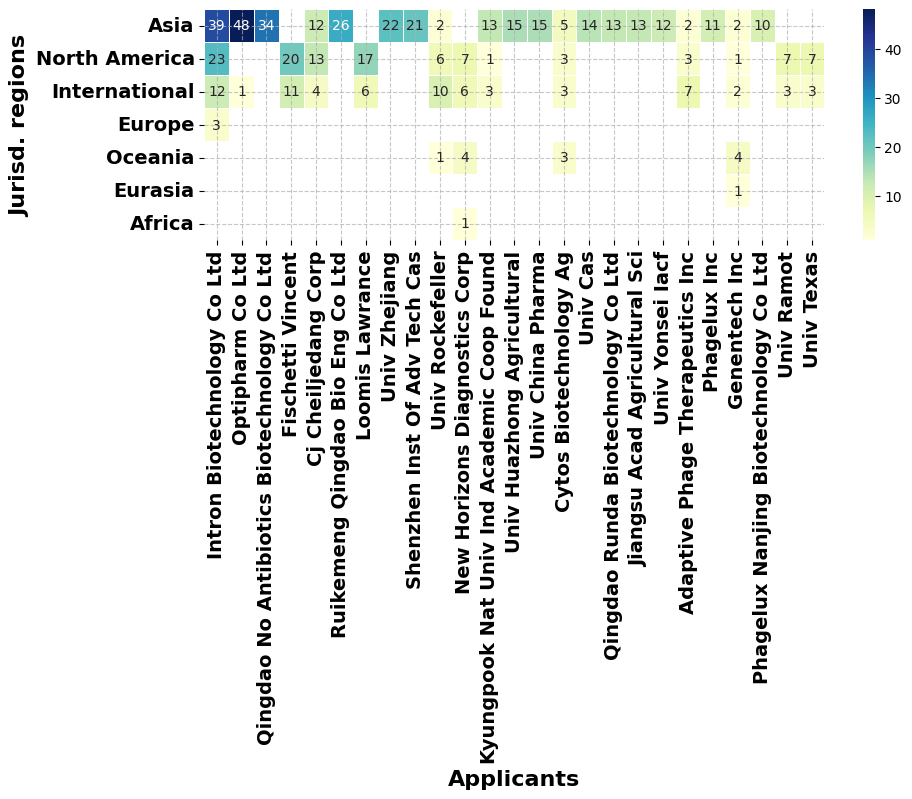

In [ ]:
index_cols = 'Applicants_clean'
split_col = 'Jurisdiction_Region'
top_n_col = 25
top_n_index = 20
figsize=(10, 3)
xlabel = "Applicants"
ylabel = "Jurisd. regions"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

# Heatmap graph applicants countries

In [ ]:
from operator import index
def process_data(data, index_cols, split_col, top_n_index, top_n_col):
  # Set the index
  applicants_data = data.set_index(['Lens ID', index_cols])

  # top_n_index_split_col
  top_n_index_split_col = data[split_col].str.split(';;').explode().str.strip().str.title().to_frame()
  top_n_index_split_col = top_n_index_split_col.reset_index()
  top_n_index_split_col = top_n_index_split_col[top_n_index_split_col[split_col] != '']
  top_n_index_split_col = top_n_index_split_col[split_col].value_counts().head(top_n_index).index.to_list()

  # top_n_index_split_col
  top_n_col_index_cols = data[index_cols].str.split(';;').explode().str.strip().str.title().to_frame()
  top_n_col_index_cols = top_n_col_index_cols.reset_index()
  top_n_col_index_cols = top_n_col_index_cols[top_n_col_index_cols[index_cols] != '']
  top_n_col_index_cols = top_n_col_index_cols[index_cols].value_counts().head(top_n_col).index.to_list()

  # Split and explode the 'Applicants' field
  applicants_list = applicants_data[split_col].str.split(';;').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  applicants_list2 = applicants_list.reset_index()
  applicants_list2[split_col] = applicants_list2[split_col].str.title()
  #applicants_list2 = applicants_list2[applicants_list2[index_cols] != '']
  #applicants_list2 = applicants_list2[applicants_list2[split_col] != '']

  # Set the index
  applicants_list3 = applicants_list2.set_index(['Lens ID', split_col])

  # Split and explode the 'Applicants' field
  applicants_list4 = applicants_list3[index_cols].str.split(';;').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  applicants_list4 = applicants_list4.reset_index()
  applicants_list4[index_cols] = applicants_list4[index_cols].str.title()
  #applicants_list4 = applicants_list4[applicants_list4[index_cols] != '']
  #applicants_list4 = applicants_list4[applicants_list4[split_col] != '']

  grouped = applicants_list4.groupby([index_cols, split_col]).agg({
      'Lens ID': 'count'
  }).reset_index()

  pivot_df = grouped.pivot_table(index=split_col, columns=index_cols, values=['Lens ID'], aggfunc='sum')['Lens ID']
  #pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2 = pd.DataFrame()
  missing_values = [value for value in top_n_col_index_cols if value not in pivot_df.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2

  #pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3 = pd.DataFrame()
  missing_values = [value for value in top_n_index_split_col if value not in pivot_df2.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3
  return pivot_df3


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each applicant over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Publication Count'.

    Returns:
    None
    """

    # Ensure the index is properly formatted
    pivot_df.index = pivot_df.index.to_series().str.title()

    # Round the values and convert to integer
    pivot_df = pivot_df.fillna(0)
    pivot_df = np.round(pivot_df).astype('int64')
    pivot_df = pivot_df.replace(0, np.nan)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in pivot_df :
      pivot_df[col] = pivot_df[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = pivot_df.reset_index()

    # Wrapping title with year and applicant name
    #data_to_plot['Applicants_categories'] = data_to_plot.apply(lambda row: f"{row['Applicants_categories'].title()}", axis=1)
    data_to_plot[split_col] = data_to_plot.apply(lambda row: f"{row[split_col].title()}", axis=1)

    # Set the Applicants column as the index
    data_to_plot = data_to_plot.set_index(split_col)

    # Create the heatmap
    if data_to_plot.empty:
        print("The DataFrame is empty.")
    else:
        sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of Top 50 Applicants and the Top 25 IPCR Subclass", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()


##  Applicants categories

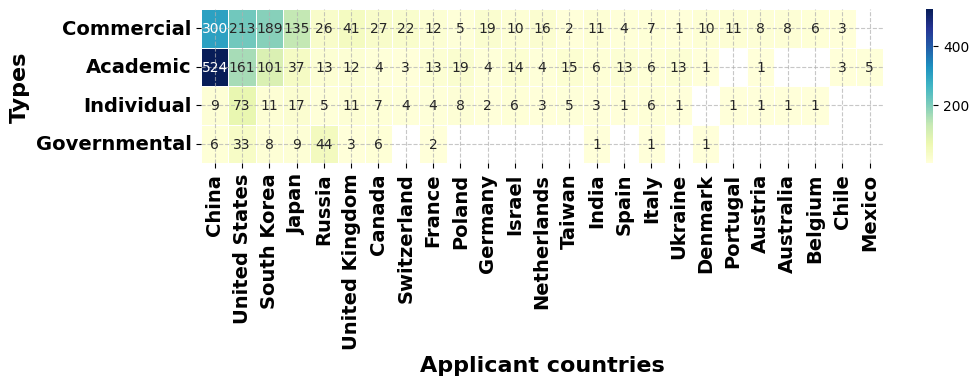

(4, 25)

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Applicants_categories'
top_n_col = 25
top_n_index = 4
figsize=(11, 2)
xlabel = "Applicant countries"
ylabel = "Types"

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel)
pivot_df.shape

In [ ]:
pivot_df

Applicants_countries,China,United States,South Korea,Japan,Russia,United Kingdom,Canada,Switzerland,France,Poland,Germany,Israel,Netherlands,Taiwan,India,Spain,Italy,Ukraine,Denmark,Portugal,Austria,Australia,Belgium,Chile,Mexico
Applicants_categories,,,,,,,,,,,,,,,,,,,,,,,,,
Commercial,300.0,213.0,189.0,135.0,26.0,41.0,27.0,22.0,12.0,5.0,19.0,10.0,16.0,2.0,11.0,4.0,7.0,1.0,10.0,11.0,8.0,8.0,6.0,3.0,NaN
Academic,524.0,161.0,101.0,37.0,13.0,12.0,4.0,3.0,13.0,19.0,4.0,14.0,4.0,15.0,6.0,13.0,6.0,13.0,1.0,NaN,1.0,NaN,NaN,3.0,5.0
Individual,9.0,73.0,11.0,17.0,5.0,11.0,7.0,4.0,4.0,8.0,2.0,6.0,3.0,5.0,3.0,1.0,6.0,1.0,NaN,1.0,1.0,1.0,1.0,NaN,NaN
Governmental,6.0,33.0,8.0,9.0,44.0,3.0,6.0,NaN,2.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,1.0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN


##  Applicants region

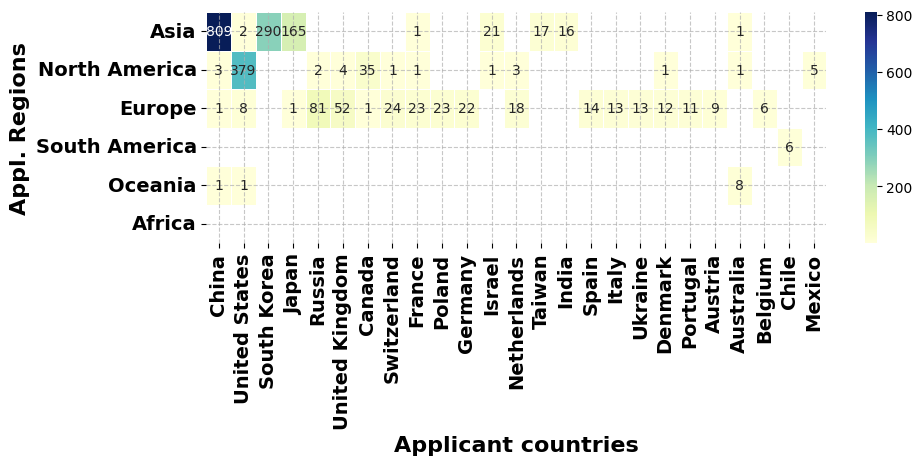

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Applicants_regions'
top_n_col = 25
top_n_index = 10
figsize=(10, 3)
xlabel = "Applicant countries"
ylabel = "Appl. Regions"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  Applicants

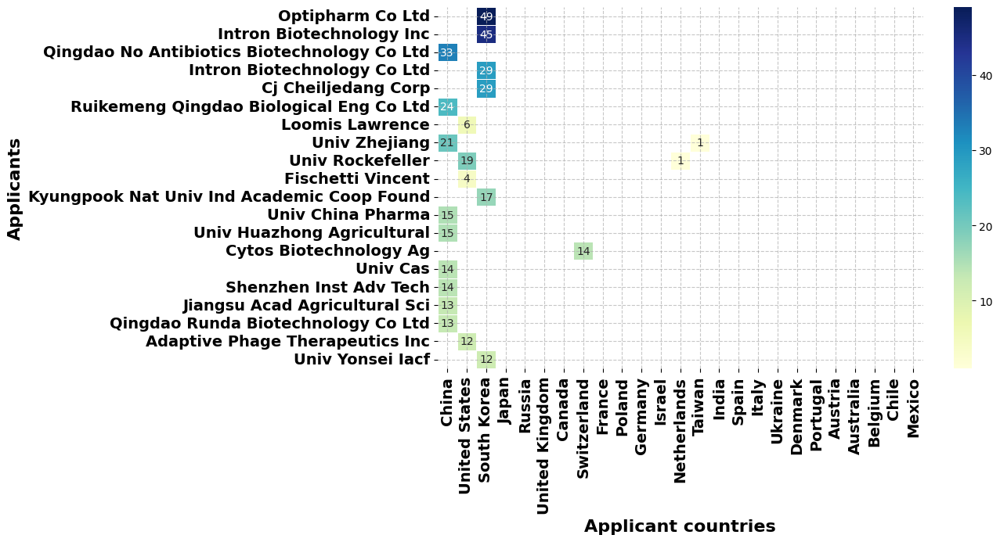

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Applicants'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicant countries"
ylabel = "Applicants"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

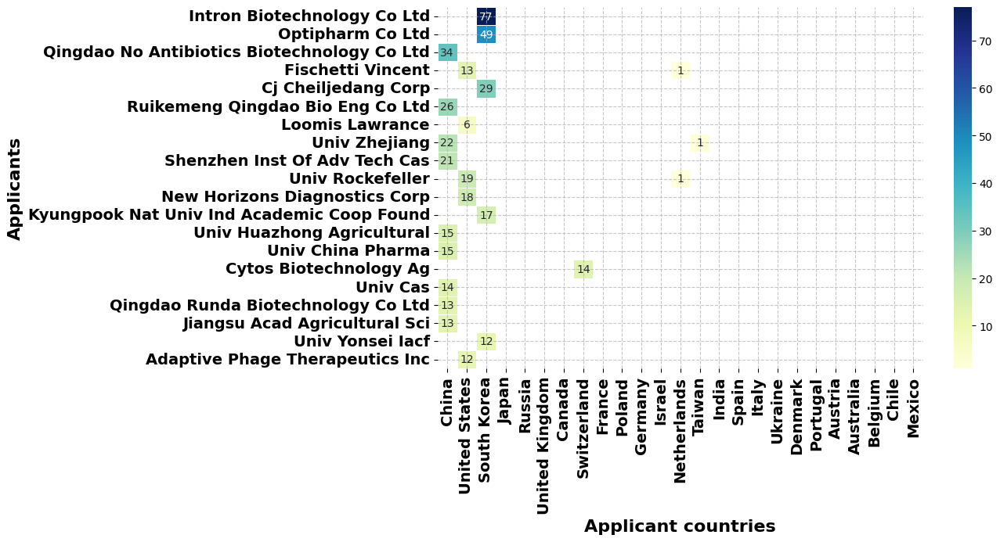

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Applicants_clean'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicant countries"
ylabel = "Applicants"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  Inventors

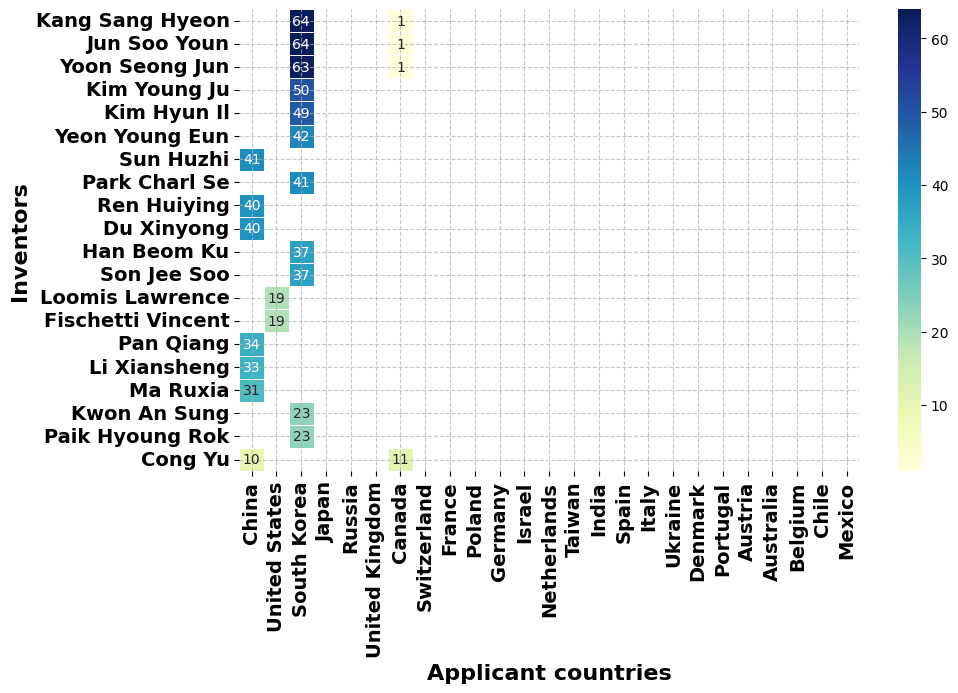

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Inventors'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicant countries"
ylabel = "Inventors"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

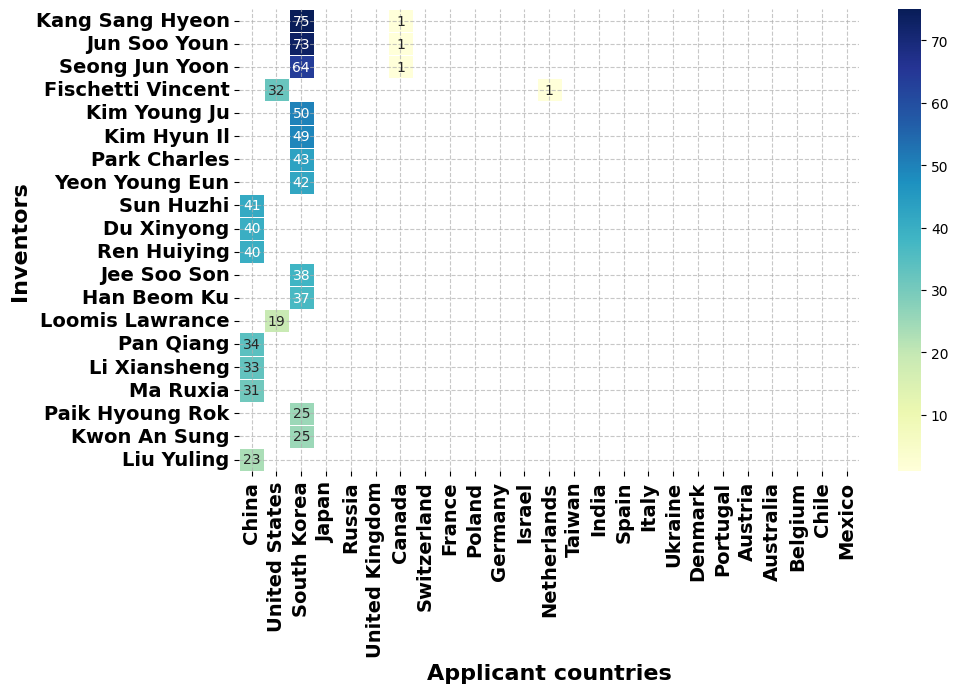

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Inventors_clean'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicant countries"
ylabel = "Inventors"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

## topics

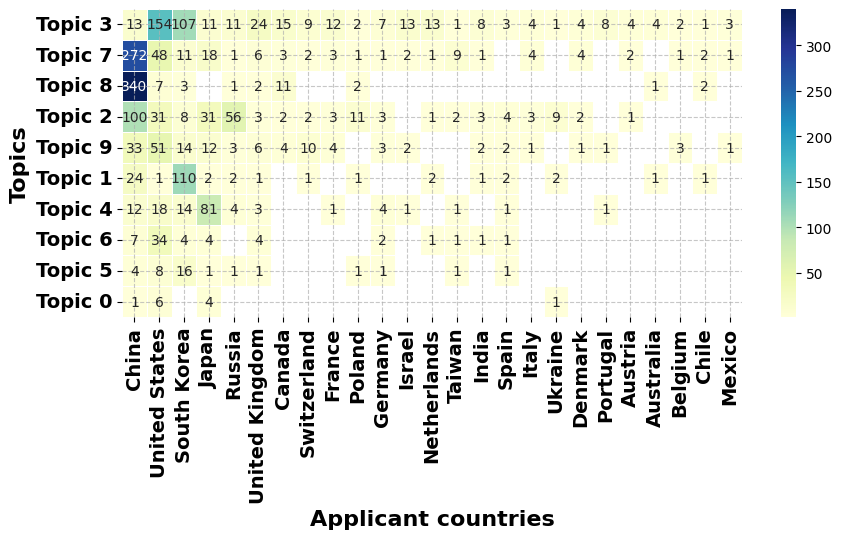

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Topic N°'
top_n_col = 25
top_n_index = 20
figsize=(10, 4)
xlabel = "Applicant countries"
ylabel = "Topics"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

In [ ]:
df

Applicants_countries,China,United States,South Korea,Japan,Russia,United Kingdom,Canada,Switzerland,France,Poland,Germany,Israel,Netherlands,Taiwan,India,Spain,Italy,Ukraine,Denmark,Portugal,Austria,Australia,Belgium,Chile,Mexico
Topic N°,,,,,,,,,,,,,,,,,,,,,,,,,
Topic 3,13.0,154.0,107.0,11.0,11.0,24.0,15.0,9.0,12.0,2.0,7.0,13.0,13.0,1.0,8.0,3.0,4.0,1.0,4.0,8.0,4.0,4.0,2.0,1.0,3.0
Topic 7,272.0,48.0,11.0,18.0,1.0,6.0,3.0,2.0,3.0,1.0,1.0,2.0,1.0,9.0,1.0,NaN,4.0,NaN,4.0,NaN,2.0,NaN,1.0,2.0,1.0
Topic 8,340.0,7.0,3.0,NaN,1.0,2.0,11.0,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,2.0,NaN
Topic 2,100.0,31.0,8.0,31.0,56.0,3.0,2.0,2.0,3.0,11.0,3.0,NaN,1.0,2.0,3.0,4.0,3.0,9.0,2.0,NaN,1.0,NaN,NaN,NaN,NaN
Topic 9,33.0,51.0,14.0,12.0,3.0,6.0,4.0,10.0,4.0,NaN,3.0,2.0,NaN,NaN,2.0,2.0,1.0,NaN,1.0,1.0,NaN,NaN,3.0,NaN,1.0
Topic 1,24.0,1.0,110.0,2.0,2.0,1.0,NaN,1.0,NaN,1.0,NaN,NaN,2.0,NaN,1.0,2.0,NaN,2.0,NaN,NaN,NaN,1.0,NaN,1.0,NaN
Topic 4,12.0,18.0,14.0,81.0,4.0,3.0,NaN,NaN,1.0,NaN,4.0,1.0,NaN,1.0,NaN,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN
Topic 6,7.0,34.0,4.0,4.0,NaN,4.0,NaN,NaN,NaN,NaN,2.0,NaN,1.0,1.0,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Topic 5,4.0,8.0,16.0,1.0,1.0,1.0,NaN,NaN,NaN,1.0,1.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##  IPCR Sections

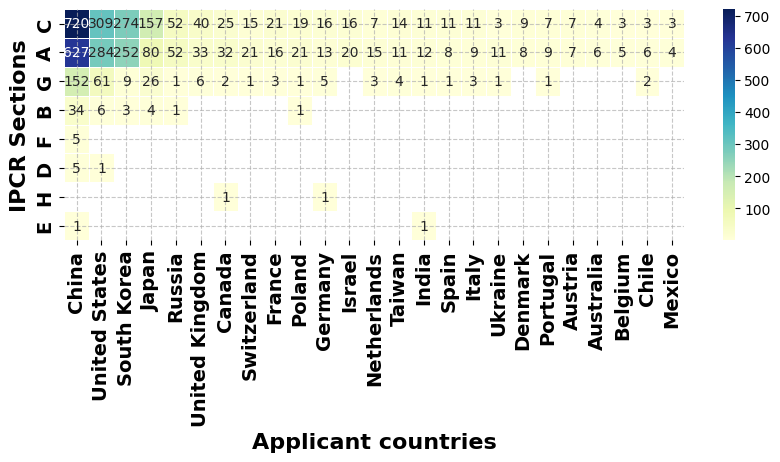

(8, 25)

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'IPCR Sections'
top_n_col = 25
top_n_index = 20
figsize=(10, 3)
xlabel = "Applicant countries"
ylabel = "IPCR Sections"

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel)
pivot_df.shape

##  IPCR Subclass

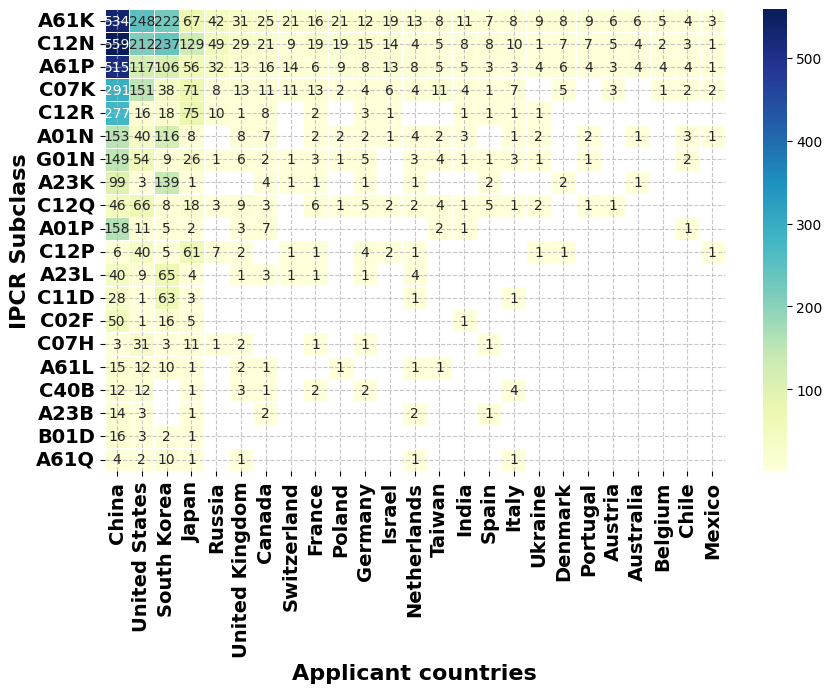

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'IPCR Subclass'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicant countries"
ylabel = "IPCR Subclass"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

In [ ]:
df

Applicants_countries,China,United States,South Korea,Japan,Russia,United Kingdom,Canada,Switzerland,France,Poland,Germany,Israel,Netherlands,Taiwan,India,Spain,Italy,Ukraine,Denmark,Portugal,Austria,Australia,Belgium,Chile,Mexico
IPCR Subclass,,,,,,,,,,,,,,,,,,,,,,,,,
A61K,534.0,248.0,222.0,67.0,42.0,31.0,25.0,21.0,16.0,21.0,12.0,19.0,13.0,8.0,11.0,7.0,8.0,9.0,8.0,9.0,6.0,6.0,5.0,4.0,3.0
C12N,559.0,212.0,237.0,129.0,49.0,29.0,21.0,9.0,19.0,19.0,15.0,14.0,4.0,5.0,8.0,8.0,10.0,1.0,7.0,7.0,5.0,4.0,2.0,3.0,1.0
A61P,515.0,117.0,106.0,56.0,32.0,13.0,16.0,14.0,6.0,9.0,8.0,13.0,8.0,5.0,5.0,3.0,3.0,4.0,6.0,4.0,3.0,4.0,4.0,4.0,1.0
C07K,291.0,151.0,38.0,71.0,8.0,13.0,11.0,11.0,13.0,2.0,4.0,6.0,4.0,11.0,4.0,1.0,7.0,NaN,5.0,NaN,3.0,NaN,1.0,2.0,2.0
C12R,277.0,16.0,18.0,75.0,10.0,1.0,8.0,NaN,2.0,NaN,3.0,1.0,NaN,NaN,1.0,1.0,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
A01N,153.0,40.0,116.0,8.0,NaN,8.0,7.0,NaN,2.0,2.0,2.0,1.0,4.0,2.0,3.0,NaN,1.0,2.0,NaN,2.0,NaN,1.0,NaN,3.0,1.0
G01N,149.0,54.0,9.0,26.0,1.0,6.0,2.0,1.0,3.0,1.0,5.0,NaN,3.0,4.0,1.0,1.0,3.0,1.0,NaN,1.0,NaN,NaN,NaN,2.0,NaN
A23K,99.0,3.0,139.0,1.0,NaN,NaN,4.0,1.0,1.0,NaN,1.0,NaN,1.0,NaN,NaN,2.0,NaN,NaN,2.0,NaN,NaN,1.0,NaN,NaN,NaN
C12Q,46.0,66.0,8.0,18.0,3.0,9.0,3.0,NaN,6.0,1.0,5.0,2.0,2.0,4.0,1.0,5.0,1.0,2.0,NaN,1.0,1.0,NaN,NaN,NaN,NaN


##  IPCR Class

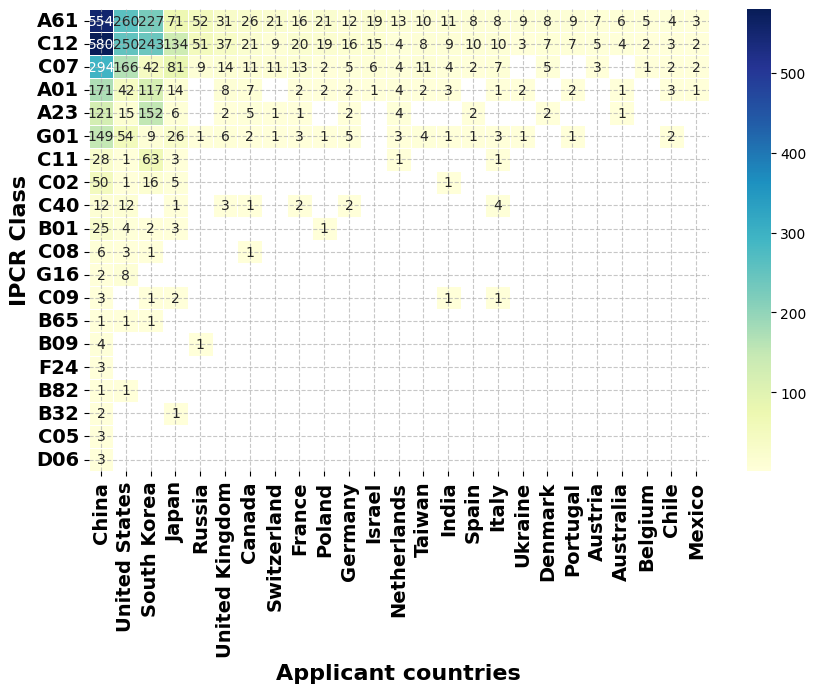

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'IPCR Class'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicant countries"
ylabel = "IPCR Class"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  IPCR Classifications

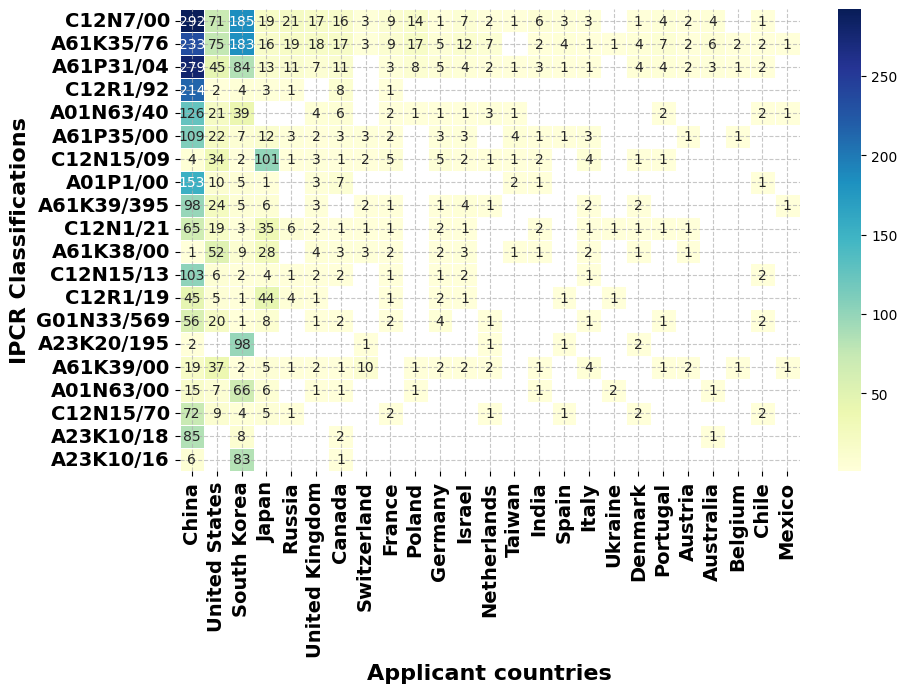

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'IPCR Classifications'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicant countries"
ylabel = "IPCR Classifications"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  CPC Classifications

These values are missing in the index: ['Ukraine']
These values are missing in the index: ['C12N7/00', 'A61K35/76', 'A61P31/04', 'Y02A50/30', 'A61K38/00', 'C12N2795/00032', 'A01N63/40', 'C07K14/005', 'C12N2795/10132', 'C12N2795/00021', 'C12N2795/10121', 'A61K2039/505', 'A61P35/00', 'A23K10/16', 'C12N2795/10321', 'A23K10/18', 'C12N2795/10332', 'C12N2795/00031', 'A23K20/195', 'C07K2317/565']
The DataFrame is empty.


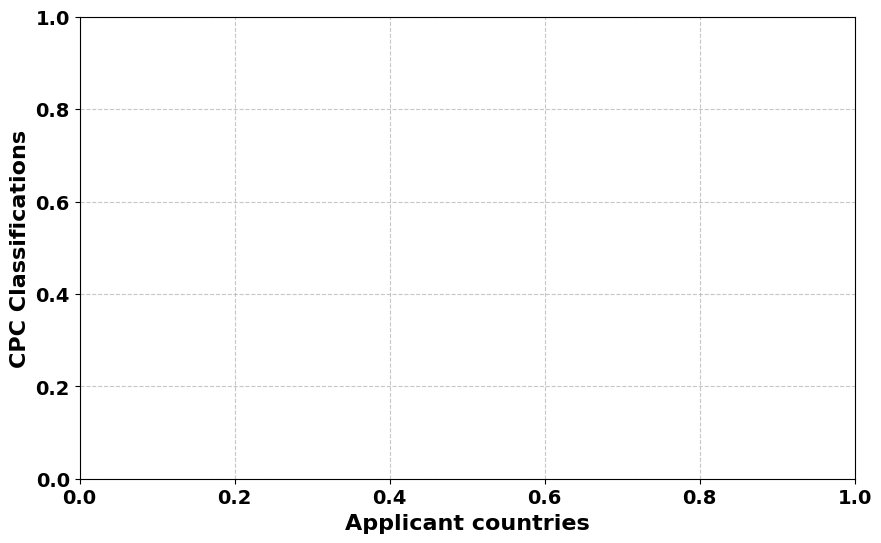

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'CPC Classifications'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicant countries"
ylabel = "CPC Classifications"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

## Applicants_Last_Classification

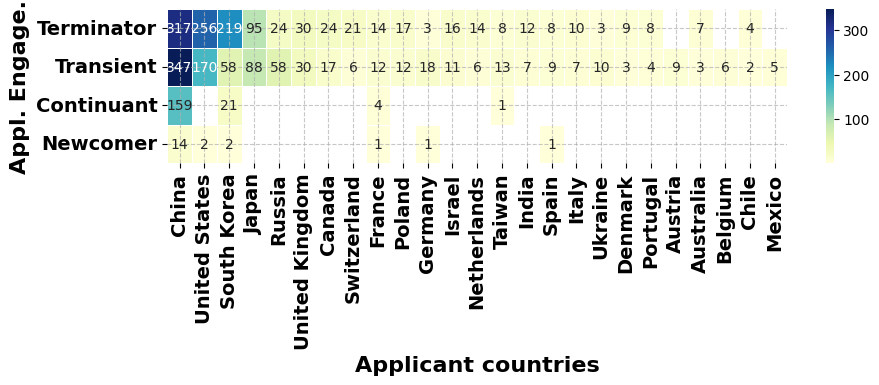

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Applicants_Last_Classification'
top_n_col = 25
top_n_index = 20
figsize=(10, 2)
xlabel = "Applicant countries"
ylabel = "Appl. Engage."

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

In [ ]:
df

Applicants_countries,China,United States,South Korea,Japan,Russia,United Kingdom,Canada,Switzerland,France,Poland,Germany,Israel,Netherlands,Taiwan,India,Spain,Italy,Ukraine,Denmark,Portugal,Austria,Australia,Belgium,Chile,Mexico
Applicants_Last_Classification,,,,,,,,,,,,,,,,,,,,,,,,,
Terminator,317.0,256.0,219.0,95.0,24.0,30.0,24.0,21.0,14.0,17.0,3.0,16.0,14.0,8.0,12.0,8.0,10.0,3.0,9.0,8.0,NaN,7.0,NaN,4.0,NaN
Transient,347.0,170.0,58.0,88.0,58.0,30.0,17.0,6.0,12.0,12.0,18.0,11.0,6.0,13.0,7.0,9.0,7.0,10.0,3.0,4.0,9.0,3.0,6.0,2.0,5.0
Continuant,159.0,NaN,21.0,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Newcomer,14.0,2.0,2.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##  Inventors_Last_Classification

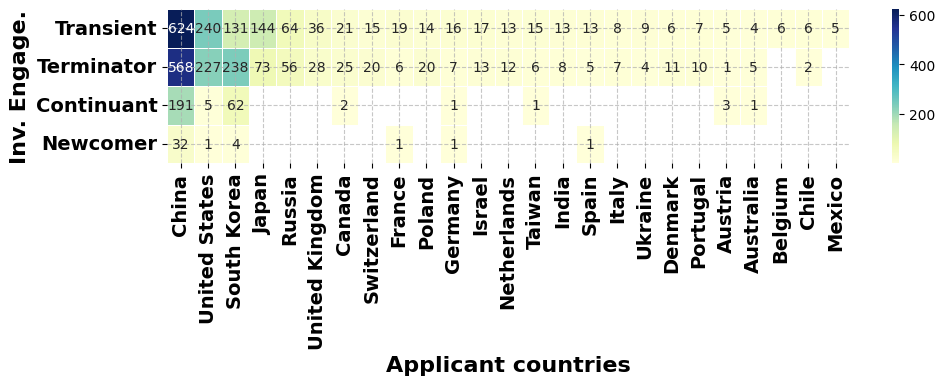

(4, 25)

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Inventors_Last_Classification'
top_n_col = 25
top_n_index = 20
figsize=(11, 2)
xlabel = "Applicant countries"
ylabel = "Inv. Engage."

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel)
pivot_df.shape

In [ ]:
pivot_df

Applicants_countries,China,United States,South Korea,Japan,Russia,United Kingdom,Canada,Switzerland,France,Poland,Germany,Israel,Netherlands,Taiwan,India,Spain,Italy,Ukraine,Denmark,Portugal,Austria,Australia,Belgium,Chile,Mexico
Inventors_Last_Classification,,,,,,,,,,,,,,,,,,,,,,,,,
Transient,624.0,240.0,131.0,144.0,64.0,36.0,21.0,15.0,19.0,14.0,16.0,17.0,13.0,15.0,13.0,13.0,8.0,9.0,6.0,7.0,5.0,4.0,6.0,6.0,5.0
Terminator,568.0,227.0,238.0,73.0,56.0,28.0,25.0,20.0,6.0,20.0,7.0,13.0,12.0,6.0,8.0,5.0,7.0,4.0,11.0,10.0,1.0,5.0,NaN,2.0,NaN
Continuant,191.0,5.0,62.0,NaN,NaN,NaN,2.0,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,3.0,1.0,NaN,NaN,NaN
Newcomer,32.0,1.0,4.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,1.0,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##  Jurisdiction Country

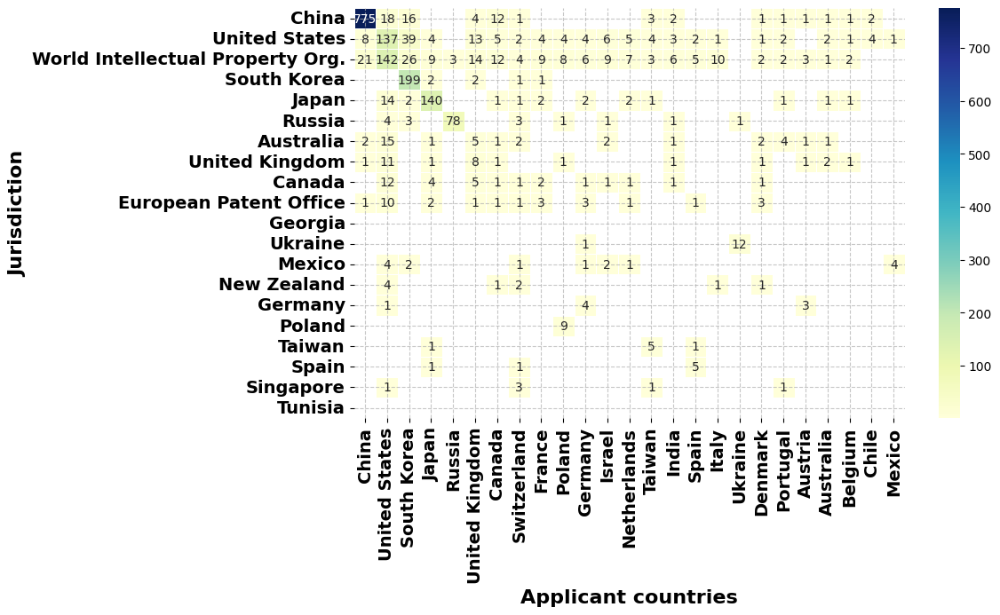

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Jurisdiction_name'
top_n_col = 25
top_n_index = 20
figsize=(10, 6)
xlabel = "Applicant countries"
ylabel = "Jurisdiction"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  Jurisdiction Region

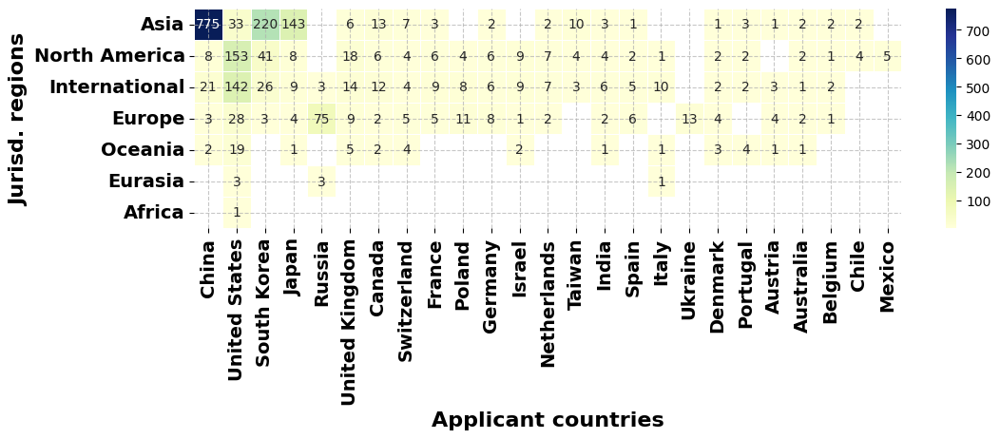

In [ ]:
index_cols = 'Applicants_countries'
split_col = 'Jurisdiction_Region'
top_n_col = 25
top_n_index = 20
figsize=(12, 3)
xlabel = "Applicant countries"
ylabel = "Jurisd. regions"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

# Heatmap graph applicants regions

In [ ]:
from operator import index
def process_data(data, index_cols, split_col, top_n_index, top_n_col):
  # Set the index
  applicants_data = data.set_index(['Lens ID', index_cols])

  # top_n_index_split_col
  top_n_index_split_col = data[split_col].str.split(';;').explode().str.strip().str.title().to_frame()
  top_n_index_split_col = top_n_index_split_col.reset_index()
  top_n_index_split_col = top_n_index_split_col[top_n_index_split_col[split_col] != '']
  top_n_index_split_col = top_n_index_split_col[split_col].value_counts().head(top_n_index).index.to_list()

  # top_n_index_split_col
  top_n_col_index_cols = data[index_cols].str.split(';;').explode().str.strip().str.title().to_frame()
  top_n_col_index_cols = top_n_col_index_cols.reset_index()
  top_n_col_index_cols = top_n_col_index_cols[top_n_col_index_cols[index_cols] != '']
  top_n_col_index_cols = top_n_col_index_cols[index_cols].value_counts().head(top_n_col).index.to_list()

  # Split and explode the 'Applicants' field
  applicants_list = applicants_data[split_col].str.split(';;').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  applicants_list2 = applicants_list.reset_index()
  applicants_list2[split_col] = applicants_list2[split_col].str.title()
  #applicants_list2 = applicants_list2[applicants_list2[index_cols] != '']
  #applicants_list2 = applicants_list2[applicants_list2[split_col] != '']

  # Set the index
  applicants_list3 = applicants_list2.set_index(['Lens ID', split_col])

  # Split and explode the 'Applicants' field
  applicants_list4 = applicants_list3[index_cols].str.split(';;').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  applicants_list4 = applicants_list4.reset_index()
  applicants_list4[index_cols] = applicants_list4[index_cols].str.title()
  #applicants_list4 = applicants_list4[applicants_list4[index_cols] != '']
  #applicants_list4 = applicants_list4[applicants_list4[split_col] != '']

  grouped = applicants_list4.groupby([index_cols, split_col]).agg({
      'Lens ID': 'count'
  }).reset_index()

  pivot_df = grouped.pivot_table(index=split_col, columns=index_cols, values=['Lens ID'], aggfunc='sum')['Lens ID']
  #pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2 = pd.DataFrame()
  missing_values = [value for value in top_n_col_index_cols if value not in pivot_df.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2

  #pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3 = pd.DataFrame()
  missing_values = [value for value in top_n_index_split_col if value not in pivot_df2.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3
  return pivot_df3


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each applicant over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Publication Count'.

    Returns:
    None
    """

    # Ensure the index is properly formatted
    pivot_df.index = pivot_df.index.to_series().str.title()

    # Round the values and convert to integer
    pivot_df = pivot_df.fillna(0)
    pivot_df = np.round(pivot_df).astype('int64')
    pivot_df = pivot_df.replace(0, np.nan)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in pivot_df :
      pivot_df[col] = pivot_df[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = pivot_df.reset_index()

    # Wrapping title with year and applicant name
    #data_to_plot['Applicants_categories'] = data_to_plot.apply(lambda row: f"{row['Applicants_categories'].title()}", axis=1)
    data_to_plot[split_col] = data_to_plot.apply(lambda row: f"{row[split_col].title()}", axis=1)

    # Set the Applicants column as the index
    data_to_plot = data_to_plot.set_index(split_col)

    # Create the heatmap
    if data_to_plot.empty:
        print("The DataFrame is empty.")
    else:
        sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of Top 50 Applicants and the Top 25 IPCR Subclass", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()


##  Applicants categories

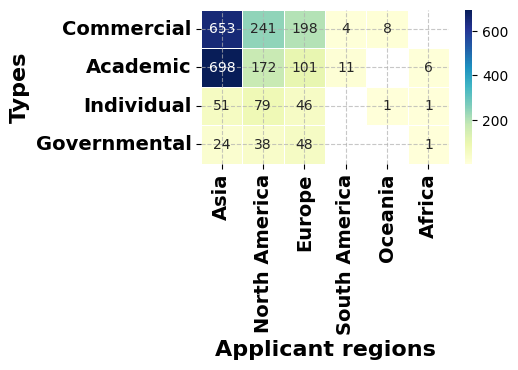

(4, 6)

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'Applicants_categories'
top_n_col = 25
top_n_index = 4
figsize=(4, 2)
xlabel = "Applicant regions"
ylabel = "Types"

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel)
pivot_df.shape

##  Applicants

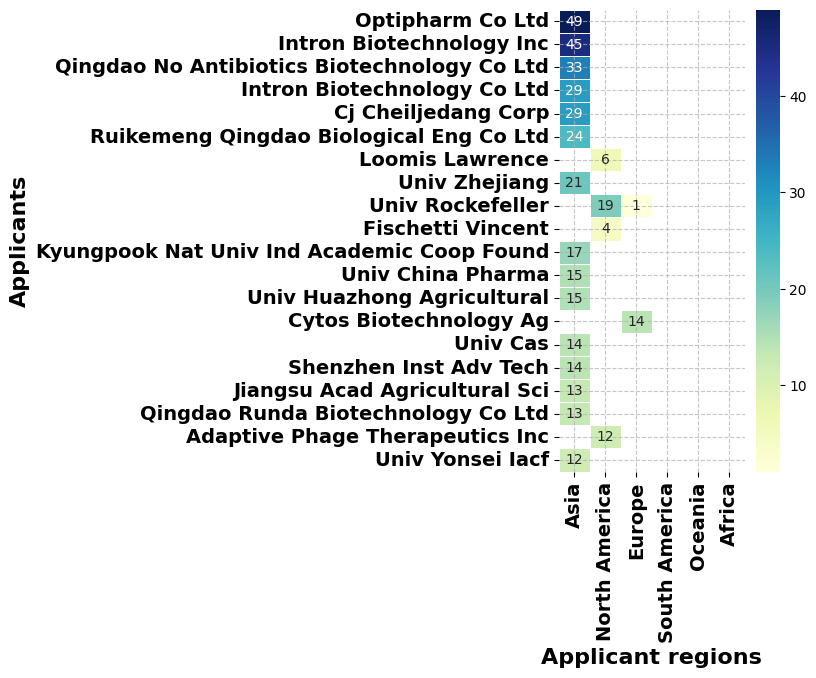

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'Applicants'
top_n_col = 20
top_n_index = 20
figsize=(3, 6)
xlabel = "Applicant regions"
ylabel = "Applicants"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

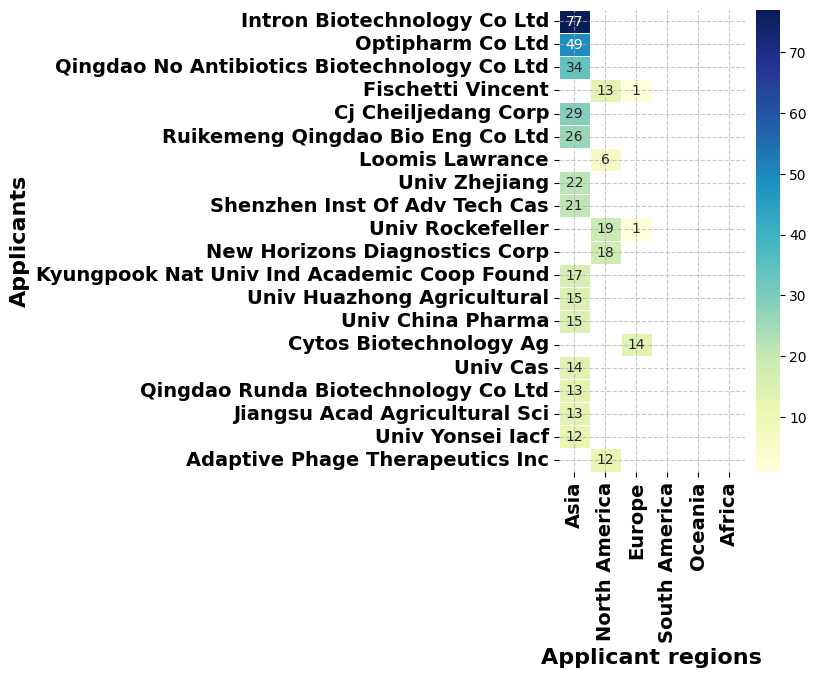

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'Applicants_clean'
top_n_col = 25
top_n_index = 20
figsize=(3, 6)
xlabel = "Applicant regions"
ylabel = "Applicants"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  Inventors

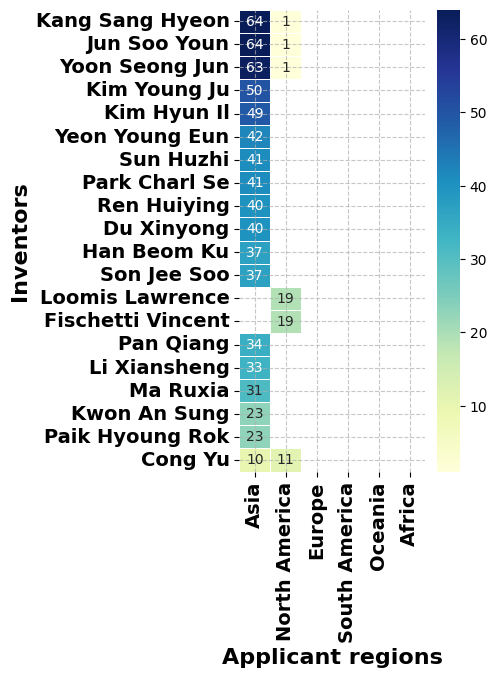

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'Inventors'
top_n_col = 25
top_n_index = 20
figsize=(3, 6)
xlabel = "Applicant regions"
ylabel = "Inventors"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

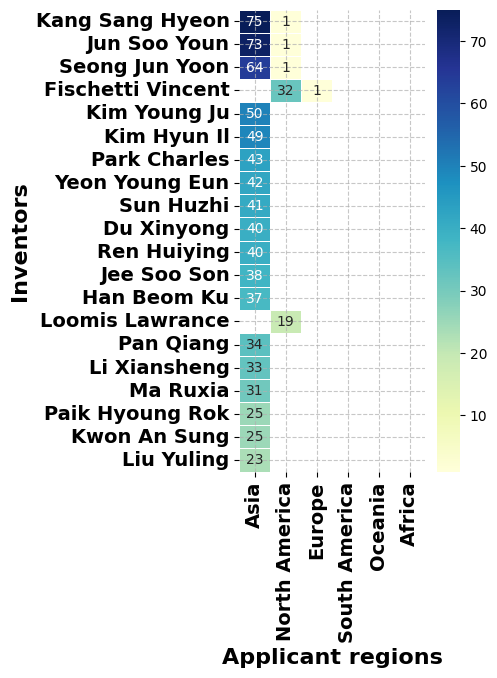

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'Inventors_clean'
top_n_col = 25
top_n_index = 20
figsize=(3, 6)
xlabel = "Applicant regions"
ylabel = "Inventors"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

## topics

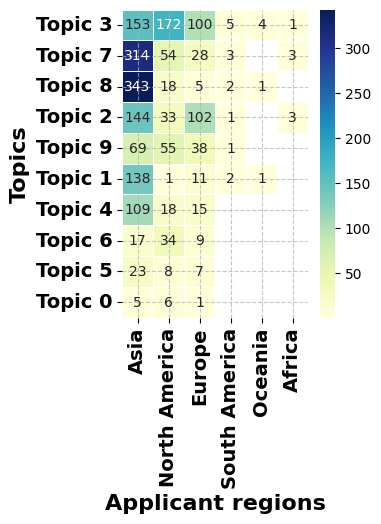

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'Topic N°'
top_n_col = 25
top_n_index = 20
figsize=(3, 4)
xlabel = "Applicant regions"
ylabel = "Topics"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  IPCR Sections

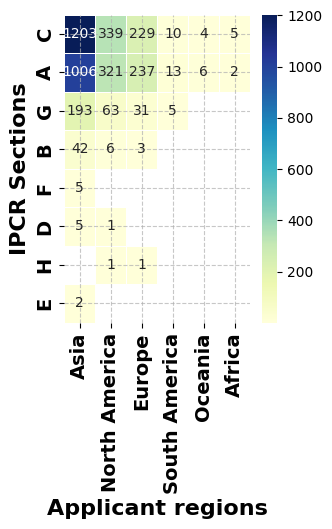

(8, 6)

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'IPCR Sections'
top_n_col = 25
top_n_index = 20
figsize=(3, 4)
xlabel = "Applicant regions"
ylabel = "IPCR Sections"

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel)
pivot_df.shape

##  IPCR Class

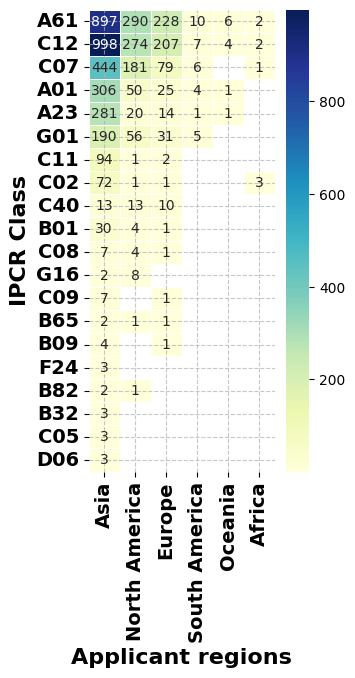

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'IPCR Class'
top_n_col = 25
top_n_index = 20
figsize=(3, 6)
xlabel = "Applicant regions"
ylabel = "IPCR Class"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  IPCR Subclass

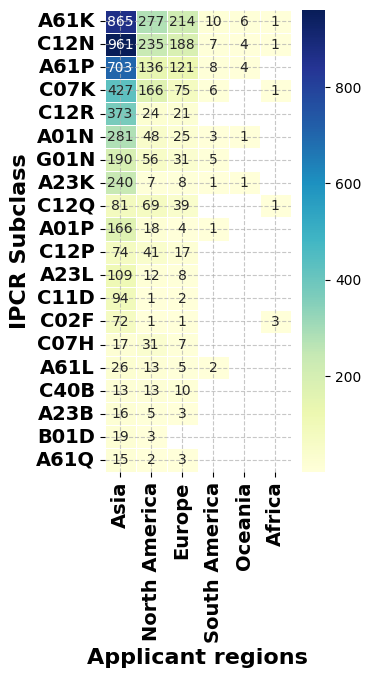

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'IPCR Subclass'
top_n_col = 25
top_n_index = 20
figsize=(3, 6)
xlabel = "Applicant regions"
ylabel = "IPCR Subclass"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  IPCR Classifications

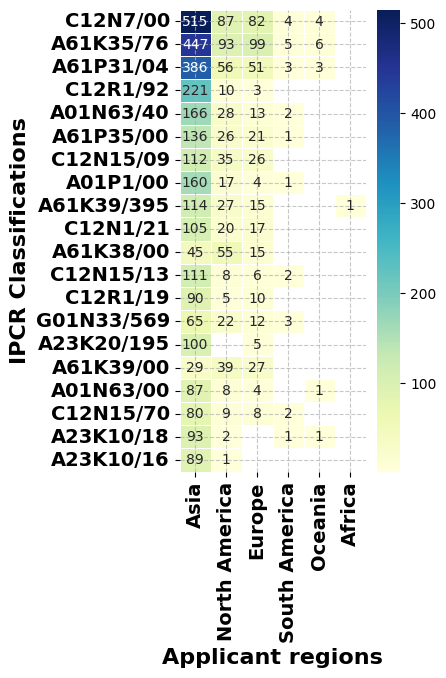

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'IPCR Classifications'
top_n_col = 25
top_n_index = 20
figsize=(3, 6)
xlabel = "Applicant regions"
ylabel = "IPCR Classifications"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  CPC Classifications

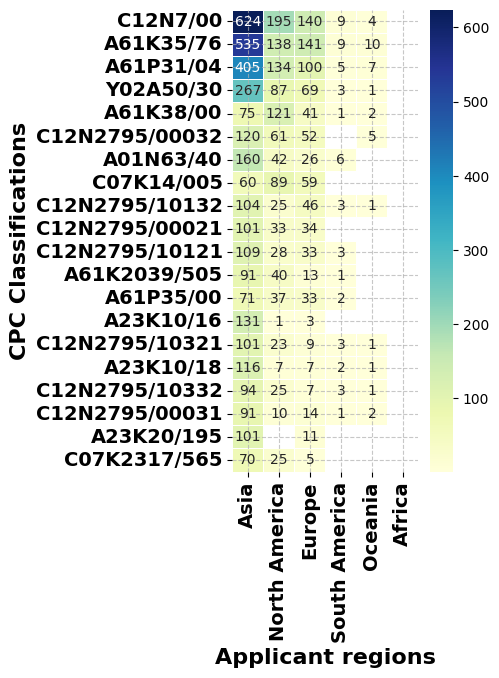

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'CPC Classifications'
top_n_col = 25
top_n_index = 20
figsize=(3, 6)
xlabel = "Applicant regions"
ylabel = "CPC Classifications"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

## Applicants_Last_Classification

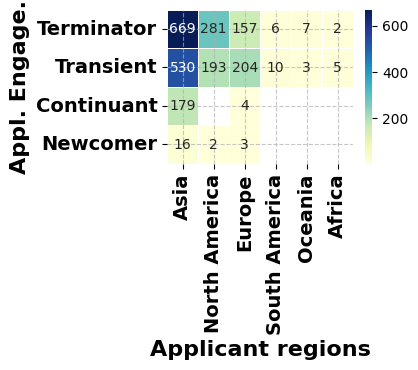

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'Applicants_Last_Classification'
top_n_col = 25
top_n_index = 20
figsize=(3, 2)
xlabel = "Applicant regions"
ylabel = "Appl. Engage."

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  Inventors_Last_Classification

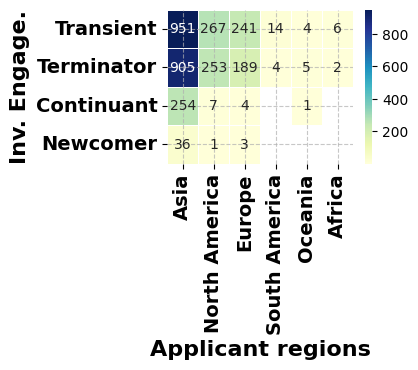

(4, 6)

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'Inventors_Last_Classification'
top_n_col = 25
top_n_index = 20
figsize=(3, 2)
xlabel = "Applicant regions"
ylabel = "Inv. Engage."

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel)
pivot_df.shape

##  Jurisdiction Country

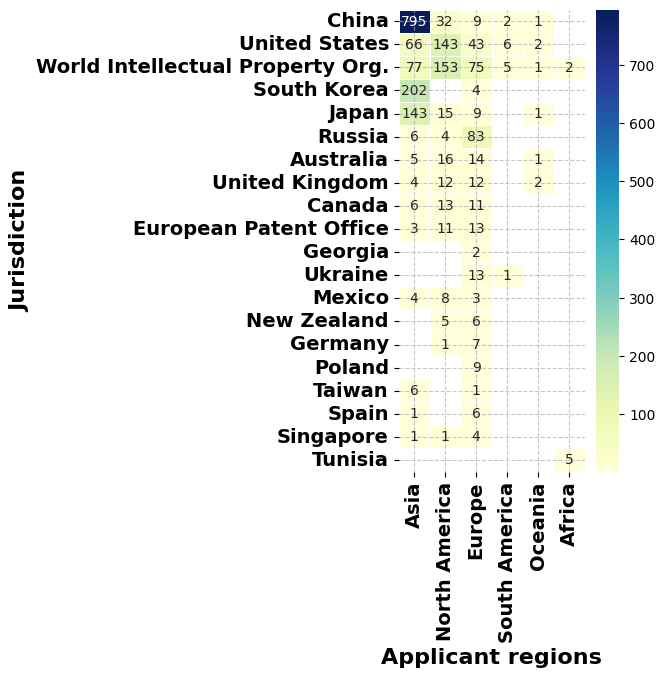

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'Jurisdiction_name'
top_n_col = 25
top_n_index = 20
figsize=(3, 6)
xlabel = "Applicant regions"
ylabel = "Jurisdiction"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

##  Jurisdiction Region

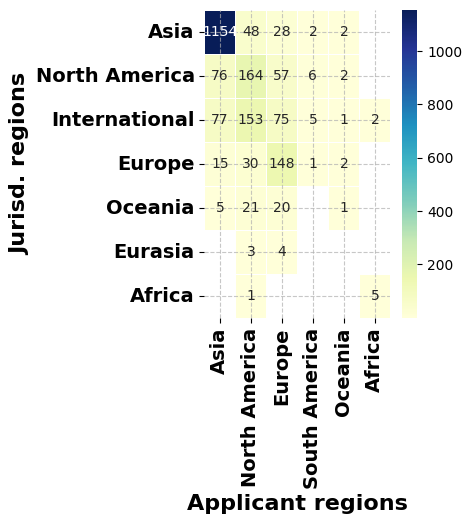

In [ ]:
index_cols = 'Applicants_regions'
split_col = 'Jurisdiction_Region'
top_n_col = 25
top_n_index = 20
figsize=(3, 4)
xlabel = "Applicant regions"
ylabel = "Jurisd. regions"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index, figsize, xlabel, ylabel)

# Heatmap graph TOPICS

In [ ]:
from operator import index
def process_data(data, index_cols, split_col, top_n_index, top_n_col):
  # Set the index
  applicants_data = data.set_index(['Lens ID', index_cols])

  # top_n_index_split_col
  top_n_index_split_col = data[split_col].str.split(';;').explode().str.strip().str.title().to_frame()
  top_n_index_split_col = top_n_index_split_col.reset_index()
  top_n_index_split_col = top_n_index_split_col[top_n_index_split_col[split_col] != '']
  top_n_index_split_col = top_n_index_split_col[split_col].value_counts().head(top_n_index).index.to_list()

  # top_n_index_split_col
  top_n_col_index_cols = data[index_cols].str.split(';;').explode().str.strip().str.title().to_frame()
  top_n_col_index_cols = top_n_col_index_cols.reset_index()
  top_n_col_index_cols = top_n_col_index_cols[top_n_col_index_cols[index_cols] != '']
  top_n_col_index_cols = top_n_col_index_cols[index_cols].value_counts().head(top_n_col).index.to_list()

  # Split and explode the 'Applicants' field
  applicants_list = applicants_data[split_col].str.split(';;').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  applicants_list2 = applicants_list.reset_index()
  applicants_list2[split_col] = applicants_list2[split_col].str.title()
  #applicants_list2 = applicants_list2[applicants_list2[index_cols] != '']
  #applicants_list2 = applicants_list2[applicants_list2[split_col] != '']

  # Set the index
  applicants_list3 = applicants_list2.set_index(['Lens ID', split_col])

  # Split and explode the 'Applicants' field
  applicants_list4 = applicants_list3[index_cols].str.split(';;').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  applicants_list4 = applicants_list4.reset_index()
  applicants_list4[index_cols] = applicants_list4[index_cols].str.title()
  #applicants_list4 = applicants_list4[applicants_list4[index_cols] != '']
  #applicants_list4 = applicants_list4[applicants_list4[split_col] != '']

  grouped = applicants_list4.groupby([index_cols, split_col]).agg({
      'Lens ID': 'count'
  }).reset_index()

  pivot_df = grouped.pivot_table(index=split_col, columns=index_cols, values=['Lens ID'], aggfunc='sum')['Lens ID']
  #pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2 = pd.DataFrame()
  missing_values = [value for value in top_n_col_index_cols if value not in pivot_df.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2

  #pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3 = pd.DataFrame()
  missing_values = [value for value in top_n_index_split_col if value not in pivot_df2.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3
  return pivot_df3


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each applicant over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Publication Count'.

    Returns:
    None
    """

    # Ensure the index is properly formatted
    pivot_df.index = pivot_df.index.to_series().str.title()

    # Round the values and convert to integer
    pivot_df = pivot_df.fillna(0)
    pivot_df = np.round(pivot_df).astype('int64')
    pivot_df = pivot_df.replace(0, np.nan)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in pivot_df :
      pivot_df[col] = pivot_df[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = pivot_df.reset_index()

    # Wrapping title with year and applicant name
    #data_to_plot['Applicants_categories'] = data_to_plot.apply(lambda row: f"{row['Applicants_categories'].title()}", axis=1)
    data_to_plot[split_col] = data_to_plot.apply(lambda row: f"{row[split_col].title()}", axis=1)

    # Set the Applicants column as the index
    data_to_plot = data_to_plot.set_index(split_col)

    # Create the heatmap
    if data_to_plot.empty:
        print("The DataFrame is empty.")
    else:
        sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of Top 50 Applicants and the Top 25 IPCR Subclass", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()


##  Applicants categories

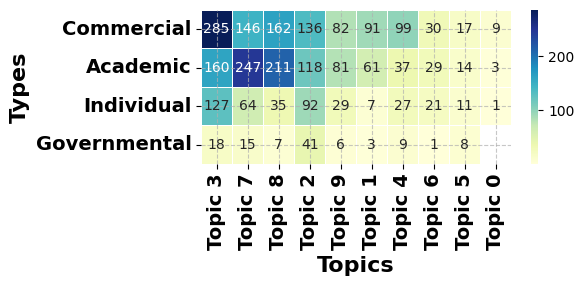

(4, 10)

In [ ]:
index_cols = 'Topic N°'
split_col = 'Applicants_categories'
top_n_col = 25
top_n_index = 4
figsize=(5, 2)
xlabel = "Topics"
ylabel = "Types"

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index,  figsize, xlabel, ylabel)
pivot_df.shape

In [ ]:
pivot_df

Topic N°,Topic 3,Topic 7,Topic 8,Topic 2,Topic 9,Topic 1,Topic 4,Topic 6,Topic 5,Topic 0
Applicants_categories,,,,,,,,,,
Commercial,285.0,146.0,162.0,136.0,82.0,91.0,99.0,30.0,17.0,9.0
Academic,160.0,247.0,211.0,118.0,81.0,61.0,37.0,29.0,14.0,3.0
Individual,127.0,64.0,35.0,92.0,29.0,7.0,27.0,21.0,11.0,1.0
Governmental,18.0,15.0,7.0,41.0,6.0,3.0,9.0,1.0,8.0,NaN


##  Applicants

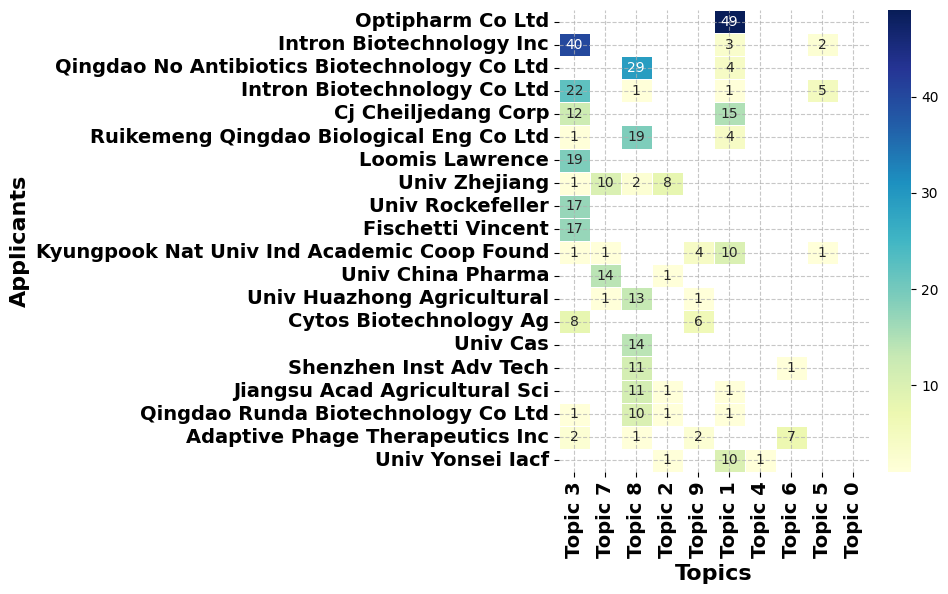

In [ ]:
index_cols = 'Topic N°'
split_col = 'Applicants'
top_n_col = (20)
top_n_index = 20
figsize=(5, 6)
xlabel = "Topics"
ylabel = "Applicants"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

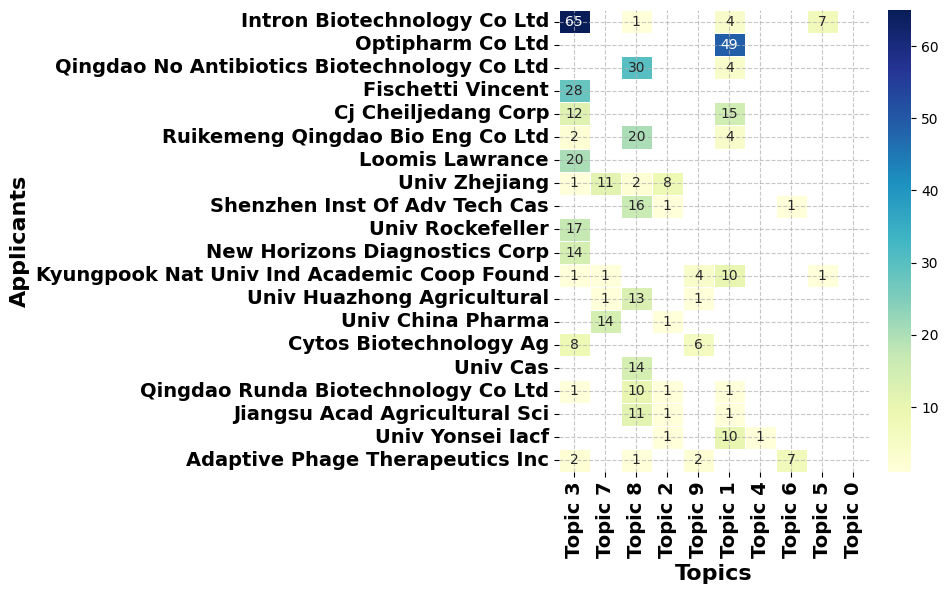

In [ ]:
index_cols = 'Topic N°'
split_col = 'Applicants_clean'
top_n_col = 25
top_n_index = 20
figsize=(5, 6)
xlabel = "Topics"
ylabel = "Applicants"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Inventors

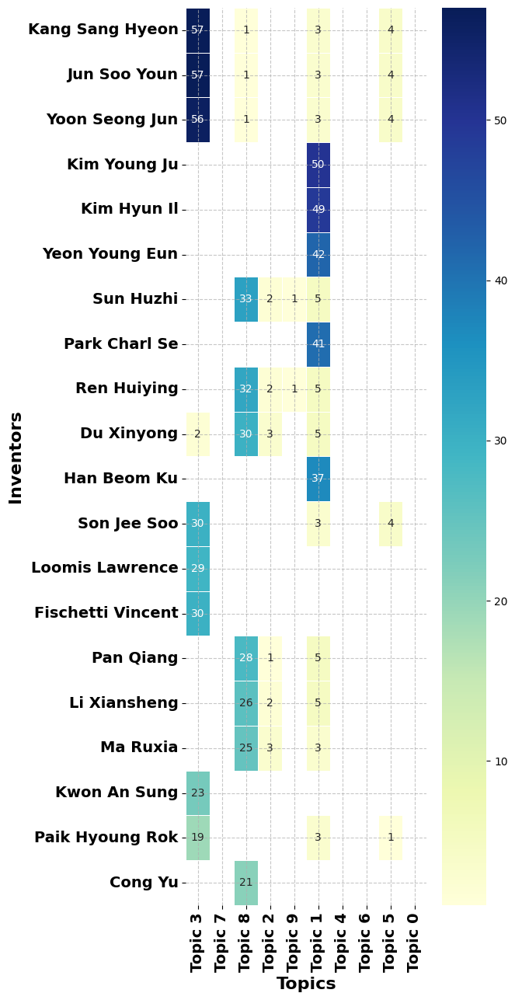

In [ ]:
index_cols = 'Topic N°'
split_col = 'Inventors'
top_n_col = 25
top_n_index = 20
figsize=(5, 15)
xlabel = "Topics"
ylabel = "Inventors"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

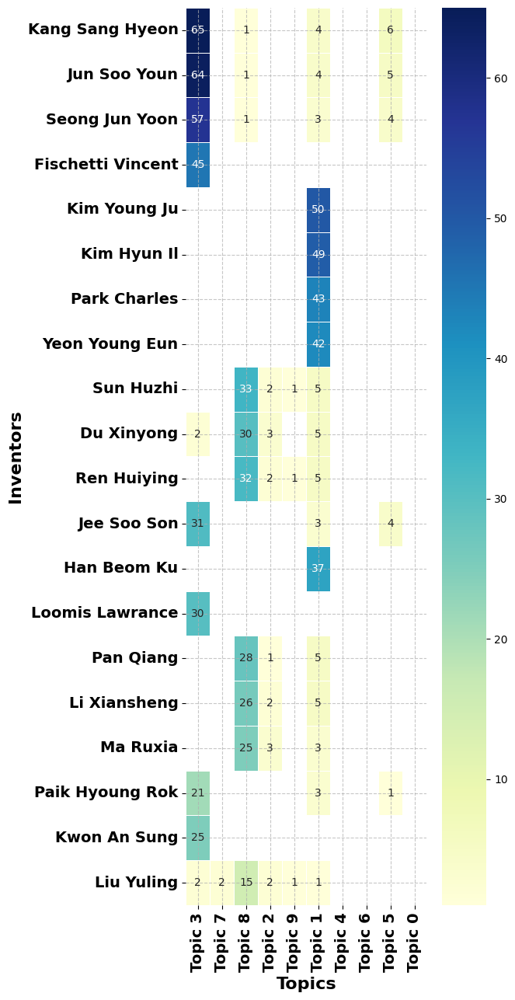

In [ ]:
index_cols = 'Topic N°'
split_col = 'Inventors_clean'
top_n_col = 25
top_n_index = 20
figsize=(5, 15)
xlabel = "Topics"
ylabel = "Inventors"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  IPCR Sections

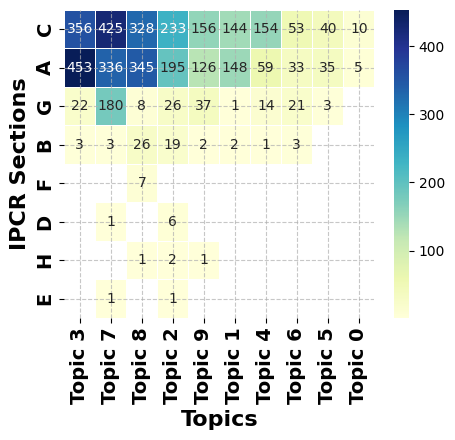

(8, 10)

In [ ]:
index_cols = 'Topic N°'
split_col = 'IPCR Sections'
top_n_col = 25
top_n_index = 20
figsize=(5, 4)
xlabel = "Topics"
ylabel = "IPCR Sections"

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index,  figsize, xlabel, ylabel)
pivot_df.shape

##  IPCR Class

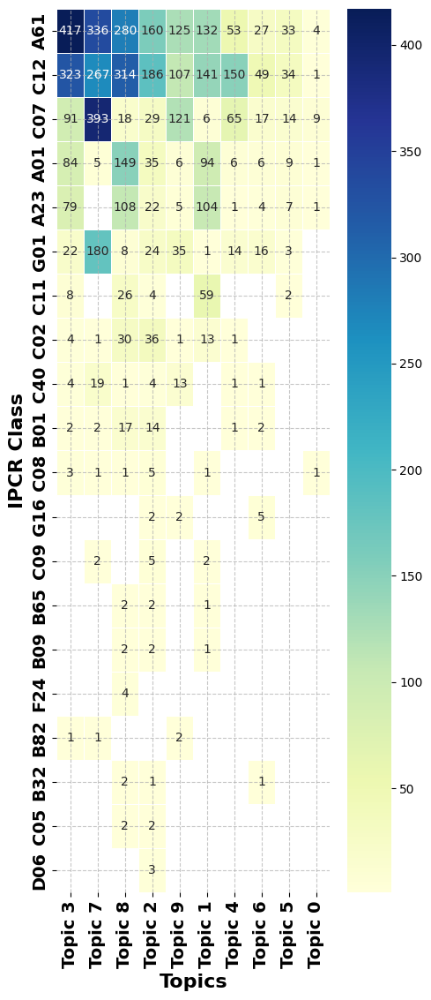

In [ ]:
index_cols = 'Topic N°'
split_col = 'IPCR Class'
top_n_col = 25
top_n_index = 20
figsize=(5, 13)
xlabel = "Topics"
ylabel = "IPCR Class"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  IPCR Subclass

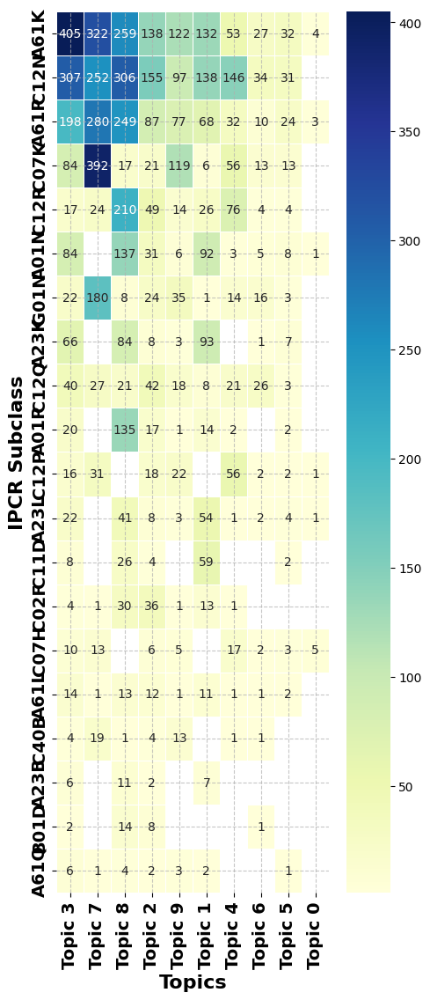

In [ ]:
index_cols = 'Topic N°'
split_col = 'IPCR Subclass'
top_n_col = 25
top_n_index = 20
figsize=(5, 13)
xlabel = "Topics"
ylabel = "IPCR Subclass"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  IPCR Classifications

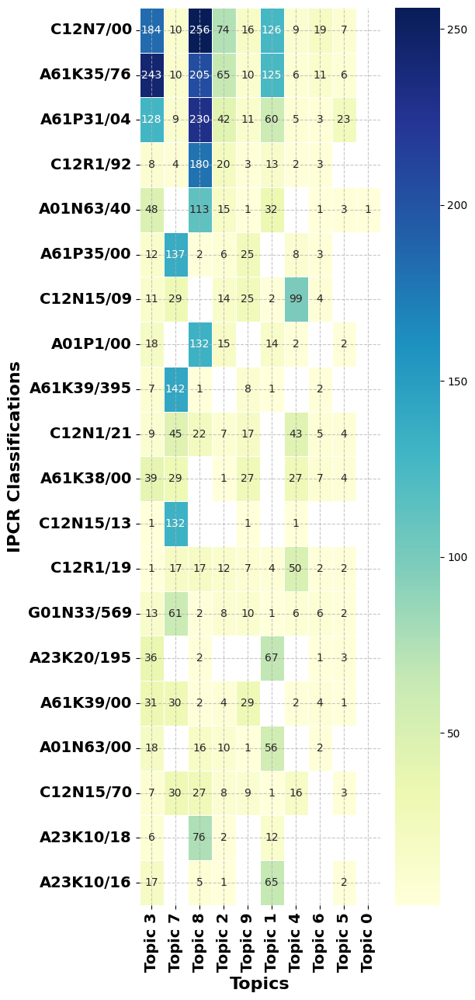

In [ ]:
index_cols = 'Topic N°'
split_col = 'IPCR Classifications'
top_n_col = 25
top_n_index = 20
figsize=(5, 15)
xlabel = "Topics"
ylabel = "IPCR Classifications"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  CPC Classifications

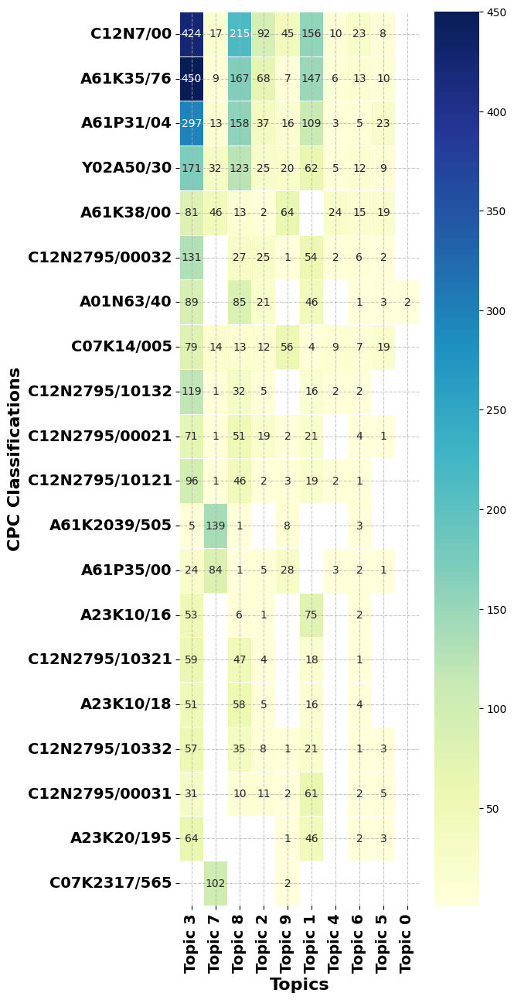

In [ ]:
index_cols = 'Topic N°'
split_col = 'CPC Classifications'
top_n_col = 25
top_n_index = 20
figsize=(5, 15)
xlabel = "Topics"
ylabel = "CPC Classifications"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

## Applicants_Last_Classification

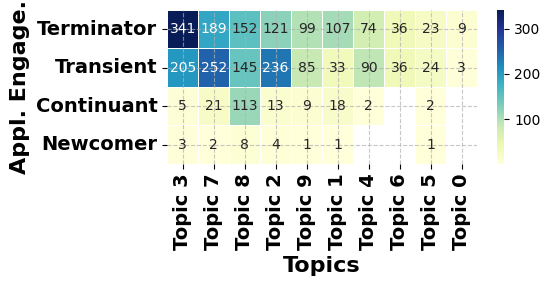

In [ ]:
index_cols = 'Topic N°'
split_col = 'Applicants_Last_Classification'
top_n_col = 25
top_n_index = 20
figsize=(5, 2)
xlabel = "Topics"
ylabel = "Appl. Engage."

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

In [ ]:
df

Topic N°,Topic 3,Topic 7,Topic 8,Topic 2,Topic 9,Topic 1,Topic 4,Topic 6,Topic 5,Topic 0
Applicants_Last_Classification,,,,,,,,,,
Terminator,341.0,189.0,152.0,121.0,99.0,107.0,74.0,36.0,23.0,9.0
Transient,205.0,252.0,145.0,236.0,85.0,33.0,90.0,36.0,24.0,3.0
Continuant,5.0,21.0,113.0,13.0,9.0,18.0,2.0,NaN,2.0,NaN
Newcomer,3.0,2.0,8.0,4.0,1.0,1.0,NaN,NaN,1.0,NaN


##  Inventors_Last_Classification

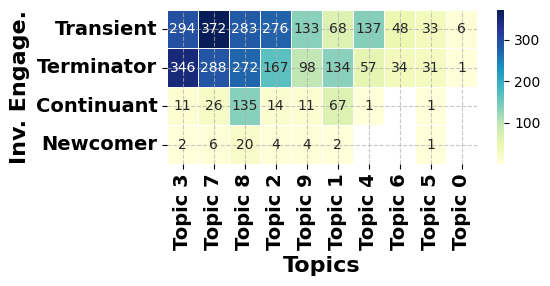

(4, 10)

In [ ]:
index_cols = 'Topic N°'
split_col = 'Inventors_Last_Classification'
top_n_col = 25
top_n_index = 20
figsize=(5, 2)
xlabel = "Topics"
ylabel = "Inv. Engage."

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index,  figsize, xlabel, ylabel)
pivot_df.shape

In [ ]:
pivot_df

Topic N°,Topic 3,Topic 7,Topic 8,Topic 2,Topic 9,Topic 1,Topic 4,Topic 6,Topic 5,Topic 0
Inventors_Last_Classification,,,,,,,,,,
Transient,294.0,372.0,283.0,276.0,133.0,68.0,137.0,48.0,33.0,6.0
Terminator,346.0,288.0,272.0,167.0,98.0,134.0,57.0,34.0,31.0,1.0
Continuant,11.0,26.0,135.0,14.0,11.0,67.0,1.0,NaN,1.0,NaN
Newcomer,2.0,6.0,20.0,4.0,4.0,2.0,NaN,NaN,1.0,NaN


##  Jurisdiction Country

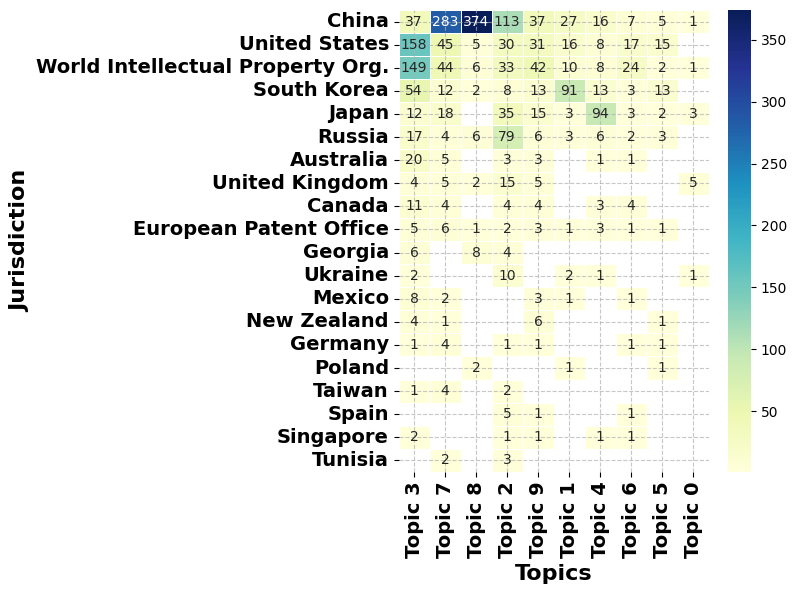

In [ ]:
index_cols = 'Topic N°'
split_col = 'Jurisdiction_name'
top_n_col = 20
top_n_index = 20
figsize=(5, 6)
xlabel = "Topics"
ylabel = "Jurisdiction"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Jurisdiction Region

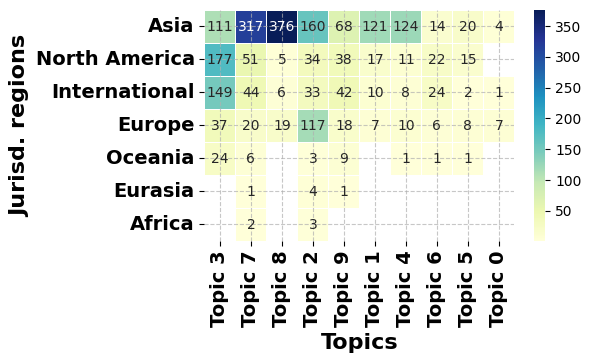

In [ ]:
index_cols = 'Topic N°'
split_col = 'Jurisdiction_Region'
top_n_col = 25
top_n_index = 20
figsize=(5, 3)
xlabel = "Topics"
ylabel = "Jurisd. regions"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##Applicants Region

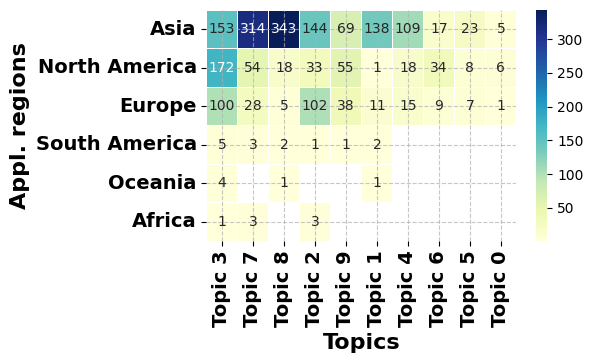

In [ ]:
index_cols = 'Topic N°'
split_col = 'Applicants_regions'
top_n_col = 20
top_n_index = 20
figsize=(5, 3)
xlabel = "Topics"
ylabel = "Appl. regions"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Applicants countries

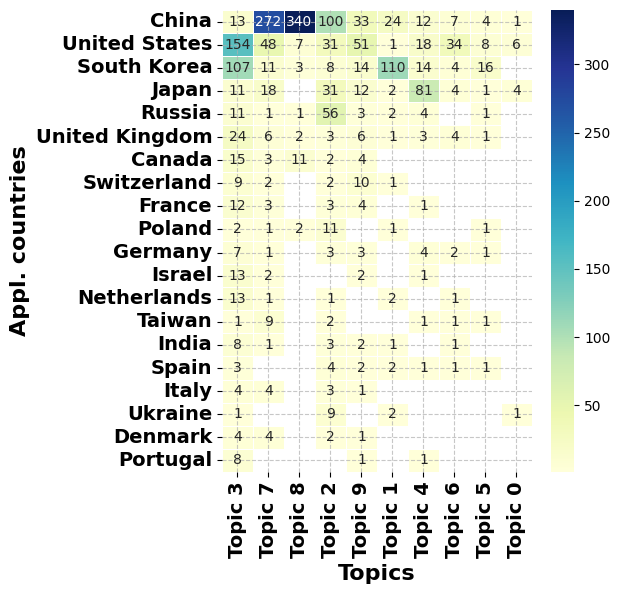

In [ ]:
index_cols = 'Topic N°'
split_col = 'Applicants_countries'
top_n_col = 20
top_n_index = 20
figsize=(5, 6)
xlabel = "Topics"
ylabel = "Appl. countries"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

# Heatmap graph IPCR Subclass

In [ ]:
from operator import index
def process_data(data, index_cols, split_col, top_n_index, top_n_col):
  # Set the index
  applicants_data = data.set_index(['Lens ID', index_cols])

  # top_n_index_split_col
  top_n_index_split_col = data[split_col].str.split(';;').explode().str.strip().str.title().to_frame()
  top_n_index_split_col = top_n_index_split_col.reset_index()
  top_n_index_split_col = top_n_index_split_col[top_n_index_split_col[split_col] != '']
  top_n_index_split_col = top_n_index_split_col[split_col].value_counts().head(top_n_index).index.to_list()

  # top_n_index_split_col
  top_n_col_index_cols = data[index_cols].str.split(';;').explode().str.strip().str.title().to_frame()
  top_n_col_index_cols = top_n_col_index_cols.reset_index()
  top_n_col_index_cols = top_n_col_index_cols[top_n_col_index_cols[index_cols] != '']
  top_n_col_index_cols = top_n_col_index_cols[index_cols].value_counts().head(top_n_col).index.to_list()

  # Split and explode the 'Applicants' field
  applicants_list = applicants_data[split_col].str.split(';;').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  applicants_list2 = applicants_list.reset_index()
  applicants_list2[split_col] = applicants_list2[split_col].str.title()
  #applicants_list2 = applicants_list2[applicants_list2[index_cols] != '']
  #applicants_list2 = applicants_list2[applicants_list2[split_col] != '']

  # Set the index
  applicants_list3 = applicants_list2.set_index(['Lens ID', split_col])

  # Split and explode the 'Applicants' field
  applicants_list4 = applicants_list3[index_cols].str.split(';;').explode().str.strip().to_frame()
      # Reset the index to re-organize data
  applicants_list4 = applicants_list4.reset_index()
  applicants_list4[index_cols] = applicants_list4[index_cols].str.title()
  #applicants_list4 = applicants_list4[applicants_list4[index_cols] != '']
  #applicants_list4 = applicants_list4[applicants_list4[split_col] != '']

  grouped = applicants_list4.groupby([index_cols, split_col]).agg({
      'Lens ID': 'count'
  }).reset_index()

  pivot_df = grouped.pivot_table(index=split_col, columns=index_cols, values=['Lens ID'], aggfunc='sum')['Lens ID']
  #pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2 = pd.DataFrame()
  missing_values = [value for value in top_n_col_index_cols if value not in pivot_df.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df2 = pivot_df[top_n_col_index_cols].T
  pivot_df2

  #pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3 = pd.DataFrame()
  missing_values = [value for value in top_n_index_split_col if value not in pivot_df2.columns]
  if missing_values:
      print(f"These values are missing in the index: {missing_values}")
  else:
      pivot_df3 = pivot_df2[top_n_index_split_col].T
  pivot_df3
  return pivot_df3


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def plot_top_50_heatmap(pivot_df, split_col, top_n_index, figsize, xlabel, ylabel):
    """
    Plot a heatmap for the given metric for top 50 companies based on Publication Count.

    Args:
    - pivot_df (pd.DataFrame): The pivoted DataFrame with metrics for each applicant over different application years.
    - metric (str): The metric based on which the top 50 companies are determined. Default is 'Publication Count'.

    Returns:
    None
    """

    # Ensure the index is properly formatted
    pivot_df.index = pivot_df.index.to_series().str.title()

    # Round the values and convert to integer
    pivot_df = pivot_df.fillna(0)
    pivot_df = np.round(pivot_df).astype('int64')
    pivot_df = pivot_df.replace(0, np.nan)

    def convert_to_int(x):
      return int(x) if not pd.isna(x) else np.nan

    for col in pivot_df :
      pivot_df[col] = pivot_df[col].apply(convert_to_int)

    plt.figure(figsize=figsize)

    # Extract data for the given metric
    data_to_plot = pivot_df.reset_index()

    # Wrapping title with year and applicant name
    #data_to_plot['Applicants_categories'] = data_to_plot.apply(lambda row: f"{row['Applicants_categories'].title()}", axis=1)
    data_to_plot[split_col] = data_to_plot.apply(lambda row: f"{row[split_col].title()}", axis=1)

    # Set the Applicants column as the index
    data_to_plot = data_to_plot.set_index(split_col)

    # Create the heatmap
    if data_to_plot.empty:
        print("The DataFrame is empty.")
    else:
        sns.heatmap(data_to_plot, annot=True, fmt=".0f", cmap='YlGnBu', linewidths=.5, cbar_kws={"orientation": "vertical"})

    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    #plt.title(f"Heatmap of Top 50 Applicants and the Top 25 IPCR Subclass", fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.grid( linestyle='--', alpha=0.7) #axis='x',
    plt.show()


##  Applicants categories

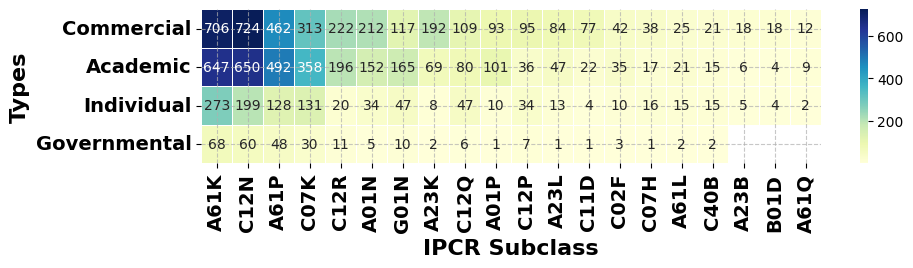

(4, 20)

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Applicants_categories'
top_n_col = 20
top_n_index = 4
figsize=(10, 2)
xlabel = "IPCR Subclass"
ylabel = "Types"

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index,  figsize, xlabel, ylabel)
pivot_df.shape

In [ ]:
pivot_df

IPCR Subclass,A61K,C12N,A61P,C07K,C12R,A01N,G01N,A23K,C12Q,A01P,C12P,A23L,C11D,C02F,C07H,A61L,C40B,A23B,B01D,A61Q
Applicants_categories,,,,,,,,,,,,,,,,,,,,
Commercial,706.0,724.0,462.0,313.0,222.0,212.0,117.0,192.0,109.0,93.0,95.0,84.0,77.0,42.0,38.0,25.0,21.0,18.0,18.0,12.0
Academic,647.0,650.0,492.0,358.0,196.0,152.0,165.0,69.0,80.0,101.0,36.0,47.0,22.0,35.0,17.0,21.0,15.0,6.0,4.0,9.0
Individual,273.0,199.0,128.0,131.0,20.0,34.0,47.0,8.0,47.0,10.0,34.0,13.0,4.0,10.0,16.0,15.0,15.0,5.0,4.0,2.0
Governmental,68.0,60.0,48.0,30.0,11.0,5.0,10.0,2.0,6.0,1.0,7.0,1.0,1.0,3.0,1.0,2.0,2.0,NaN,NaN,NaN


##  Applicants region

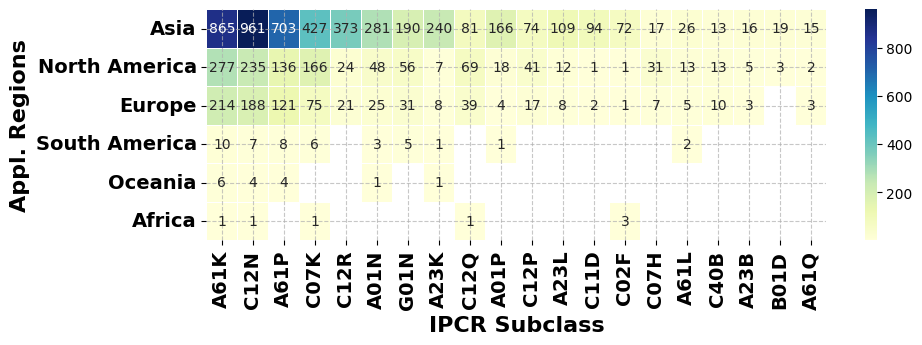

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Applicants_regions'
top_n_col = 20
top_n_index = 10
figsize=(10, 3)
xlabel = "IPCR Subclass"
ylabel = "Appl. Regions"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Applicants countries

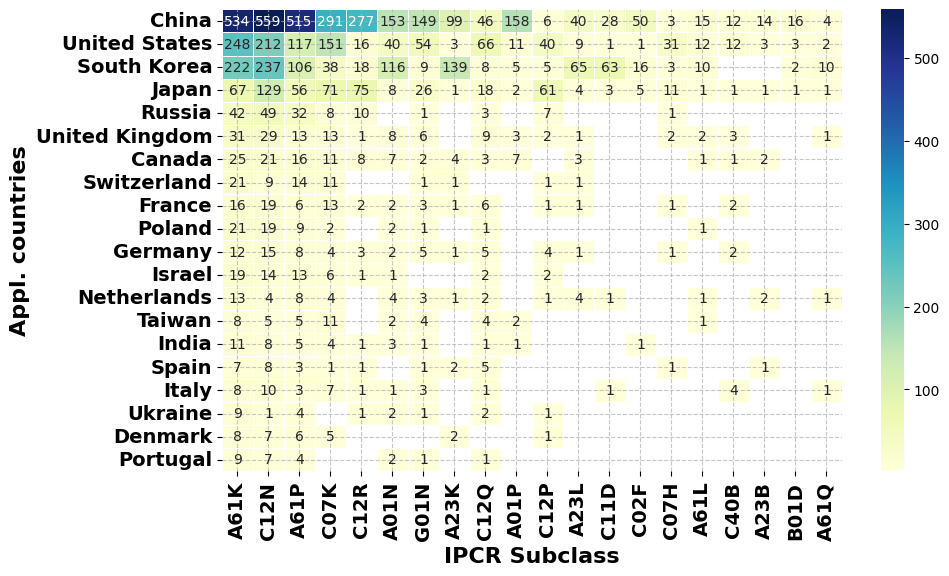

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Applicants_countries'
top_n_col = 20
top_n_index = 20
figsize=(10, 6)
xlabel = "IPCR Subclass"
ylabel = "Appl. countries"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Applicants

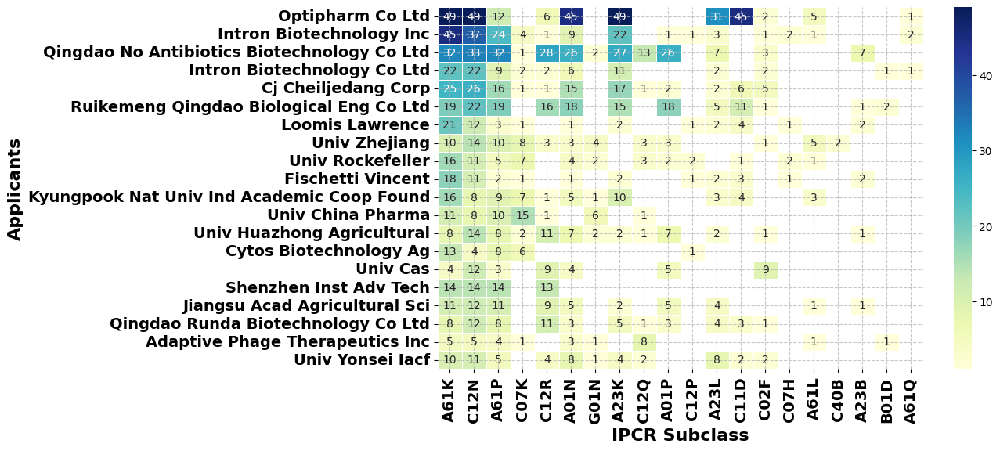

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Applicants'
top_n_col = 20
top_n_index = 20
figsize=(10, 6)
xlabel = "IPCR Subclass"
ylabel = "Applicants"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

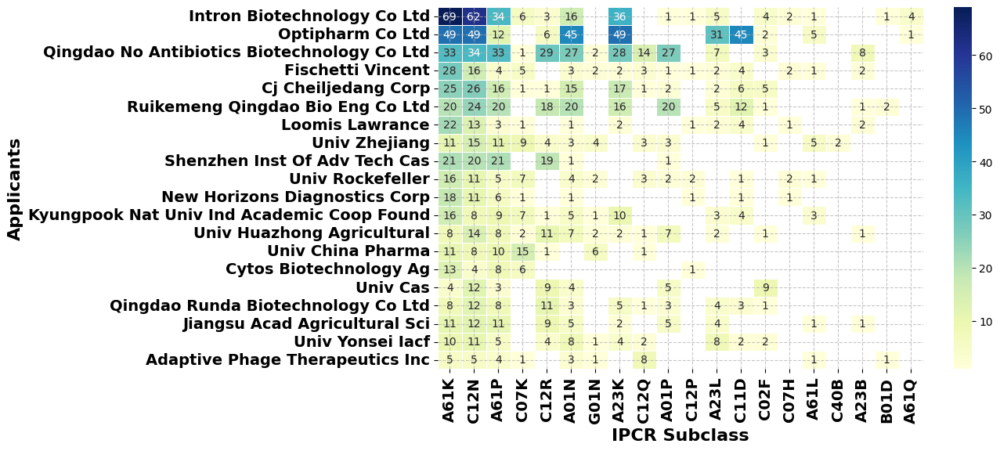

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Applicants_clean'
top_n_col = 20
top_n_index = 20
figsize=(10, 6)
xlabel = "IPCR Subclass"
ylabel = "Applicants"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Inventors

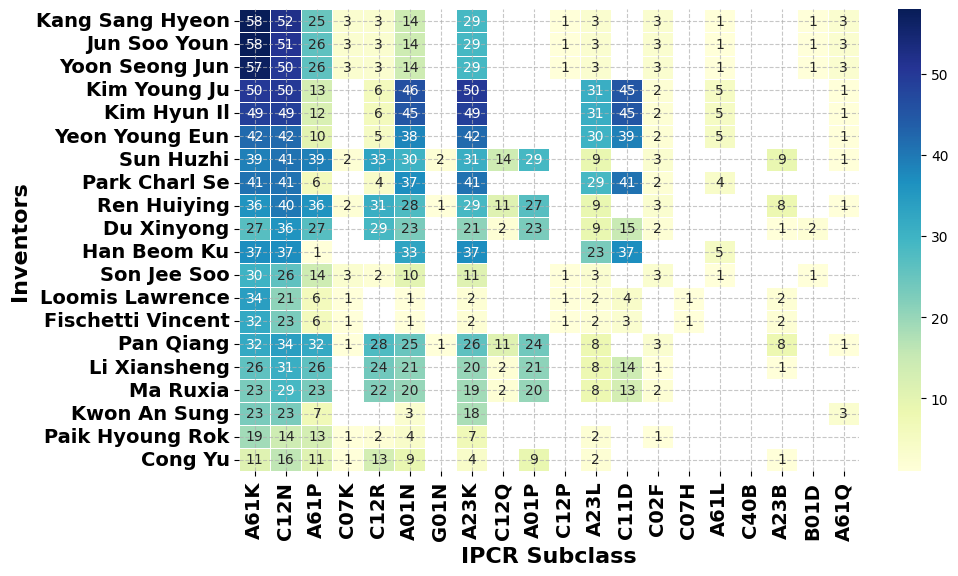

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Inventors'
top_n_col = 20
top_n_index = 20
figsize=(10, 6)
xlabel = "IPCR Subclass"
ylabel = "Inventors"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

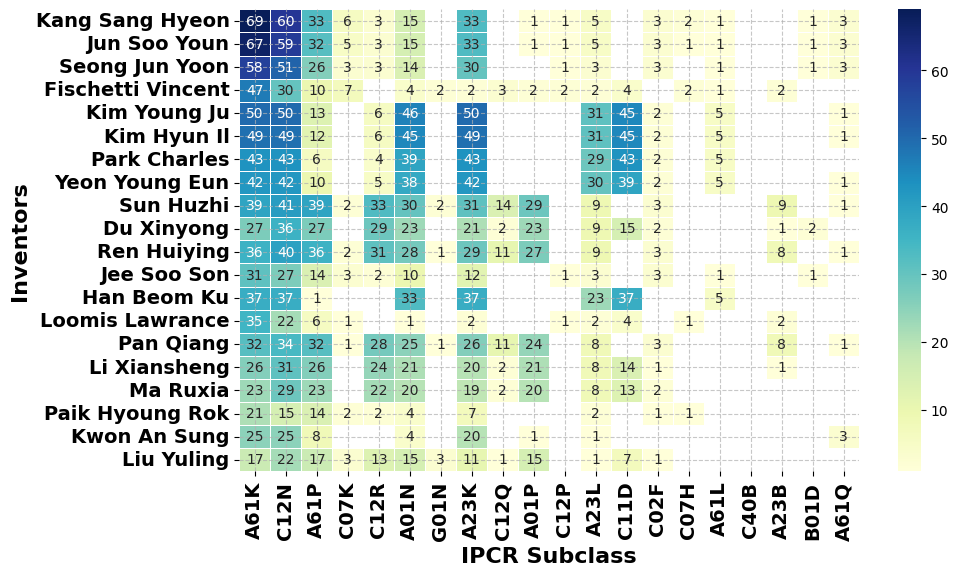

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Inventors_clean'
top_n_col = 20
top_n_index = 20
figsize=(10, 6)
xlabel = "IPCR Subclass"
ylabel = "Inventors"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

## topics

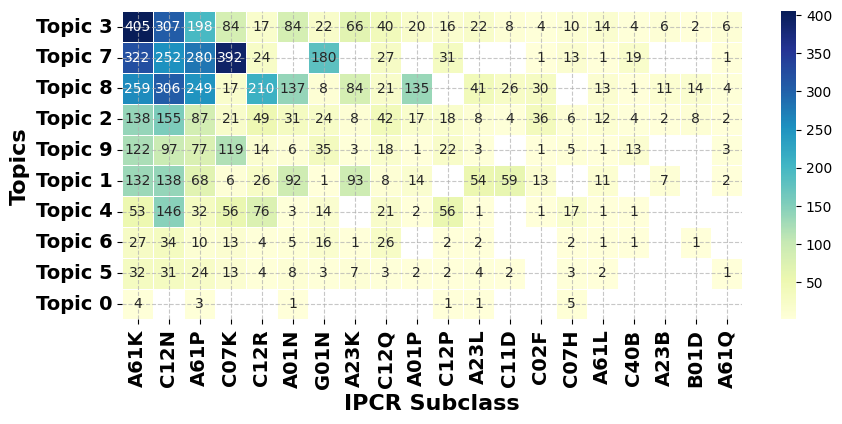

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Topic N°'
top_n_col = 20
top_n_index = 20
figsize=(10, 4)
xlabel = "IPCR Subclass"
ylabel = "Topics"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  IPCR Sections

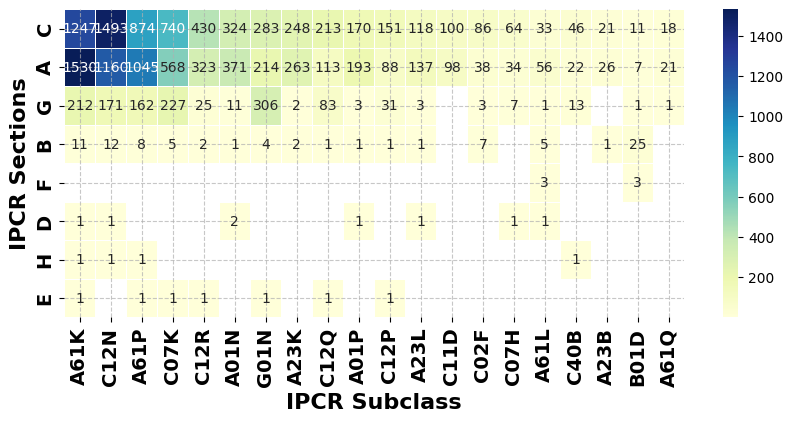

(8, 20)

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'IPCR Sections'
top_n_col = 20
top_n_index = 20
figsize=(10, 4)
xlabel = "IPCR Subclass"
ylabel = "IPCR Sections"

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index,  figsize, xlabel, ylabel)
pivot_df.shape

##  IPCR Class

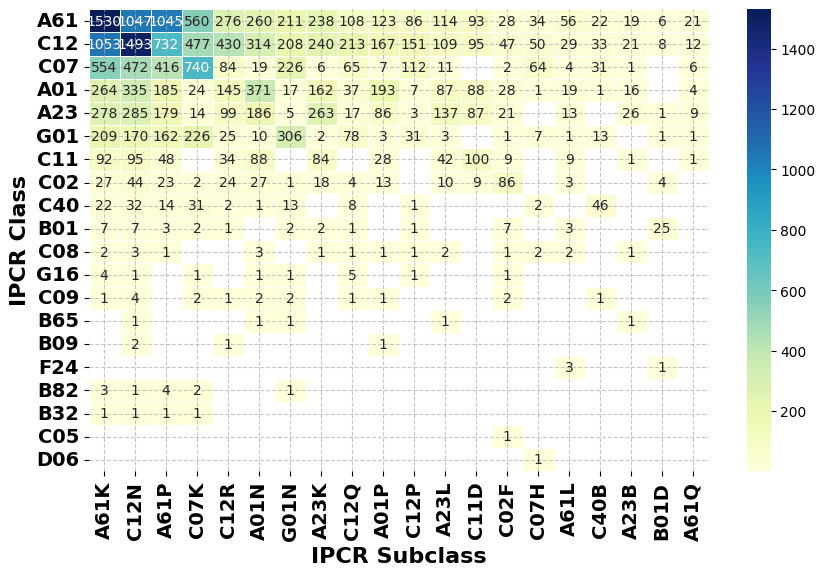

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'IPCR Class'
top_n_col = 20
top_n_index = 20
figsize=(10, 6)
xlabel = "IPCR Subclass"
ylabel = "IPCR Class"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  IPCR Classifications

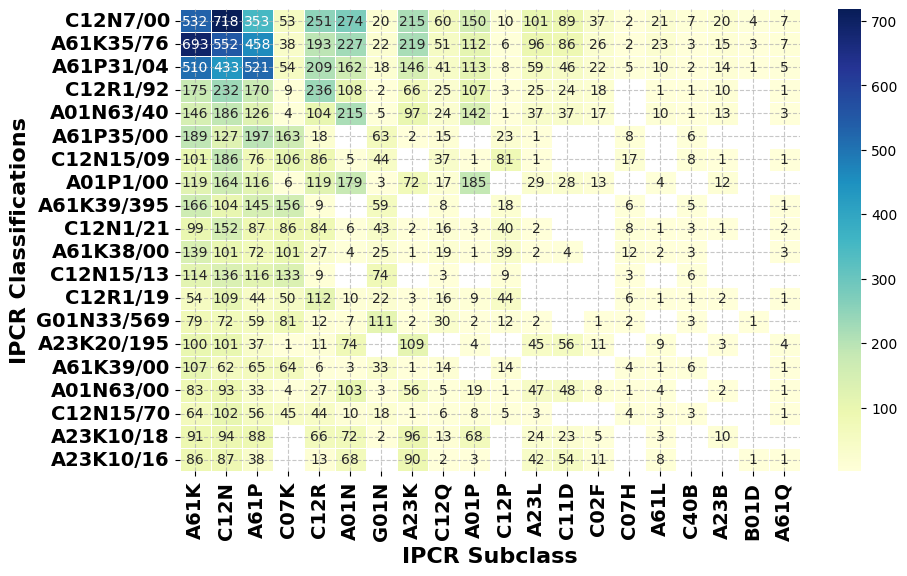

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'IPCR Classifications'
top_n_col = 20
top_n_index = 20
figsize=(10, 6)
xlabel = "IPCR Subclass"
ylabel = "IPCR Classifications"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  CPC Classifications

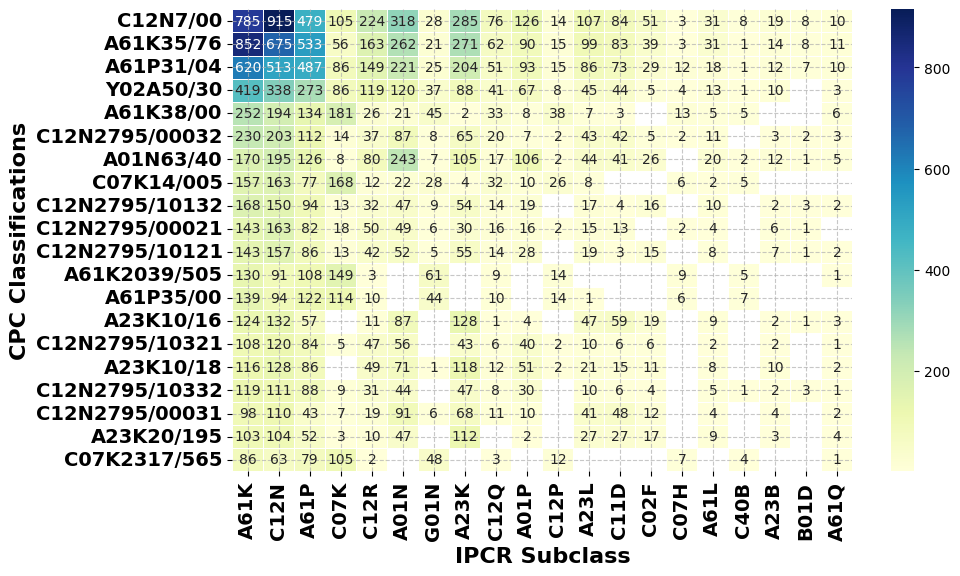

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'CPC Classifications'
top_n_col = 20
top_n_index = 20
figsize=(10, 6)
xlabel = "IPCR Subclass"
ylabel = "CPC Classifications"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

## Applicants_Last_Classification

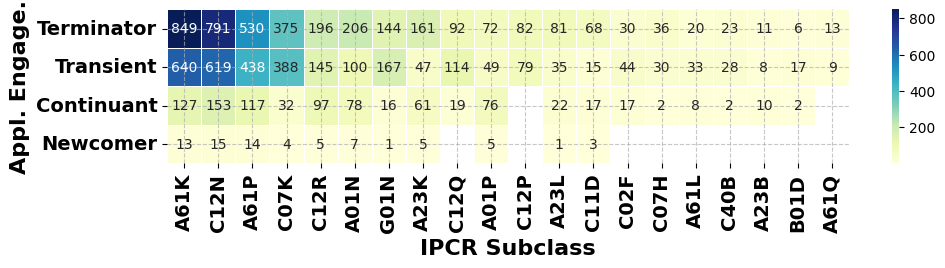

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Applicants_Last_Classification'
top_n_col = 20
top_n_index = 20
figsize=(11, 2)
xlabel = "IPCR Subclass"
ylabel = "Appl. Engage."

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

In [ ]:
df

IPCR Subclass,A61K,C12N,A61P,C07K,C12R,A01N,G01N,A23K,C12Q,A01P,C12P,A23L,C11D,C02F,C07H,A61L,C40B,A23B,B01D,A61Q
Applicants_Last_Classification,,,,,,,,,,,,,,,,,,,,
Terminator,849.0,791.0,530.0,375.0,196.0,206.0,144.0,161.0,92.0,72.0,82.0,81.0,68.0,30.0,36.0,20.0,23.0,11.0,6.0,13.0
Transient,640.0,619.0,438.0,388.0,145.0,100.0,167.0,47.0,114.0,49.0,79.0,35.0,15.0,44.0,30.0,33.0,28.0,8.0,17.0,9.0
Continuant,127.0,153.0,117.0,32.0,97.0,78.0,16.0,61.0,19.0,76.0,NaN,22.0,17.0,17.0,2.0,8.0,2.0,10.0,2.0,NaN
Newcomer,13.0,15.0,14.0,4.0,5.0,7.0,1.0,5.0,NaN,5.0,NaN,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


##  Inventors_Last_Classification

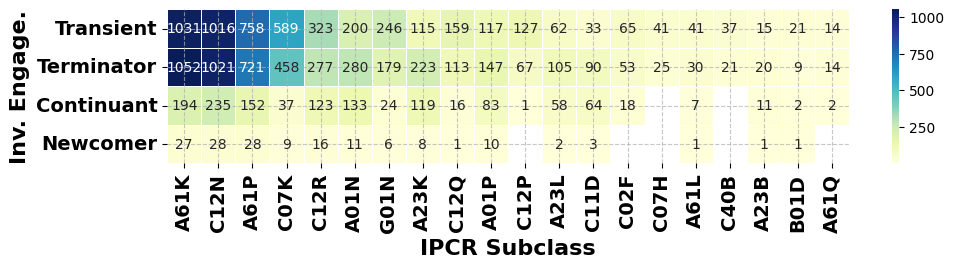

(4, 20)

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Inventors_Last_Classification'
top_n_col = 20
top_n_index = 20
figsize=(11, 2)
xlabel = "IPCR Subclass"
ylabel = "Inv. Engage."

pivot_df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(pivot_df, split_col, top_n_index,  figsize, xlabel, ylabel)
pivot_df.shape

In [ ]:
pivot_df

IPCR Subclass,A61K,C12N,A61P,C07K,C12R,A01N,G01N,A23K,C12Q,A01P,C12P,A23L,C11D,C02F,C07H,A61L,C40B,A23B,B01D,A61Q
Inventors_Last_Classification,,,,,,,,,,,,,,,,,,,,
Transient,1031.0,1016.0,758.0,589.0,323.0,200.0,246.0,115.0,159.0,117.0,127.0,62.0,33.0,65.0,41.0,41.0,37.0,15.0,21.0,14.0
Terminator,1052.0,1021.0,721.0,458.0,277.0,280.0,179.0,223.0,113.0,147.0,67.0,105.0,90.0,53.0,25.0,30.0,21.0,20.0,9.0,14.0
Continuant,194.0,235.0,152.0,37.0,123.0,133.0,24.0,119.0,16.0,83.0,1.0,58.0,64.0,18.0,NaN,7.0,NaN,11.0,2.0,2.0
Newcomer,27.0,28.0,28.0,9.0,16.0,11.0,6.0,8.0,1.0,10.0,NaN,2.0,3.0,NaN,NaN,1.0,NaN,1.0,1.0,NaN


##  Jurisdiction Country

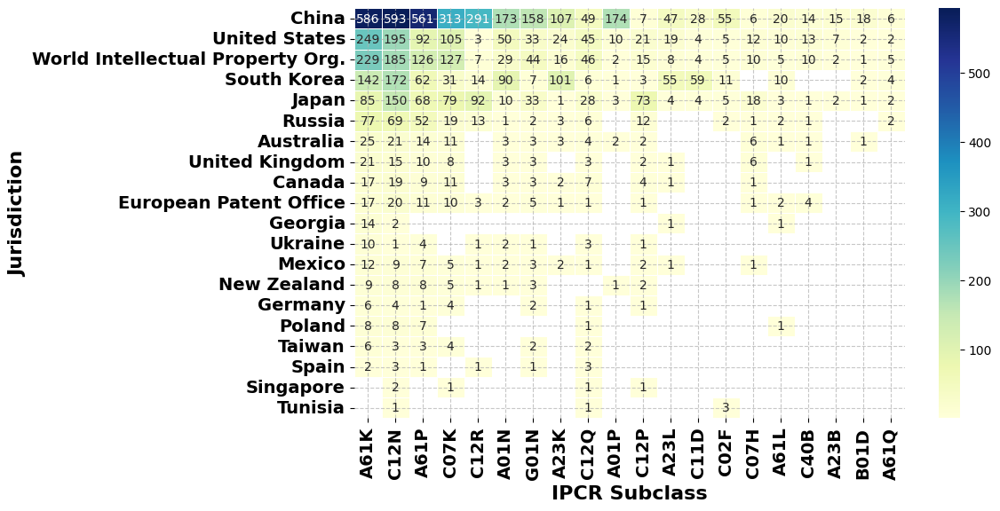

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Jurisdiction_name'
top_n_col = 20
top_n_index = 20
figsize=(10, 6)
xlabel = "IPCR Subclass"
ylabel = "Jurisdiction"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

##  Jurisdiction Region

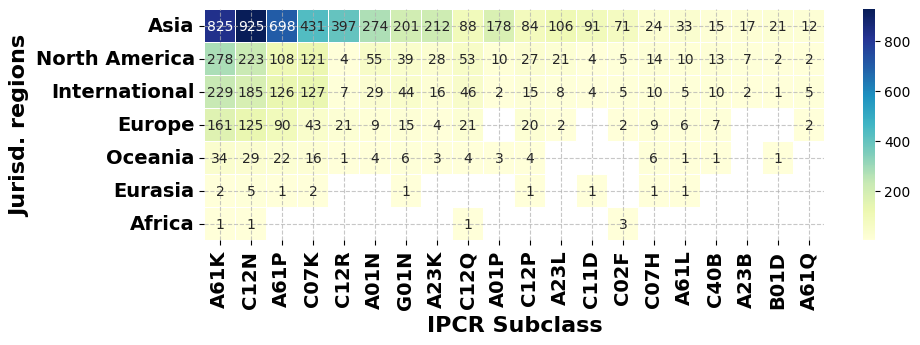

In [ ]:
index_cols = 'IPCR Subclass'
split_col = 'Jurisdiction_Region'
top_n_col = 20
top_n_index = 20
figsize=(10, 3)
xlabel = "IPCR Subclass"
ylabel = "Jurisd. regions"

df = process_data(data, index_cols, split_col, top_n_index, top_n_col)
plot_top_50_heatmap(df, split_col, top_n_index,  figsize, xlabel, ylabel)

# Topics

In [ ]:
# Step 1: Group data by 'Publication Year' and 'topic', then count occurrences
topic_counts_by_year = data.reset_index().groupby(['Application Year', 'Topic N°']).size().unstack(fill_value=0)

# Step 2: Calculate the total count of each topic
total_counts = topic_counts_by_year.sum()

# Step 3: Sort columns by total count
sorted_columns = total_counts.sort_values(ascending=False).index
topic_counts_by_year = topic_counts_by_year[sorted_columns]

# Step 4: Add a row with the total count of each topic
topic_counts_by_year.loc['Total'] = total_counts.loc[sorted_columns]

# Save the DataFrame to CSV and pickle files
# topic_counts_by_year.to_csv(f'/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/topic_counts_by_year_patent_therapy_23102023_{n_topics}.csv')
# topic_counts_by_year.to_pickle(f'/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/topic_counts_by_year_patent_therapy_23102023_{n_topics}.pkl')

# This will give you a DataFrame where each row is a year (plus a 'Total' row at the bottom),
# and each column is the count of documents associated with a topic for that year (and the total count).

# Display the updated DataFrame
topic_counts_by_year

Topic N°,Topic 3,Topic 7,Topic 8,Topic 2,Topic 9,Topic 1,Topic 4,Topic 6,Topic 5,Topic 0
Application Year,,,,,,,,,,
1955,0,0,1,2,0,0,0,0,0,0
1958,0,0,0,1,0,0,0,0,0,0
1959,0,0,0,0,1,0,0,0,0,0
1963,0,0,0,1,0,0,0,0,0,0
1964,0,0,0,1,0,0,0,0,0,0
1966,0,0,0,1,0,0,0,0,0,4
1967,0,0,0,0,0,0,0,0,0,1
1968,0,0,0,1,0,0,0,0,0,0
1969,0,0,0,2,0,0,0,0,0,1


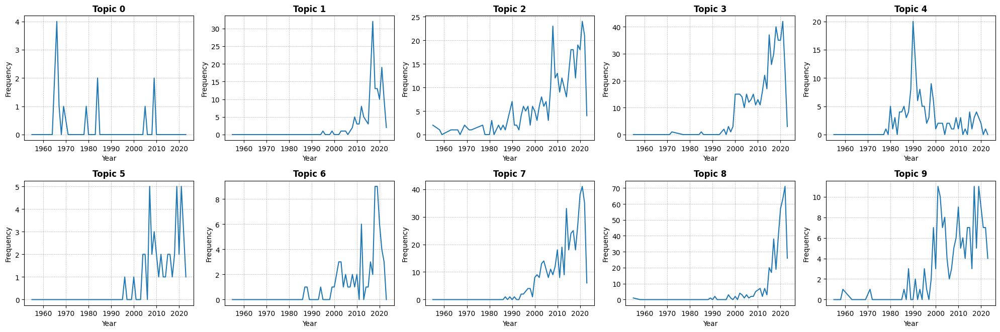

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Read the DataFrame from the CSV file (assuming it's stored as 'topic_counts_by_year.csv')
# Replace this line with your actual data if it's not in a CSV
#topic_counts_by_year = pd.read_csv('topic_counts_by_year.csv', index_col='Publication Year')

# Remove the 'Total' row if it exists
if 'Total' in topic_counts_by_year.index:
    topic_counts_by_year = topic_counts_by_year.drop(index=['Total'])

# Sort columns by topic name
topic_counts_by_year = topic_counts_by_year.sort_index(axis=1)

# Define the number of topics (make sure this matches your data)
n_topics = len(topic_counts_by_year.columns)

# Calculate the number of rows needed for subplots
n_rows = (n_topics + 4) // 5  # +4 for rounding up

# Create a grid of subplots
fig, axes = plt.subplots(n_rows, 5, figsize=(20, n_rows * 3.5))

# Flatten the array to easily iterate over it
axes_flat = axes.flatten()

# Loop through each topic and plot its curve on a separate subplot
for i, topic in enumerate(topic_counts_by_year.columns):
    axes_flat[i].plot(
        topic_counts_by_year.index,
        topic_counts_by_year[topic]
    )
    axes_flat[i].set_title(f'{topic}', fontweight='bold')
    axes_flat[i].set_xlabel('Year')#, fontweight='bold')
    axes_flat[i].set_ylabel('Frequency')#, fontweight='bold')
    axes_flat[i].grid(True, which='both', linestyle='--', linewidth=0.5)

# Remove extra subplots
for i in range(n_topics, len(axes_flat)):
    fig.delaxes(axes_flat[i])

# Add a main title for the entire figure
#fig.suptitle('Evolution Curve for Each Topic', fontsize=16, fontweight='bold')

# Save the figure
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Make room for the main title
# plt.savefig(f'/content/drive/MyDrive/YORKU PROJECT/JUDE/BACTERIOPHAGE/topic_evolution_curves_subplot_ordered_patent_therapy_23102023_{n_topics}.png', dpi=600)

# Show the figure
plt.show()
